In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
import seaborn as sns

# Mid-term project 1
• Midterm project: MIMIC-III data analysis (sensor data from human body)
-> finding relationship between features
- Goal of project: How to deal with Numeric data 
in clinic
- Read the following paper: https://www.nature.com/articles/s41598-023-37829-z

## Data Description
This dataset encompasses the outcomes of two distinct experiments, with each containing participants' correct/incorrect responses, accompanied by their response times, documented as 'n_back_responses'. Alongside these behavioral responses, the dataset incorporates physiological measurements collected from two Empatica devices, each affixed to either hand, as well as data obtained from a muse headband. 

To present the data in a structured manner, each participant's data is contained within a designated folder, numbered sequentially from A1 to A10 in Experiment 1, and B1 to B10 in Experiment 2. The dataset also includes the data from participants who were excluded for further analysis in [1]. Their folder names are named 'Excluded_ID_number' [1]. Their ID numbers are according to those presented in supplementary materials in [1]. The column “Start_time_unix” shows the initial time of the recording expressed as UNIX timestamp in UTC. 

The experiment settings and behavioral signals can be found in the ‘n_back_responses.csv’ file. The .csv file is in the following format:
- The “ExperimentName” specifies the experiment of the study.
- The “Instruction” specifies the presented n-back task at each trial.
- The “Running [Block]” displays the applied actuator within each session.

In the designed n-back experiments, subjects were shown trials of stimulus (500 ms) along with a plus sign (fixation cross) for their response (1500 ms). The behavioral signals including the reaction time (RT) and correct/incorrect response are stored under the “Stimulus” and “Fixation” categories.

In experiment 1, the reaction times (milliseconds) associated with session 1 to session 4 are stored within “Fixation101.RT” to “Fixation104.RT” and “Stimulus101.RT” to “Stimulus104.RT”. The binary correct/incorrect responses associated with session 1 to session 4 are stored within “Fixation101.ACC” to “Fixation104.ACC” and “Stimulus101.ACC” to “Stimulus104.ACC”.

The EEG signals recorded from the Muse headband are also included in the dataset as 'EEG_recording.csv'. They include EEG channels from four locations: TP9, AF7, AF8, and TP10. The 2016 model Muse (MU-02) can also output RAW EEG data at 256Hz as well as being able to output RAW EEG from the right ear USB Auxiliary connector (named Right AUX in the csv files). The column (timestamps) shows the data points in UNIX format. EEG measurements are labeled as TP9, AF7, AF8, TP10, Right AUX.

The Empatica data encompasses a range of physiological aspects, including participants' electrodermal activity (EDA), heart rate (HR), blood volume pulses (BVP), skin surface temperature, Photoplethysmography (PPG), and 3-axis accelerometer data. These data types are stored as separate CSV files: 'EDA.csv', 'TEMP.csv', 'ACC.csv', 'BVP.csv', 'HR.csv', 'IBI.csv', and 'tags.csv'. Data recorded by Empatica wristbands from Left and Right hands are each represented by their own distinct CSV files, encompassing the following attributes:
- 'Left_EDA.csv' and 'Right_EDA.csv'
- 'Left_TEMP.csv' and 'Right_TEMP.csv'
- 'Left_ACC.csv' and 'Right_ACC.csv'
- 'Left_BVP.csv' and 'Right_BVP.csv'
- 'Left_HR.csv' and 'Right_HR.csv'
- 'Left_IBI.csv' and 'Right_IBI.csv'
- 'Left_tags.csv' and 'Right_tags.csv'

For clarity, a concise summary of the contents of the different data files is provided below:

- EDA: Measurements from the electrodermal activity (EDA) sensor expressed as micro siemens (μS). Values in the first column (EDA) show the EDA values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

- TEMP: Skin temperature (TEMP) measured from temperature sensor expressed degrees on the Celsius (°C) scale. Values in the first column (TEMP) show the TEMP values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

- ACC: Data from 3-axis accelerometer sensor. The accelerometer is configured to measure acceleration in the range [-2g, 2g]. Therefore, the unit in this file is 1/64g. Data from x, y, and z axis are labeled respectively (i.e., ACC_X, ACC_Y, and ACC_Z).  The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

- BVP: Blood volume pulses (BVP) measured from a photoplethysmograph. Values in the first column (BVP) show the BVP values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

- HR: Average heart rate (HR) extracted from the BVP signal. Values in the first column (HR) show the HR values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

- IBI: Time between individuals heart beats extracted from the BVP signal. The first column (IBI_time) shows the time (with respect to the initial time) of the detected inter-beat interval expressed in seconds (s). The second column (IBI_intervals) shows the duration in seconds (s) of the detected inter-beat interval (i.e., the distance in seconds from the previous beat). No sample rate is needed for this file.

- tags: Event mark times in each Empatica device. Each row corresponds to a physical button press on the device; at the same time as the status LED is first illuminated. The time is expressed as a UNIX timestamp in UTC, and it is synchronized with the initial time of the recordings indicated in the related data files from the corresponding session.
Due to the inadvertent receipt of certain tags during experiments, the correct and unified tags are also included as 'tags.csv'.


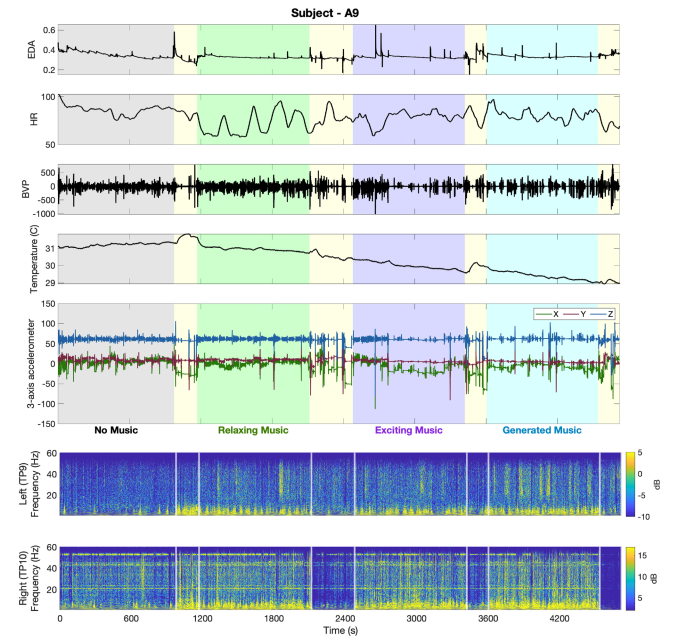

# Patient A1

In [2]:
# Define the file paths for the A1 data files
EEG_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A1\EEG_recording.csv'
Left_ACC_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A1\Left_ACC.csv'
Left_BVP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A1\Left_BVP.csv'
Left_EDA_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A1\Left_EDA.csv'
Left_HR_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A1\Left_HR.csv'
Left_IBI_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A1\Left_IBI.csv'
Left_tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A1\Left_tags.csv'
Left_TEMP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A1\Left_TEMP.csv'
n_back_responses_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A1\n_back_responses.csv'
Right_ACC_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A1\Right_ACC.csv'
Right_BVP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A1\Right_BVP.csv'
Right_EDA_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A1\Right_EDA.csv'
Right_HR_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A1\Right_HR.csv'
Right_IBI_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A1\Right_IBI.csv'
Right_tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A1\Right_tags.csv'
Right_TEMP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A1\Right_TEMP.csv'
tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A1\tags.csv'

###  Load  data into a DataFrame
### n back responses

The experiment settings and behavioral signals can be found in the ‘n_back_responses.csv’ file. The .csv file is in the following format:
- The “ExperimentName” specifies the experiment of the study.
- The “Instruction” specifies the presented n-back task at each trial.
- The “Running [Block]” displays the applied actuator within each session.

In the designed n-back experiments, subjects were shown trials of stimulus (500 ms) along with a plus sign (fixation cross) for their response (1500 ms). The behavioral signals including the reaction time (RT) and correct/incorrect response are stored under the “Stimulus” and “Fixation” categories.

In experiment 1, the reaction times (milliseconds) associated with session 1 to session 4 are stored within “Fixation101.RT” to “Fixation104.RT” and “Stimulus101.RT” to “Stimulus104.RT”. The binary correct/incorrect responses associated with session 1 to session 4 are stored within “Fixation101.ACC” to “Fixation104.ACC” and “Stimulus101.ACC” to “Stimulus104.ACC”.

In [3]:
n_backr_df=pd.read_csv(n_back_responses_file)
n_backr_df

,ExperimentName,Start_time_unix,Subject,Session,DataFile.Basename,Display.RefreshRate,ExperimentVersion,Group,InstructionNewMusic.DEVICE,InstructionNoMusic.DEVICE,...,TrialList8.Cycle,TrialList8.Sample,TSO,TSTh,TSvO,TSvTh,TSxO,TSxTh,TTO,TTTh
0,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,1.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,1.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,1.0,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,1.0,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1452,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1453,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1454,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
n_backr_df.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 250 columns):
 #    Column                                   Non-Null Count  Dtype  
---   ------                                   --------------  -----  
 0    ExperimentName                           1456 non-null   object 
 1    Start_time_unix                          1456 non-null   int64  
 2    Subject                                  1456 non-null   int64  
 3    Session                                  1456 non-null   int64  
 4    DataFile.Basename                        1456 non-null   object 
 5    Display.RefreshRate                      1456 non-null   float64
 6    ExperimentVersion                        1456 non-null   object 
 7    Group                                    1456 non-null   int64  
 8    InstructionNewMusic.DEVICE               1456 non-null   object 
 9    InstructionNoMusic.DEVICE                1456 non-null   object 
 10   InstructionNoMusic.DurationError  

In [5]:
df_length=len(n_backr_df)

I'm gonna show only the complete values with non null values

In [6]:
# Filter columns with length 1456
non_null_columns = [col for col in n_backr_df.columns if n_backr_df[col].notnull().all()]
# Create a new DataFrame with only columns of the same length as the DataFrame
complete_df = n_backr_df[non_null_columns]
complete_df

,ExperimentName,Start_time_unix,Subject,Session,DataFile.Basename,Display.RefreshRate,ExperimentVersion,Group,InstructionNewMusic.DEVICE,InstructionNoMusic.DEVICE,...,Welcome.DurationError,Welcome.OnsetDelay,Welcome.OnsetTime,Welcome.OnsetToOnsetTime,Block,Instruction,ListName,Procedure[Block],Running[Block],Trigger
0,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,-999999,24,64846,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
1,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,-999999,24,64846,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
2,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,-999999,24,64846,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
3,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,-999999,24,64846,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
4,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,-999999,24,64846,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,-999999,24,64846,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1452,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,-999999,24,64846,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1453,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,-999999,24,64846,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1454,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,-999999,24,64846,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2


In [7]:
complete_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 42 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   ExperimentName                           1456 non-null   object 
 1   Start_time_unix                          1456 non-null   int64  
 2   Subject                                  1456 non-null   int64  
 3   Session                                  1456 non-null   int64  
 4   DataFile.Basename                        1456 non-null   object 
 5   Display.RefreshRate                      1456 non-null   float64
 6   ExperimentVersion                        1456 non-null   object 
 7   Group                                    1456 non-null   int64  
 8   InstructionNewMusic.DEVICE               1456 non-null   object 
 9   InstructionNoMusic.DEVICE                1456 non-null   object 
 10  InstructionNoMusic.DurationError         1456 no

Check if there are another categories in every category column.

In [8]:
n_backr_df['ExperimentName'].unique()

array(['Experiment_1'], dtype=object)

- The “Instruction” specifies the presented n-back task at each trial.
- The “Running [Block]” displays the applied actuator within each session.

In [9]:
n_backr_df['Running[Block]'].unique()

array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object)

In [10]:
n_backr_df['Running[Block]'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 1456 entries, 0 to 1455
Series name: Running[Block]
Non-Null Count  Dtype 
--------------  ----- 
1456 non-null   object
dtypes: object(1)
memory usage: 11.5+ KB


In [11]:
n_backr_df[n_backr_df['Running[Block]']=='NewMusicSession']

,ExperimentName,Start_time_unix,Subject,Session,DataFile.Basename,Display.RefreshRate,ExperimentVersion,Group,InstructionNewMusic.DEVICE,InstructionNoMusic.DEVICE,...,TrialList8.Cycle,TrialList8.Sample,TSO,TSTh,TSvO,TSvTh,TSxO,TSxTh,TTO,TTTh
1103,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1104,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1105,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1106,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1107,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1452,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1453,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1454,Experiment_1,1624262243,1,1,Experiment_1-1-1,75.03,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


There are 4 actuators in 'Running[Block]' Session ['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession']

The best plan will be separate my nback trials of Instructions columns

In [12]:
instruction = n_backr_df.columns
instruction[instruction.str.contains('Instruction')]
#.str.contains('SNOMED')]

Index(['InstructionNewMusic.DEVICE', 'InstructionNoMusic.DEVICE',
       'InstructionNoMusic.DurationError', 'InstructionNoMusic.OnsetDelay',
       'InstructionNoMusic.OnsetTime', 'InstructionNoMusic.OnsetToOnsetTime',
       'InstructionRelaxMusic.DEVICE', 'InstructionRelaxMusic.DurationError',
       'InstructionRelaxMusic.OnsetDelay', 'InstructionRelaxMusic.OnsetTime',
       'InstructionRelaxMusic.OnsetToOnsetTime',
       'InstructionStressMusic.DEVICE', 'InstructionStressMusic.DurationError',
       'InstructionStressMusic.OnsetDelay', 'InstructionStressMusic.OnsetTime',
       'InstructionStressMusic.OnsetToOnsetTime', 'Instruction'],
      dtype='object')

In [13]:
instruction_df=n_backr_df[instruction[instruction.str.contains('Instruction')]]

In [14]:
instruction_df

,InstructionNewMusic.DEVICE,InstructionNoMusic.DEVICE,InstructionNoMusic.DurationError,InstructionNoMusic.OnsetDelay,InstructionNoMusic.OnsetTime,InstructionNoMusic.OnsetToOnsetTime,InstructionRelaxMusic.DEVICE,InstructionRelaxMusic.DurationError,InstructionRelaxMusic.OnsetDelay,InstructionRelaxMusic.OnsetTime,InstructionRelaxMusic.OnsetToOnsetTime,InstructionStressMusic.DEVICE,InstructionStressMusic.DurationError,InstructionStressMusic.OnsetDelay,InstructionStressMusic.OnsetTime,InstructionStressMusic.OnsetToOnsetTime,Instruction
0,Chronos,Chronos,-999999,17,218214,0,Chronos,-999999,15,1317034,0,Chronos,-999999,26,2606235,0,1-Back Task \n\n Press TARGET if current lette...
1,Chronos,Chronos,-999999,17,218214,0,Chronos,-999999,15,1317034,0,Chronos,-999999,26,2606235,0,1-Back Task \n\n Press TARGET if current lette...
2,Chronos,Chronos,-999999,17,218214,0,Chronos,-999999,15,1317034,0,Chronos,-999999,26,2606235,0,1-Back Task \n\n Press TARGET if current lette...
3,Chronos,Chronos,-999999,17,218214,0,Chronos,-999999,15,1317034,0,Chronos,-999999,26,2606235,0,1-Back Task \n\n Press TARGET if current lette...
4,Chronos,Chronos,-999999,17,218214,0,Chronos,-999999,15,1317034,0,Chronos,-999999,26,2606235,0,1-Back Task \n\n Press TARGET if current lette...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,Chronos,Chronos,-999999,17,218214,0,Chronos,-999999,15,1317034,0,Chronos,-999999,26,2606235,0,One Back Task \n\n Press TARGET if current let...
1452,Chronos,Chronos,-999999,17,218214,0,Chronos,-999999,15,1317034,0,Chronos,-999999,26,2606235,0,One Back Task \n\n Press TARGET if current let...
1453,Chronos,Chronos,-999999,17,218214,0,Chronos,-999999,15,1317034,0,Chronos,-999999,26,2606235,0,One Back Task \n\n Press TARGET if current let...
1454,Chronos,Chronos,-999999,17,218214,0,Chronos,-999999,15,1317034,0,Chronos,-999999,26,2606235,0,One Back Task \n\n Press TARGET if current let...


In [15]:
n_backr_df['Instruction'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 1456 entries, 0 to 1455
Series name: Instruction
Non-Null Count  Dtype 
--------------  ----- 
1456 non-null   object
dtypes: object(1)
memory usage: 11.5+ KB


In [16]:
n_backr_df['Instruction'].unique()

array(['1-Back Task \\n\\n Press TARGET if current letter is same as the previous letter\\n\\n',
       '3-Back Task \\n\\n Press TARGET if current letter is same as the third previous letter\\n\\n',
       'One Back Task \\n\\n Press TARGET if current letter is same as the previous letter\\n\\n',
       'Three Back Task \\n\\n Press TARGET if current letter is same as the third previous letter\\n\\n',
       'Rest'], dtype=object)

Certainly, there are unique values but it seems that the first element of this list is the same with the thir element, also the second element is the same with the fourth element. Because in one case is prefering to mentioned the number "1" or "3" instead of texting "ONE" and "Three".

In the designed n-back experiments, subjects were shown trials of stimulus (500 ms) along with a plus sign (fixation cross) for their response (1500 ms). The behavioral signals including the reaction time (RT) and correct/incorrect response are stored under the “Stimulus” and “Fixation” categories.

In experiment 1, the reaction times (milliseconds) associated with session 1 to session 4 are stored within “Fixation101.RT” to “Fixation104.RT” and “Stimulus101.RT” to “Stimulus104.RT”. The binary correct/incorrect responses associated with session 1 to session 4 are stored within “Fixation101.ACC” to “Fixation104.ACC” and “Stimulus101.ACC” to “Stimulus104.ACC”.

In [17]:
n_backr_df['Session'].unique()

array([1], dtype=int64)

It seems there is only 1 session in this data set. So maybe it's gonna work with the sufix 101. Or my session it;s regards with the categories of RUNNING[BLOCk]

In [18]:
stimulus = n_backr_df.columns
stimulus=stimulus[stimulus.str.contains('Stimulus')]

In [19]:
stimulus

Index(['Stimulus100.ACC', 'Stimulus100.CRESP', 'Stimulus100.DEVICE',
       'Stimulus100.DurationError', 'Stimulus100.OnsetDelay',
       'Stimulus100.OnsetTime', 'Stimulus100.OnsetToOnsetTime',
       'Stimulus100.RESP', 'Stimulus100.RT', 'Stimulus100.RTTime',
       'Stimulus101.ACC', 'Stimulus101.CRESP', 'Stimulus101.DEVICE',
       'Stimulus101.DurationError', 'Stimulus101.OnsetDelay',
       'Stimulus101.OnsetTime', 'Stimulus101.OnsetToOnsetTime',
       'Stimulus101.RESP', 'Stimulus101.RT', 'Stimulus101.RTTime',
       'Stimulus102.ACC', 'Stimulus102.CRESP', 'Stimulus102.DEVICE',
       'Stimulus102.DurationError', 'Stimulus102.OnsetDelay',
       'Stimulus102.OnsetTime', 'Stimulus102.OnsetToOnsetTime',
       'Stimulus102.RESP', 'Stimulus102.RT', 'Stimulus102.RTTime',
       'Stimulus103.ACC', 'Stimulus103.CRESP', 'Stimulus103.DEVICE',
       'Stimulus103.DurationError', 'Stimulus103.OnsetDelay',
       'Stimulus103.OnsetTime', 'Stimulus103.OnsetToOnsetTime',
       'Stimulus103

In [20]:
n_backr_df[['Stimulus100.ACC','Running[Block]']]

,Stimulus100.ACC,Running[Block]
0,0.0,PracticeSession
1,1.0,PracticeSession
2,1.0,PracticeSession
3,1.0,PracticeSession
4,1.0,PracticeSession
...,...,...
1451,NaN,NewMusicSession
1452,NaN,NewMusicSession
1453,NaN,NewMusicSession
1454,NaN,NewMusicSession


In [21]:
n_backr_df[['Stimulus100.ACC','Running[Block]']].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 2 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Stimulus100.ACC  44 non-null     float64
 1   Running[Block]   1456 non-null   object 
dtypes: float64(1), object(1)
memory usage: 22.9+ KB


In [22]:
# Filter rows where 'Running[Block]' is 'New music' or 'practice'
filtered_df = (n_backr_df[n_backr_df['Running[Block]']
                          .isin(n_backr_df['Running[Block]']
                                .unique()[1:])])
filtered_df[['Stimulus100.ACC','Running[Block]']]

,Stimulus100.ACC,Running[Block]
44,NaN,NoMusic
45,NaN,NoMusic
46,NaN,NoMusic
47,NaN,NoMusic
48,NaN,NoMusic
...,...,...
1451,NaN,NewMusicSession
1452,NaN,NewMusicSession
1453,NaN,NewMusicSession
1454,NaN,NewMusicSession


In [23]:
filtered_df[['Stimulus100.ACC','Running[Block]']].info()

<class 'pandas.core.frame.DataFrame'>
Index: 1412 entries, 44 to 1455
Data columns (total 2 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Stimulus100.ACC  0 non-null      float64
 1   Running[Block]   1412 non-null   object 
dtypes: float64(1), object(1)
memory usage: 33.1+ KB


This shows that session that the information mentioned is the values of 'Running[Block]'

In [24]:
# Create a dictionary to store the mapping of columns to Running[Block] values
column_to_block = {}
running_block_values=n_backr_df['Running[Block]'].unique()
# Create a dictionary to store the mapping of stimulus columns to lists of Running[Block] values

stimulus_to_blocks = {}

# Iterate over each stimulus column
for col in stimulus:
    # Store all 4 Running[Block] values as a list for this stimulus column
    stimulus_to_blocks[col] = running_block_values

print(stimulus_to_blocks)

{'Stimulus100.ACC': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.CRESP': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.DEVICE': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.DurationError': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetDelay': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetTime': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetToOnsetTime': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.RESP': array(['PracticeSessi

In [25]:
stimulus_to_blocks['Stimulus100.ACC']

array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object)

In [26]:
# Create a new dictionary to store the suffixed keys and values
suffixed_dict = {}

# Iterate over each key in stimulus_to_blocks dictionary
for key, values in stimulus_to_blocks.items():
    # Get the prefix (e.g., 'Stimulus100') from the key
    prefix = key.split('.')[0]
    
    # Create a list to store the suffixed column names
    suffixed_columns = []
    
    # Iterate over each column name in stimulus_columns
    for col in stimulus:
        # If the column name starts with the same prefix
        if col.startswith(prefix):
            # Append the suffixed column name to the list
            suffixed_columns.append(col)
    
    # Create the suffixed key by joining the prefix with ':'
    suffixed_key = f'{prefix}:'
    
    # Add the suffixed column names list as the value for the suffixed key
    suffixed_dict[suffixed_key] = suffixed_columns

print(suffixed_dict)

{'Stimulus100:': ['Stimulus100.ACC', 'Stimulus100.CRESP', 'Stimulus100.DEVICE', 'Stimulus100.DurationError', 'Stimulus100.OnsetDelay', 'Stimulus100.OnsetTime', 'Stimulus100.OnsetToOnsetTime', 'Stimulus100.RESP', 'Stimulus100.RT', 'Stimulus100.RTTime'], 'Stimulus101:': ['Stimulus101.ACC', 'Stimulus101.CRESP', 'Stimulus101.DEVICE', 'Stimulus101.DurationError', 'Stimulus101.OnsetDelay', 'Stimulus101.OnsetTime', 'Stimulus101.OnsetToOnsetTime', 'Stimulus101.RESP', 'Stimulus101.RT', 'Stimulus101.RTTime'], 'Stimulus102:': ['Stimulus102.ACC', 'Stimulus102.CRESP', 'Stimulus102.DEVICE', 'Stimulus102.DurationError', 'Stimulus102.OnsetDelay', 'Stimulus102.OnsetTime', 'Stimulus102.OnsetToOnsetTime', 'Stimulus102.RESP', 'Stimulus102.RT', 'Stimulus102.RTTime'], 'Stimulus103:': ['Stimulus103.ACC', 'Stimulus103.CRESP', 'Stimulus103.DEVICE', 'Stimulus103.DurationError', 'Stimulus103.OnsetDelay', 'Stimulus103.OnsetTime', 'Stimulus103.OnsetToOnsetTime', 'Stimulus103.RESP', 'Stimulus103.RT', 'Stimulus103.R

In [27]:
# # Get columns associated with the key 'Stimulus100:'
# stimulus100_columns = suffixed_dict['Stimulus100:']

# # Filter the DataFrame based on the selected columns
# n_backr_df[stimulus100_columns]



In [28]:
# Filter columns that start with 'Stimulus100'
stimulus100_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus100')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
stimulus100_df=n_backr_df[stimulus100_columns]
stimulus100_df


,Stimulus100.ACC,Stimulus100.CRESP,Stimulus100.DEVICE,Stimulus100.DurationError,Stimulus100.OnsetDelay,Stimulus100.OnsetTime,Stimulus100.OnsetToOnsetTime,Stimulus100.RESP,Stimulus100.RT,Stimulus100.RTTime,Running[Block]
0,0.0,3.0,Chronos,2.0,-2.0,93008.0,0.0,4.0,286.0,93294.0,PracticeSession
1,1.0,3.0,Chronos,2.0,6.0,94808.0,0.0,3.0,406.0,95214.0,PracticeSession
2,1.0,3.0,Chronos,2.0,19.0,96740.0,0.0,3.0,357.0,97097.0,PracticeSession
3,1.0,4.0,Chronos,1.0,19.0,98633.0,0.0,4.0,385.0,99018.0,PracticeSession
4,1.0,4.0,Chronos,1.0,19.0,100552.0,0.0,4.0,322.0,100874.0,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


In [29]:
# Filter columns that start with 'Stimulus100'
stimulus101_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus101')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus101_df=n_backr_df[stimulus101_columns]
stimulus101_df

,Stimulus101.ACC,Stimulus101.CRESP,Stimulus101.DEVICE,Stimulus101.DurationError,Stimulus101.OnsetDelay,Stimulus101.OnsetTime,Stimulus101.OnsetToOnsetTime,Stimulus101.RESP,Stimulus101.RT,Stimulus101.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


In [30]:
stimulus101_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 11 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Stimulus101.ACC               352 non-null    float64
 1   Stimulus101.CRESP             352 non-null    float64
 2   Stimulus101.DEVICE            352 non-null    object 
 3   Stimulus101.DurationError     352 non-null    float64
 4   Stimulus101.OnsetDelay        352 non-null    float64
 5   Stimulus101.OnsetTime         352 non-null    float64
 6   Stimulus101.OnsetToOnsetTime  352 non-null    float64
 7   Stimulus101.RESP              350 non-null    float64
 8   Stimulus101.RT                352 non-null    float64
 9   Stimulus101.RTTime            352 non-null    float64
 10  Running[Block]                1456 non-null   object 
dtypes: float64(9), object(2)
memory usage: 125.3+ KB


In [31]:
# Filter columns that start with 'Stimulus100'
stimulus102_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus102')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus102_df=n_backr_df[stimulus102_columns]
stimulus102_df

,Stimulus102.ACC,Stimulus102.CRESP,Stimulus102.DEVICE,Stimulus102.DurationError,Stimulus102.OnsetDelay,Stimulus102.OnsetTime,Stimulus102.OnsetToOnsetTime,Stimulus102.RESP,Stimulus102.RT,Stimulus102.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


In [32]:
stimulus102_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 11 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Stimulus102.ACC               352 non-null    float64
 1   Stimulus102.CRESP             352 non-null    float64
 2   Stimulus102.DEVICE            352 non-null    object 
 3   Stimulus102.DurationError     352 non-null    float64
 4   Stimulus102.OnsetDelay        352 non-null    float64
 5   Stimulus102.OnsetTime         352 non-null    float64
 6   Stimulus102.OnsetToOnsetTime  352 non-null    float64
 7   Stimulus102.RESP              344 non-null    float64
 8   Stimulus102.RT                352 non-null    float64
 9   Stimulus102.RTTime            352 non-null    float64
 10  Running[Block]                1456 non-null   object 
dtypes: float64(9), object(2)
memory usage: 125.3+ KB


In [33]:
# Filter columns that start with 'Stimulus100'
stimulus103_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus103')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus103_df=n_backr_df[stimulus103_columns]
stimulus103_df

,Stimulus103.ACC,Stimulus103.CRESP,Stimulus103.DEVICE,Stimulus103.DurationError,Stimulus103.OnsetDelay,Stimulus103.OnsetTime,Stimulus103.OnsetToOnsetTime,Stimulus103.RESP,Stimulus103.RT,Stimulus103.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


In [34]:
stimulus103_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 11 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Stimulus103.ACC               352 non-null    float64
 1   Stimulus103.CRESP             352 non-null    float64
 2   Stimulus103.DEVICE            352 non-null    object 
 3   Stimulus103.DurationError     352 non-null    float64
 4   Stimulus103.OnsetDelay        352 non-null    float64
 5   Stimulus103.OnsetTime         352 non-null    float64
 6   Stimulus103.OnsetToOnsetTime  352 non-null    float64
 7   Stimulus103.RESP              346 non-null    float64
 8   Stimulus103.RT                352 non-null    float64
 9   Stimulus103.RTTime            352 non-null    float64
 10  Running[Block]                1456 non-null   object 
dtypes: float64(9), object(2)
memory usage: 125.3+ KB


In [35]:
# Filter columns that start with 'Stimulus100'
stimulus104_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus104')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus104_df=n_backr_df[stimulus104_columns]
stimulus104_df

,Stimulus104.ACC,Stimulus104.CRESP,Stimulus104.DEVICE,Stimulus104.DurationError,Stimulus104.OnsetDelay,Stimulus104.OnsetTime,Stimulus104.OnsetToOnsetTime,Stimulus104.RESP,Stimulus104.RT,Stimulus104.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,1.0,3.0,Chronos,1.0,20.0,4611509.0,0.0,3.0,317.0,4611826.0,NewMusicSession
1452,1.0,3.0,Chronos,2.0,19.0,4613361.0,0.0,3.0,296.0,4613657.0,NewMusicSession
1453,1.0,3.0,Chronos,2.0,19.0,4615187.0,0.0,3.0,210.0,4615397.0,NewMusicSession
1454,1.0,4.0,Chronos,2.0,19.0,4616933.0,0.0,4.0,423.0,4617356.0,NewMusicSession


In [36]:
stimulus104_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 11 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Stimulus104.ACC               352 non-null    float64
 1   Stimulus104.CRESP             352 non-null    float64
 2   Stimulus104.DEVICE            352 non-null    object 
 3   Stimulus104.DurationError     352 non-null    float64
 4   Stimulus104.OnsetDelay        352 non-null    float64
 5   Stimulus104.OnsetTime         352 non-null    float64
 6   Stimulus104.OnsetToOnsetTime  352 non-null    float64
 7   Stimulus104.RESP              337 non-null    float64
 8   Stimulus104.RT                352 non-null    float64
 9   Stimulus104.RTTime            352 non-null    float64
 10  Running[Block]                1456 non-null   object 
dtypes: float64(9), object(2)
memory usage: 125.3+ KB


In [37]:
n_back_columns = n_backr_df.columns
fixation=n_back_columns[n_back_columns.str.contains('Fixation')]

In [38]:
fixation

Index(['Fixation100.ACC', 'Fixation100.CRESP', 'Fixation100.DEVICE',
       'Fixation100.DurationError', 'Fixation100.OnsetDelay',
       'Fixation100.OnsetTime', 'Fixation100.OnsetToOnsetTime',
       'Fixation100.RESP', 'Fixation100.RT', 'Fixation100.RTTime',
       'Fixation101.ACC', 'Fixation101.CRESP', 'Fixation101.DEVICE',
       'Fixation101.DurationError', 'Fixation101.OnsetDelay',
       'Fixation101.OnsetTime', 'Fixation101.OnsetToOnsetTime',
       'Fixation101.RESP', 'Fixation101.RT', 'Fixation101.RTTime',
       'Fixation102.ACC', 'Fixation102.CRESP', 'Fixation102.DEVICE',
       'Fixation102.DurationError', 'Fixation102.OnsetDelay',
       'Fixation102.OnsetTime', 'Fixation102.OnsetToOnsetTime',
       'Fixation102.RESP', 'Fixation102.RT', 'Fixation102.RTTime',
       'Fixation103.ACC', 'Fixation103.CRESP', 'Fixation103.DEVICE',
       'Fixation103.DurationError', 'Fixation103.OnsetDelay',
       'Fixation103.OnsetTime', 'Fixation103.OnsetToOnsetTime',
       'Fixation103

In [39]:
fixation_df=n_backr_df[n_back_columns[n_back_columns.str.contains('Fixation')]]

In [40]:
fixation_df

,Fixation100.ACC,Fixation100.CRESP,Fixation100.DEVICE,Fixation100.DurationError,Fixation100.OnsetDelay,Fixation100.OnsetTime,Fixation100.OnsetToOnsetTime,Fixation100.RESP,Fixation100.RT,Fixation100.RTTime,...,Fixation104.ACC,Fixation104.CRESP,Fixation104.DEVICE,Fixation104.DurationError,Fixation104.OnsetDelay,Fixation104.OnsetTime,Fixation104.OnsetToOnsetTime,Fixation104.RESP,Fixation104.RT,Fixation104.RTTime
0,1.0,3.0,Chronos,1.0,8.0,93302.0,0.0,3.0,576.0,93878.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.0,3.0,Chronos,1.0,7.0,95221.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0.0,3.0,Chronos,1.0,17.0,97114.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0.0,4.0,Chronos,1.0,15.0,99033.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0.0,4.0,Chronos,2.0,11.0,100885.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,3.0,Chronos,2.0,15.0,4611842.0,0.0,NaN,0.0,0.0
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,3.0,Chronos,2.0,10.0,4613668.0,0.0,NaN,0.0,0.0
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,3.0,Chronos,1.0,17.0,4615414.0,0.0,NaN,0.0,0.0
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,4.0,Chronos,2.0,17.0,4617373.0,0.0,NaN,0.0,0.0


In [41]:
# Create a dictionary to store the mapping of stimulus columns to lists of Running[Block] values

fixation_to_blocks = {}

# Iterate over each stimulus column
for col in fixation:
    # Store all 4 Running[Block] values as a list for this stimulus column
    fixation_to_blocks[col] = running_block_values

print(fixation_to_blocks)

{'Fixation100.ACC': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Fixation100.CRESP': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Fixation100.DEVICE': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Fixation100.DurationError': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Fixation100.OnsetDelay': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Fixation100.OnsetTime': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Fixation100.OnsetToOnsetTime': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Fixation100.RESP': array(['PracticeSessi

In [42]:
# Create a new dictionary to store the suffixed keys and values
fix_suffixed_dict = {}

# Iterate over each key in stimulus_to_blocks dictionary
for key, values in fixation_to_blocks.items():
    # Get the prefix (e.g., 'Stimulus100') from the key
    prefix = key.split('.')[0]
    
    # Create a list to store the suffixed column names
    suffixed_columns = []
    
    # Iterate over each column name in stimulus_columns
    for col in fixation:
        # If the column name starts with the same prefix
        if col.startswith(prefix):
            # Append the suffixed column name to the list
            suffixed_columns.append(col)
    
    # Create the suffixed key by joining the prefix with ':'
    suffixed_key = f'{prefix}:'
    
    # Add the suffixed column names list as the value for the suffixed key
    fix_suffixed_dict[suffixed_key] = suffixed_columns

print(fix_suffixed_dict)

{'Fixation100:': ['Fixation100.ACC', 'Fixation100.CRESP', 'Fixation100.DEVICE', 'Fixation100.DurationError', 'Fixation100.OnsetDelay', 'Fixation100.OnsetTime', 'Fixation100.OnsetToOnsetTime', 'Fixation100.RESP', 'Fixation100.RT', 'Fixation100.RTTime'], 'Fixation101:': ['Fixation101.ACC', 'Fixation101.CRESP', 'Fixation101.DEVICE', 'Fixation101.DurationError', 'Fixation101.OnsetDelay', 'Fixation101.OnsetTime', 'Fixation101.OnsetToOnsetTime', 'Fixation101.RESP', 'Fixation101.RT', 'Fixation101.RTTime'], 'Fixation102:': ['Fixation102.ACC', 'Fixation102.CRESP', 'Fixation102.DEVICE', 'Fixation102.DurationError', 'Fixation102.OnsetDelay', 'Fixation102.OnsetTime', 'Fixation102.OnsetToOnsetTime', 'Fixation102.RESP', 'Fixation102.RT', 'Fixation102.RTTime'], 'Fixation103:': ['Fixation103.ACC', 'Fixation103.CRESP', 'Fixation103.DEVICE', 'Fixation103.DurationError', 'Fixation103.OnsetDelay', 'Fixation103.OnsetTime', 'Fixation103.OnsetToOnsetTime', 'Fixation103.RESP', 'Fixation103.RT', 'Fixation103.R

In [43]:
# Filter columns that start with 'Stimulus100'
fixation100_columns = [col for col in n_backr_df.columns if col.startswith('Fixation100')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation100_df=n_backr_df[fixation100_columns]
fixation100_df


,Fixation100.ACC,Fixation100.CRESP,Fixation100.DEVICE,Fixation100.DurationError,Fixation100.OnsetDelay,Fixation100.OnsetTime,Fixation100.OnsetToOnsetTime,Fixation100.RESP,Fixation100.RT,Fixation100.RTTime,Running[Block]
0,1.0,3.0,Chronos,1.0,8.0,93302.0,0.0,3.0,576.0,93878.0,PracticeSession
1,0.0,3.0,Chronos,1.0,7.0,95221.0,0.0,NaN,0.0,0.0,PracticeSession
2,0.0,3.0,Chronos,1.0,17.0,97114.0,0.0,NaN,0.0,0.0,PracticeSession
3,0.0,4.0,Chronos,1.0,15.0,99033.0,0.0,NaN,0.0,0.0,PracticeSession
4,0.0,4.0,Chronos,2.0,11.0,100885.0,0.0,NaN,0.0,0.0,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


In [44]:
fixation100_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 11 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Fixation100.ACC               44 non-null     float64
 1   Fixation100.CRESP             44 non-null     float64
 2   Fixation100.DEVICE            44 non-null     object 
 3   Fixation100.DurationError     44 non-null     float64
 4   Fixation100.OnsetDelay        44 non-null     float64
 5   Fixation100.OnsetTime         44 non-null     float64
 6   Fixation100.OnsetToOnsetTime  44 non-null     float64
 7   Fixation100.RESP              6 non-null      float64
 8   Fixation100.RT                44 non-null     float64
 9   Fixation100.RTTime            44 non-null     float64
 10  Running[Block]                1456 non-null   object 
dtypes: float64(9), object(2)
memory usage: 125.3+ KB


In [45]:
# Filter columns that start with 'Stimulus100'
fixation101_columns = [col for col in n_backr_df.columns if col.startswith('Fixation101')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation101_df=n_backr_df[fixation101_columns]
fixation101_df


,Fixation101.ACC,Fixation101.CRESP,Fixation101.DEVICE,Fixation101.DurationError,Fixation101.OnsetDelay,Fixation101.OnsetTime,Fixation101.OnsetToOnsetTime,Fixation101.RESP,Fixation101.RT,Fixation101.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


In [46]:
fixation101_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 11 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Fixation101.ACC               352 non-null    float64
 1   Fixation101.CRESP             352 non-null    float64
 2   Fixation101.DEVICE            352 non-null    object 
 3   Fixation101.DurationError     352 non-null    float64
 4   Fixation101.OnsetDelay        352 non-null    float64
 5   Fixation101.OnsetTime         352 non-null    float64
 6   Fixation101.OnsetToOnsetTime  352 non-null    float64
 7   Fixation101.RESP              6 non-null      float64
 8   Fixation101.RT                352 non-null    float64
 9   Fixation101.RTTime            352 non-null    float64
 10  Running[Block]                1456 non-null   object 
dtypes: float64(9), object(2)
memory usage: 125.3+ KB


In [47]:
# Filter columns that start with 'Stimulus100'
fixation102_columns = [col for col in n_backr_df.columns if col.startswith('Fixation102')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation102_df=n_backr_df[fixation102_columns]
fixation102_df

,Fixation102.ACC,Fixation102.CRESP,Fixation102.DEVICE,Fixation102.DurationError,Fixation102.OnsetDelay,Fixation102.OnsetTime,Fixation102.OnsetToOnsetTime,Fixation102.RESP,Fixation102.RT,Fixation102.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


In [48]:
fixation102_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 11 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Fixation102.ACC               352 non-null    float64
 1   Fixation102.CRESP             352 non-null    float64
 2   Fixation102.DEVICE            352 non-null    object 
 3   Fixation102.DurationError     352 non-null    float64
 4   Fixation102.OnsetDelay        352 non-null    float64
 5   Fixation102.OnsetTime         352 non-null    float64
 6   Fixation102.OnsetToOnsetTime  352 non-null    float64
 7   Fixation102.RESP              15 non-null     float64
 8   Fixation102.RT                352 non-null    float64
 9   Fixation102.RTTime            352 non-null    float64
 10  Running[Block]                1456 non-null   object 
dtypes: float64(9), object(2)
memory usage: 125.3+ KB


In [49]:
# Filter columns that start with 'Stimulus100'
fixation103_columns = [col for col in n_backr_df.columns if col.startswith('Fixation103')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation103_df=n_backr_df[fixation103_columns]
fixation103_df

,Fixation103.ACC,Fixation103.CRESP,Fixation103.DEVICE,Fixation103.DurationError,Fixation103.OnsetDelay,Fixation103.OnsetTime,Fixation103.OnsetToOnsetTime,Fixation103.RESP,Fixation103.RT,Fixation103.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


In [50]:
fixation103_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 11 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Fixation103.ACC               352 non-null    float64
 1   Fixation103.CRESP             352 non-null    float64
 2   Fixation103.DEVICE            352 non-null    object 
 3   Fixation103.DurationError     352 non-null    float64
 4   Fixation103.OnsetDelay        352 non-null    float64
 5   Fixation103.OnsetTime         352 non-null    float64
 6   Fixation103.OnsetToOnsetTime  352 non-null    float64
 7   Fixation103.RESP              16 non-null     float64
 8   Fixation103.RT                352 non-null    float64
 9   Fixation103.RTTime            352 non-null    float64
 10  Running[Block]                1456 non-null   object 
dtypes: float64(9), object(2)
memory usage: 125.3+ KB


In [51]:
# Filter columns that start with 'Stimulus100'
fixation104_columns = [col for col in n_backr_df.columns if col.startswith('Fixation104')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation104_df=n_backr_df[fixation104_columns]
fixation104_df

,Fixation104.ACC,Fixation104.CRESP,Fixation104.DEVICE,Fixation104.DurationError,Fixation104.OnsetDelay,Fixation104.OnsetTime,Fixation104.OnsetToOnsetTime,Fixation104.RESP,Fixation104.RT,Fixation104.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,0.0,3.0,Chronos,2.0,15.0,4611842.0,0.0,NaN,0.0,0.0,NewMusicSession
1452,0.0,3.0,Chronos,2.0,10.0,4613668.0,0.0,NaN,0.0,0.0,NewMusicSession
1453,0.0,3.0,Chronos,1.0,17.0,4615414.0,0.0,NaN,0.0,0.0,NewMusicSession
1454,0.0,4.0,Chronos,2.0,17.0,4617373.0,0.0,NaN,0.0,0.0,NewMusicSession


In [52]:
fixation104_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 11 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Fixation104.ACC               352 non-null    float64
 1   Fixation104.CRESP             352 non-null    float64
 2   Fixation104.DEVICE            352 non-null    object 
 3   Fixation104.DurationError     352 non-null    float64
 4   Fixation104.OnsetDelay        352 non-null    float64
 5   Fixation104.OnsetTime         352 non-null    float64
 6   Fixation104.OnsetToOnsetTime  352 non-null    float64
 7   Fixation104.RESP              22 non-null     float64
 8   Fixation104.RT                352 non-null    float64
 9   Fixation104.RTTime            352 non-null    float64
 10  Running[Block]                1456 non-null   object 
dtypes: float64(9), object(2)
memory usage: 125.3+ KB


- Time to only show values or sufix RT in every table and their respective ACC binary solution.

### EG

The EEG signals recorded from the Muse headband are also included in the dataset as 'EEG_recording.csv'. They include EEG channels from four locations: TP9, AF7, AF8, and TP10. The 2016 model Muse (MU-02) can also output RAW EEG data at 256Hz as well as being able to output RAW EEG from the right ear USB Auxiliary connector (named Right AUX in the csv files). The column (timestamps) shows the data points in UNIX format. EEG measurements are labeled as TP9, AF7, AF8, TP10, Right AUX.

In [53]:
eeg_df=pd.read_csv(EEG_file)
eeg_df

,timestamps,TP9,AF7,AF8,TP10,Right AUX
0,1.624262e+09,34.180,50.781,34.180,-26.367,5.371
1,1.624262e+09,49.316,50.781,20.996,-8.789,-12.207
2,1.624262e+09,50.293,10.742,15.137,-2.441,-27.832
3,1.624262e+09,44.922,-19.043,16.602,-23.926,-33.203
4,1.624262e+09,19.531,20.020,31.250,-48.340,-30.273
...,...,...,...,...,...,...
1298131,1.624267e+09,-966.797,-809.570,-966.797,-966.797,-1000.000
1298132,1.624267e+09,-966.797,-854.492,-966.797,-966.797,-830.078
1298133,1.624267e+09,-966.797,-917.969,-966.797,-966.797,-826.172
1298134,1.624267e+09,-966.797,-971.191,-966.797,-966.797,-982.910


In [54]:
eeg_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1298136 entries, 0 to 1298135
Data columns (total 6 columns):
 #   Column      Non-Null Count    Dtype  
---  ------      --------------    -----  
 0   timestamps  1298136 non-null  float64
 1   TP9         1298136 non-null  float64
 2   AF7         1298136 non-null  float64
 3   AF8         1298136 non-null  float64
 4   TP10        1298136 non-null  float64
 5   Right AUX   1298136 non-null  float64
dtypes: float64(6)
memory usage: 59.4 MB


C:\Users\user\AppData\Roaming\Python\Python312\site-packages\IPython\core\pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


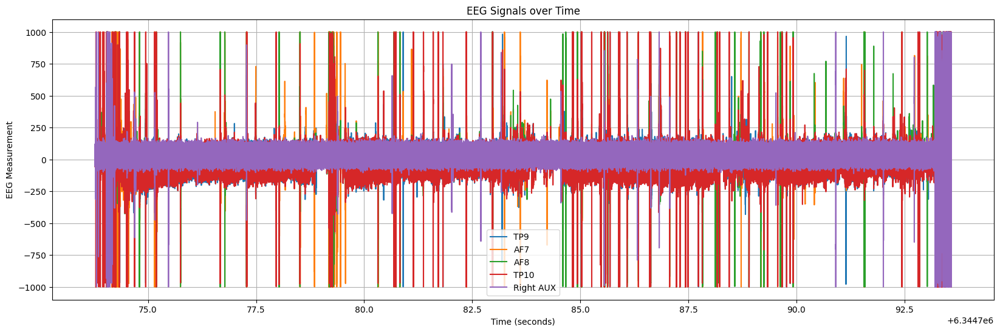

In [55]:
import matplotlib.pyplot as plt
# Extract the desired channels
channels = ['TP9', 'AF7', 'AF8', 'TP10', 'Right AUX']  # List of EEG channels to plot
eeg_data = eeg_df[channels]

# Convert the timestamps to time in seconds
sampling_rate = 256  # Sampling rate of the EEG data in Hz
time_seconds = eeg_df['timestamps'] / sampling_rate

# Plot the EEG signals over time
plt.figure(figsize=(20, 6))
for channel in channels:
    plt.plot(time_seconds, eeg_data[channel], label=channel)

# Add labels and legend
plt.title('EEG Signals over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('EEG Measurement')
plt.legend()
plt.grid(True)
plt.show()

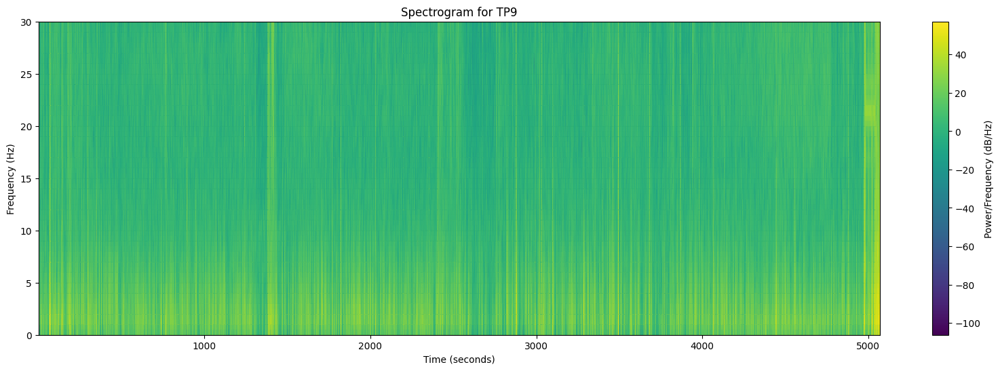

C:\Users\user\AppData\Local\Temp\ipykernel_29192\2195272341.py:35: RuntimeWarning: divide by zero encountered in log10
  plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap='viridis')


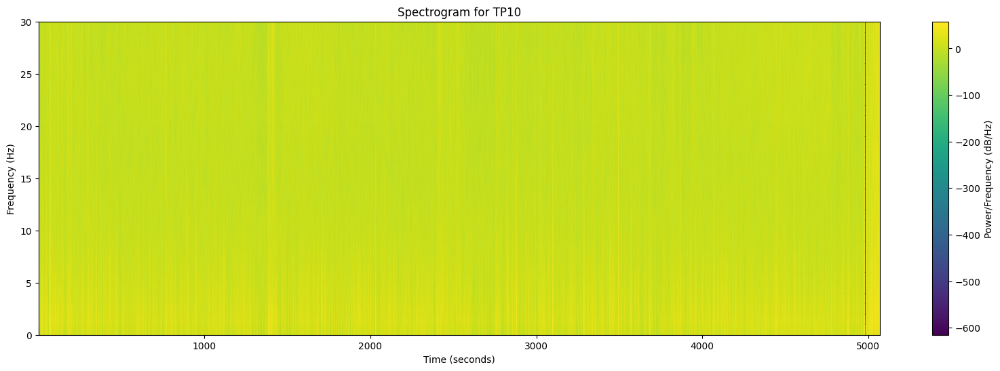

In [56]:
import matplotlib.pyplot as plt
from scipy import signal
# Extract the desired channels (TP9 and TP10)
channels = ['TP9', 'TP10']  
eeg_data = eeg_df[channels]

# Convert the timestamps to time in seconds
sampling_rate = 256  # Sampling rate of the EEG data in Hz
time_seconds = eeg_df['timestamps'] / sampling_rate

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 256    # Length of each segment
noverlap = 128   # Overlap between segments
nfft = 256       # Number of points for the FFT

# Compute the spectrogram for each channel
frequencies, times, spectrogram_TP9 = signal.spectrogram(eeg_data['TP9'], fs=sampling_rate, window=window, 
                                                         nperseg=nperseg, noverlap=noverlap, nfft=nfft)
_, _, spectrogram_TP10 = signal.spectrogram(eeg_data['TP10'], fs=sampling_rate, window=window, 
                                            nperseg=nperseg, noverlap=noverlap, nfft=nfft)

# Plot the spectrogram for TP9
plt.figure(figsize=(20, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP9), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP9')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
plt.show()

# Plot the spectrogram for TP10
plt.figure(figsize=(20, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP10')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
plt.show()

- High-pass filter above 1 Hz and low-pass filter below 50 Hz: We'll use a bandpass filter to achieve this.
- Downsample the signal from 256 to 128 Hz: We'll resample the filtered signal to achieve this.

C:\Users\user\AppData\Local\Temp\ipykernel_29192\2743015402.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eeg_data[channel] = signal.filtfilt(b, a, eeg_data[channel])


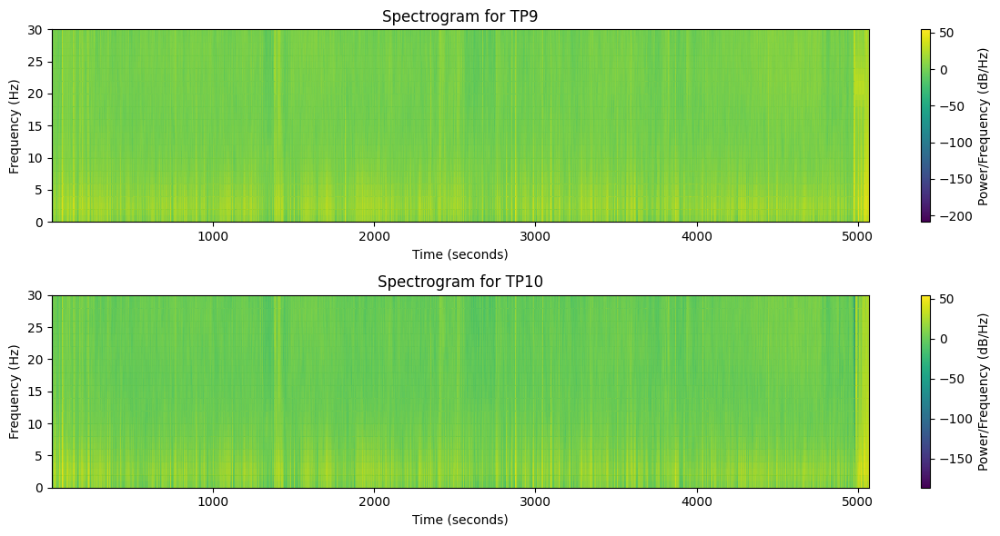

In [57]:
# Extract the desired channels (TP9 and TP10)
channels = ['TP9', 'TP10']  
eeg_data = eeg_df[channels]

# Convert the timestamps to time in seconds
sampling_rate = 256  # Sampling rate of the EEG data in Hz
time_seconds = eeg_df['timestamps'] / sampling_rate

# Preprocess the EEG signals
for channel in channels:
    # Apply high-pass filter above 1 Hz and low-pass filter below 50 Hz
    b, a = signal.butter(4, [1, 50], btype='bandpass', fs=sampling_rate)
    eeg_data[channel] = signal.filtfilt(b, a, eeg_data[channel])

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 128    # Length of each segment
noverlap = 64    # Overlap between segments
nfft = 128       # Number of points for the FFT

# Compute the spectrogram for each channel
frequencies, times, spectrogram_TP9 = signal.spectrogram(eeg_data['TP9'], fs=sampling_rate, window=window, 
                                                         nperseg=nperseg, noverlap=noverlap, nfft=nfft)
_, _, spectrogram_TP10 = signal.spectrogram(eeg_data['TP10'], fs=sampling_rate, window=window, 
                                            nperseg=nperseg, noverlap=noverlap, nfft=nfft)

# Plot the spectrogram for TP9
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP9), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP9')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz

# Plot the spectrogram for TP10
plt.subplot(2, 1, 2)
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP10')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz

plt.tight_layout()
plt.show()

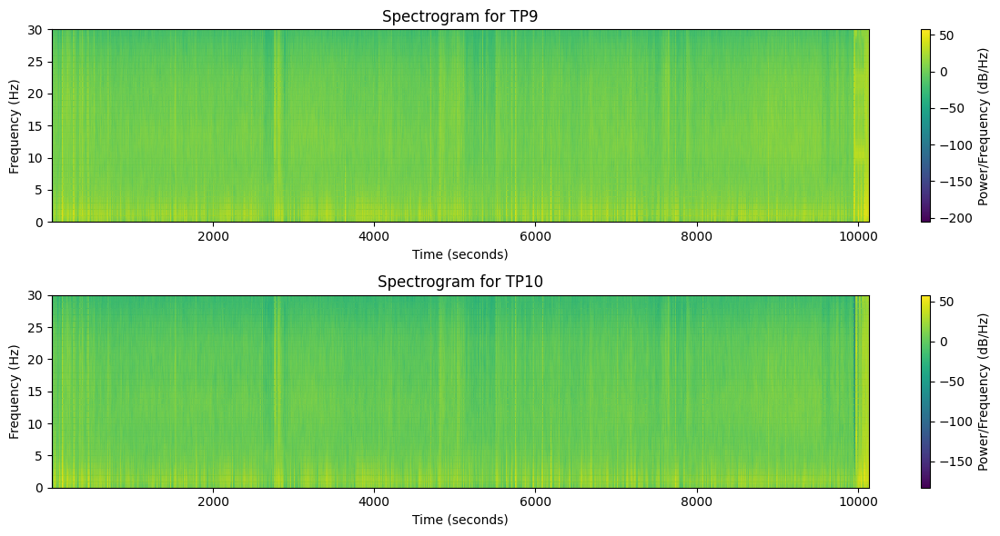

In [58]:
import numpy as np
import matplotlib.pyplot as plt

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 128    # Length of each segment
noverlap = 64    # Overlap between segments
nfft = 128       # Number of points for the FFT

# Compute the spectrogram for each channel
frequencies, times, spectrogram_TP9 = signal.spectrogram(eeg_data['TP9'], fs=sampling_rate / 2, window=window, 
                                                         nperseg=nperseg, noverlap=noverlap, nfft=nfft)
_, _, spectrogram_TP10 = signal.spectrogram(eeg_data['TP10'], fs=sampling_rate / 2, window=window, 
                                            nperseg=nperseg, noverlap=noverlap, nfft=nfft)

# Plot the spectrogram for TP9
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP9), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP9')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz

# Plot the spectrogram for TP10
plt.subplot(2, 1, 2)
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP10')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz

plt.tight_layout()
plt.show()

C:\Users\user\AppData\Local\Temp\ipykernel_29192\1305613029.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eeg_data[channel] = signal.filtfilt(b, a, eeg_data[channel])
C:\Users\user\AppData\Local\Temp\ipykernel_29192\1305613029.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eeg_data[channel] = eeg_data[channel][::downsampling_factor]


Spectrogram shape for TP9: (65, 20282)
Spectrogram shape for TP10: (65, 20282)


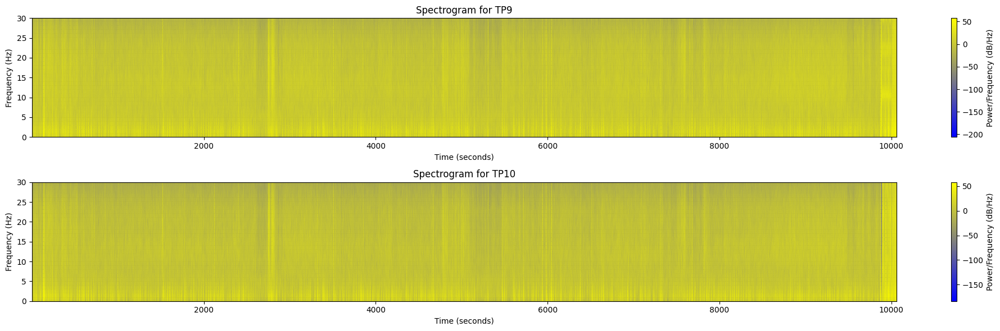

In [59]:
import matplotlib.colors as mcolors
from scipy.signal import decimate
# Define the sampling rate
sampling_rate = 256  # Hz

# Define the desired sampling rate after downsampling
desired_sampling_rate = 129  # Hz

# Extract the desired channels (TP9 and TP10)
channels = ['TP9', 'TP10']
eeg_data = eeg_df[channels]

# Convert the timestamps to time in seconds
time_seconds = eeg_df['timestamps'] / sampling_rate

# Preprocess the EEG signals
for channel in channels:
    # Apply high-pass filter above 1 Hz and low-pass filter below 50 Hz
    b, a = signal.butter(4, [1, 50], btype='bandpass', fs=sampling_rate)
    eeg_data[channel] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample the signal from 256 to 128 Hz
    # original_length = len(eeg_data[channel])
    downsampling_factor = int(sampling_rate / desired_sampling_rate)
    eeg_data[channel] = eeg_data[channel][::downsampling_factor]

print("Spectrogram shape for TP9:", spectrogram_TP9.shape)
print("Spectrogram shape for TP10:", spectrogram_TP10.shape)
# print("Min value of spectrogram_TP9:", np.min(spectrogram_TP9))
# print("Max value of spectrogram_TP9:", np.max(spectrogram_TP9))
# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 128    # Length of each segment
noverlap = 64    # Overlap between segments
nfft = 128       # Number of points for the FFT

# Compute the spectrogram for each channel
frequencies, times, spectrogram_TP9 = signal.spectrogram(eeg_data['TP9'], fs=desired_sampling_rate, window=window, 
                                                         nperseg=nperseg, noverlap=noverlap, nfft=nfft)
_, _, spectrogram_TP10 = signal.spectrogram(eeg_data['TP10'], fs=desired_sampling_rate, window=window, 
                                            nperseg=nperseg, noverlap=noverlap, nfft=nfft)



# Define custom colormap transitioning from yellow to blue
colors = ['blue','yellow']
cmap = mcolors.LinearSegmentedColormap.from_list("YellowBlue", colors)
# Plot the spectrogram for TP9
plt.figure(figsize=(20, 6))
plt.subplot(2, 1, 1)
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP9), shading='gouraud', cmap=cmap)
plt.title('Spectrogram for TP9')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz

# Plot the spectrogram for TP10
plt.subplot(2, 1, 2)
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap=cmap)
plt.title('Spectrogram for TP10')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz

plt.tight_layout()
plt.show()

Text(0.5, 0, 'time (s)')

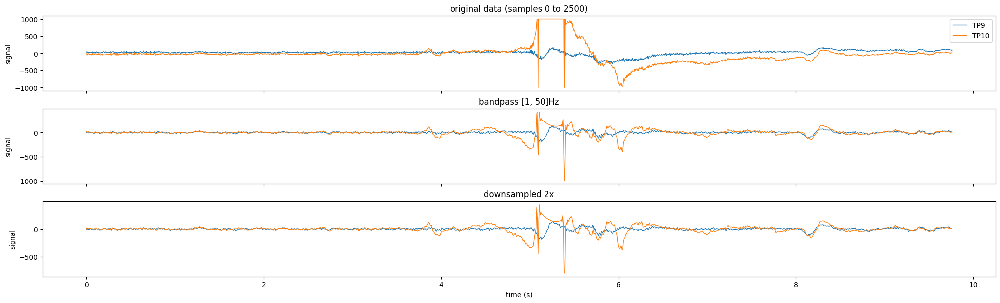

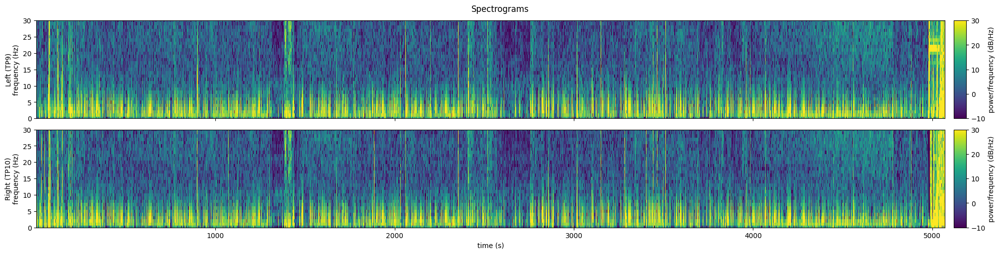

In [60]:


eeg_df['sample_number'] = range(len(eeg_df))
# Sampling rate of the EEG data in Hz
sampling_rate = 256  


# Convert the sample index to time in seconds
# This means you need to divide the sample *number* by the sampling rate
eeg_df['time_seconds'] = eeg_df['sample_number'] / sampling_rate

# Extract the desired channels (TP9 and TP10)
keep_channels = ['TP9', 'TP10']
eeg_data = eeg_df[keep_channels + ['time_seconds']].copy()

#
# Preprocess the EEG signals
#

#Define the pre-preprocessing parameters
downsample_factor = 2
bp_order = 4
bp_passband = [1, 50]
downsample_factor = 2

eeg_downsampled = pd.DataFrame()
downsampled_length = len(eeg_data) // downsample_factor

for channel in keep_channels:
    filtered_name = channel + '_bp'
    # Apply high-pass filter above 1 Hz and low-pass filter below 50 Hz
    b, a = signal.butter(bp_order, bp_passband, btype='bandpass', fs=sampling_rate)
    eeg_data[filtered_name] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample the signal from 256 to 128 Hz
    # Put the shorter signals in a new dataframe "eeg_downsampled"
    eeg_downsampled[channel] = signal.resample(eeg_data[filtered_name], downsampled_length)
eeg_downsampled['time_seconds'] = np.arange(downsampled_length) / (sampling_rate / downsample_factor)

#
# View the original and processed data
#
plot_height = 2
n_plots = 3
f, axs = plt.subplots(nrows=n_plots, ncols=1,
                      figsize=(20, plot_height * n_plots),
                      layout='constrained', sharex=True)

plot_slice = slice(0, 2500) #window of data to plot

#Original data
eeg_data[plot_slice].plot(
    y=keep_channels, x='time_seconds',
    ylabel='signal', xlabel='time (s)',
    linewidth=1, ax=axs[0],
    title=f'original data (samples {plot_slice.start} to {plot_slice.stop})'
)

#Filtered
eeg_data[plot_slice].plot(
    y=[chan + '_bp' for chan in keep_channels], x='time_seconds',
    ylabel='signal', xlabel='time (s)', legend=False,
    linewidth=1, ax=axs[1], title=f'bandpass {bp_passband}Hz'
)

#Downsampled
eeg_downsampled[plot_slice.start:plot_slice.stop//downsample_factor].plot(
    y=keep_channels, x='time_seconds',
    ylabel='signal', xlabel='time (s)', legend=False,
    linewidth=1, ax=axs[2], title=f'downsampled {downsample_factor}x'
)

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 128    # Length of each segment
noverlap = 64    # Overlap between segments
nfft = 128       # Number of points for the FFT

# Compute the spectrogram for each channel
spectrograms = {}
for channel in keep_channels:
    frequencies, times, spectrogram = signal.spectrogram(
        eeg_downsampled[channel],
        fs=sampling_rate / downsample_factor,
        window=window, nperseg=nperseg, noverlap=noverlap, nfft=nfft
    )
    spectrograms[channel] = spectrogram

# Plot the spectrograms
f, axs = plt.subplots(nrows=2, ncols=1, figsize=(20, 5),
                      layout='constrained', sharex=True)
f.suptitle('Spectrograms')
vmin, vmax = -10, 30

for channel, ax in zip(keep_channels, axs):
    im = ax.pcolormesh(
        times, frequencies, 10 * np.log10(spectrograms[channel]),
        vmin=vmin, vmax=vmax, #comment out for auto-range
        shading='nearest', cmap='viridis'
    )
    
    ax.set_ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
    ax.set_ylabel(('Left' if channel=='TP9' else 'Right') + f' ({channel})\nfrequency (Hz)')
    
    cbar = f.colorbar(im, aspect=8, pad=0.01, label='power/frequency (dB/Hz)')
    
ax.set_xlabel('time (s)')

In [98]:
tp9_spectrogram = spectrograms['TP9']

In [99]:
tp9_spectrogram

array([[1.99596784e+00, 3.03587735e+00, 1.18733122e-01, ...,
        2.09933590e+03, 7.27348953e+02, 7.66995601e+03],
       [2.23350225e+00, 2.17304529e+01, 1.60765576e+01, ...,
        2.75624249e+04, 6.02294854e+04, 1.82155433e+04],
       [8.67124703e-01, 3.40509048e+01, 1.01679963e+01, ...,
        2.64353619e+05, 1.74843558e+05, 3.35591143e+04],
       ...,
       [3.16160482e-03, 1.14057648e-03, 1.88345924e-03, ...,
        1.28352065e+01, 2.15918525e+01, 9.32004430e+00],
       [1.54230848e-01, 1.04616856e-01, 9.19069947e-02, ...,
        3.20032901e+00, 1.55849405e+01, 1.96905737e+01],
       [2.84431655e-01, 2.14862935e-01, 2.20816380e-01, ...,
        1.72441636e+00, 2.08470432e+00, 4.18846334e+00]])

In [102]:
print(len(tp9_spectrogram[0]))

10140


In [103]:
# Assuming 'spectrogram_tp9' is the spectrogram for 'TP9' channel
# and 'times' is the array of time values
power_frequency_db_hz = tp9_spectrogram  # Power/frequency values (dB/Hz)
time_seconds = times  # Corresponding time values (seconds)

In [104]:
power_frequency_db_hz

array([[1.99596784e+00, 3.03587735e+00, 1.18733122e-01, ...,
        2.09933590e+03, 7.27348953e+02, 7.66995601e+03],
       [2.23350225e+00, 2.17304529e+01, 1.60765576e+01, ...,
        2.75624249e+04, 6.02294854e+04, 1.82155433e+04],
       [8.67124703e-01, 3.40509048e+01, 1.01679963e+01, ...,
        2.64353619e+05, 1.74843558e+05, 3.35591143e+04],
       ...,
       [3.16160482e-03, 1.14057648e-03, 1.88345924e-03, ...,
        1.28352065e+01, 2.15918525e+01, 9.32004430e+00],
       [1.54230848e-01, 1.04616856e-01, 9.19069947e-02, ...,
        3.20032901e+00, 1.55849405e+01, 1.96905737e+01],
       [2.84431655e-01, 2.14862935e-01, 2.20816380e-01, ...,
        1.72441636e+00, 2.08470432e+00, 4.18846334e+00]])

In [108]:
len(power_frequency_db_hz)

65

In [105]:
time_seconds

array([5.0000e-01, 1.0000e+00, 1.5000e+00, ..., 5.0690e+03, 5.0695e+03,
       5.0700e+03])

In [109]:
len(time_seconds)

10140

In [110]:
power_frequency_db_hz[1, 1]

21.730452911914785

In [111]:
# Assuming you have the 'times', 'frequencies', and 'power_frequency_db_hz' arrays

# Initialize lists to store time, frequency, and power values
time_values = []
frequency_values = []
power_values = []

# Iterate over time and frequency arrays
for t_index, t_value in enumerate(times):
    for f_index, f_value in enumerate(frequencies):
        # Get the power/frequency value at the current time-frequency point
        power = power_frequency_db_hz[f_index, t_index]
        
        # Append the values to the lists
        time_values.append(t_value)
        frequency_values.append(f_value)
        power_values.append(power)

# Create a DataFrame
df = pd.DataFrame({'Time': time_values, 'Frequency': frequency_values, 'Power': power_values})

# Display the DataFrame
print(df)

          Time  Frequency      Power
0          0.5        0.0   1.995968
1          0.5        1.0   2.233502
2          0.5        2.0   0.867125
3          0.5        3.0   0.087143
4          0.5        4.0   0.497025
...        ...        ...        ...
659095  5070.0       60.0  51.979467
659096  5070.0       61.0  18.433102
659097  5070.0       62.0   9.320044
659098  5070.0       63.0  19.690574
659099  5070.0       64.0   4.188463

[659100 rows x 3 columns]


In [113]:
# Assuming you have the 'times', 'frequencies', and 'power_frequency_db_hz' arrays

# Define the beta frequency range
beta_frequency_range = (13, 30)

# Initialize lists to store time, frequency, and power values
time_values = []
frequency_values = []
power_values = []

# Iterate over time and frequency arrays
for t_index, t_value in enumerate(times):
    for f_index, f_value in enumerate(frequencies):
        # Check if the frequency is within the beta frequency range
        if beta_frequency_range[0] <= f_value <= beta_frequency_range[1]:
            # Get the power/frequency value at the current time-frequency point
            power = power_frequency_db_hz[f_index, t_index]

            # Append the values to the lists
            time_values.append(t_value)
            frequency_values.append(f_value)
            power_values.append(power)

# Create a DataFrame
beta_power_df = pd.DataFrame({'Time': time_values, 'Frequency': frequency_values, 'Power': power_values})

# Display the DataFrame
print(beta_power_df)

          Time  Frequency      Power
0          0.5       13.0   0.576789
1          0.5       14.0   0.073875
2          0.5       15.0   0.284409
3          0.5       16.0   2.212031
4          0.5       17.0   5.062325
...        ...        ...        ...
182515  5070.0       26.0   4.699766
182516  5070.0       27.0  57.145223
182517  5070.0       28.0   9.238863
182518  5070.0       29.0  31.012521
182519  5070.0       30.0   3.383889

[182520 rows x 3 columns]


In [152]:
# Define the time intervals and corresponding labels
intervals_labels = {
    (0, 964): 'No Music',
    (964, 1144): 'First Rest',
    (1144, 2108): 'Relaxing Music',
    (2108, 2468): 'Second Rest',
    (2468, 3432): 'Exciting Music',
    (3432, 3612): 'Third Rest',
    (3612, 4576): 'Newly Generated Relaxing Music',
    (4576, 4936): 'Last Rest' #4936
}

# Initialize an empty list to store the labels
kind_of_music = []

# Iterate over the rows of the DataFrame
for _, row in beta_power_df.iterrows():
    time = row['Time']
    # Find the corresponding label for the time interval
    label = next((label for (start, end), label in intervals_labels.items() if start < time <= end), None)
    kind_of_music.append(label)

# Add the "Kind Of Music" column to the DataFrame
beta_power_df['Kind Of Music'] = kind_of_music

In [153]:
beta_power_df

,Time,Frequency,Power,Kind Of Music
0,0.5,13.0,0.576789,No Music
1,0.5,14.0,0.073875,No Music
2,0.5,15.0,0.284409,No Music
3,0.5,16.0,2.212031,No Music
4,0.5,17.0,5.062325,No Music
...,...,...,...,...
182515,5070.0,26.0,4.699766,None
182516,5070.0,27.0,57.145223,None
182517,5070.0,28.0,9.238863,None
182518,5070.0,29.0,31.012521,None


C:\Users\user\AppData\Local\Temp\ipykernel_29192\1586662062.py:3: UserWarning: 

The `join` parameter is deprecated and will be removed in v0.15.0.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power',color='gray',join=True, estimator=np.mean,linestyle="none")


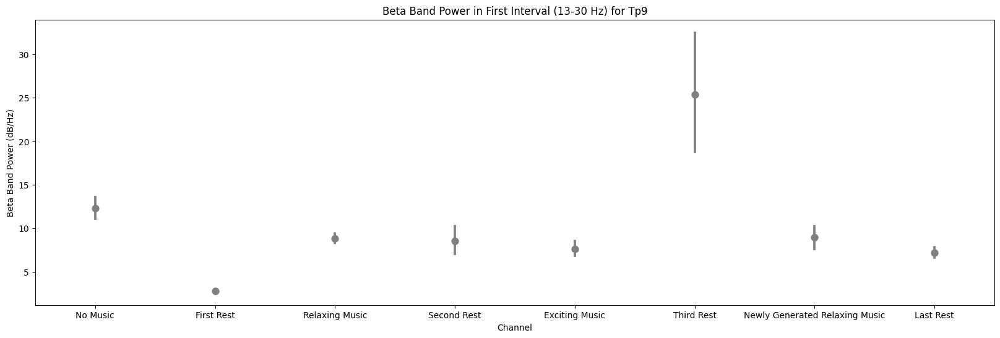

In [154]:
import seaborn as sns
plt.figure(figsize=(20, 6))
sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power',color='gray',join=True, estimator=np.mean,linestyle="none")
plt.title('Beta Band Power in First Interval (13-30 Hz) for Tp9')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Channel')
plt.show()

C:\Users\user\AppData\Local\Temp\ipykernel_29192\1920997257.py:3: UserWarning: 

The `join` parameter is deprecated and will be removed in v0.15.0.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power',color='gray',join=True, estimator=np.mean,linestyle="none",errorbar="sd")


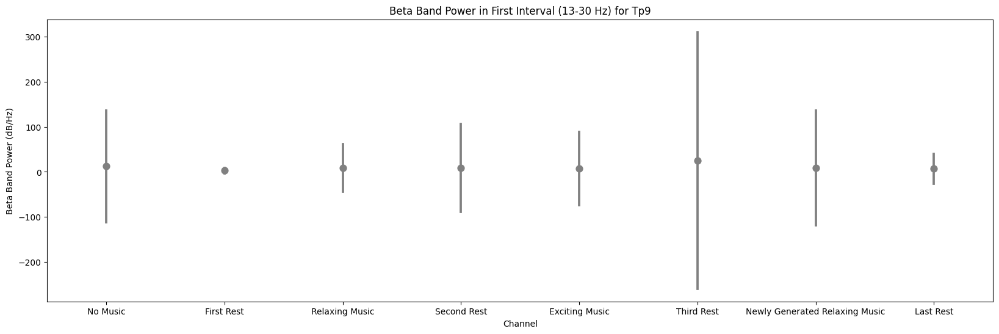

In [155]:
import seaborn as sns
plt.figure(figsize=(20, 6))
sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power',color='gray',join=True, estimator=np.mean,linestyle="none",errorbar="sd")
plt.title('Beta Band Power in First Interval (13-30 Hz) for Tp9')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Channel')
plt.show()

C:\Users\user\AppData\Local\Temp\ipykernel_29192\3863783017.py:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, linestyle="none")


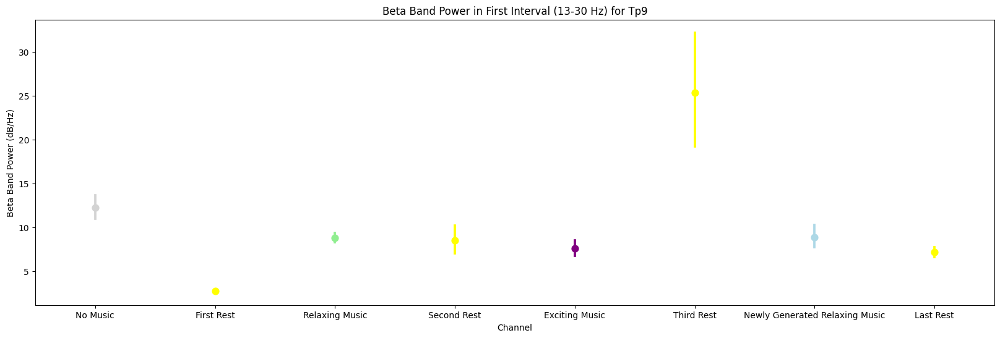

In [157]:
# Define color palette dictionary
color_palette = {
    'No Music': 'lightgray',
    'First Rest': 'yellow',
    'Relaxing Music': 'lightgreen',
    'Second Rest': 'yellow',
    'Exciting Music': 'purple',
    'Third Rest': 'yellow',
    'Newly Generated Relaxing Music': 'lightblue',
    'Last Rest': 'yellow'
}

plt.figure(figsize=(20, 6))
sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, linestyle="none")
plt.title('Beta Band Power in First Interval (13-30 Hz) for Tp9')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Channel')
plt.show()

C:\Users\user\AppData\Local\Temp\ipykernel_29192\218136077.py:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette)


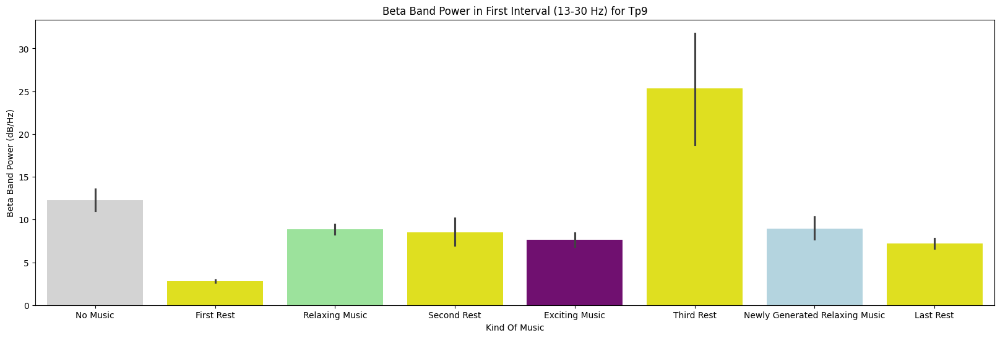

In [158]:

# Define color palette dictionary
color_palette = {
    'No Music': 'lightgray',
    'First Rest': 'yellow',
    'Relaxing Music': 'lightgreen',
    'Second Rest': 'yellow',
    'Exciting Music': 'purple',
    'Third Rest': 'yellow',
    'Newly Generated Relaxing Music': 'lightblue',
    'Last Rest': 'yellow'
}

plt.figure(figsize=(20, 6))
sns.barplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette)
plt.title('Beta Band Power in First Interval (13-30 Hz) for Tp9')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Kind Of Music')
plt.show()

### Beta Band Frequency

C:\Users\user\AppData\Local\Temp\ipykernel_29192\2331215207.py:79: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")
C:\Users\user\AppData\Local\Temp\ipykernel_29192\2331215207.py:79: UserWarning: 

The `join` parameter is deprecated and will be removed in v0.15.0.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")


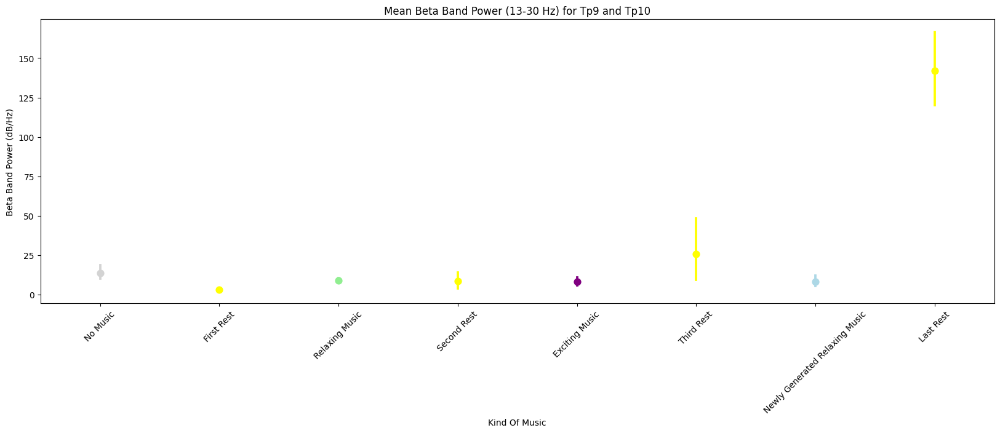

In [160]:
# Sample EEG DataFrame
# Assuming you have an EEG DataFrame named eeg_df with columns 'TP9' and 'TP10'

# Preprocessing parameters
sampling_rate = 256
downsample_factor = 2
bp_order = 4
bp_passband = [1, 50]

# Apply preprocessing and downsampling
eeg_df['sample_number'] = range(len(eeg_df))
eeg_df['time_seconds'] = eeg_df['sample_number'] / sampling_rate

eeg_data = eeg_df[['TP9', 'TP10', 'time_seconds']].copy()

eeg_downsampled = pd.DataFrame()
downsampled_length = len(eeg_data) // downsample_factor

for channel in ['TP9', 'TP10']:
    filtered_name = channel + '_bp'
    # Apply bandpass filter
    b, a = signal.butter(bp_order, bp_passband, btype='bandpass', fs=sampling_rate)
    eeg_data[filtered_name] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample
    eeg_downsampled[channel] = signal.resample(eeg_data[filtered_name], downsampled_length)

eeg_downsampled['time_seconds'] = np.arange(downsampled_length) / (sampling_rate / downsample_factor)

# Compute spectrogram for each channel
frequencies, times, spectrogram_tp9 = signal.spectrogram(
    eeg_downsampled['TP9'],
    fs=sampling_rate / downsample_factor,
    window='hann', nperseg=128, noverlap=64, nfft=128
)

_, _, spectrogram_tp10 = signal.spectrogram(
    eeg_downsampled['TP10'],
    fs=sampling_rate / downsample_factor,
    window='hann', nperseg=128, noverlap=64, nfft=128
)

# Compute beta band power (13-30 Hz) for each channel
beta_band_power_tp9 = np.mean(spectrogram_tp9[(frequencies >= 13) & (frequencies <= 30)], axis=0)
beta_band_power_tp10 = np.mean(spectrogram_tp10[(frequencies >= 13) & (frequencies <= 30)], axis=0)

# Compute mean beta band power across channels
mean_beta_band_power = (beta_band_power_tp9 + beta_band_power_tp10) / 2

# Define intervals and corresponding labels
intervals = [
    (0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
    (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                            964 + 180 + 964 + 360 + 964 + 180),
    (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
    (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)
]
labels = ['No Music', 'First Rest', 'Relaxing Music', 'Second Rest', 'Exciting Music', 'Third Rest',
          'Newly Generated Relaxing Music', 'Last Rest']

# Assign labels to each data point based on intervals
beta_power_df = pd.DataFrame({'Time': times, 'Power': mean_beta_band_power})
beta_power_df['Kind Of Music'] = pd.cut(beta_power_df['Time'], bins=[interval[0] for interval in intervals] + [np.inf], labels=labels)

# Define color palette dictionary
color_palette = {
    'No Music': 'lightgray',
    'First Rest': 'yellow',
    'Relaxing Music': 'lightgreen',
    'Second Rest': 'yellow',
    'Exciting Music': 'purple',
    'Third Rest': 'yellow',
    'Newly Generated Relaxing Music': 'lightblue',
    'Last Rest': 'yellow'
}

# Plot
plt.figure(figsize=(20, 6))
sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")
plt.title('Mean Beta Band Power (13-30 Hz) for Tp9 and Tp10')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Kind Of Music')
plt.xticks(rotation=45)
plt.show()

C:\Users\user\AppData\Local\Temp\ipykernel_29192\3532274209.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette)


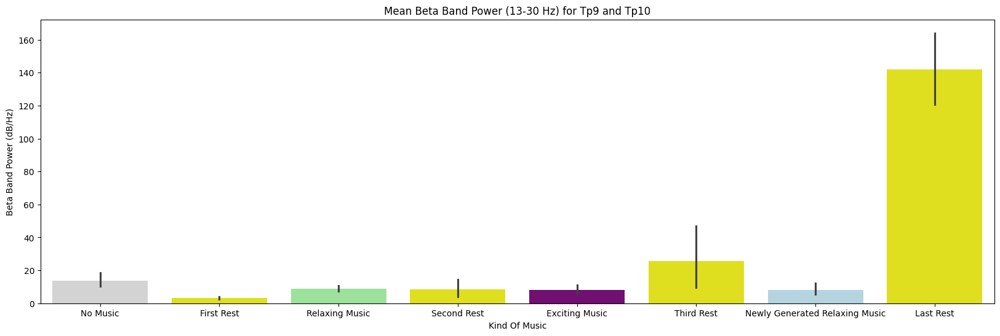

In [161]:
# Apply color palette for the bar plot
color_palette = {
    'No Music': 'lightgray',
    'First Rest': 'yellow',
    'Relaxing Music': 'lightgreen',
    'Second Rest': 'yellow',
    'Exciting Music': 'purple',
    'Third Rest': 'yellow',
    'Newly Generated Relaxing Music': 'lightblue',
    'Last Rest': 'yellow'
}

# Generate the bar plot
plt.figure(figsize=(20, 6))
sns.barplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette)
plt.title('Mean Beta Band Power (13-30 Hz) for Tp9 and Tp10')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Kind Of Music')
plt.show()

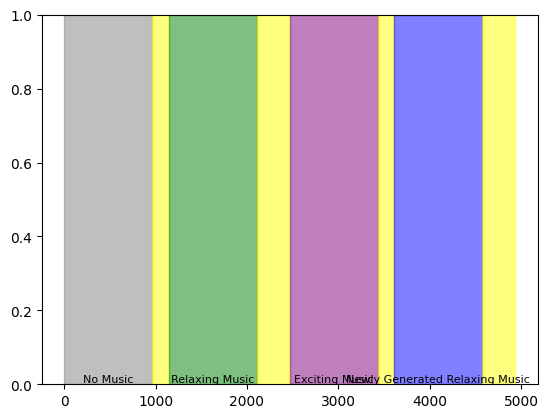

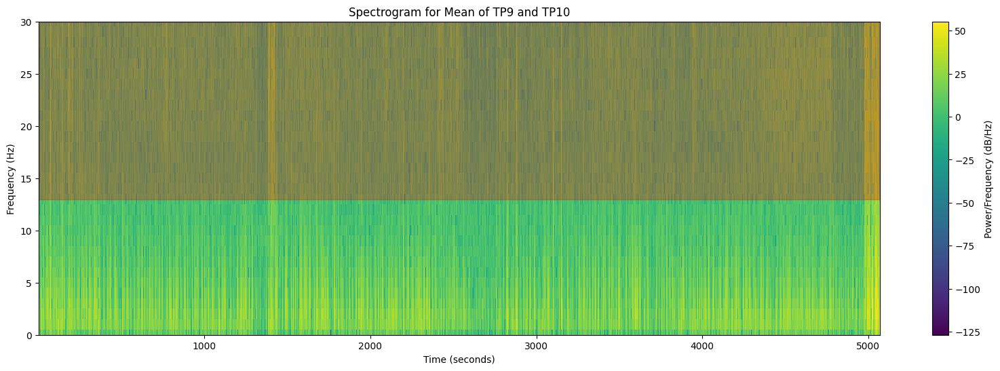

In [1719]:
# Define the beta frequency range
beta_freq_range = (13, 30)
# Combine the signals from TP9 and TP10 by taking the mean
mean_signal = (eeg_downsampled['TP9'] + eeg_downsampled['TP10']) / 2

# Compute the spectrogram for the combined signal
frequencies, times, spectrogram = signal.spectrogram(
    mean_signal,
    fs=sampling_rate / downsample_factor,
    window=window, nperseg=nperseg, noverlap=noverlap, nfft=nfft
)



# Plot the spectrogram
plt.figure(figsize=(20, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram), shading='nearest', cmap='viridis')
plt.title('Spectrogram for Mean of TP9 and TP10')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
# Highlight the beta frequency band
plt.axhspan(beta_freq_range[0], beta_freq_range[1], color='red', alpha=0.3)


plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
plt.show()

### EMPATICA

The Empatica data encompasses a range of physiological aspects, including participants' electrodermal activity (EDA), heart rate (HR), blood volume pulses (BVP), skin surface temperature, Photoplethysmography (PPG), and 3-axis accelerometer data. These data types are stored as separate CSV files: 'EDA.csv', 'TEMP.csv', 'ACC.csv', 'BVP.csv', 'HR.csv', 'IBI.csv', and 'tags.csv'. Data recorded by Empatica wristbands from Left and Right hands are each represented by their own distinct CSV files, encompassing the following attributes:
- 'Left_EDA.csv' and 'Right_EDA.csv'
- 'Left_TEMP.csv' and 'Right_TEMP.csv'
- 'Left_ACC.csv' and 'Right_ACC.csv'
- 'Left_BVP.csv' and 'Right_BVP.csv'
- 'Left_HR.csv' and 'Right_HR.csv'
- 'Left_IBI.csv' and 'Right_IBI.csv'
- 'Left_tags.csv' and 'Right_tags.csv'



#### EDA
- EDA: Measurements from the electrodermal activity (EDA) sensor expressed as micro siemens (μS). Values in the first column (EDA) show the EDA values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1205]:
left_eda_df=pd.read_csv(Left_EDA_file)
left_eda_df

,EDA,start_time_unix,sampling_rate
0,0.000000,1.624262e+09,4.0
1,0.308819,1.624262e+09,4.0
2,0.388267,1.624262e+09,4.0
3,0.389548,1.624262e+09,4.0
4,0.392111,1.624262e+09,4.0
...,...,...,...
19597,0.303694,1.624262e+09,4.0
19598,0.301131,1.624262e+09,4.0
19599,0.306257,1.624262e+09,4.0
19600,0.480528,1.624262e+09,4.0


In [1206]:
left_eda_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19602 entries, 0 to 19601
Data columns (total 3 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   EDA              19602 non-null  float64
 1   start_time_unix  19602 non-null  float64
 2   sampling_rate    19602 non-null  float64
dtypes: float64(3)
memory usage: 459.6 KB


In [1207]:
# Assuming df is your DataFrame and 'Start_time_unix' is the column containing UNIX timestamps
left_eda_df['Start_time_seconds'] = (pd.to_datetime(left_eda_df['start_time_unix'], unit='s') - pd.Timestamp('1970-01-01')).dt.total_seconds()

In [1208]:
left_eda_df

,EDA,start_time_unix,sampling_rate,Start_time_seconds
0,0.000000,1.624262e+09,4.0,1.624262e+09
1,0.308819,1.624262e+09,4.0,1.624262e+09
2,0.388267,1.624262e+09,4.0,1.624262e+09
3,0.389548,1.624262e+09,4.0,1.624262e+09
4,0.392111,1.624262e+09,4.0,1.624262e+09
...,...,...,...,...
19597,0.303694,1.624262e+09,4.0,1.624262e+09
19598,0.301131,1.624262e+09,4.0,1.624262e+09
19599,0.306257,1.624262e+09,4.0,1.624262e+09
19600,0.480528,1.624262e+09,4.0,1.624262e+09


It seems it's converted to seconds the start_time_unix
- Check is sampling_rate is constant

In [1209]:
sampling_rate_list=left_eda_df['sampling_rate'].unique()

In [1210]:
sampling_rate_list

array([4.])

YES IT's constan so it's notnecessary apply any transformation but you can do it too.

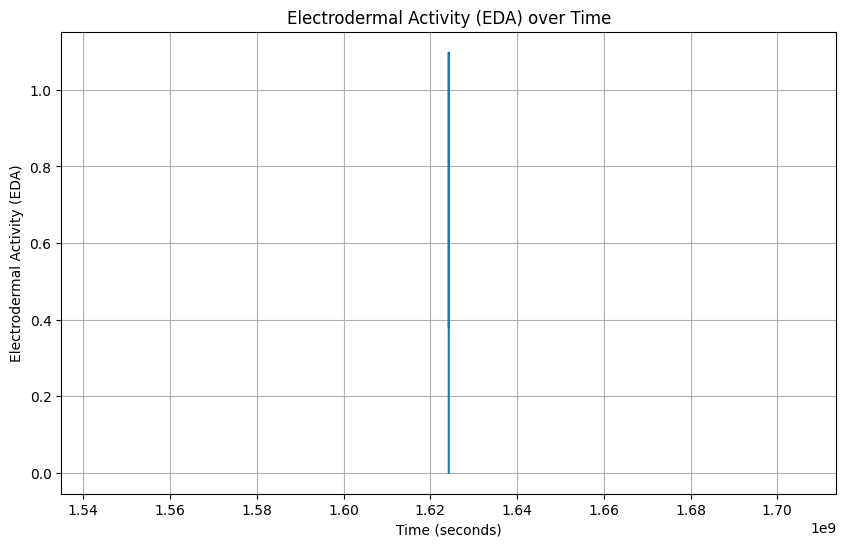

In [1211]:
import matplotlib.pyplot as plt
# Assuming df is your DataFrame with the 'EDA' and 'start_time_seconds' columns
plt.figure(figsize=(10, 6))
plt.plot(left_eda_df['Start_time_seconds'], left_eda_df['EDA'])
plt.title('Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(True)
plt.show()

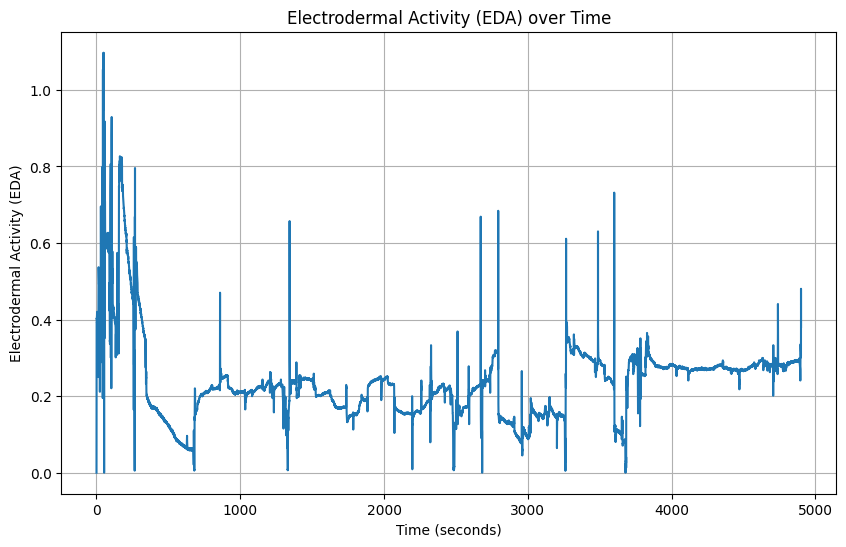

In [1212]:
import matplotlib.pyplot as plt
# Calculate the time intervals between consecutive data points
time_intervals = 1 / left_eda_df['sampling_rate']

# Cumulatively sum the time intervals to get the time in seconds
time_seconds = time_intervals.cumsum()

# Plot the signal
plt.figure(figsize=(10, 6))
plt.plot(time_seconds, left_eda_df['EDA'])
plt.title('Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(True)
plt.show()

In [1213]:
right_eda_df=pd.read_csv(Right_EDA_file)
right_eda_df

,EDA,start_time_unix,sampling_rate
0,0.000000,1.624262e+09,4.0
1,0.390641,1.624262e+09,4.0
2,0.475174,1.624262e+09,4.0
3,0.475174,1.624262e+09,4.0
4,0.479016,1.624262e+09,4.0
...,...,...,...
19615,0.198789,1.624262e+09,4.0
19616,0.210317,1.624262e+09,4.0
19617,0.288445,1.624262e+09,4.0
19618,0.292287,1.624262e+09,4.0


In [1214]:
right_eda_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19620 entries, 0 to 19619
Data columns (total 3 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   EDA              19620 non-null  float64
 1   start_time_unix  19620 non-null  float64
 2   sampling_rate    19620 non-null  float64
dtypes: float64(3)
memory usage: 460.0 KB


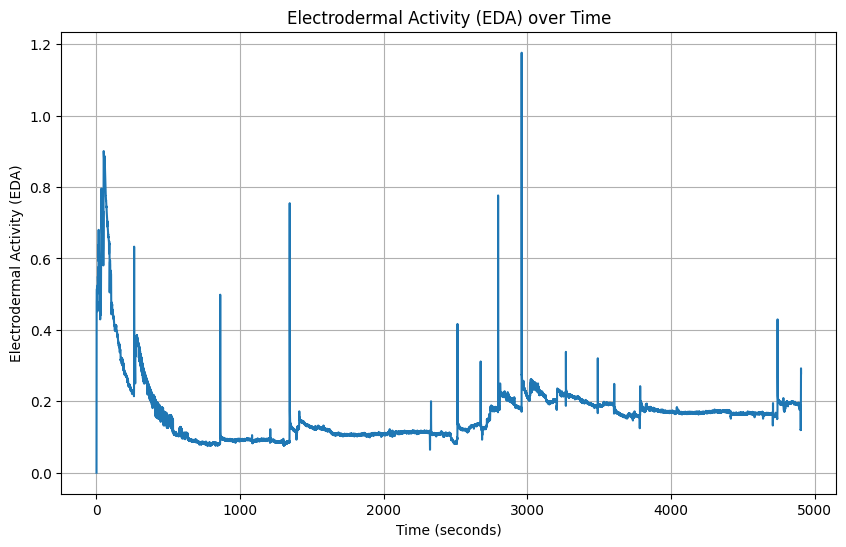

In [1215]:
import matplotlib.pyplot as plt
# Calculate the time intervals between consecutive data points
time_intervals = 1 / right_eda_df['sampling_rate']

# Cumulatively sum the time intervals to get the time in seconds
time_seconds = time_intervals.cumsum()

# Plot the signal
plt.figure(figsize=(10, 6))
plt.plot(time_seconds, right_eda_df['EDA'])
plt.title('Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(True)
plt.show()

In [1216]:
right_eda_df.index

RangeIndex(start=0, stop=19620, step=1)

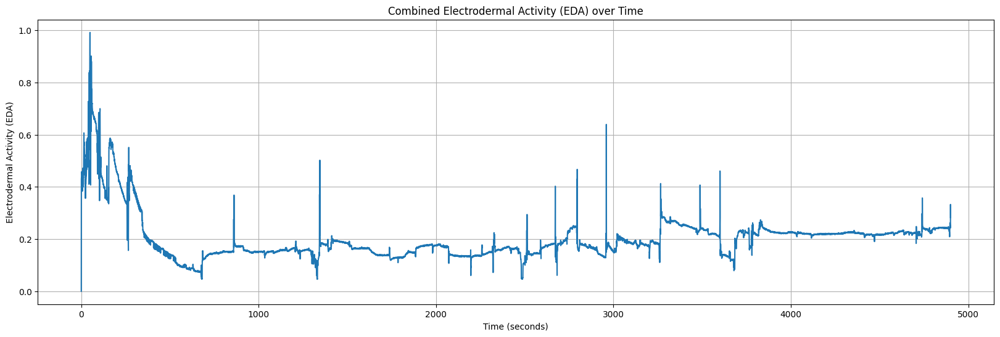

In [1217]:
import matplotlib.pyplot as plt


# Combine the two EDA signals by taking the average
combined_eda = (right_eda_df['EDA'] + left_eda_df['EDA']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_eda_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = right_eda_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_eda)
plt.title('Combined Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(True)
plt.show()

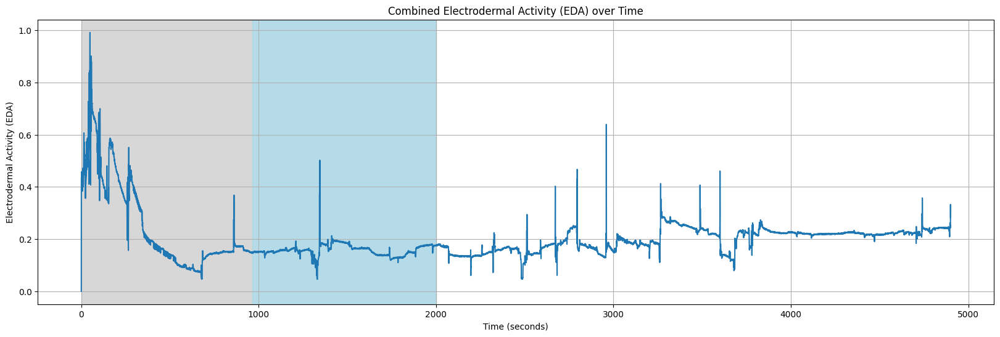

In [1218]:
# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_eda)

# Define the intervals where you want to change the background color
intervals = [(0, 964), (964, 2000)]  # Example intervals, adjust as needed

# Set the colors for each interval
colors = ['lightgray', 'lightblue']  # Example colors, adjust as needed

# Add background color for each interval
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.9)  # Adjust alpha for transparency

plt.title('Combined Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(True)
plt.show()

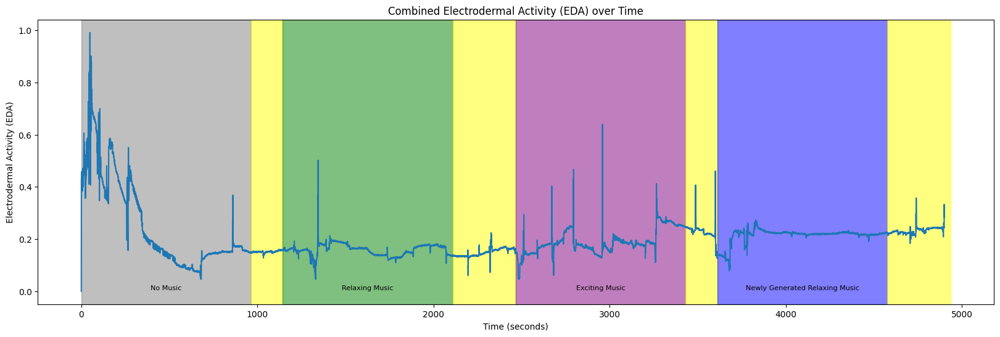

In [1219]:
# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_eda)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_eda), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Combined Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(False)
plt.show()

#### HR
- HR: Average heart rate (HR) extracted from the BVP signal. Values in the first column (HR) show the HR values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1220]:
left_hr_df=pd.read_csv(Left_HR_file)
left_hr_df

,HR,start_time_unix,sampling_rate
0,55.00,1.624262e+09,1.0
1,55.00,1.624262e+09,1.0
2,56.00,1.624262e+09,1.0
3,87.00,1.624262e+09,1.0
4,103.60,1.624262e+09,1.0
...,...,...,...
4885,76.37,1.624262e+09,1.0
4886,76.47,1.624262e+09,1.0
4887,76.63,1.624262e+09,1.0
4888,76.77,1.624262e+09,1.0


In [1221]:
left_hr_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4890 entries, 0 to 4889
Data columns (total 3 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   HR               4890 non-null   float64
 1   start_time_unix  4890 non-null   float64
 2   sampling_rate    4890 non-null   float64
dtypes: float64(3)
memory usage: 114.7 KB


In [1222]:
right_hr_df=pd.read_csv(Right_HR_file)
right_hr_df

,HR,start_time_unix,sampling_rate
0,97.00,1.624262e+09,1.0
1,75.50,1.624262e+09,1.0
2,77.67,1.624262e+09,1.0
3,71.25,1.624262e+09,1.0
4,67.40,1.624262e+09,1.0
...,...,...,...
4889,81.13,1.624262e+09,1.0
4890,81.00,1.624262e+09,1.0
4891,80.87,1.624262e+09,1.0
4892,80.82,1.624262e+09,1.0


In [1223]:
right_hr_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4894 entries, 0 to 4893
Data columns (total 3 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   HR               4894 non-null   float64
 1   start_time_unix  4894 non-null   float64
 2   sampling_rate    4894 non-null   float64
dtypes: float64(3)
memory usage: 114.8 KB


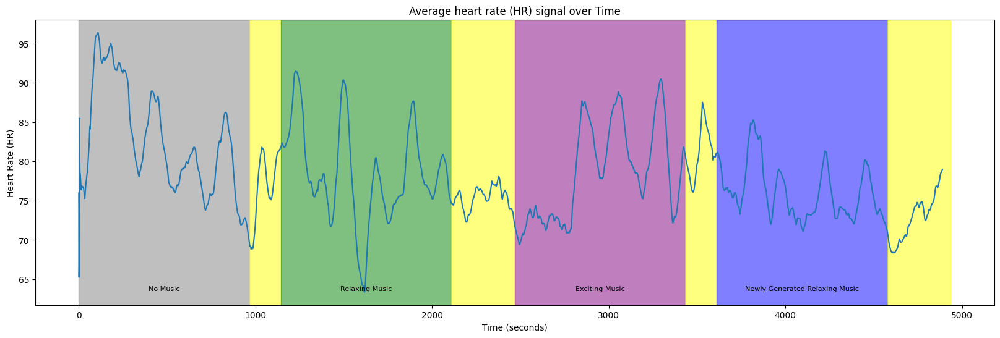

In [1224]:
import matplotlib.pyplot as plt


# Combine the two hr signals by taking the average
combined_hr = (right_hr_df['HR'] + left_hr_df['HR']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_hr_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = right_hr_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_hr)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_hr), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Average heart rate (HR) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Heart Rate (HR)')
plt.grid(False)
plt.show()

#### BVP
- BVP: Blood volume pulses (BVP) measured from a photoplethysmograph. Values in the first column (BVP) show the BVP values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1225]:
left_bvp_df=pd.read_csv(Left_BVP_file)
left_bvp_df

,BVP,start_time_unix,sampling_rate
0,-0.00,1.624262e+09,64.0
1,-0.00,1.624262e+09,64.0
2,-0.00,1.624262e+09,64.0
3,-0.00,1.624262e+09,64.0
4,-0.00,1.624262e+09,64.0
...,...,...,...
313550,22.60,1.624262e+09,64.0
313551,23.34,1.624262e+09,64.0
313552,22.34,1.624262e+09,64.0
313553,19.38,1.624262e+09,64.0


In [1226]:
left_bvp_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 313555 entries, 0 to 313554
Data columns (total 3 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   BVP              313555 non-null  float64
 1   start_time_unix  313555 non-null  float64
 2   sampling_rate    313555 non-null  float64
dtypes: float64(3)
memory usage: 7.2 MB


In [1227]:
right_bvp_df=pd.read_csv(Right_BVP_file)
right_bvp_df

,BVP,start_time_unix,sampling_rate
0,-0.00,1.624262e+09,64.0
1,-0.00,1.624262e+09,64.0
2,-0.00,1.624262e+09,64.0
3,-0.00,1.624262e+09,64.0
4,-0.00,1.624262e+09,64.0
...,...,...,...
313825,523.57,1.624262e+09,64.0
313826,509.83,1.624262e+09,64.0
313827,492.41,1.624262e+09,64.0
313828,475.20,1.624262e+09,64.0


In [1228]:
right_bvp_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 313830 entries, 0 to 313829
Data columns (total 3 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   BVP              313830 non-null  float64
 1   start_time_unix  313830 non-null  float64
 2   sampling_rate    313830 non-null  float64
dtypes: float64(3)
memory usage: 7.2 MB


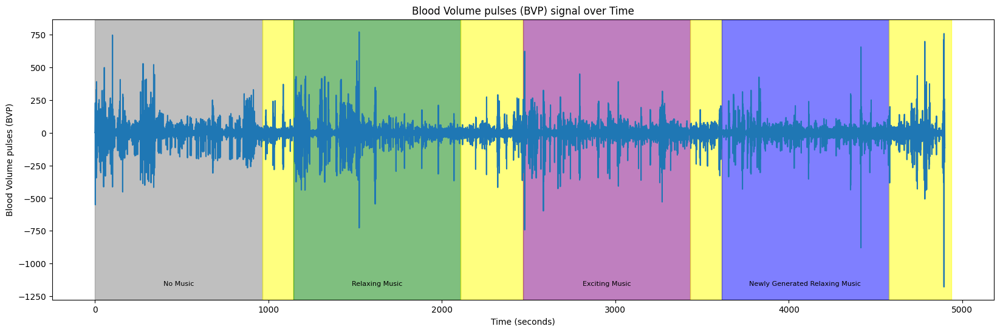

In [1229]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_bvp = (right_bvp_df['BVP'] + left_bvp_df['BVP']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_bvp_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = right_bvp_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_bvp)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_bvp), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Blood Volume pulses (BVP) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Blood Volume pulses (BVP)')
plt.grid(False)
plt.show()

#### Temperature
- TEMP: Skin temperature (TEMP) measured from temperature sensor expressed degrees on the Celsius (°C) scale. Values in the first column (TEMP) show the TEMP values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1230]:
left_temp_df=pd.read_csv(Left_TEMP_file)
left_temp_df

,TEMP,start_time_unix,sampling_rate
0,32.79,1.624262e+09,4.0
1,32.79,1.624262e+09,4.0
2,32.79,1.624262e+09,4.0
3,32.79,1.624262e+09,4.0
4,32.79,1.624262e+09,4.0
...,...,...,...
19595,33.68,1.624262e+09,4.0
19596,33.71,1.624262e+09,4.0
19597,33.71,1.624262e+09,4.0
19598,33.71,1.624262e+09,4.0


In [1231]:
left_temp_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19600 entries, 0 to 19599
Data columns (total 3 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   TEMP             19600 non-null  float64
 1   start_time_unix  19600 non-null  float64
 2   sampling_rate    19600 non-null  float64
dtypes: float64(3)
memory usage: 459.5 KB


In [1232]:
right_temp_df=pd.read_csv(Right_TEMP_file)
right_temp_df

,TEMP,start_time_unix,sampling_rate
0,33.39,1.624262e+09,4.0
1,33.39,1.624262e+09,4.0
2,33.39,1.624262e+09,4.0
3,33.39,1.624262e+09,4.0
4,33.39,1.624262e+09,4.0
...,...,...,...
19611,33.79,1.624262e+09,4.0
19612,33.77,1.624262e+09,4.0
19613,33.77,1.624262e+09,4.0
19614,33.77,1.624262e+09,4.0


In [1233]:
right_temp_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19616 entries, 0 to 19615
Data columns (total 3 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   TEMP             19616 non-null  float64
 1   start_time_unix  19616 non-null  float64
 2   sampling_rate    19616 non-null  float64
dtypes: float64(3)
memory usage: 459.9 KB


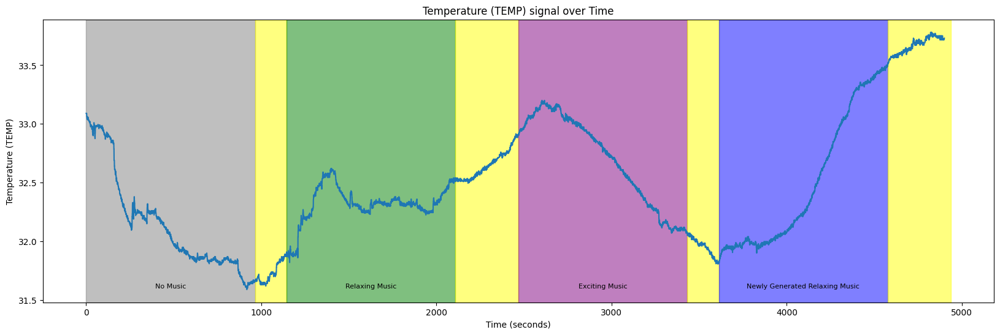

In [1234]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_temp = (right_temp_df['TEMP'] + left_temp_df['TEMP']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_temp_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = right_temp_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_temp)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_temp), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Temperature (TEMP) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Temperature (TEMP)')
plt.grid(False)
plt.show()

#### ACC
- ACC: Data from 3-axis accelerometer sensor. The accelerometer is configured to measure acceleration in the range [-2g, 2g]. Therefore, the unit in this file is 1/64g. Data from x, y, and z axis are labeled respectively (i.e., ACC_X, ACC_Y, and ACC_Z).  The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1235]:
left_ACC_df=pd.read_csv(Left_ACC_file)
left_ACC_df

,ACC_X,ACC_Y,ACC_Z,start_time_unix,sampling_rate
0,-50,-3,44,1.624262e+09,32.0
1,-49,-3,44,1.624262e+09,32.0
2,-49,-3,44,1.624262e+09,32.0
3,-49,-3,44,1.624262e+09,32.0
4,-49,-4,44,1.624262e+09,32.0
...,...,...,...,...,...
156793,19,19,59,1.624262e+09,32.0
156794,18,19,60,1.624262e+09,32.0
156795,19,19,59,1.624262e+09,32.0
156796,18,19,58,1.624262e+09,32.0


In [1236]:
left_ACC_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 156798 entries, 0 to 156797
Data columns (total 5 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   ACC_X            156798 non-null  int64  
 1   ACC_Y            156798 non-null  int64  
 2   ACC_Z            156798 non-null  int64  
 3   start_time_unix  156798 non-null  float64
 4   sampling_rate    156798 non-null  float64
dtypes: float64(2), int64(3)
memory usage: 6.0 MB


In [1237]:
right_ACC_df=pd.read_csv(Right_ACC_file)
right_ACC_df

,ACC_X,ACC_Y,ACC_Z,start_time_unix,sampling_rate
0,-37,40,23,1.624262e+09,32.0
1,-39,42,24,1.624262e+09,32.0
2,-34,43,28,1.624262e+09,32.0
3,-34,43,28,1.624262e+09,32.0
4,-35,43,30,1.624262e+09,32.0
...,...,...,...,...,...
156931,14,13,60,1.624262e+09,32.0
156932,14,13,59,1.624262e+09,32.0
156933,14,13,60,1.624262e+09,32.0
156934,14,13,60,1.624262e+09,32.0


In [1238]:
right_ACC_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 156936 entries, 0 to 156935
Data columns (total 5 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   ACC_X            156936 non-null  int64  
 1   ACC_Y            156936 non-null  int64  
 2   ACC_Z            156936 non-null  int64  
 3   start_time_unix  156936 non-null  float64
 4   sampling_rate    156936 non-null  float64
dtypes: float64(2), int64(3)
memory usage: 6.0 MB


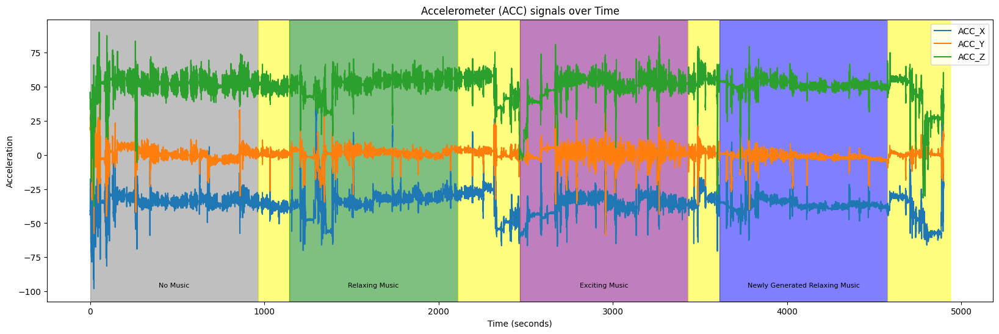

In [1239]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_accX = (right_ACC_df['ACC_X'] + left_ACC_df['ACC_X']) / 2
combined_accY = (right_ACC_df['ACC_Y'] + left_ACC_df['ACC_Y']) / 2
combined_accZ = (right_ACC_df['ACC_Z'] + left_ACC_df['ACC_Z']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_ACC_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = right_ACC_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_accX, label='ACC_X')
plt.plot(time_seconds, combined_accY, label='ACC_Y')
plt.plot(time_seconds, combined_accZ, label='ACC_Z')

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_accX), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Accelerometer (ACC) signals over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Acceleration')
plt.legend()
plt.grid(False)
plt.show()

# Patient A2

In [162]:
2# Define the file paths for the A2 data files
EEG_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A2\EEG_recording.csv'
Left_ACC_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A2\Left_ACC.csv'
Left_BVP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A2\Left_BVP.csv'
Left_EDA_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A2\Left_EDA.csv'
Left_HR_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A2\Left_HR.csv'
Left_IBI_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A2\Left_IBI.csv'
Left_tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A2\Left_tags.csv'
Left_TEMP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A2\Left_TEMP.csv'
n_back_responses_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A2\n_back_responses.csv'
Right_ACC_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A2\Right_ACC.csv'
Right_BVP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A2\Right_BVP.csv'
Right_EDA_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A2\Right_EDA.csv'
Right_HR_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A2\Right_HR.csv'
Right_IBI_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A2\Right_IBI.csv'
Right_tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A2\Right_tags.csv'
Right_TEMP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A2\Right_TEMP.csv'
tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A2\tags.csv'

## n back responses

In [163]:
n_backr_df=pd.read_csv(n_back_responses_file)
n_backr_df

,ExperimentName,Start_time_unix,Subject,Session,DataFile.Basename,Display.RefreshRate,ExperimentVersion,Group,InstructionNewMusic.DEVICE,InstructionNoMusic.DEVICE,...,TrialList8.Cycle,TrialList8.Sample,TSO,TSTh,TSvO,TSvTh,TSxO,TSxTh,TTO,TTTh
0,Experiment_1,1623676341,2,1,Experiment_1-2-1,75.026,1.0.0.251,1,Chronos,Chronos,...,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Experiment_1,1623676341,2,1,Experiment_1-2-1,75.026,1.0.0.251,1,Chronos,Chronos,...,1.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Experiment_1,1623676341,2,1,Experiment_1-2-1,75.026,1.0.0.251,1,Chronos,Chronos,...,1.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Experiment_1,1623676341,2,1,Experiment_1-2-1,75.026,1.0.0.251,1,Chronos,Chronos,...,1.0,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Experiment_1,1623676341,2,1,Experiment_1-2-1,75.026,1.0.0.251,1,Chronos,Chronos,...,1.0,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,Experiment_1,1623676341,2,1,Experiment_1-2-1,75.026,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1452,Experiment_1,1623676341,2,1,Experiment_1-2-1,75.026,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1453,Experiment_1,1623676341,2,1,Experiment_1-2-1,75.026,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1454,Experiment_1,1623676341,2,1,Experiment_1-2-1,75.026,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [164]:
n_backr_df.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 250 columns):
 #    Column                                   Non-Null Count  Dtype  
---   ------                                   --------------  -----  
 0    ExperimentName                           1456 non-null   object 
 1    Start_time_unix                          1456 non-null   int64  
 2    Subject                                  1456 non-null   int64  
 3    Session                                  1456 non-null   int64  
 4    DataFile.Basename                        1456 non-null   object 
 5    Display.RefreshRate                      1456 non-null   float64
 6    ExperimentVersion                        1456 non-null   object 
 7    Group                                    1456 non-null   int64  
 8    InstructionNewMusic.DEVICE               1456 non-null   object 
 9    InstructionNoMusic.DEVICE                1456 non-null   object 
 10   InstructionNoMusic.DurationError  

In [165]:
df_length=len(n_backr_df)

In [166]:
# Filter columns with length 1456
non_null_columns = [col for col in n_backr_df.columns if n_backr_df[col].notnull().all()]
# Create a new DataFrame with only columns of the same length as the DataFrame
complete_df = n_backr_df[non_null_columns]
complete_df

,ExperimentName,Start_time_unix,Subject,Session,DataFile.Basename,Display.RefreshRate,ExperimentVersion,Group,InstructionNewMusic.DEVICE,InstructionNoMusic.DEVICE,...,Welcome.DurationError,Welcome.OnsetDelay,Welcome.OnsetTime,Welcome.OnsetToOnsetTime,Block,Instruction,ListName,Procedure[Block],Running[Block],Trigger
0,Experiment_1,1623676341,2,1,Experiment_1-2-1,75.026,1.0.0.251,1,Chronos,Chronos,...,-999999,14,15161,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
1,Experiment_1,1623676341,2,1,Experiment_1-2-1,75.026,1.0.0.251,1,Chronos,Chronos,...,-999999,14,15161,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
2,Experiment_1,1623676341,2,1,Experiment_1-2-1,75.026,1.0.0.251,1,Chronos,Chronos,...,-999999,14,15161,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
3,Experiment_1,1623676341,2,1,Experiment_1-2-1,75.026,1.0.0.251,1,Chronos,Chronos,...,-999999,14,15161,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
4,Experiment_1,1623676341,2,1,Experiment_1-2-1,75.026,1.0.0.251,1,Chronos,Chronos,...,-999999,14,15161,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,Experiment_1,1623676341,2,1,Experiment_1-2-1,75.026,1.0.0.251,1,Chronos,Chronos,...,-999999,14,15161,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1452,Experiment_1,1623676341,2,1,Experiment_1-2-1,75.026,1.0.0.251,1,Chronos,Chronos,...,-999999,14,15161,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1453,Experiment_1,1623676341,2,1,Experiment_1-2-1,75.026,1.0.0.251,1,Chronos,Chronos,...,-999999,14,15161,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1454,Experiment_1,1623676341,2,1,Experiment_1-2-1,75.026,1.0.0.251,1,Chronos,Chronos,...,-999999,14,15161,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2


### Instruction

In [167]:
instruction = n_backr_df.columns
instruction[instruction.str.contains('Instruction')]
#.str.contains('SNOMED')]

Index(['InstructionNewMusic.DEVICE', 'InstructionNoMusic.DEVICE',
       'InstructionNoMusic.DurationError', 'InstructionNoMusic.OnsetDelay',
       'InstructionNoMusic.OnsetTime', 'InstructionNoMusic.OnsetToOnsetTime',
       'InstructionRelaxMusic.DEVICE', 'InstructionRelaxMusic.DurationError',
       'InstructionRelaxMusic.OnsetDelay', 'InstructionRelaxMusic.OnsetTime',
       'InstructionRelaxMusic.OnsetToOnsetTime',
       'InstructionStressMusic.DEVICE', 'InstructionStressMusic.DurationError',
       'InstructionStressMusic.OnsetDelay', 'InstructionStressMusic.OnsetTime',
       'InstructionStressMusic.OnsetToOnsetTime', 'Instruction'],
      dtype='object')

In [168]:
instruction_df=n_backr_df[instruction[instruction.str.contains('Instruction')]]

### Stimulus

In [169]:
stimulus = n_backr_df.columns
stimulus=stimulus[stimulus.str.contains('Stimulus')]

In [170]:
stimulus

Index(['Stimulus100.ACC', 'Stimulus100.CRESP', 'Stimulus100.DEVICE',
       'Stimulus100.DurationError', 'Stimulus100.OnsetDelay',
       'Stimulus100.OnsetTime', 'Stimulus100.OnsetToOnsetTime',
       'Stimulus100.RESP', 'Stimulus100.RT', 'Stimulus100.RTTime',
       'Stimulus101.ACC', 'Stimulus101.CRESP', 'Stimulus101.DEVICE',
       'Stimulus101.DurationError', 'Stimulus101.OnsetDelay',
       'Stimulus101.OnsetTime', 'Stimulus101.OnsetToOnsetTime',
       'Stimulus101.RESP', 'Stimulus101.RT', 'Stimulus101.RTTime',
       'Stimulus102.ACC', 'Stimulus102.CRESP', 'Stimulus102.DEVICE',
       'Stimulus102.DurationError', 'Stimulus102.OnsetDelay',
       'Stimulus102.OnsetTime', 'Stimulus102.OnsetToOnsetTime',
       'Stimulus102.RESP', 'Stimulus102.RT', 'Stimulus102.RTTime',
       'Stimulus103.ACC', 'Stimulus103.CRESP', 'Stimulus103.DEVICE',
       'Stimulus103.DurationError', 'Stimulus103.OnsetDelay',
       'Stimulus103.OnsetTime', 'Stimulus103.OnsetToOnsetTime',
       'Stimulus103

In [171]:
# Create a dictionary to store the mapping of columns to Running[Block] values
column_to_block = {}
running_block_values=n_backr_df['Running[Block]'].unique()
# Create a dictionary to store the mapping of stimulus columns to lists of Running[Block] values

stimulus_to_blocks = {}

# Iterate over each stimulus column
for col in stimulus:
    # Store all 4 Running[Block] values as a list for this stimulus column
    stimulus_to_blocks[col] = running_block_values

print(stimulus_to_blocks)

{'Stimulus100.ACC': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.CRESP': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.DEVICE': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.DurationError': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetDelay': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetTime': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetToOnsetTime': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.RESP': array(['PracticeSessi

In [172]:
# Create a new dictionary to store the suffixed keys and values
suffixed_dict = {}

# Iterate over each key in stimulus_to_blocks dictionary
for key, values in stimulus_to_blocks.items():
    # Get the prefix (e.g., 'Stimulus100') from the key
    prefix = key.split('.')[0]
    
    # Create a list to store the suffixed column names
    suffixed_columns = []
    
    # Iterate over each column name in stimulus_columns
    for col in stimulus:
        # If the column name starts with the same prefix
        if col.startswith(prefix):
            # Append the suffixed column name to the list
            suffixed_columns.append(col)
    
    # Create the suffixed key by joining the prefix with ':'
    suffixed_key = f'{prefix}:'
    
    # Add the suffixed column names list as the value for the suffixed key
    suffixed_dict[suffixed_key] = suffixed_columns

print(suffixed_dict)

{'Stimulus100:': ['Stimulus100.ACC', 'Stimulus100.CRESP', 'Stimulus100.DEVICE', 'Stimulus100.DurationError', 'Stimulus100.OnsetDelay', 'Stimulus100.OnsetTime', 'Stimulus100.OnsetToOnsetTime', 'Stimulus100.RESP', 'Stimulus100.RT', 'Stimulus100.RTTime'], 'Stimulus101:': ['Stimulus101.ACC', 'Stimulus101.CRESP', 'Stimulus101.DEVICE', 'Stimulus101.DurationError', 'Stimulus101.OnsetDelay', 'Stimulus101.OnsetTime', 'Stimulus101.OnsetToOnsetTime', 'Stimulus101.RESP', 'Stimulus101.RT', 'Stimulus101.RTTime'], 'Stimulus102:': ['Stimulus102.ACC', 'Stimulus102.CRESP', 'Stimulus102.DEVICE', 'Stimulus102.DurationError', 'Stimulus102.OnsetDelay', 'Stimulus102.OnsetTime', 'Stimulus102.OnsetToOnsetTime', 'Stimulus102.RESP', 'Stimulus102.RT', 'Stimulus102.RTTime'], 'Stimulus103:': ['Stimulus103.ACC', 'Stimulus103.CRESP', 'Stimulus103.DEVICE', 'Stimulus103.DurationError', 'Stimulus103.OnsetDelay', 'Stimulus103.OnsetTime', 'Stimulus103.OnsetToOnsetTime', 'Stimulus103.RESP', 'Stimulus103.RT', 'Stimulus103.R

#### Stimulus Table 100

In [173]:
# Filter columns that start with 'Stimulus100'
stimulus100_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus100')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
stimulus100_df=n_backr_df[stimulus100_columns]
stimulus100_df

,Stimulus100.ACC,Stimulus100.CRESP,Stimulus100.DEVICE,Stimulus100.DurationError,Stimulus100.OnsetDelay,Stimulus100.OnsetTime,Stimulus100.OnsetToOnsetTime,Stimulus100.RESP,Stimulus100.RT,Stimulus100.RTTime,Running[Block]
0,0.0,3.0,Chronos,2.0,-2.0,172061.0,507.0,NaN,0.0,0.0,PracticeSession
1,0.0,3.0,Chronos,2.0,19.0,174087.0,507.0,NaN,0.0,0.0,PracticeSession
2,0.0,3.0,Chronos,2.0,19.0,176113.0,507.0,NaN,0.0,0.0,PracticeSession
3,0.0,4.0,Chronos,1.0,19.0,178139.0,507.0,NaN,0.0,0.0,PracticeSession
4,0.0,4.0,Chronos,1.0,19.0,180165.0,507.0,NaN,0.0,0.0,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 101

In [174]:
# Filter columns that start with 'Stimulus100'
stimulus101_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus101')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus101_df=n_backr_df[stimulus101_columns]
stimulus101_df

,Stimulus101.ACC,Stimulus101.CRESP,Stimulus101.DEVICE,Stimulus101.DurationError,Stimulus101.OnsetDelay,Stimulus101.OnsetTime,Stimulus101.OnsetToOnsetTime,Stimulus101.RESP,Stimulus101.RT,Stimulus101.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 102

In [175]:
# Filter columns that start with 'Stimulus100'
stimulus102_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus102')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus102_df=n_backr_df[stimulus102_columns]
stimulus102_df

,Stimulus102.ACC,Stimulus102.CRESP,Stimulus102.DEVICE,Stimulus102.DurationError,Stimulus102.OnsetDelay,Stimulus102.OnsetTime,Stimulus102.OnsetToOnsetTime,Stimulus102.RESP,Stimulus102.RT,Stimulus102.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 103

In [176]:
# Filter columns that start with 'Stimulus100'
stimulus103_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus103')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus103_df=n_backr_df[stimulus103_columns]
stimulus103_df

,Stimulus103.ACC,Stimulus103.CRESP,Stimulus103.DEVICE,Stimulus103.DurationError,Stimulus103.OnsetDelay,Stimulus103.OnsetTime,Stimulus103.OnsetToOnsetTime,Stimulus103.RESP,Stimulus103.RT,Stimulus103.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 104

In [177]:
# Filter columns that start with 'Stimulus100'
stimulus104_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus104')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus104_df=n_backr_df[stimulus104_columns]
stimulus104_df

,Stimulus104.ACC,Stimulus104.CRESP,Stimulus104.DEVICE,Stimulus104.DurationError,Stimulus104.OnsetDelay,Stimulus104.OnsetTime,Stimulus104.OnsetToOnsetTime,Stimulus104.RESP,Stimulus104.RT,Stimulus104.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,1.0,3.0,Chronos,2.0,19.0,4943958.0,0.0,3.0,357.0,4944315.0,NewMusicSession
1452,1.0,3.0,Chronos,1.0,19.0,4945851.0,0.0,3.0,405.0,4946256.0,NewMusicSession
1453,1.0,3.0,Chronos,1.0,20.0,4947784.0,0.0,3.0,422.0,4948206.0,NewMusicSession
1454,0.0,4.0,Chronos,1.0,20.0,4949730.0,0.0,3.0,319.0,4950049.0,NewMusicSession


### Fixation

In [178]:
n_back_columns = n_backr_df.columns
fixation=n_back_columns[n_back_columns.str.contains('Fixation')]

In [179]:
fixation_df=n_backr_df[n_back_columns[n_back_columns.str.contains('Fixation')]]

In [180]:
fixation_df

,Fixation100.ACC,Fixation100.CRESP,Fixation100.DEVICE,Fixation100.DurationError,Fixation100.OnsetDelay,Fixation100.OnsetTime,Fixation100.OnsetToOnsetTime,Fixation100.RESP,Fixation100.RT,Fixation100.RTTime,...,Fixation104.ACC,Fixation104.CRESP,Fixation104.DEVICE,Fixation104.DurationError,Fixation104.OnsetDelay,Fixation104.OnsetTime,Fixation104.OnsetToOnsetTime,Fixation104.RESP,Fixation104.RT,Fixation104.RTTime
0,0.0,3.0,Chronos,2.0,7.0,172568.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.0,3.0,Chronos,1.0,7.0,174594.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0.0,3.0,Chronos,1.0,7.0,176620.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0.0,4.0,Chronos,1.0,7.0,178646.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0.0,4.0,Chronos,1.0,7.0,180672.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,3.0,Chronos,1.0,17.0,4944332.0,0.0,NaN,0.0,0.0
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,3.0,Chronos,2.0,8.0,4946264.0,0.0,NaN,0.0,0.0
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,3.0,Chronos,2.0,4.0,4948210.0,0.0,NaN,0.0,0.0
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,4.0,Chronos,1.0,14.0,4950063.0,0.0,NaN,0.0,0.0


#### Fixation table 100

In [181]:
# Filter columns that start with 'Fixation100'
fixation100_columns = [col for col in n_backr_df.columns if col.startswith('Fixation100')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation100_df=n_backr_df[fixation100_columns]
fixation100_df

,Fixation100.ACC,Fixation100.CRESP,Fixation100.DEVICE,Fixation100.DurationError,Fixation100.OnsetDelay,Fixation100.OnsetTime,Fixation100.OnsetToOnsetTime,Fixation100.RESP,Fixation100.RT,Fixation100.RTTime,Running[Block]
0,0.0,3.0,Chronos,2.0,7.0,172568.0,0.0,NaN,0.0,0.0,PracticeSession
1,0.0,3.0,Chronos,1.0,7.0,174594.0,0.0,NaN,0.0,0.0,PracticeSession
2,0.0,3.0,Chronos,1.0,7.0,176620.0,0.0,NaN,0.0,0.0,PracticeSession
3,0.0,4.0,Chronos,1.0,7.0,178646.0,0.0,NaN,0.0,0.0,PracticeSession
4,0.0,4.0,Chronos,1.0,7.0,180672.0,0.0,NaN,0.0,0.0,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 101

In [182]:
# Filter columns that start with 'Fixation100'
fixation101_columns = [col for col in n_backr_df.columns if col.startswith('Fixation101')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation101_df=n_backr_df[fixation101_columns]
fixation101_df

,Fixation101.ACC,Fixation101.CRESP,Fixation101.DEVICE,Fixation101.DurationError,Fixation101.OnsetDelay,Fixation101.OnsetTime,Fixation101.OnsetToOnsetTime,Fixation101.RESP,Fixation101.RT,Fixation101.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 102

In [183]:
# Filter columns that start with 'Fixation100'
fixation102_columns = [col for col in n_backr_df.columns if col.startswith('Fixation102')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation102_df=n_backr_df[fixation102_columns]
fixation102_df

,Fixation102.ACC,Fixation102.CRESP,Fixation102.DEVICE,Fixation102.DurationError,Fixation102.OnsetDelay,Fixation102.OnsetTime,Fixation102.OnsetToOnsetTime,Fixation102.RESP,Fixation102.RT,Fixation102.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 103

In [184]:
# Filter columns that start with 'Fixation100'
fixation103_columns = [col for col in n_backr_df.columns if col.startswith('Fixation103')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation103_df=n_backr_df[fixation103_columns]
fixation103_df

,Fixation103.ACC,Fixation103.CRESP,Fixation103.DEVICE,Fixation103.DurationError,Fixation103.OnsetDelay,Fixation103.OnsetTime,Fixation103.OnsetToOnsetTime,Fixation103.RESP,Fixation103.RT,Fixation103.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 104

In [185]:
# Filter columns that start with 'Fixation100'
fixation104_columns = [col for col in n_backr_df.columns if col.startswith('Fixation104')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation104_df=n_backr_df[fixation104_columns]
fixation104_df

,Fixation104.ACC,Fixation104.CRESP,Fixation104.DEVICE,Fixation104.DurationError,Fixation104.OnsetDelay,Fixation104.OnsetTime,Fixation104.OnsetToOnsetTime,Fixation104.RESP,Fixation104.RT,Fixation104.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,0.0,3.0,Chronos,1.0,17.0,4944332.0,0.0,NaN,0.0,0.0,NewMusicSession
1452,0.0,3.0,Chronos,2.0,8.0,4946264.0,0.0,NaN,0.0,0.0,NewMusicSession
1453,0.0,3.0,Chronos,2.0,4.0,4948210.0,0.0,NaN,0.0,0.0,NewMusicSession
1454,0.0,4.0,Chronos,1.0,14.0,4950063.0,0.0,NaN,0.0,0.0,NewMusicSession


## Empatica

### EDA
- EDA: Measurements from the electrodermal activity (EDA) sensor expressed as micro siemens (μS). Values in the first column (EDA) show the EDA values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [186]:
left_eda_df=pd.read_csv(Left_EDA_file)
left_eda_df

,EDA,start_time_unix,sampling_rate
0,0.000000,1.623676e+09,4.0
1,0.741935,1.623676e+09,4.0
2,0.845996,1.623676e+09,4.0
3,0.711448,1.623676e+09,4.0
4,0.707604,1.623676e+09,4.0
...,...,...,...
21865,0.749891,1.623676e+09,4.0
21866,0.731951,1.623676e+09,4.0
21867,0.755016,1.623676e+09,4.0
21868,0.735795,1.623676e+09,4.0


In [187]:
right_eda_df=pd.read_csv(Right_EDA_file)
right_eda_df

,EDA,start_time_unix,sampling_rate
0,0.000000,1.623676e+09,4.0
1,0.696792,1.623676e+09,4.0
2,0.790563,1.623676e+09,4.0
3,0.654791,1.623676e+09,4.0
4,0.659914,1.623676e+09,4.0
...,...,...,...
21865,0.413987,1.623676e+09,4.0
21866,0.431919,1.623676e+09,4.0
21867,0.452413,1.623676e+09,4.0
21868,0.469065,1.623676e+09,4.0


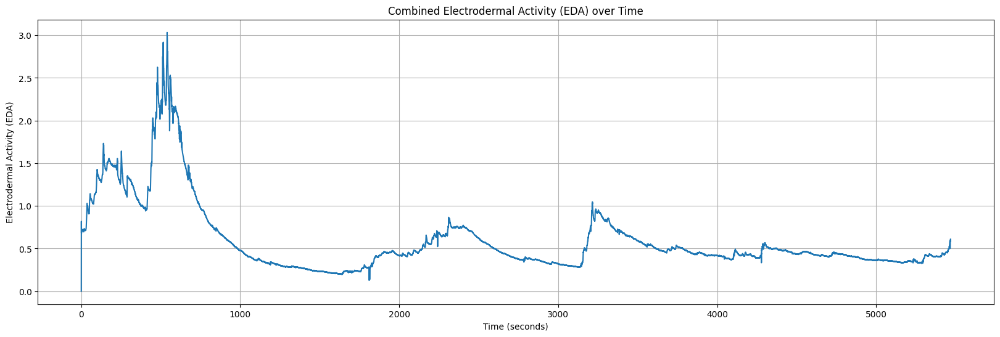

In [188]:
# Combine the two EDA signals by taking the average
combined_eda = (right_eda_df['EDA'] + left_eda_df['EDA']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_eda_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_eda_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_eda)
plt.title('Combined Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(True)
plt.show()

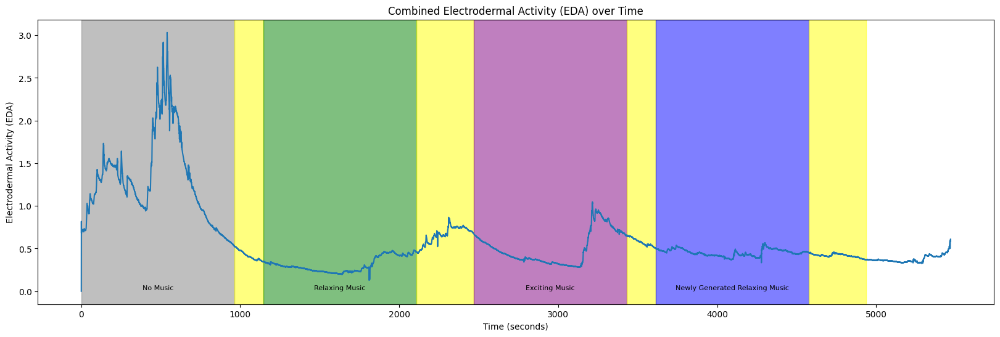

In [189]:
import matplotlib.pyplot as plt


# Combine the two EDA signals by taking the average
combined_eda = (right_eda_df['EDA'] + left_eda_df['EDA']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_eda_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_eda_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_eda)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_eda), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Combined Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(False)
plt.show()

### HR
- HR: Average heart rate (HR) extracted from the BVP signal. Values in the first column (HR) show the HR values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [190]:
left_hr_df=pd.read_csv(Left_HR_file)
left_hr_df

,HR,start_time_unix,sampling_rate
0,109.00,1.623676e+09,1.0
1,109.00,1.623676e+09,1.0
2,100.33,1.623676e+09,1.0
3,125.25,1.623676e+09,1.0
4,121.80,1.623676e+09,1.0
...,...,...,...
5455,70.85,1.623676e+09,1.0
5456,70.05,1.623676e+09,1.0
5457,69.25,1.623676e+09,1.0
5458,68.43,1.623676e+09,1.0


In [191]:
right_hr_df=pd.read_csv(Right_HR_file)
right_hr_df

,HR,start_time_unix,sampling_rate
0,79.00,1.623676e+09,1.0
1,63.50,1.623676e+09,1.0
2,81.67,1.623676e+09,1.0
3,75.75,1.623676e+09,1.0
4,72.80,1.623676e+09,1.0
...,...,...,...
5455,60.45,1.623676e+09,1.0
5456,59.53,1.623676e+09,1.0
5457,58.57,1.623676e+09,1.0
5458,57.78,1.623676e+09,1.0


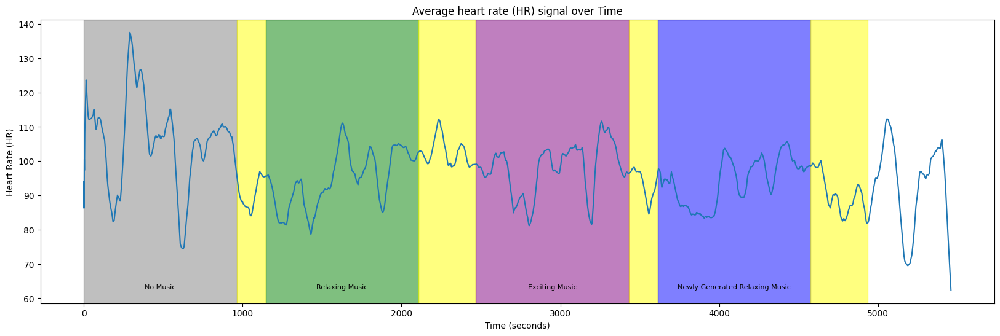

In [192]:
import matplotlib.pyplot as plt


# Combine the two hr signals by taking the average
combined_hr = (right_hr_df['HR'] + left_hr_df['HR']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_hr_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_hr_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_hr)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_hr), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Average heart rate (HR) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Heart Rate (HR)')
plt.grid(False)
plt.show()

### BVP
- BVP: Blood volume pulses (BVP) measured from a photoplethysmograph. Values in the first column (BVP) show the BVP values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [193]:
left_bvp_df=pd.read_csv(Left_BVP_file)
left_bvp_df

,BVP,start_time_unix,sampling_rate
0,-0.00,1.623676e+09,64.0
1,-0.00,1.623676e+09,64.0
2,-0.00,1.623676e+09,64.0
3,-0.00,1.623676e+09,64.0
4,-0.00,1.623676e+09,64.0
...,...,...,...
350070,97.89,1.623676e+09,64.0
350071,111.99,1.623676e+09,64.0
350072,119.38,1.623676e+09,64.0
350073,120.37,1.623676e+09,64.0


In [194]:
right_bvp_df=pd.read_csv(Right_BVP_file)
right_bvp_df

,BVP,start_time_unix,sampling_rate
0,-0.00,1.623676e+09,64.0
1,-0.00,1.623676e+09,64.0
2,-0.00,1.623676e+09,64.0
3,-0.00,1.623676e+09,64.0
4,-0.00,1.623676e+09,64.0
...,...,...,...
350059,100.70,1.623676e+09,64.0
350060,91.88,1.623676e+09,64.0
350061,73.94,1.623676e+09,64.0
350062,45.24,1.623676e+09,64.0


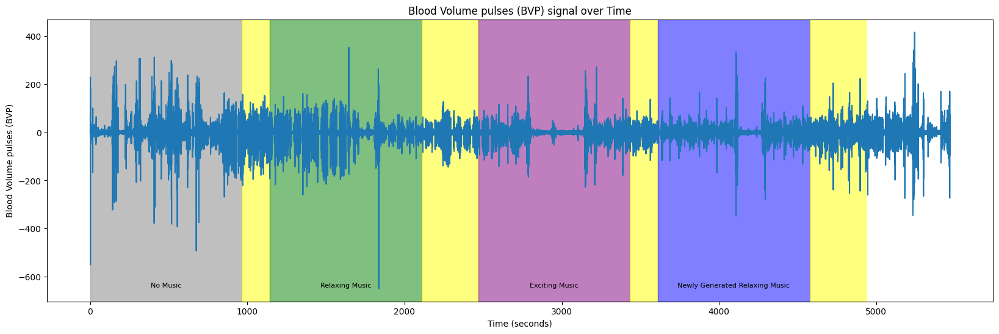

In [195]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_bvp = (right_bvp_df['BVP'] + left_bvp_df['BVP']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_bvp_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_bvp_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_bvp)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_bvp), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Blood Volume pulses (BVP) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Blood Volume pulses (BVP)')
plt.grid(False)
plt.show()

### Temperature
- TEMP: Skin temperature (TEMP) measured from temperature sensor expressed degrees on the Celsius (°C) scale. Values in the first column (TEMP) show the TEMP values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [196]:
left_temp_df=pd.read_csv(Left_TEMP_file)
left_temp_df

,TEMP,start_time_unix,sampling_rate
0,30.03,1.623676e+09,4.0
1,30.03,1.623676e+09,4.0
2,30.03,1.623676e+09,4.0
3,30.03,1.623676e+09,4.0
4,30.03,1.623676e+09,4.0
...,...,...,...
21875,27.23,1.623676e+09,4.0
21876,27.25,1.623676e+09,4.0
21877,27.25,1.623676e+09,4.0
21878,27.25,1.623676e+09,4.0


In [197]:
right_temp_df=pd.read_csv(Right_TEMP_file)
right_temp_df

,TEMP,start_time_unix,sampling_rate
0,29.37,1.623676e+09,4.0
1,29.37,1.623676e+09,4.0
2,29.37,1.623676e+09,4.0
3,29.37,1.623676e+09,4.0
4,29.37,1.623676e+09,4.0
...,...,...,...
21875,29.09,1.623676e+09,4.0
21876,29.09,1.623676e+09,4.0
21877,29.09,1.623676e+09,4.0
21878,29.09,1.623676e+09,4.0


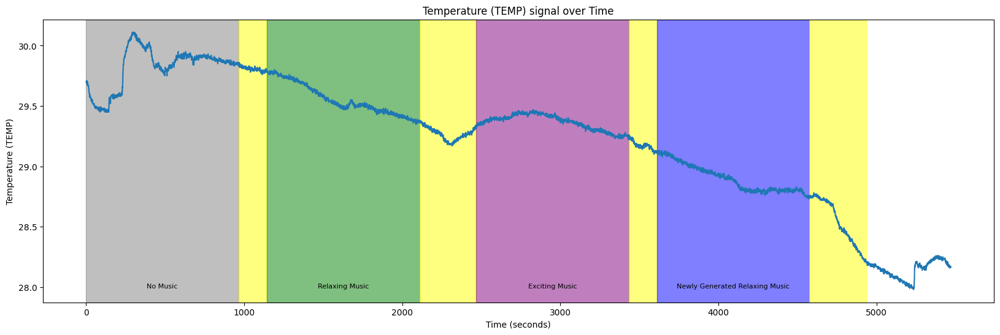

In [198]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_temp = (right_temp_df['TEMP'] + left_temp_df['TEMP']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_temp_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_temp_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_temp)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_temp), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Temperature (TEMP) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Temperature (TEMP)')
plt.grid(False)
plt.show()

### ACC
- ACC: Data from 3-axis accelerometer sensor. The accelerometer is configured to measure acceleration in the range [-2g, 2g]. Therefore, the unit in this file is 1/64g. Data from x, y, and z axis are labeled respectively (i.e., ACC_X, ACC_Y, and ACC_Z).  The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [199]:
left_ACC_df=pd.read_csv(Left_ACC_file)
left_ACC_df

,ACC_X,ACC_Y,ACC_Z,start_time_unix,sampling_rate
0,-23,-13,59,1.623676e+09,32.0
1,-22,-13,60,1.623676e+09,32.0
2,-23,-13,59,1.623676e+09,32.0
3,-23,-14,60,1.623676e+09,32.0
4,-23,-13,59,1.623676e+09,32.0
...,...,...,...,...,...
175057,-27,-12,57,1.623676e+09,32.0
175058,-23,-10,61,1.623676e+09,32.0
175059,-22,-9,61,1.623676e+09,32.0
175060,-25,-10,60,1.623676e+09,32.0


In [200]:
right_ACC_df=pd.read_csv(Right_ACC_file)
right_ACC_df

,ACC_X,ACC_Y,ACC_Z,start_time_unix,sampling_rate
0,-19,12,59,1.623676e+09,32.0
1,-19,12,59,1.623676e+09,32.0
2,-19,12,59,1.623676e+09,32.0
3,-18,12,59,1.623676e+09,32.0
4,-19,12,59,1.623676e+09,32.0
...,...,...,...,...,...
175057,24,9,57,1.623676e+09,32.0
175058,27,10,57,1.623676e+09,32.0
175059,25,10,57,1.623676e+09,32.0
175060,25,9,58,1.623676e+09,32.0


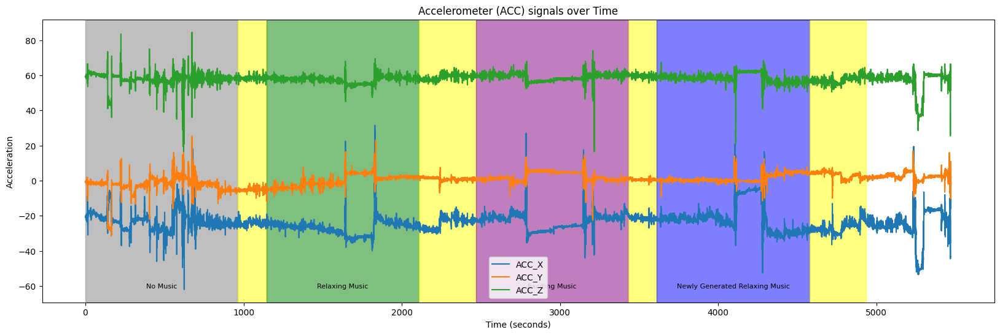

In [201]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_accX = (right_ACC_df['ACC_X'] + left_ACC_df['ACC_X']) / 2
combined_accY = (right_ACC_df['ACC_Y'] + left_ACC_df['ACC_Y']) / 2
combined_accZ = (right_ACC_df['ACC_Z'] + left_ACC_df['ACC_Z']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_ACC_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_ACC_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_accX, label='ACC_X')
plt.plot(time_seconds, combined_accY, label='ACC_Y')
plt.plot(time_seconds, combined_accZ, label='ACC_Z')

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_accX), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Accelerometer (ACC) signals over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Acceleration')
plt.legend()
plt.grid(False)
plt.show()

## EG

The EEG signals recorded from the Muse headband are also included in the dataset as 'EEG_recording.csv'. They include EEG channels from four locations: TP9, AF7, AF8, and TP10. The 2016 model Muse (MU-02) can also output RAW EEG data at 256Hz as well as being able to output RAW EEG from the right ear USB Auxiliary connector (named Right AUX in the csv files). The column (timestamps) shows the data points in UNIX format. EEG measurements are labeled as TP9, AF7, AF8, TP10, Right AUX.

In [202]:
eeg_df=pd.read_csv(EEG_file)
eeg_df

,timestamps,TP9,AF7,AF8,TP10,Right AUX
0,1.623676e+09,302.246,28.809,131.348,391.113,-67.871
1,1.623676e+09,-111.328,97.656,62.988,-274.414,-31.250
2,1.623676e+09,-225.098,160.156,-6.348,-949.707,-67.871
3,1.623676e+09,132.324,107.910,61.035,-436.523,-65.430
4,1.623676e+09,310.547,39.551,145.996,374.512,-43.457
...,...,...,...,...,...,...
1427815,1.623682e+09,16.113,69.336,5.371,-11.719,-25.391
1427816,1.623682e+09,45.410,118.652,-33.691,27.832,23.926
1427817,1.623682e+09,50.293,96.680,-17.090,50.293,27.832
1427818,1.623682e+09,43.457,75.684,8.301,41.504,11.719


C:\Users\user\AppData\Local\Temp\ipykernel_29192\2195272341.py:25: RuntimeWarning: divide by zero encountered in log10
  plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP9), shading='gouraud', cmap='viridis')


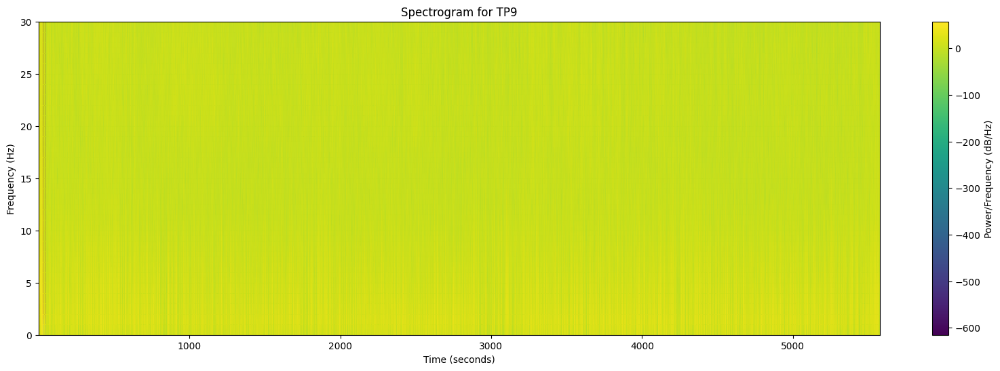

C:\Users\user\AppData\Local\Temp\ipykernel_29192\2195272341.py:35: RuntimeWarning: divide by zero encountered in log10
  plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap='viridis')


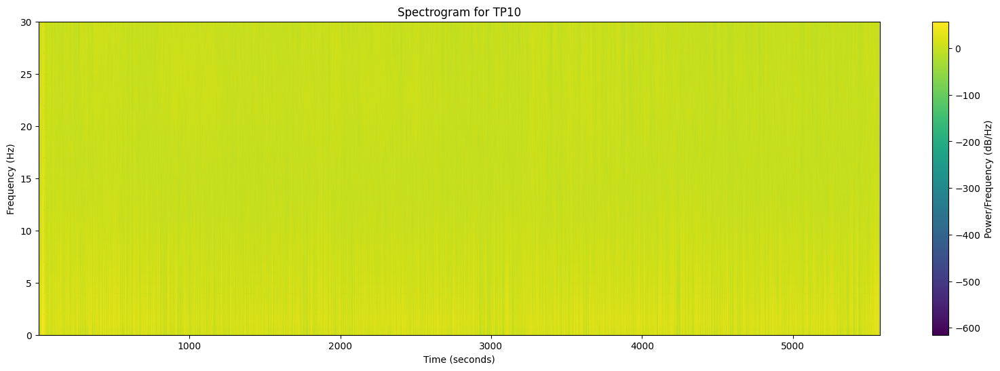

In [203]:
import matplotlib.pyplot as plt
from scipy import signal
# Extract the desired channels (TP9 and TP10)
channels = ['TP9', 'TP10']  
eeg_data = eeg_df[channels]

# Convert the timestamps to time in seconds
sampling_rate = 256  # Sampling rate of the EEG data in Hz
time_seconds = eeg_df['timestamps'] / sampling_rate

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 256    # Length of each segment
noverlap = 128   # Overlap between segments
nfft = 256       # Number of points for the FFT

# Compute the spectrogram for each channel
frequencies, times, spectrogram_TP9 = signal.spectrogram(eeg_data['TP9'], fs=sampling_rate, window=window, 
                                                         nperseg=nperseg, noverlap=noverlap, nfft=nfft)
_, _, spectrogram_TP10 = signal.spectrogram(eeg_data['TP10'], fs=sampling_rate, window=window, 
                                            nperseg=nperseg, noverlap=noverlap, nfft=nfft)

# Plot the spectrogram for TP9
plt.figure(figsize=(20, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP9), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP9')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
plt.show()

# Plot the spectrogram for TP10
plt.figure(figsize=(20, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP10')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
plt.show()

C:\Users\user\AppData\Local\Temp\ipykernel_29192\2743015402.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eeg_data[channel] = signal.filtfilt(b, a, eeg_data[channel])


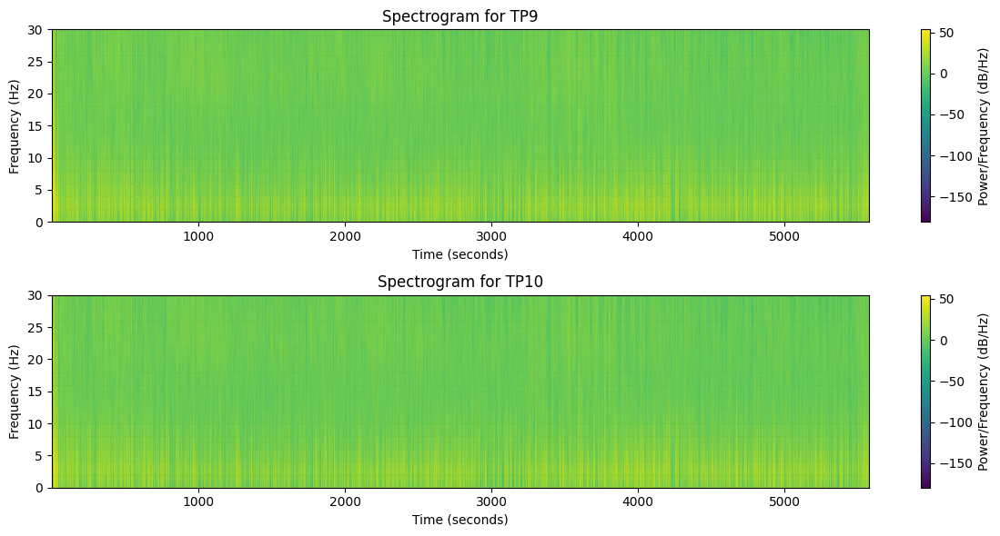

In [204]:
# Extract the desired channels (TP9 and TP10)
channels = ['TP9', 'TP10']  
eeg_data = eeg_df[channels]

# Convert the timestamps to time in seconds
sampling_rate = 256  # Sampling rate of the EEG data in Hz
time_seconds = eeg_df['timestamps'] / sampling_rate

# Preprocess the EEG signals
for channel in channels:
    # Apply high-pass filter above 1 Hz and low-pass filter below 50 Hz
    b, a = signal.butter(4, [1, 50], btype='bandpass', fs=sampling_rate)
    eeg_data[channel] = signal.filtfilt(b, a, eeg_data[channel])

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 128    # Length of each segment
noverlap = 64    # Overlap between segments
nfft = 128       # Number of points for the FFT

# Compute the spectrogram for each channel
frequencies, times, spectrogram_TP9 = signal.spectrogram(eeg_data['TP9'], fs=sampling_rate, window=window, 
                                                         nperseg=nperseg, noverlap=noverlap, nfft=nfft)
_, _, spectrogram_TP10 = signal.spectrogram(eeg_data['TP10'], fs=sampling_rate, window=window, 
                                            nperseg=nperseg, noverlap=noverlap, nfft=nfft)

# Plot the spectrogram for TP9
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP9), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP9')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz

# Plot the spectrogram for TP10
plt.subplot(2, 1, 2)
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP10')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz

plt.tight_layout()
plt.show()

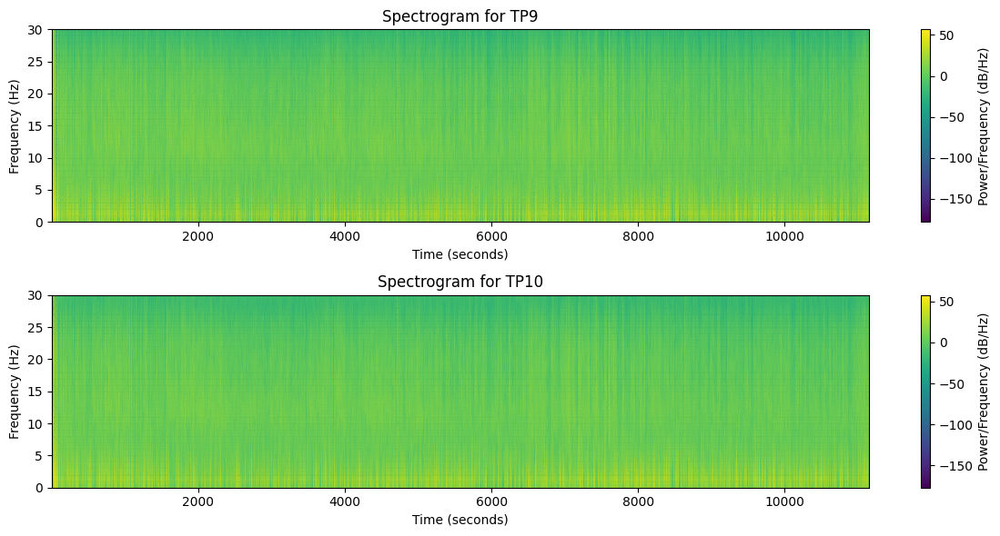

In [1283]:
import numpy as np
import matplotlib.pyplot as plt

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 128    # Length of each segment
noverlap = 64    # Overlap between segments
nfft = 128       # Number of points for the FFT

# Compute the spectrogram for each channel
frequencies, times, spectrogram_TP9 = signal.spectrogram(eeg_data['TP9'], fs=sampling_rate / 2, window=window, 
                                                         nperseg=nperseg, noverlap=noverlap, nfft=nfft)
_, _, spectrogram_TP10 = signal.spectrogram(eeg_data['TP10'], fs=sampling_rate / 2, window=window, 
                                            nperseg=nperseg, noverlap=noverlap, nfft=nfft)

# Plot the spectrogram for TP9
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP9), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP9')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz

# Plot the spectrogram for TP10
plt.subplot(2, 1, 2)
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP10')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz

plt.tight_layout()
plt.show()

C:\Users\user\AppData\Local\Temp\ipykernel_27420\1305613029.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eeg_data[channel] = signal.filtfilt(b, a, eeg_data[channel])
C:\Users\user\AppData\Local\Temp\ipykernel_27420\1305613029.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eeg_data[channel] = eeg_data[channel][::downsampling_factor]


Spectrogram shape for TP9: (65, 22308)
Spectrogram shape for TP10: (65, 22308)


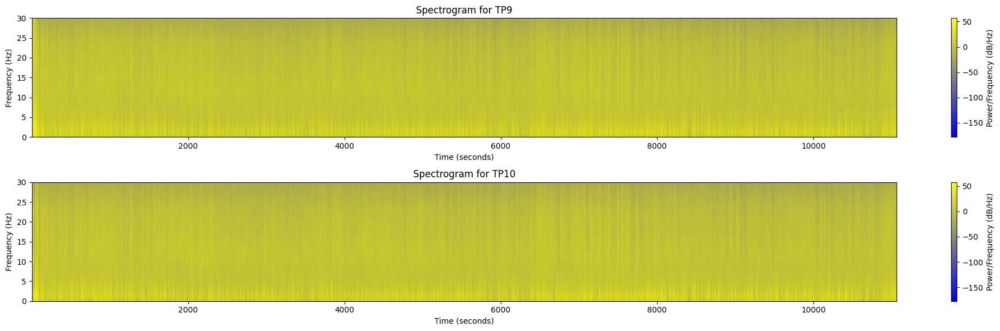

In [1284]:
import matplotlib.colors as mcolors
from scipy.signal import decimate
# Define the sampling rate
sampling_rate = 256  # Hz

# Define the desired sampling rate after downsampling
desired_sampling_rate = 129  # Hz

# Extract the desired channels (TP9 and TP10)
channels = ['TP9', 'TP10']
eeg_data = eeg_df[channels]

# Convert the timestamps to time in seconds
time_seconds = eeg_df['timestamps'] / sampling_rate

# Preprocess the EEG signals
for channel in channels:
    # Apply high-pass filter above 1 Hz and low-pass filter below 50 Hz
    b, a = signal.butter(4, [1, 50], btype='bandpass', fs=sampling_rate)
    eeg_data[channel] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample the signal from 256 to 128 Hz
    # original_length = len(eeg_data[channel])
    downsampling_factor = int(sampling_rate / desired_sampling_rate)
    eeg_data[channel] = eeg_data[channel][::downsampling_factor]

print("Spectrogram shape for TP9:", spectrogram_TP9.shape)
print("Spectrogram shape for TP10:", spectrogram_TP10.shape)
# print("Min value of spectrogram_TP9:", np.min(spectrogram_TP9))
# print("Max value of spectrogram_TP9:", np.max(spectrogram_TP9))
# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 128    # Length of each segment
noverlap = 64    # Overlap between segments
nfft = 128       # Number of points for the FFT

# Compute the spectrogram for each channel
frequencies, times, spectrogram_TP9 = signal.spectrogram(eeg_data['TP9'], fs=desired_sampling_rate, window=window, 
                                                         nperseg=nperseg, noverlap=noverlap, nfft=nfft)
_, _, spectrogram_TP10 = signal.spectrogram(eeg_data['TP10'], fs=desired_sampling_rate, window=window, 
                                            nperseg=nperseg, noverlap=noverlap, nfft=nfft)



# Define custom colormap transitioning from yellow to blue
colors = ['blue','yellow']
cmap = mcolors.LinearSegmentedColormap.from_list("YellowBlue", colors)
# Plot the spectrogram for TP9
plt.figure(figsize=(20, 6))
plt.subplot(2, 1, 1)
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP9), shading='gouraud', cmap=cmap)
plt.title('Spectrogram for TP9')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz

# Plot the spectrogram for TP10
plt.subplot(2, 1, 2)
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap=cmap)
plt.title('Spectrogram for TP10')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz

plt.tight_layout()
plt.show()

Text(0.5, 0, 'time (s)')

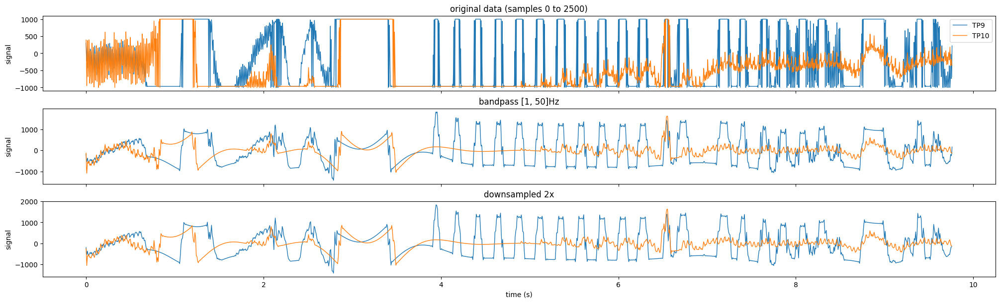

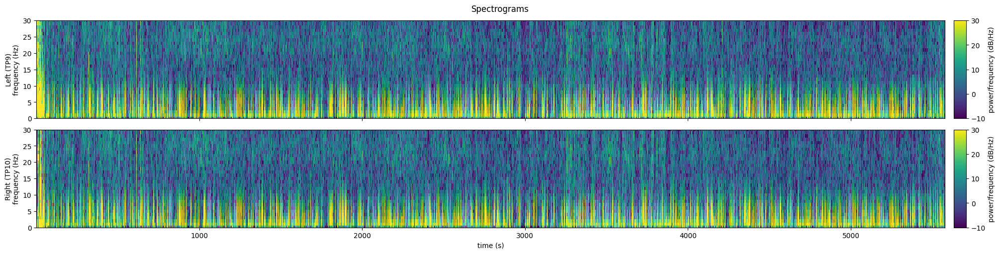

In [205]:
eeg_df['sample_number'] = range(len(eeg_df))
# Sampling rate of the EEG data in Hz
sampling_rate = 256  


# Convert the sample index to time in seconds
# This means you need to divide the sample *number* by the sampling rate
eeg_df['time_seconds'] = eeg_df['sample_number'] / sampling_rate

# Extract the desired channels (TP9 and TP10)
keep_channels = ['TP9', 'TP10']
eeg_data = eeg_df[keep_channels + ['time_seconds']].copy()

#
# Preprocess the EEG signals
#

#Define the pre-preprocessing parameters
downsample_factor = 2
bp_order = 4
bp_passband = [1, 50]
downsample_factor = 2

eeg_downsampled = pd.DataFrame()
downsampled_length = len(eeg_data) // downsample_factor

for channel in keep_channels:
    filtered_name = channel + '_bp'
    # Apply high-pass filter above 1 Hz and low-pass filter below 50 Hz
    b, a = signal.butter(bp_order, bp_passband, btype='bandpass', fs=sampling_rate)
    eeg_data[filtered_name] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample the signal from 256 to 128 Hz
    # Put the shorter signals in a new dataframe "eeg_downsampled"
    eeg_downsampled[channel] = signal.resample(eeg_data[filtered_name], downsampled_length)
eeg_downsampled['time_seconds'] = np.arange(downsampled_length) / (sampling_rate / downsample_factor)

#
# View the original and processed data
#
plot_height = 2
n_plots = 3
f, axs = plt.subplots(nrows=n_plots, ncols=1,
                      figsize=(20, plot_height * n_plots),
                      layout='constrained', sharex=True)

plot_slice = slice(0, 2500) #window of data to plot

#Original data
eeg_data[plot_slice].plot(
    y=keep_channels, x='time_seconds',
    ylabel='signal', xlabel='time (s)',
    linewidth=1, ax=axs[0],
    title=f'original data (samples {plot_slice.start} to {plot_slice.stop})'
)

#Filtered
eeg_data[plot_slice].plot(
    y=[chan + '_bp' for chan in keep_channels], x='time_seconds',
    ylabel='signal', xlabel='time (s)', legend=False,
    linewidth=1, ax=axs[1], title=f'bandpass {bp_passband}Hz'
)

#Downsampled
eeg_downsampled[plot_slice.start:plot_slice.stop//downsample_factor].plot(
    y=keep_channels, x='time_seconds',
    ylabel='signal', xlabel='time (s)', legend=False,
    linewidth=1, ax=axs[2], title=f'downsampled {downsample_factor}x'
)

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 128    # Length of each segment
noverlap = 64    # Overlap between segments
nfft = 128       # Number of points for the FFT

# Compute the spectrogram for each channel
spectrograms = {}
for channel in keep_channels:
    frequencies, times, spectrogram = signal.spectrogram(
        eeg_downsampled[channel],
        fs=sampling_rate / downsample_factor,
        window=window, nperseg=nperseg, noverlap=noverlap, nfft=nfft
    )
    spectrograms[channel] = spectrogram

# Plot the spectrograms
f, axs = plt.subplots(nrows=2, ncols=1, figsize=(20, 5),
                      layout='constrained', sharex=True)
f.suptitle('Spectrograms')
vmin, vmax = -10, 30

for channel, ax in zip(keep_channels, axs):
    im = ax.pcolormesh(
        times, frequencies, 10 * np.log10(spectrograms[channel]),
        vmin=vmin, vmax=vmax, #comment out for auto-range
        shading='nearest', cmap='viridis'
    )
    
    ax.set_ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
    ax.set_ylabel(('Left' if channel=='TP9' else 'Right') + f' ({channel})\nfrequency (Hz)')
    
    cbar = f.colorbar(im, aspect=8, pad=0.01, label='power/frequency (dB/Hz)')
    
ax.set_xlabel('time (s)')

### Beta Band Frequency

C:\Users\user\AppData\Local\Temp\ipykernel_29192\2331215207.py:79: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")
C:\Users\user\AppData\Local\Temp\ipykernel_29192\2331215207.py:79: UserWarning: 

The `join` parameter is deprecated and will be removed in v0.15.0.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")


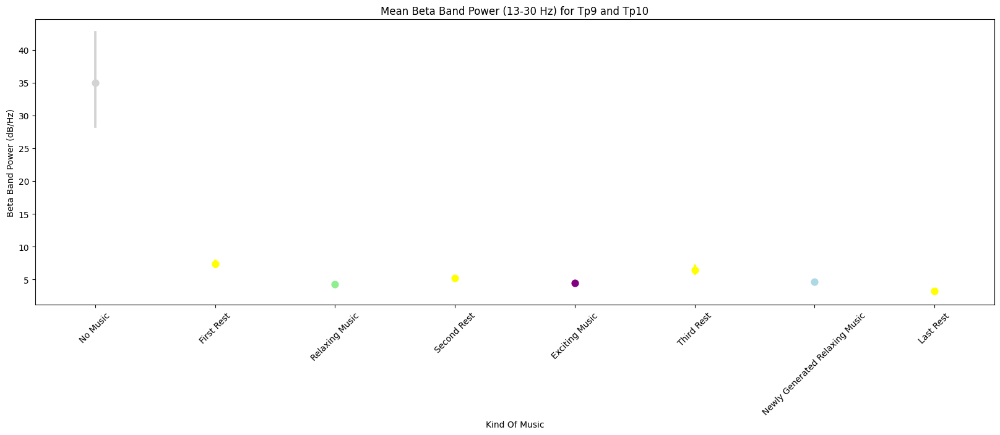

In [206]:
# Sample EEG DataFrame
# Assuming you have an EEG DataFrame named eeg_df with columns 'TP9' and 'TP10'

# Preprocessing parameters
sampling_rate = 256
downsample_factor = 2
bp_order = 4
bp_passband = [1, 50]

# Apply preprocessing and downsampling
eeg_df['sample_number'] = range(len(eeg_df))
eeg_df['time_seconds'] = eeg_df['sample_number'] / sampling_rate

eeg_data = eeg_df[['TP9', 'TP10', 'time_seconds']].copy()

eeg_downsampled = pd.DataFrame()
downsampled_length = len(eeg_data) // downsample_factor

for channel in ['TP9', 'TP10']:
    filtered_name = channel + '_bp'
    # Apply bandpass filter
    b, a = signal.butter(bp_order, bp_passband, btype='bandpass', fs=sampling_rate)
    eeg_data[filtered_name] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample
    eeg_downsampled[channel] = signal.resample(eeg_data[filtered_name], downsampled_length)

eeg_downsampled['time_seconds'] = np.arange(downsampled_length) / (sampling_rate / downsample_factor)

# Compute spectrogram for each channel
frequencies, times, spectrogram_tp9 = signal.spectrogram(
    eeg_downsampled['TP9'],
    fs=sampling_rate / downsample_factor,
    window='hann', nperseg=128, noverlap=64, nfft=128
)

_, _, spectrogram_tp10 = signal.spectrogram(
    eeg_downsampled['TP10'],
    fs=sampling_rate / downsample_factor,
    window='hann', nperseg=128, noverlap=64, nfft=128
)

# Compute beta band power (13-30 Hz) for each channel
beta_band_power_tp9 = np.mean(spectrogram_tp9[(frequencies >= 13) & (frequencies <= 30)], axis=0)
beta_band_power_tp10 = np.mean(spectrogram_tp10[(frequencies >= 13) & (frequencies <= 30)], axis=0)

# Compute mean beta band power across channels
mean_beta_band_power = (beta_band_power_tp9 + beta_band_power_tp10) / 2

# Define intervals and corresponding labels
intervals = [
    (0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
    (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                            964 + 180 + 964 + 360 + 964 + 180),
    (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
    (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)
]
labels = ['No Music', 'First Rest', 'Relaxing Music', 'Second Rest', 'Exciting Music', 'Third Rest',
          'Newly Generated Relaxing Music', 'Last Rest']

# Assign labels to each data point based on intervals
beta_power_df = pd.DataFrame({'Time': times, 'Power': mean_beta_band_power})
beta_power_df['Kind Of Music'] = pd.cut(beta_power_df['Time'], bins=[interval[0] for interval in intervals] + [np.inf], labels=labels)

# Define color palette dictionary
color_palette = {
    'No Music': 'lightgray',
    'First Rest': 'yellow',
    'Relaxing Music': 'lightgreen',
    'Second Rest': 'yellow',
    'Exciting Music': 'purple',
    'Third Rest': 'yellow',
    'Newly Generated Relaxing Music': 'lightblue',
    'Last Rest': 'yellow'
}

# Plot
plt.figure(figsize=(20, 6))
sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")
plt.title('Mean Beta Band Power (13-30 Hz) for Tp9 and Tp10')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Kind Of Music')
plt.xticks(rotation=45)
plt.show()

C:\Users\user\AppData\Local\Temp\ipykernel_29192\3532274209.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette)


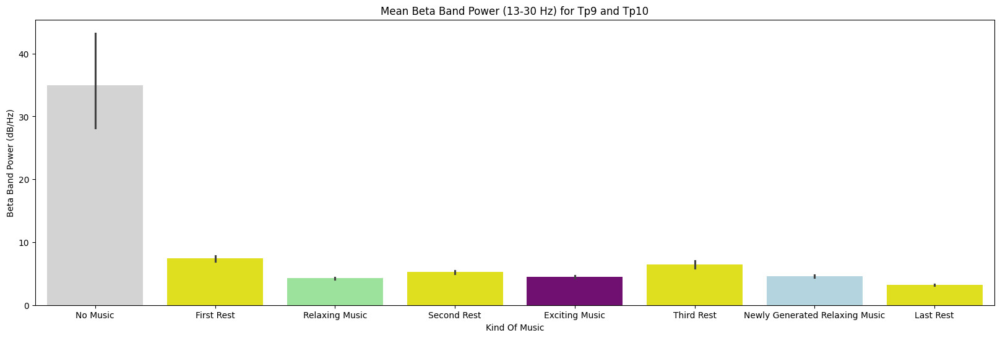

In [207]:
# Apply color palette for the bar plot
color_palette = {
    'No Music': 'lightgray',
    'First Rest': 'yellow',
    'Relaxing Music': 'lightgreen',
    'Second Rest': 'yellow',
    'Exciting Music': 'purple',
    'Third Rest': 'yellow',
    'Newly Generated Relaxing Music': 'lightblue',
    'Last Rest': 'yellow'
}

# Generate the bar plot
plt.figure(figsize=(20, 6))
sns.barplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette)
plt.title('Mean Beta Band Power (13-30 Hz) for Tp9 and Tp10')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Kind Of Music')
plt.show()

# Patient A3

In [208]:
# Define the file paths for the A3 data files
EEG_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A3\EEG_recording.csv'
Left_ACC_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A3\Left_ACC.csv'
Left_BVP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A3\Left_BVP.csv'
Left_EDA_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A3\Left_EDA.csv'
Left_HR_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A3\Left_HR.csv'
Left_IBI_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A3\Left_IBI.csv'
Left_tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A3\Left_tags.csv'
Left_TEMP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A3\Left_TEMP.csv'
n_back_responses_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A3\n_back_responses.csv'
Right_ACC_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A3\Right_ACC.csv'
Right_BVP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A3\Right_BVP.csv'
Right_EDA_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A3\Right_EDA.csv'
Right_HR_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A3\Right_HR.csv'
Right_IBI_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A3\Right_IBI.csv'
Right_tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A3\Right_tags.csv'
Right_TEMP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A3\Right_TEMP.csv'
tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A3\tags.csv'

## n back responses

In [1287]:
n_backr_df=pd.read_csv(n_back_responses_file)
n_backr_df

,ExperimentName,Start_time_unix,Subject,Session,DataFile.Basename,Display.RefreshRate,ExperimentVersion,Group,InstructionNewMusic.DEVICE,InstructionNoMusic.DEVICE,...,TrialList8.Cycle,TrialList8.Sample,TSO,TSTh,TSvO,TSvTh,TSxO,TSxTh,TTO,TTTh
0,Experiment_1,1623777763,3,1,Experiment_1-3-1,75.03,1.0.0.251,1,Chronos,Chronos,...,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Experiment_1,1623777763,3,1,Experiment_1-3-1,75.03,1.0.0.251,1,Chronos,Chronos,...,1.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Experiment_1,1623777763,3,1,Experiment_1-3-1,75.03,1.0.0.251,1,Chronos,Chronos,...,1.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Experiment_1,1623777763,3,1,Experiment_1-3-1,75.03,1.0.0.251,1,Chronos,Chronos,...,1.0,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Experiment_1,1623777763,3,1,Experiment_1-3-1,75.03,1.0.0.251,1,Chronos,Chronos,...,1.0,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,Experiment_1,1623777763,3,1,Experiment_1-3-1,75.03,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1452,Experiment_1,1623777763,3,1,Experiment_1-3-1,75.03,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1453,Experiment_1,1623777763,3,1,Experiment_1-3-1,75.03,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1454,Experiment_1,1623777763,3,1,Experiment_1-3-1,75.03,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1288]:
n_backr_df.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 250 columns):
 #    Column                                   Non-Null Count  Dtype  
---   ------                                   --------------  -----  
 0    ExperimentName                           1456 non-null   object 
 1    Start_time_unix                          1456 non-null   int64  
 2    Subject                                  1456 non-null   int64  
 3    Session                                  1456 non-null   int64  
 4    DataFile.Basename                        1456 non-null   object 
 5    Display.RefreshRate                      1456 non-null   float64
 6    ExperimentVersion                        1456 non-null   object 
 7    Group                                    1456 non-null   int64  
 8    InstructionNewMusic.DEVICE               1456 non-null   object 
 9    InstructionNoMusic.DEVICE                1456 non-null   object 
 10   InstructionNoMusic.DurationError  

In [1289]:
df_length=len(n_backr_df)

In [1290]:
# Filter columns with length 1456
non_null_columns = [col for col in n_backr_df.columns if n_backr_df[col].notnull().all()]
# Create a new DataFrame with only columns of the same length as the DataFrame
complete_df = n_backr_df[non_null_columns]
complete_df

,ExperimentName,Start_time_unix,Subject,Session,DataFile.Basename,Display.RefreshRate,ExperimentVersion,Group,InstructionNewMusic.DEVICE,InstructionNoMusic.DEVICE,...,Welcome.DurationError,Welcome.OnsetDelay,Welcome.OnsetTime,Welcome.OnsetToOnsetTime,Block,Instruction,ListName,Procedure[Block],Running[Block],Trigger
0,Experiment_1,1623777763,3,1,Experiment_1-3-1,75.03,1.0.0.251,1,Chronos,Chronos,...,-999999,12,35220,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
1,Experiment_1,1623777763,3,1,Experiment_1-3-1,75.03,1.0.0.251,1,Chronos,Chronos,...,-999999,12,35220,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
2,Experiment_1,1623777763,3,1,Experiment_1-3-1,75.03,1.0.0.251,1,Chronos,Chronos,...,-999999,12,35220,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
3,Experiment_1,1623777763,3,1,Experiment_1-3-1,75.03,1.0.0.251,1,Chronos,Chronos,...,-999999,12,35220,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
4,Experiment_1,1623777763,3,1,Experiment_1-3-1,75.03,1.0.0.251,1,Chronos,Chronos,...,-999999,12,35220,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,Experiment_1,1623777763,3,1,Experiment_1-3-1,75.03,1.0.0.251,1,Chronos,Chronos,...,-999999,12,35220,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1452,Experiment_1,1623777763,3,1,Experiment_1-3-1,75.03,1.0.0.251,1,Chronos,Chronos,...,-999999,12,35220,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1453,Experiment_1,1623777763,3,1,Experiment_1-3-1,75.03,1.0.0.251,1,Chronos,Chronos,...,-999999,12,35220,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1454,Experiment_1,1623777763,3,1,Experiment_1-3-1,75.03,1.0.0.251,1,Chronos,Chronos,...,-999999,12,35220,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2


### Instruction

In [1291]:
instruction = n_backr_df.columns
instruction[instruction.str.contains('Instruction')]
#.str.contains('SNOMED')]

Index(['InstructionNewMusic.DEVICE', 'InstructionNoMusic.DEVICE',
       'InstructionNoMusic.DurationError', 'InstructionNoMusic.OnsetDelay',
       'InstructionNoMusic.OnsetTime', 'InstructionNoMusic.OnsetToOnsetTime',
       'InstructionRelaxMusic.DEVICE', 'InstructionRelaxMusic.DurationError',
       'InstructionRelaxMusic.OnsetDelay', 'InstructionRelaxMusic.OnsetTime',
       'InstructionRelaxMusic.OnsetToOnsetTime',
       'InstructionStressMusic.DEVICE', 'InstructionStressMusic.DurationError',
       'InstructionStressMusic.OnsetDelay', 'InstructionStressMusic.OnsetTime',
       'InstructionStressMusic.OnsetToOnsetTime', 'Instruction'],
      dtype='object')

In [1292]:
instruction_df=n_backr_df[instruction[instruction.str.contains('Instruction')]]

### Stimulus

In [1293]:
stimulus = n_backr_df.columns
stimulus=stimulus[stimulus.str.contains('Stimulus')]

In [1294]:
stimulus

Index(['Stimulus100.ACC', 'Stimulus100.CRESP', 'Stimulus100.DEVICE',
       'Stimulus100.DurationError', 'Stimulus100.OnsetDelay',
       'Stimulus100.OnsetTime', 'Stimulus100.OnsetToOnsetTime',
       'Stimulus100.RESP', 'Stimulus100.RT', 'Stimulus100.RTTime',
       'Stimulus101.ACC', 'Stimulus101.CRESP', 'Stimulus101.DEVICE',
       'Stimulus101.DurationError', 'Stimulus101.OnsetDelay',
       'Stimulus101.OnsetTime', 'Stimulus101.OnsetToOnsetTime',
       'Stimulus101.RESP', 'Stimulus101.RT', 'Stimulus101.RTTime',
       'Stimulus102.ACC', 'Stimulus102.CRESP', 'Stimulus102.DEVICE',
       'Stimulus102.DurationError', 'Stimulus102.OnsetDelay',
       'Stimulus102.OnsetTime', 'Stimulus102.OnsetToOnsetTime',
       'Stimulus102.RESP', 'Stimulus102.RT', 'Stimulus102.RTTime',
       'Stimulus103.ACC', 'Stimulus103.CRESP', 'Stimulus103.DEVICE',
       'Stimulus103.DurationError', 'Stimulus103.OnsetDelay',
       'Stimulus103.OnsetTime', 'Stimulus103.OnsetToOnsetTime',
       'Stimulus103

In [1295]:
# Create a dictionary to store the mapping of columns to Running[Block] values
column_to_block = {}
running_block_values=n_backr_df['Running[Block]'].unique()
# Create a dictionary to store the mapping of stimulus columns to lists of Running[Block] values

stimulus_to_blocks = {}

# Iterate over each stimulus column
for col in stimulus:
    # Store all 4 Running[Block] values as a list for this stimulus column
    stimulus_to_blocks[col] = running_block_values

print(stimulus_to_blocks)

{'Stimulus100.ACC': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.CRESP': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.DEVICE': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.DurationError': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetDelay': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetTime': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetToOnsetTime': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.RESP': array(['PracticeSessi

In [1296]:
# Create a new dictionary to store the suffixed keys and values
suffixed_dict = {}

# Iterate over each key in stimulus_to_blocks dictionary
for key, values in stimulus_to_blocks.items():
    # Get the prefix (e.g., 'Stimulus100') from the key
    prefix = key.split('.')[0]
    
    # Create a list to store the suffixed column names
    suffixed_columns = []
    
    # Iterate over each column name in stimulus_columns
    for col in stimulus:
        # If the column name starts with the same prefix
        if col.startswith(prefix):
            # Append the suffixed column name to the list
            suffixed_columns.append(col)
    
    # Create the suffixed key by joining the prefix with ':'
    suffixed_key = f'{prefix}:'
    
    # Add the suffixed column names list as the value for the suffixed key
    suffixed_dict[suffixed_key] = suffixed_columns

print(suffixed_dict)

{'Stimulus100:': ['Stimulus100.ACC', 'Stimulus100.CRESP', 'Stimulus100.DEVICE', 'Stimulus100.DurationError', 'Stimulus100.OnsetDelay', 'Stimulus100.OnsetTime', 'Stimulus100.OnsetToOnsetTime', 'Stimulus100.RESP', 'Stimulus100.RT', 'Stimulus100.RTTime'], 'Stimulus101:': ['Stimulus101.ACC', 'Stimulus101.CRESP', 'Stimulus101.DEVICE', 'Stimulus101.DurationError', 'Stimulus101.OnsetDelay', 'Stimulus101.OnsetTime', 'Stimulus101.OnsetToOnsetTime', 'Stimulus101.RESP', 'Stimulus101.RT', 'Stimulus101.RTTime'], 'Stimulus102:': ['Stimulus102.ACC', 'Stimulus102.CRESP', 'Stimulus102.DEVICE', 'Stimulus102.DurationError', 'Stimulus102.OnsetDelay', 'Stimulus102.OnsetTime', 'Stimulus102.OnsetToOnsetTime', 'Stimulus102.RESP', 'Stimulus102.RT', 'Stimulus102.RTTime'], 'Stimulus103:': ['Stimulus103.ACC', 'Stimulus103.CRESP', 'Stimulus103.DEVICE', 'Stimulus103.DurationError', 'Stimulus103.OnsetDelay', 'Stimulus103.OnsetTime', 'Stimulus103.OnsetToOnsetTime', 'Stimulus103.RESP', 'Stimulus103.RT', 'Stimulus103.R

#### Stimulus Table 100

In [1297]:
# Filter columns that start with 'Stimulus100'
stimulus100_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus100')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
stimulus100_df=n_backr_df[stimulus100_columns]
stimulus100_df

,Stimulus100.ACC,Stimulus100.CRESP,Stimulus100.DEVICE,Stimulus100.DurationError,Stimulus100.OnsetDelay,Stimulus100.OnsetTime,Stimulus100.OnsetToOnsetTime,Stimulus100.RESP,Stimulus100.RT,Stimulus100.RTTime,Running[Block]
0,0.0,3.0,Chronos,1.0,-1.0,68901.0,506.0,NaN,0.0,0.0,PracticeSession
1,0.0,3.0,Chronos,2.0,19.0,70926.0,507.0,NaN,0.0,0.0,PracticeSession
2,0.0,3.0,Chronos,1.0,6.0,72939.0,506.0,NaN,0.0,0.0,PracticeSession
3,0.0,4.0,Chronos,1.0,7.0,74952.0,506.0,NaN,0.0,0.0,PracticeSession
4,0.0,4.0,Chronos,1.0,6.0,76964.0,507.0,NaN,0.0,0.0,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 101

In [1298]:
# Filter columns that start with 'Stimulus100'
stimulus101_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus101')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus101_df=n_backr_df[stimulus101_columns]
stimulus101_df

,Stimulus101.ACC,Stimulus101.CRESP,Stimulus101.DEVICE,Stimulus101.DurationError,Stimulus101.OnsetDelay,Stimulus101.OnsetTime,Stimulus101.OnsetToOnsetTime,Stimulus101.RESP,Stimulus101.RT,Stimulus101.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 102

In [1299]:
# Filter columns that start with 'Stimulus100'
stimulus102_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus102')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus102_df=n_backr_df[stimulus102_columns]
stimulus102_df

,Stimulus102.ACC,Stimulus102.CRESP,Stimulus102.DEVICE,Stimulus102.DurationError,Stimulus102.OnsetDelay,Stimulus102.OnsetTime,Stimulus102.OnsetToOnsetTime,Stimulus102.RESP,Stimulus102.RT,Stimulus102.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 103

In [1300]:
# Filter columns that start with 'Stimulus100'
stimulus103_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus103')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus103_df=n_backr_df[stimulus103_columns]
stimulus103_df

,Stimulus103.ACC,Stimulus103.CRESP,Stimulus103.DEVICE,Stimulus103.DurationError,Stimulus103.OnsetDelay,Stimulus103.OnsetTime,Stimulus103.OnsetToOnsetTime,Stimulus103.RESP,Stimulus103.RT,Stimulus103.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 104

In [1301]:
# Filter columns that start with 'Stimulus100'
stimulus104_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus104')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus104_df=n_backr_df[stimulus104_columns]
stimulus104_df

,Stimulus104.ACC,Stimulus104.CRESP,Stimulus104.DEVICE,Stimulus104.DurationError,Stimulus104.OnsetDelay,Stimulus104.OnsetTime,Stimulus104.OnsetToOnsetTime,Stimulus104.RESP,Stimulus104.RT,Stimulus104.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,1.0,3.0,Chronos,1.0,20.0,4735691.0,0.0,3.0,307.0,4735998.0,NewMusicSession
1452,1.0,3.0,Chronos,2.0,19.0,4737530.0,0.0,3.0,353.0,4737883.0,NewMusicSession
1453,1.0,3.0,Chronos,2.0,19.0,4739409.0,0.0,3.0,296.0,4739705.0,NewMusicSession
1454,0.0,4.0,Chronos,2.0,19.0,4741235.0,507.0,NaN,0.0,0.0,NewMusicSession


### Fixation

In [1302]:
n_back_columns = n_backr_df.columns
fixation=n_back_columns[n_back_columns.str.contains('Fixation')]

In [1303]:
fixation_df=n_backr_df[n_back_columns[n_back_columns.str.contains('Fixation')]]

In [1304]:
fixation_df

,Fixation100.ACC,Fixation100.CRESP,Fixation100.DEVICE,Fixation100.DurationError,Fixation100.OnsetDelay,Fixation100.OnsetTime,Fixation100.OnsetToOnsetTime,Fixation100.RESP,Fixation100.RT,Fixation100.RTTime,...,Fixation104.ACC,Fixation104.CRESP,Fixation104.DEVICE,Fixation104.DurationError,Fixation104.OnsetDelay,Fixation104.OnsetTime,Fixation104.OnsetToOnsetTime,Fixation104.RESP,Fixation104.RT,Fixation104.RTTime
0,0.0,3.0,Chronos,1.0,6.0,69407.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1.0,3.0,Chronos,1.0,7.0,71433.0,0.0,3.0,1402.0,72835.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1.0,3.0,Chronos,2.0,6.0,73445.0,0.0,3.0,1492.0,74937.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1.0,4.0,Chronos,1.0,6.0,75458.0,0.0,4.0,390.0,75848.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1.0,4.0,Chronos,1.0,7.0,77471.0,0.0,4.0,160.0,77631.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,3.0,Chronos,1.0,13.0,4736011.0,0.0,NaN,0.0,0.0
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,3.0,Chronos,1.0,6.0,4737890.0,0.0,NaN,0.0,0.0
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,3.0,Chronos,1.0,11.0,4739716.0,0.0,NaN,0.0,0.0
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,4.0,Chronos,1.0,7.0,4741742.0,0.0,4.0,13.0,4741755.0


#### Fixation table 100

In [1305]:
# Filter columns that start with 'Fixation100'
fixation100_columns = [col for col in n_backr_df.columns if col.startswith('Fixation100')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation100_df=n_backr_df[fixation100_columns]
fixation100_df

,Fixation100.ACC,Fixation100.CRESP,Fixation100.DEVICE,Fixation100.DurationError,Fixation100.OnsetDelay,Fixation100.OnsetTime,Fixation100.OnsetToOnsetTime,Fixation100.RESP,Fixation100.RT,Fixation100.RTTime,Running[Block]
0,0.0,3.0,Chronos,1.0,6.0,69407.0,0.0,NaN,0.0,0.0,PracticeSession
1,1.0,3.0,Chronos,1.0,7.0,71433.0,0.0,3.0,1402.0,72835.0,PracticeSession
2,1.0,3.0,Chronos,2.0,6.0,73445.0,0.0,3.0,1492.0,74937.0,PracticeSession
3,1.0,4.0,Chronos,1.0,6.0,75458.0,0.0,4.0,390.0,75848.0,PracticeSession
4,1.0,4.0,Chronos,1.0,7.0,77471.0,0.0,4.0,160.0,77631.0,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 101

In [1306]:
# Filter columns that start with 'Fixation100'
fixation101_columns = [col for col in n_backr_df.columns if col.startswith('Fixation101')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation101_df=n_backr_df[fixation101_columns]
fixation101_df

,Fixation101.ACC,Fixation101.CRESP,Fixation101.DEVICE,Fixation101.DurationError,Fixation101.OnsetDelay,Fixation101.OnsetTime,Fixation101.OnsetToOnsetTime,Fixation101.RESP,Fixation101.RT,Fixation101.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 102

In [1307]:
# Filter columns that start with 'Fixation100'
fixation102_columns = [col for col in n_backr_df.columns if col.startswith('Fixation102')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation102_df=n_backr_df[fixation102_columns]
fixation102_df

,Fixation102.ACC,Fixation102.CRESP,Fixation102.DEVICE,Fixation102.DurationError,Fixation102.OnsetDelay,Fixation102.OnsetTime,Fixation102.OnsetToOnsetTime,Fixation102.RESP,Fixation102.RT,Fixation102.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 103

In [1308]:
# Filter columns that start with 'Fixation100'
fixation103_columns = [col for col in n_backr_df.columns if col.startswith('Fixation103')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation103_df=n_backr_df[fixation103_columns]
fixation103_df

,Fixation103.ACC,Fixation103.CRESP,Fixation103.DEVICE,Fixation103.DurationError,Fixation103.OnsetDelay,Fixation103.OnsetTime,Fixation103.OnsetToOnsetTime,Fixation103.RESP,Fixation103.RT,Fixation103.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 104

In [1309]:
# Filter columns that start with 'Fixation100'
fixation104_columns = [col for col in n_backr_df.columns if col.startswith('Fixation104')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation104_df=n_backr_df[fixation104_columns]
fixation104_df

,Fixation104.ACC,Fixation104.CRESP,Fixation104.DEVICE,Fixation104.DurationError,Fixation104.OnsetDelay,Fixation104.OnsetTime,Fixation104.OnsetToOnsetTime,Fixation104.RESP,Fixation104.RT,Fixation104.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,0.0,3.0,Chronos,1.0,13.0,4736011.0,0.0,NaN,0.0,0.0,NewMusicSession
1452,0.0,3.0,Chronos,1.0,6.0,4737890.0,0.0,NaN,0.0,0.0,NewMusicSession
1453,0.0,3.0,Chronos,1.0,11.0,4739716.0,0.0,NaN,0.0,0.0,NewMusicSession
1454,1.0,4.0,Chronos,1.0,7.0,4741742.0,0.0,4.0,13.0,4741755.0,NewMusicSession


## Empatica

### EDA
- EDA: Measurements from the electrodermal activity (EDA) sensor expressed as micro siemens (μS). Values in the first column (EDA) show the EDA values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1310]:
left_eda_df=pd.read_csv(Left_EDA_file)
left_eda_df

,EDA,start_time_unix,sampling_rate
0,0.000000,1.623778e+09,4.0
1,0.836457,1.623778e+09,4.0
2,1.183860,1.623778e+09,4.0
3,1.622013,1.623778e+09,4.0
4,1.764297,1.623778e+09,4.0
...,...,...,...
20791,0.508802,1.623778e+09,4.0
20792,0.510083,1.623778e+09,4.0
20793,0.508802,1.623778e+09,4.0
20794,0.504959,1.623778e+09,4.0


In [1311]:
right_eda_df=pd.read_csv(Right_EDA_file)
right_eda_df

,EDA,start_time_unix,sampling_rate
0,0.000000,1.623778e+09,4.0
1,0.831534,1.623778e+09,4.0
2,1.177739,1.623778e+09,4.0
3,1.617278,1.623778e+09,4.0
4,2.094004,1.623778e+09,4.0
...,...,...,...
20767,1.912265,1.623778e+09,4.0
20768,1.863577,1.623778e+09,4.0
20769,1.768765,1.623778e+09,4.0
20770,1.695733,1.623778e+09,4.0


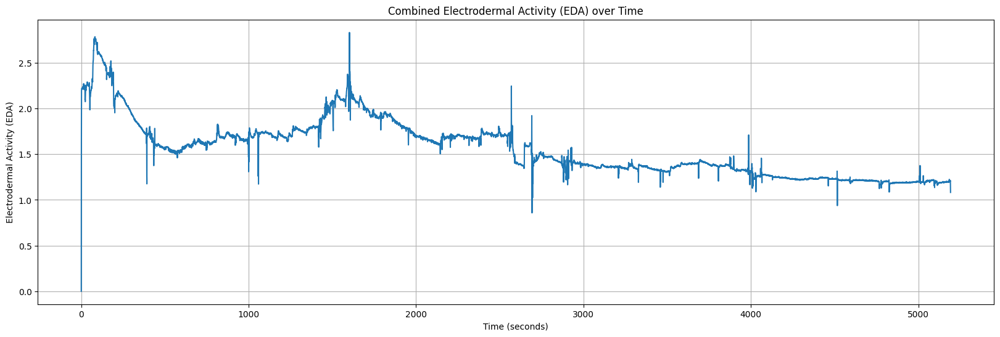

In [1312]:
# Combine the two EDA signals by taking the average
combined_eda = (right_eda_df['EDA'] + left_eda_df['EDA']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_eda_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_eda_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_eda)
plt.title('Combined Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(True)
plt.show()

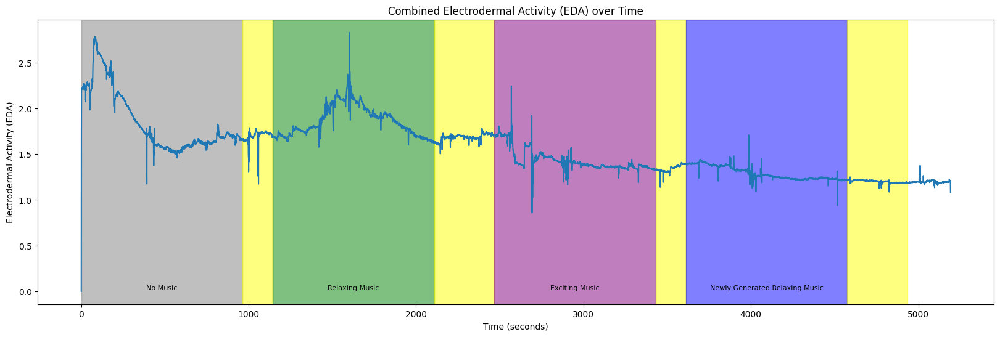

In [1313]:
import matplotlib.pyplot as plt


# Combine the two EDA signals by taking the average
combined_eda = (right_eda_df['EDA'] + left_eda_df['EDA']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_eda_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_eda_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_eda)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_eda), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Combined Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(False)
plt.show()

### HR
- HR: Average heart rate (HR) extracted from the BVP signal. Values in the first column (HR) show the HR values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1314]:
left_hr_df=pd.read_csv(Left_HR_file)
left_hr_df

,HR,start_time_unix,sampling_rate
0,49.00,1.623778e+09,1.0
1,57.50,1.623778e+09,1.0
2,59.67,1.623778e+09,1.0
3,61.00,1.623778e+09,1.0
4,62.60,1.623778e+09,1.0
...,...,...,...
5184,75.02,1.623778e+09,1.0
5185,75.08,1.623778e+09,1.0
5186,75.07,1.623778e+09,1.0
5187,75.07,1.623778e+09,1.0


In [1315]:
right_hr_df=pd.read_csv(Right_HR_file)
right_hr_df

,HR,start_time_unix,sampling_rate
0,52.00,1.623778e+09,1.0
1,67.50,1.623778e+09,1.0
2,71.33,1.623778e+09,1.0
3,74.75,1.623778e+09,1.0
4,76.40,1.623778e+09,1.0
...,...,...,...
5178,73.33,1.623778e+09,1.0
5179,73.35,1.623778e+09,1.0
5180,73.38,1.623778e+09,1.0
5181,73.45,1.623778e+09,1.0


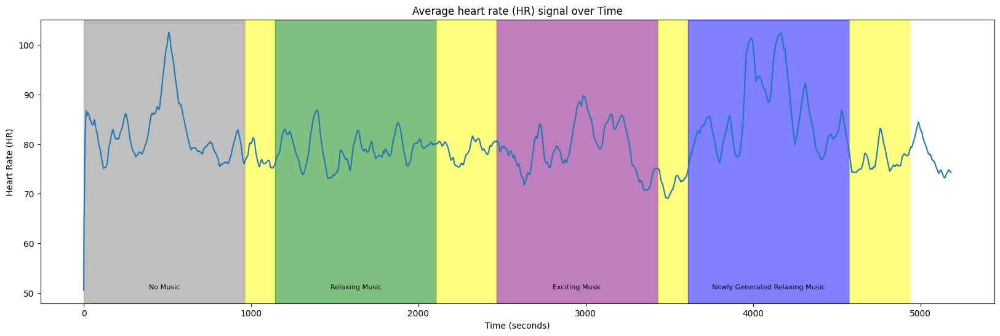

In [1316]:
import matplotlib.pyplot as plt


# Combine the two hr signals by taking the average
combined_hr = (right_hr_df['HR'] + left_hr_df['HR']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_hr_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_hr_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_hr)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_hr), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Average heart rate (HR) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Heart Rate (HR)')
plt.grid(False)
plt.show()

### BVP
- BVP: Blood volume pulses (BVP) measured from a photoplethysmograph. Values in the first column (BVP) show the BVP values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1317]:
left_bvp_df=pd.read_csv(Left_BVP_file)
left_bvp_df

,BVP,start_time_unix,sampling_rate
0,-0.00,1.623778e+09,64.0
1,-0.00,1.623778e+09,64.0
2,-0.00,1.623778e+09,64.0
3,-0.00,1.623778e+09,64.0
4,-0.00,1.623778e+09,64.0
...,...,...,...
332723,-97.20,1.623778e+09,64.0
332724,-77.52,1.623778e+09,64.0
332725,-40.37,1.623778e+09,64.0
332726,7.38,1.623778e+09,64.0


In [1318]:
right_bvp_df=pd.read_csv(Right_BVP_file)
right_bvp_df

,BVP,start_time_unix,sampling_rate
0,-0.00,1.623778e+09,64.0
1,-0.00,1.623778e+09,64.0
2,-0.00,1.623778e+09,64.0
3,-0.00,1.623778e+09,64.0
4,-0.00,1.623778e+09,64.0
...,...,...,...
332305,134.28,1.623778e+09,64.0
332306,125.53,1.623778e+09,64.0
332307,111.95,1.623778e+09,64.0
332308,93.88,1.623778e+09,64.0


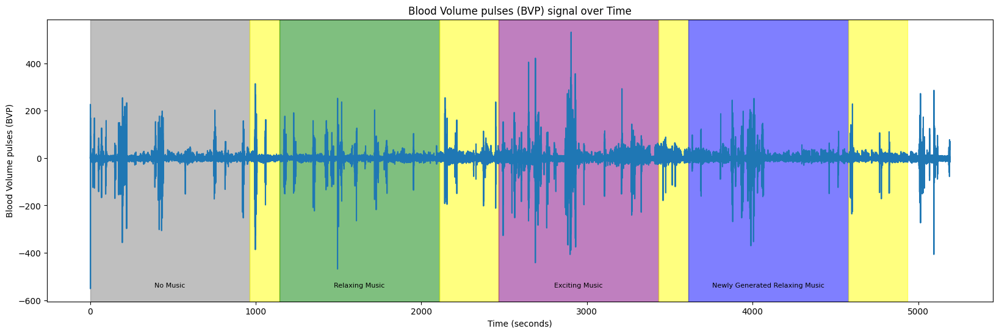

In [1319]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_bvp = (right_bvp_df['BVP'] + left_bvp_df['BVP']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_bvp_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_bvp_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_bvp)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_bvp), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Blood Volume pulses (BVP) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Blood Volume pulses (BVP)')
plt.grid(False)
plt.show()

### Temperature
- TEMP: Skin temperature (TEMP) measured from temperature sensor expressed degrees on the Celsius (°C) scale. Values in the first column (TEMP) show the TEMP values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1320]:
left_temp_df=pd.read_csv(Left_TEMP_file)
left_temp_df

,TEMP,start_time_unix,sampling_rate
0,30.97,1.623778e+09,4.0
1,30.97,1.623778e+09,4.0
2,30.97,1.623778e+09,4.0
3,30.97,1.623778e+09,4.0
4,30.97,1.623778e+09,4.0
...,...,...,...
20803,30.29,1.623778e+09,4.0
20804,30.29,1.623778e+09,4.0
20805,30.29,1.623778e+09,4.0
20806,30.29,1.623778e+09,4.0


In [1321]:
right_temp_df=pd.read_csv(Right_TEMP_file)
right_temp_df

,TEMP,start_time_unix,sampling_rate
0,29.47,1.623778e+09,4.0
1,29.47,1.623778e+09,4.0
2,29.47,1.623778e+09,4.0
3,29.47,1.623778e+09,4.0
4,29.47,1.623778e+09,4.0
...,...,...,...
20771,31.05,1.623778e+09,4.0
20772,31.05,1.623778e+09,4.0
20773,31.05,1.623778e+09,4.0
20774,31.05,1.623778e+09,4.0


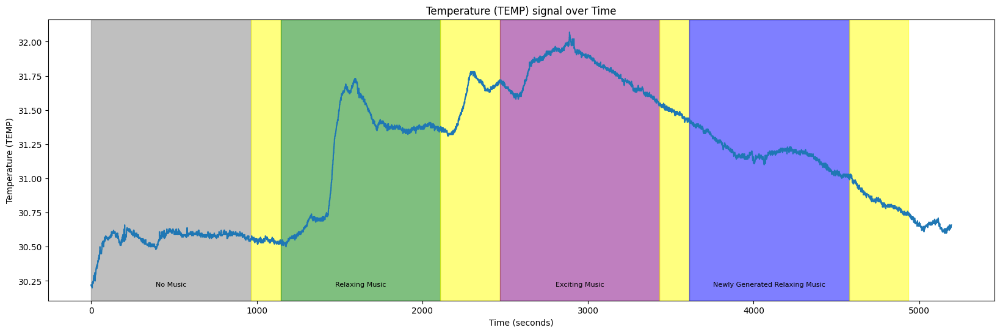

In [1322]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_temp = (right_temp_df['TEMP'] + left_temp_df['TEMP']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_temp_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_temp_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_temp)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_temp), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Temperature (TEMP) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Temperature (TEMP)')
plt.grid(False)
plt.show()

### ACC
- ACC: Data from 3-axis accelerometer sensor. The accelerometer is configured to measure acceleration in the range [-2g, 2g]. Therefore, the unit in this file is 1/64g. Data from x, y, and z axis are labeled respectively (i.e., ACC_X, ACC_Y, and ACC_Z).  The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1323]:
left_ACC_df=pd.read_csv(Left_ACC_file)
left_ACC_df

,ACC_X,ACC_Y,ACC_Z,start_time_unix,sampling_rate
0,-38,-2,51,1.623778e+09,32.0
1,-38,-2,51,1.623778e+09,32.0
2,-39,-2,51,1.623778e+09,32.0
3,-38,-2,51,1.623778e+09,32.0
4,-38,-2,51,1.623778e+09,32.0
...,...,...,...,...,...
166357,-19,8,60,1.623778e+09,32.0
166358,-19,8,60,1.623778e+09,32.0
166359,-23,8,59,1.623778e+09,32.0
166360,-21,8,59,1.623778e+09,32.0


In [1324]:
right_ACC_df=pd.read_csv(Right_ACC_file)
right_ACC_df

,ACC_X,ACC_Y,ACC_Z,start_time_unix,sampling_rate
0,-22,5,60,1.623778e+09,32.0
1,-23,5,60,1.623778e+09,32.0
2,-23,5,59,1.623778e+09,32.0
3,-23,5,60,1.623778e+09,32.0
4,-22,5,60,1.623778e+09,32.0
...,...,...,...,...,...
166147,-17,11,61,1.623778e+09,32.0
166148,-18,11,61,1.623778e+09,32.0
166149,-18,12,61,1.623778e+09,32.0
166150,-19,11,60,1.623778e+09,32.0


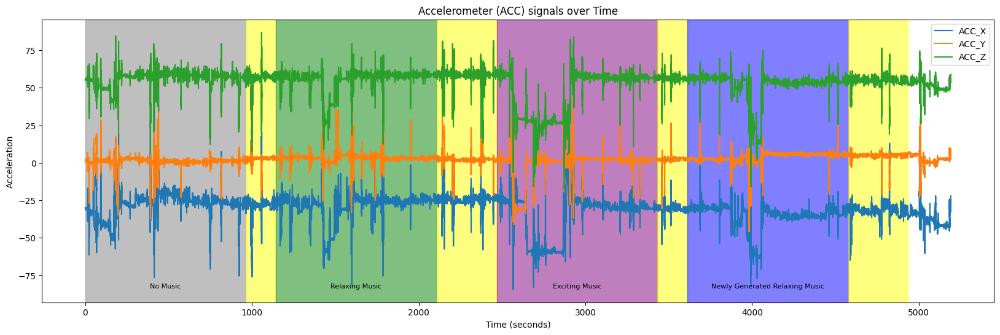

In [1325]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_accX = (right_ACC_df['ACC_X'] + left_ACC_df['ACC_X']) / 2
combined_accY = (right_ACC_df['ACC_Y'] + left_ACC_df['ACC_Y']) / 2
combined_accZ = (right_ACC_df['ACC_Z'] + left_ACC_df['ACC_Z']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_ACC_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_ACC_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_accX, label='ACC_X')
plt.plot(time_seconds, combined_accY, label='ACC_Y')
plt.plot(time_seconds, combined_accZ, label='ACC_Z')

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_accX), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Accelerometer (ACC) signals over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Acceleration')
plt.legend()
plt.grid(False)
plt.show()

## EG

The EEG signals recorded from the Muse headband are also included in the dataset as 'EEG_recording.csv'. They include EEG channels from four locations: TP9, AF7, AF8, and TP10. The 2016 model Muse (MU-02) can also output RAW EEG data at 256Hz as well as being able to output RAW EEG from the right ear USB Auxiliary connector (named Right AUX in the csv files). The column (timestamps) shows the data points in UNIX format. EEG measurements are labeled as TP9, AF7, AF8, TP10, Right AUX.

In [209]:
eeg_df=pd.read_csv(EEG_file)
eeg_df

,timestamps,TP9,AF7,AF8,TP10,Right AUX
0,1.623778e+09,-33.691,12.695,45.410,-48.340,-1.465
1,1.623778e+09,-51.270,-3.906,41.016,-37.109,9.277
2,1.623778e+09,-61.035,-16.113,40.039,-12.207,62.012
3,1.623778e+09,-78.125,-19.531,45.898,-45.410,64.941
4,1.623778e+09,-83.008,-18.555,41.016,-88.379,40.039
...,...,...,...,...,...,...
1341547,1.623783e+09,247.070,-248.535,-327.148,-771.484,0.000
1341548,1.623783e+09,-1000.000,-180.664,-225.098,-895.020,399.414
1341549,1.623783e+09,-1000.000,-161.621,-208.496,-911.621,435.547
1341550,1.623783e+09,-94.238,-225.586,-329.590,-922.363,-9.766


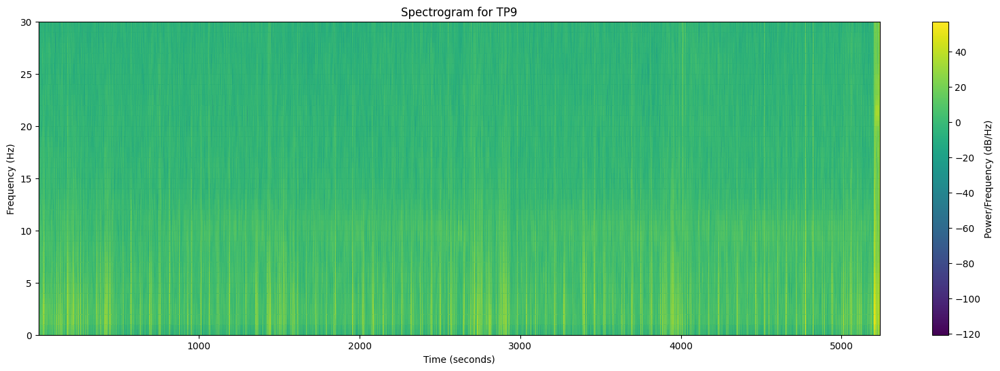

C:\Users\user\AppData\Local\Temp\ipykernel_29192\2195272341.py:35: RuntimeWarning: divide by zero encountered in log10
  plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap='viridis')


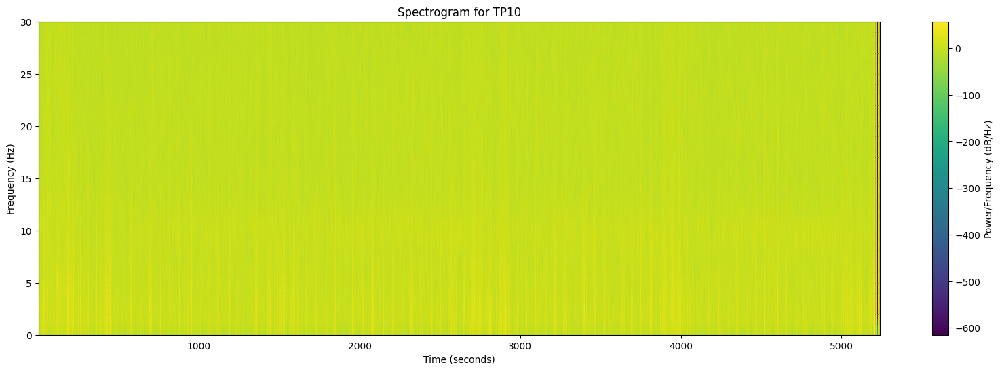

In [210]:
import matplotlib.pyplot as plt
from scipy import signal
# Extract the desired channels (TP9 and TP10)
channels = ['TP9', 'TP10']  
eeg_data = eeg_df[channels]

# Convert the timestamps to time in seconds
sampling_rate = 256  # Sampling rate of the EEG data in Hz
time_seconds = eeg_df['timestamps'] / sampling_rate

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 256    # Length of each segment
noverlap = 128   # Overlap between segments
nfft = 256       # Number of points for the FFT

# Compute the spectrogram for each channel
frequencies, times, spectrogram_TP9 = signal.spectrogram(eeg_data['TP9'], fs=sampling_rate, window=window, 
                                                         nperseg=nperseg, noverlap=noverlap, nfft=nfft)
_, _, spectrogram_TP10 = signal.spectrogram(eeg_data['TP10'], fs=sampling_rate, window=window, 
                                            nperseg=nperseg, noverlap=noverlap, nfft=nfft)

# Plot the spectrogram for TP9
plt.figure(figsize=(20, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP9), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP9')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
plt.show()

# Plot the spectrogram for TP10
plt.figure(figsize=(20, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP10')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
plt.show()

C:\Users\user\AppData\Local\Temp\ipykernel_29192\2743015402.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eeg_data[channel] = signal.filtfilt(b, a, eeg_data[channel])


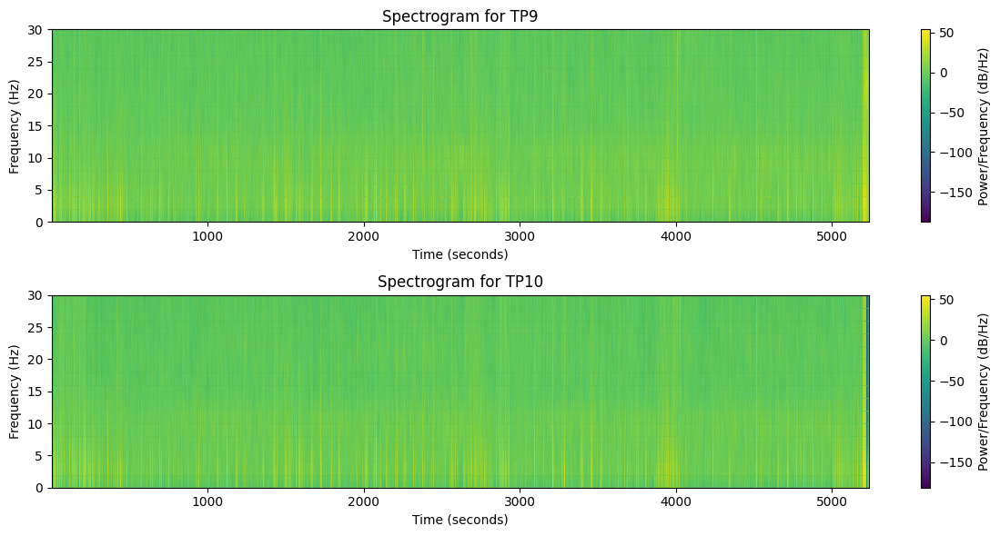

In [211]:
# Extract the desired channels (TP9 and TP10)
channels = ['TP9', 'TP10']  
eeg_data = eeg_df[channels]

# Convert the timestamps to time in seconds
sampling_rate = 256  # Sampling rate of the EEG data in Hz
time_seconds = eeg_df['timestamps'] / sampling_rate

# Preprocess the EEG signals
for channel in channels:
    # Apply high-pass filter above 1 Hz and low-pass filter below 50 Hz
    b, a = signal.butter(4, [1, 50], btype='bandpass', fs=sampling_rate)
    eeg_data[channel] = signal.filtfilt(b, a, eeg_data[channel])

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 128    # Length of each segment
noverlap = 64    # Overlap between segments
nfft = 128       # Number of points for the FFT

# Compute the spectrogram for each channel
frequencies, times, spectrogram_TP9 = signal.spectrogram(eeg_data['TP9'], fs=sampling_rate, window=window, 
                                                         nperseg=nperseg, noverlap=noverlap, nfft=nfft)
_, _, spectrogram_TP10 = signal.spectrogram(eeg_data['TP10'], fs=sampling_rate, window=window, 
                                            nperseg=nperseg, noverlap=noverlap, nfft=nfft)

# Plot the spectrogram for TP9
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP9), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP9')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz

# Plot the spectrogram for TP10
plt.subplot(2, 1, 2)
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP10')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz

plt.tight_layout()
plt.show()

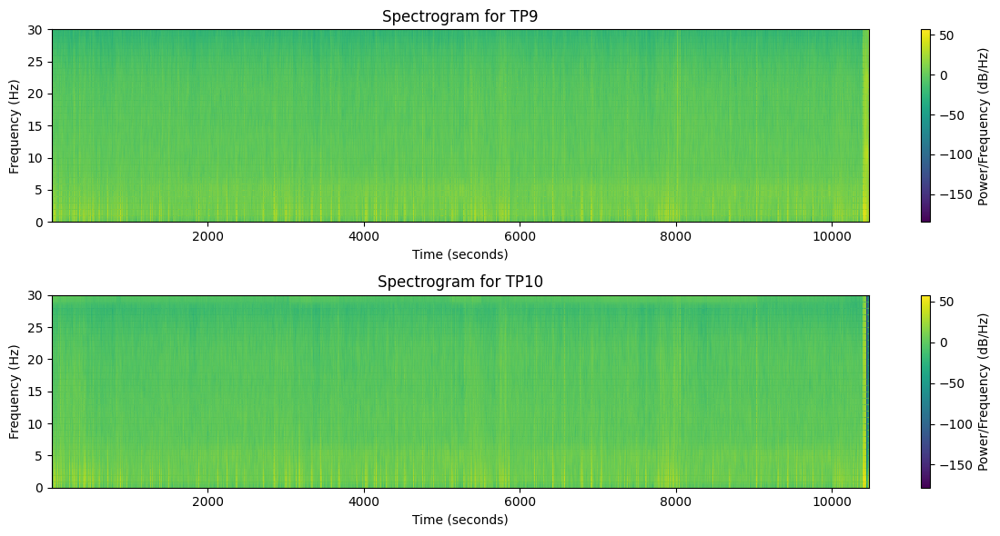

In [212]:
import numpy as np
import matplotlib.pyplot as plt

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 128    # Length of each segment
noverlap = 64    # Overlap between segments
nfft = 128       # Number of points for the FFT

# Compute the spectrogram for each channel
frequencies, times, spectrogram_TP9 = signal.spectrogram(eeg_data['TP9'], fs=sampling_rate / 2, window=window, 
                                                         nperseg=nperseg, noverlap=noverlap, nfft=nfft)
_, _, spectrogram_TP10 = signal.spectrogram(eeg_data['TP10'], fs=sampling_rate / 2, window=window, 
                                            nperseg=nperseg, noverlap=noverlap, nfft=nfft)

# Plot the spectrogram for TP9
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP9), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP9')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz

# Plot the spectrogram for TP10
plt.subplot(2, 1, 2)
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP10')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz

plt.tight_layout()
plt.show()

C:\Users\user\AppData\Local\Temp\ipykernel_29192\1305613029.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eeg_data[channel] = signal.filtfilt(b, a, eeg_data[channel])
C:\Users\user\AppData\Local\Temp\ipykernel_29192\1305613029.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eeg_data[channel] = eeg_data[channel][::downsampling_factor]


Spectrogram shape for TP9: (65, 20960)
Spectrogram shape for TP10: (65, 20960)


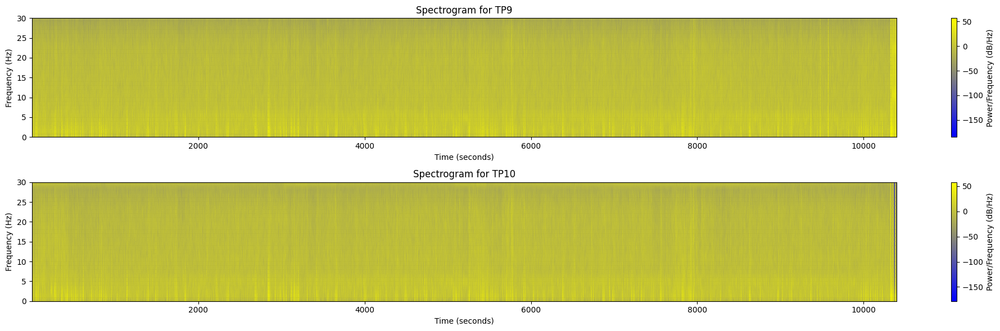

In [213]:
import matplotlib.colors as mcolors
from scipy.signal import decimate
# Define the sampling rate
sampling_rate = 256  # Hz

# Define the desired sampling rate after downsampling
desired_sampling_rate = 129  # Hz

# Extract the desired channels (TP9 and TP10)
channels = ['TP9', 'TP10']
eeg_data = eeg_df[channels]

# Convert the timestamps to time in seconds
time_seconds = eeg_df['timestamps'] / sampling_rate

# Preprocess the EEG signals
for channel in channels:
    # Apply high-pass filter above 1 Hz and low-pass filter below 50 Hz
    b, a = signal.butter(4, [1, 50], btype='bandpass', fs=sampling_rate)
    eeg_data[channel] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample the signal from 256 to 128 Hz
    # original_length = len(eeg_data[channel])
    downsampling_factor = int(sampling_rate / desired_sampling_rate)
    eeg_data[channel] = eeg_data[channel][::downsampling_factor]

print("Spectrogram shape for TP9:", spectrogram_TP9.shape)
print("Spectrogram shape for TP10:", spectrogram_TP10.shape)
# print("Min value of spectrogram_TP9:", np.min(spectrogram_TP9))
# print("Max value of spectrogram_TP9:", np.max(spectrogram_TP9))
# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 128    # Length of each segment
noverlap = 64    # Overlap between segments
nfft = 128       # Number of points for the FFT

# Compute the spectrogram for each channel
frequencies, times, spectrogram_TP9 = signal.spectrogram(eeg_data['TP9'], fs=desired_sampling_rate, window=window, 
                                                         nperseg=nperseg, noverlap=noverlap, nfft=nfft)
_, _, spectrogram_TP10 = signal.spectrogram(eeg_data['TP10'], fs=desired_sampling_rate, window=window, 
                                            nperseg=nperseg, noverlap=noverlap, nfft=nfft)



# Define custom colormap transitioning from yellow to blue
colors = ['blue','yellow']
cmap = mcolors.LinearSegmentedColormap.from_list("YellowBlue", colors)
# Plot the spectrogram for TP9
plt.figure(figsize=(20, 6))
plt.subplot(2, 1, 1)
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP9), shading='gouraud', cmap=cmap)
plt.title('Spectrogram for TP9')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz

# Plot the spectrogram for TP10
plt.subplot(2, 1, 2)
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap=cmap)
plt.title('Spectrogram for TP10')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz

plt.tight_layout()
plt.show()

Text(0.5, 0, 'time (s)')

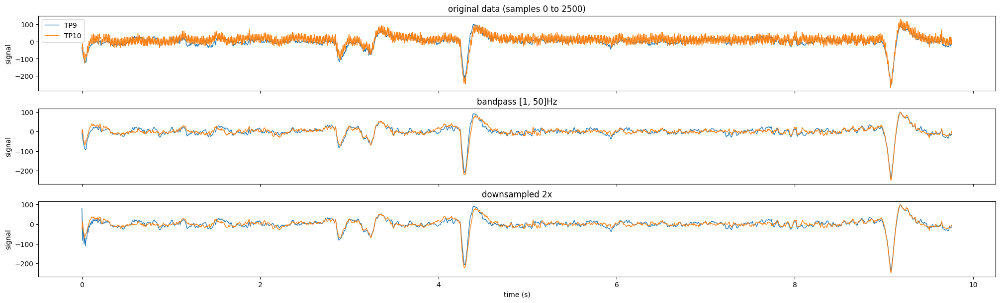

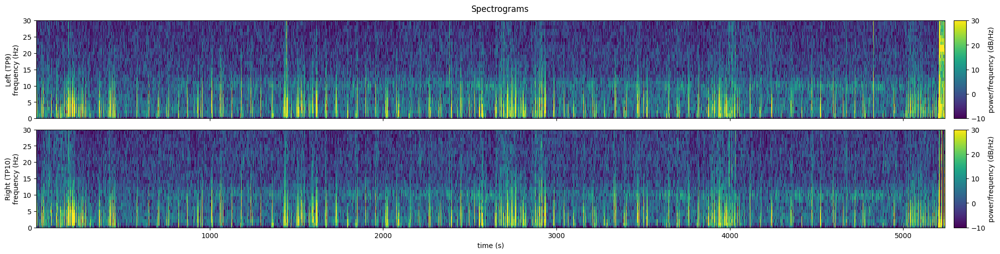

In [214]:
eeg_df['sample_number'] = range(len(eeg_df))
# Sampling rate of the EEG data in Hz
sampling_rate = 256  


# Convert the sample index to time in seconds
# This means you need to divide the sample *number* by the sampling rate
eeg_df['time_seconds'] = eeg_df['sample_number'] / sampling_rate

# Extract the desired channels (TP9 and TP10)
keep_channels = ['TP9', 'TP10']
eeg_data = eeg_df[keep_channels + ['time_seconds']].copy()

#
# Preprocess the EEG signals
#

#Define the pre-preprocessing parameters
downsample_factor = 2
bp_order = 4
bp_passband = [1, 50]
downsample_factor = 2

eeg_downsampled = pd.DataFrame()
downsampled_length = len(eeg_data) // downsample_factor

for channel in keep_channels:
    filtered_name = channel + '_bp'
    # Apply high-pass filter above 1 Hz and low-pass filter below 50 Hz
    b, a = signal.butter(bp_order, bp_passband, btype='bandpass', fs=sampling_rate)
    eeg_data[filtered_name] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample the signal from 256 to 128 Hz
    # Put the shorter signals in a new dataframe "eeg_downsampled"
    eeg_downsampled[channel] = signal.resample(eeg_data[filtered_name], downsampled_length)
eeg_downsampled['time_seconds'] = np.arange(downsampled_length) / (sampling_rate / downsample_factor)

#
# View the original and processed data
#
plot_height = 2
n_plots = 3
f, axs = plt.subplots(nrows=n_plots, ncols=1,
                      figsize=(20, plot_height * n_plots),
                      layout='constrained', sharex=True)

plot_slice = slice(0, 2500) #window of data to plot

#Original data
eeg_data[plot_slice].plot(
    y=keep_channels, x='time_seconds',
    ylabel='signal', xlabel='time (s)',
    linewidth=1, ax=axs[0],
    title=f'original data (samples {plot_slice.start} to {plot_slice.stop})'
)

#Filtered
eeg_data[plot_slice].plot(
    y=[chan + '_bp' for chan in keep_channels], x='time_seconds',
    ylabel='signal', xlabel='time (s)', legend=False,
    linewidth=1, ax=axs[1], title=f'bandpass {bp_passband}Hz'
)

#Downsampled
eeg_downsampled[plot_slice.start:plot_slice.stop//downsample_factor].plot(
    y=keep_channels, x='time_seconds',
    ylabel='signal', xlabel='time (s)', legend=False,
    linewidth=1, ax=axs[2], title=f'downsampled {downsample_factor}x'
)

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 128    # Length of each segment
noverlap = 64    # Overlap between segments
nfft = 128       # Number of points for the FFT

# Compute the spectrogram for each channel
spectrograms = {}
for channel in keep_channels:
    frequencies, times, spectrogram = signal.spectrogram(
        eeg_downsampled[channel],
        fs=sampling_rate / downsample_factor,
        window=window, nperseg=nperseg, noverlap=noverlap, nfft=nfft
    )
    spectrograms[channel] = spectrogram

# Plot the spectrograms
f, axs = plt.subplots(nrows=2, ncols=1, figsize=(20, 5),
                      layout='constrained', sharex=True)
f.suptitle('Spectrograms')
vmin, vmax = -10, 30

for channel, ax in zip(keep_channels, axs):
    im = ax.pcolormesh(
        times, frequencies, 10 * np.log10(spectrograms[channel]),
        vmin=vmin, vmax=vmax, #comment out for auto-range
        shading='nearest', cmap='viridis'
    )
    
    ax.set_ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
    ax.set_ylabel(('Left' if channel=='TP9' else 'Right') + f' ({channel})\nfrequency (Hz)')
    
    cbar = f.colorbar(im, aspect=8, pad=0.01, label='power/frequency (dB/Hz)')
    
ax.set_xlabel('time (s)')

### Beta Band Frequency

C:\Users\user\AppData\Local\Temp\ipykernel_29192\2331215207.py:79: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")
C:\Users\user\AppData\Local\Temp\ipykernel_29192\2331215207.py:79: UserWarning: 

The `join` parameter is deprecated and will be removed in v0.15.0.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")


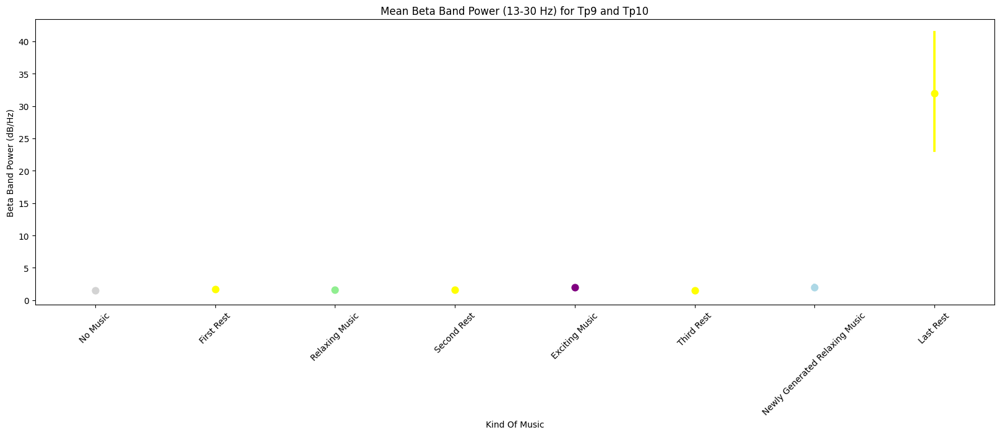

In [215]:
# Sample EEG DataFrame
# Assuming you have an EEG DataFrame named eeg_df with columns 'TP9' and 'TP10'

# Preprocessing parameters
sampling_rate = 256
downsample_factor = 2
bp_order = 4
bp_passband = [1, 50]

# Apply preprocessing and downsampling
eeg_df['sample_number'] = range(len(eeg_df))
eeg_df['time_seconds'] = eeg_df['sample_number'] / sampling_rate

eeg_data = eeg_df[['TP9', 'TP10', 'time_seconds']].copy()

eeg_downsampled = pd.DataFrame()
downsampled_length = len(eeg_data) // downsample_factor

for channel in ['TP9', 'TP10']:
    filtered_name = channel + '_bp'
    # Apply bandpass filter
    b, a = signal.butter(bp_order, bp_passband, btype='bandpass', fs=sampling_rate)
    eeg_data[filtered_name] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample
    eeg_downsampled[channel] = signal.resample(eeg_data[filtered_name], downsampled_length)

eeg_downsampled['time_seconds'] = np.arange(downsampled_length) / (sampling_rate / downsample_factor)

# Compute spectrogram for each channel
frequencies, times, spectrogram_tp9 = signal.spectrogram(
    eeg_downsampled['TP9'],
    fs=sampling_rate / downsample_factor,
    window='hann', nperseg=128, noverlap=64, nfft=128
)

_, _, spectrogram_tp10 = signal.spectrogram(
    eeg_downsampled['TP10'],
    fs=sampling_rate / downsample_factor,
    window='hann', nperseg=128, noverlap=64, nfft=128
)

# Compute beta band power (13-30 Hz) for each channel
beta_band_power_tp9 = np.mean(spectrogram_tp9[(frequencies >= 13) & (frequencies <= 30)], axis=0)
beta_band_power_tp10 = np.mean(spectrogram_tp10[(frequencies >= 13) & (frequencies <= 30)], axis=0)

# Compute mean beta band power across channels
mean_beta_band_power = (beta_band_power_tp9 + beta_band_power_tp10) / 2

# Define intervals and corresponding labels
intervals = [
    (0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
    (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                            964 + 180 + 964 + 360 + 964 + 180),
    (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
    (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)
]
labels = ['No Music', 'First Rest', 'Relaxing Music', 'Second Rest', 'Exciting Music', 'Third Rest',
          'Newly Generated Relaxing Music', 'Last Rest']

# Assign labels to each data point based on intervals
beta_power_df = pd.DataFrame({'Time': times, 'Power': mean_beta_band_power})
beta_power_df['Kind Of Music'] = pd.cut(beta_power_df['Time'], bins=[interval[0] for interval in intervals] + [np.inf], labels=labels)

# Define color palette dictionary
color_palette = {
    'No Music': 'lightgray',
    'First Rest': 'yellow',
    'Relaxing Music': 'lightgreen',
    'Second Rest': 'yellow',
    'Exciting Music': 'purple',
    'Third Rest': 'yellow',
    'Newly Generated Relaxing Music': 'lightblue',
    'Last Rest': 'yellow'
}

# Plot
plt.figure(figsize=(20, 6))
sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")
plt.title('Mean Beta Band Power (13-30 Hz) for Tp9 and Tp10')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Kind Of Music')
plt.xticks(rotation=45)
plt.show()

C:\Users\user\AppData\Local\Temp\ipykernel_29192\3532274209.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette)


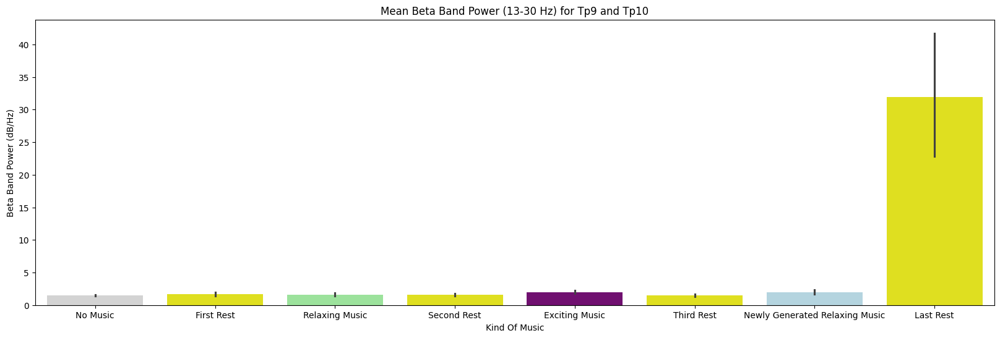

In [216]:
# Apply color palette for the bar plot
color_palette = {
    'No Music': 'lightgray',
    'First Rest': 'yellow',
    'Relaxing Music': 'lightgreen',
    'Second Rest': 'yellow',
    'Exciting Music': 'purple',
    'Third Rest': 'yellow',
    'Newly Generated Relaxing Music': 'lightblue',
    'Last Rest': 'yellow'
}

# Generate the bar plot
plt.figure(figsize=(20, 6))
sns.barplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette)
plt.title('Mean Beta Band Power (13-30 Hz) for Tp9 and Tp10')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Kind Of Music')
plt.show()

# Patient A4

In [217]:
# Define the file paths for the A4 data files
EEG_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A4\EEG_recording.csv'
Left_ACC_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A4\Left_ACC.csv'
Left_BVP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A4\Left_BVP.csv'
Left_EDA_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A4\Left_EDA.csv'
Left_HR_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A4\Left_HR.csv'
Left_IBI_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A4\Left_IBI.csv'
Left_tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A4\Left_tags.csv'
Left_TEMP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A4\Left_TEMP.csv'
n_back_responses_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A4\n_back_responses.csv'
Right_ACC_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A4\Right_ACC.csv'
Right_BVP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A4\Right_BVP.csv'
Right_EDA_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A4\Right_EDA.csv'
Right_HR_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A4\Right_HR.csv'
Right_IBI_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A4\Right_IBI.csv'
Right_tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A4\Right_tags.csv'
Right_TEMP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A4\Right_TEMP.csv'
tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A4\tags.csv'

## n back responses

In [1333]:
n_backr_df=pd.read_csv(n_back_responses_file)
n_backr_df

,ExperimentName,Start_time_unix,Subject,Session,DataFile.Basename,Display.RefreshRate,ExperimentVersion,Group,InstructionNewMusic.DEVICE,InstructionNoMusic.DEVICE,...,TrialList8.Cycle,TrialList8.Sample,TSO,TSTh,TSvO,TSvTh,TSxO,TSxTh,TTO,TTTh
0,Experiment_1,1624704211,4,1,Experiment_1-4-1,75.029,1.0.0.251,1,Chronos,Chronos,...,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Experiment_1,1624704211,4,1,Experiment_1-4-1,75.029,1.0.0.251,1,Chronos,Chronos,...,1.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Experiment_1,1624704211,4,1,Experiment_1-4-1,75.029,1.0.0.251,1,Chronos,Chronos,...,1.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Experiment_1,1624704211,4,1,Experiment_1-4-1,75.029,1.0.0.251,1,Chronos,Chronos,...,1.0,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Experiment_1,1624704211,4,1,Experiment_1-4-1,75.029,1.0.0.251,1,Chronos,Chronos,...,1.0,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,Experiment_1,1624704211,4,1,Experiment_1-4-1,75.029,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1452,Experiment_1,1624704211,4,1,Experiment_1-4-1,75.029,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1453,Experiment_1,1624704211,4,1,Experiment_1-4-1,75.029,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1454,Experiment_1,1624704211,4,1,Experiment_1-4-1,75.029,1.0.0.251,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1334]:
n_backr_df.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 250 columns):
 #    Column                                   Non-Null Count  Dtype  
---   ------                                   --------------  -----  
 0    ExperimentName                           1456 non-null   object 
 1    Start_time_unix                          1456 non-null   int64  
 2    Subject                                  1456 non-null   int64  
 3    Session                                  1456 non-null   int64  
 4    DataFile.Basename                        1456 non-null   object 
 5    Display.RefreshRate                      1456 non-null   float64
 6    ExperimentVersion                        1456 non-null   object 
 7    Group                                    1456 non-null   int64  
 8    InstructionNewMusic.DEVICE               1456 non-null   object 
 9    InstructionNoMusic.DEVICE                1456 non-null   object 
 10   InstructionNoMusic.DurationError  

In [1335]:
df_length=len(n_backr_df)

In [1336]:
# Filter columns with length 1456
non_null_columns = [col for col in n_backr_df.columns if n_backr_df[col].notnull().all()]
# Create a new DataFrame with only columns of the same length as the DataFrame
complete_df = n_backr_df[non_null_columns]
complete_df

,ExperimentName,Start_time_unix,Subject,Session,DataFile.Basename,Display.RefreshRate,ExperimentVersion,Group,InstructionNewMusic.DEVICE,InstructionNoMusic.DEVICE,...,Welcome.DurationError,Welcome.OnsetDelay,Welcome.OnsetTime,Welcome.OnsetToOnsetTime,Block,Instruction,ListName,Procedure[Block],Running[Block],Trigger
0,Experiment_1,1624704211,4,1,Experiment_1-4-1,75.029,1.0.0.251,1,Chronos,Chronos,...,-999999,23,18652,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
1,Experiment_1,1624704211,4,1,Experiment_1-4-1,75.029,1.0.0.251,1,Chronos,Chronos,...,-999999,23,18652,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
2,Experiment_1,1624704211,4,1,Experiment_1-4-1,75.029,1.0.0.251,1,Chronos,Chronos,...,-999999,23,18652,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
3,Experiment_1,1624704211,4,1,Experiment_1-4-1,75.029,1.0.0.251,1,Chronos,Chronos,...,-999999,23,18652,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
4,Experiment_1,1624704211,4,1,Experiment_1-4-1,75.029,1.0.0.251,1,Chronos,Chronos,...,-999999,23,18652,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,Experiment_1,1624704211,4,1,Experiment_1-4-1,75.029,1.0.0.251,1,Chronos,Chronos,...,-999999,23,18652,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1452,Experiment_1,1624704211,4,1,Experiment_1-4-1,75.029,1.0.0.251,1,Chronos,Chronos,...,-999999,23,18652,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1453,Experiment_1,1624704211,4,1,Experiment_1-4-1,75.029,1.0.0.251,1,Chronos,Chronos,...,-999999,23,18652,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1454,Experiment_1,1624704211,4,1,Experiment_1-4-1,75.029,1.0.0.251,1,Chronos,Chronos,...,-999999,23,18652,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2


### Instruction

In [1337]:
instruction = n_backr_df.columns
instruction[instruction.str.contains('Instruction')]
#.str.contains('SNOMED')]

Index(['InstructionNewMusic.DEVICE', 'InstructionNoMusic.DEVICE',
       'InstructionNoMusic.DurationError', 'InstructionNoMusic.OnsetDelay',
       'InstructionNoMusic.OnsetTime', 'InstructionNoMusic.OnsetToOnsetTime',
       'InstructionRelaxMusic.DEVICE', 'InstructionRelaxMusic.DurationError',
       'InstructionRelaxMusic.OnsetDelay', 'InstructionRelaxMusic.OnsetTime',
       'InstructionRelaxMusic.OnsetToOnsetTime',
       'InstructionStressMusic.DEVICE', 'InstructionStressMusic.DurationError',
       'InstructionStressMusic.OnsetDelay', 'InstructionStressMusic.OnsetTime',
       'InstructionStressMusic.OnsetToOnsetTime', 'Instruction'],
      dtype='object')

In [1338]:
instruction_df=n_backr_df[instruction[instruction.str.contains('Instruction')]]

### Stimulus

In [1339]:
stimulus = n_backr_df.columns
stimulus=stimulus[stimulus.str.contains('Stimulus')]

In [1340]:
stimulus

Index(['Stimulus100.ACC', 'Stimulus100.CRESP', 'Stimulus100.DEVICE',
       'Stimulus100.DurationError', 'Stimulus100.OnsetDelay',
       'Stimulus100.OnsetTime', 'Stimulus100.OnsetToOnsetTime',
       'Stimulus100.RESP', 'Stimulus100.RT', 'Stimulus100.RTTime',
       'Stimulus101.ACC', 'Stimulus101.CRESP', 'Stimulus101.DEVICE',
       'Stimulus101.DurationError', 'Stimulus101.OnsetDelay',
       'Stimulus101.OnsetTime', 'Stimulus101.OnsetToOnsetTime',
       'Stimulus101.RESP', 'Stimulus101.RT', 'Stimulus101.RTTime',
       'Stimulus102.ACC', 'Stimulus102.CRESP', 'Stimulus102.DEVICE',
       'Stimulus102.DurationError', 'Stimulus102.OnsetDelay',
       'Stimulus102.OnsetTime', 'Stimulus102.OnsetToOnsetTime',
       'Stimulus102.RESP', 'Stimulus102.RT', 'Stimulus102.RTTime',
       'Stimulus103.ACC', 'Stimulus103.CRESP', 'Stimulus103.DEVICE',
       'Stimulus103.DurationError', 'Stimulus103.OnsetDelay',
       'Stimulus103.OnsetTime', 'Stimulus103.OnsetToOnsetTime',
       'Stimulus103

In [1341]:
# Create a dictionary to store the mapping of columns to Running[Block] values
column_to_block = {}
running_block_values=n_backr_df['Running[Block]'].unique()
# Create a dictionary to store the mapping of stimulus columns to lists of Running[Block] values

stimulus_to_blocks = {}

# Iterate over each stimulus column
for col in stimulus:
    # Store all 4 Running[Block] values as a list for this stimulus column
    stimulus_to_blocks[col] = running_block_values

print(stimulus_to_blocks)

{'Stimulus100.ACC': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.CRESP': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.DEVICE': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.DurationError': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetDelay': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetTime': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetToOnsetTime': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.RESP': array(['PracticeSessi

In [1342]:
# Create a new dictionary to store the suffixed keys and values
suffixed_dict = {}

# Iterate over each key in stimulus_to_blocks dictionary
for key, values in stimulus_to_blocks.items():
    # Get the prefix (e.g., 'Stimulus100') from the key
    prefix = key.split('.')[0]
    
    # Create a list to store the suffixed column names
    suffixed_columns = []
    
    # Iterate over each column name in stimulus_columns
    for col in stimulus:
        # If the column name starts with the same prefix
        if col.startswith(prefix):
            # Append the suffixed column name to the list
            suffixed_columns.append(col)
    
    # Create the suffixed key by joining the prefix with ':'
    suffixed_key = f'{prefix}:'
    
    # Add the suffixed column names list as the value for the suffixed key
    suffixed_dict[suffixed_key] = suffixed_columns

print(suffixed_dict)

{'Stimulus100:': ['Stimulus100.ACC', 'Stimulus100.CRESP', 'Stimulus100.DEVICE', 'Stimulus100.DurationError', 'Stimulus100.OnsetDelay', 'Stimulus100.OnsetTime', 'Stimulus100.OnsetToOnsetTime', 'Stimulus100.RESP', 'Stimulus100.RT', 'Stimulus100.RTTime'], 'Stimulus101:': ['Stimulus101.ACC', 'Stimulus101.CRESP', 'Stimulus101.DEVICE', 'Stimulus101.DurationError', 'Stimulus101.OnsetDelay', 'Stimulus101.OnsetTime', 'Stimulus101.OnsetToOnsetTime', 'Stimulus101.RESP', 'Stimulus101.RT', 'Stimulus101.RTTime'], 'Stimulus102:': ['Stimulus102.ACC', 'Stimulus102.CRESP', 'Stimulus102.DEVICE', 'Stimulus102.DurationError', 'Stimulus102.OnsetDelay', 'Stimulus102.OnsetTime', 'Stimulus102.OnsetToOnsetTime', 'Stimulus102.RESP', 'Stimulus102.RT', 'Stimulus102.RTTime'], 'Stimulus103:': ['Stimulus103.ACC', 'Stimulus103.CRESP', 'Stimulus103.DEVICE', 'Stimulus103.DurationError', 'Stimulus103.OnsetDelay', 'Stimulus103.OnsetTime', 'Stimulus103.OnsetToOnsetTime', 'Stimulus103.RESP', 'Stimulus103.RT', 'Stimulus103.R

#### Stimulus Table 100

In [1343]:
# Filter columns that start with 'Stimulus100'
stimulus100_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus100')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
stimulus100_df=n_backr_df[stimulus100_columns]
stimulus100_df

,Stimulus100.ACC,Stimulus100.CRESP,Stimulus100.DEVICE,Stimulus100.DurationError,Stimulus100.OnsetDelay,Stimulus100.OnsetTime,Stimulus100.OnsetToOnsetTime,Stimulus100.RESP,Stimulus100.RT,Stimulus100.RTTime,Running[Block]
0,0.0,3.0,Chronos,1.0,-2.0,344994.0,506.0,NaN,0.0,0.0,PracticeSession
1,0.0,3.0,Chronos,1.0,20.0,347020.0,506.0,NaN,0.0,0.0,PracticeSession
2,1.0,3.0,Chronos,2.0,33.0,349059.0,0.0,3.0,445.0,349504.0,PracticeSession
3,0.0,4.0,Chronos,2.0,19.0,351031.0,507.0,NaN,0.0,0.0,PracticeSession
4,0.0,4.0,Chronos,1.0,6.0,353044.0,0.0,3.0,397.0,353441.0,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 101

In [1344]:
# Filter columns that start with 'Stimulus100'
stimulus101_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus101')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus101_df=n_backr_df[stimulus101_columns]
stimulus101_df

,Stimulus101.ACC,Stimulus101.CRESP,Stimulus101.DEVICE,Stimulus101.DurationError,Stimulus101.OnsetDelay,Stimulus101.OnsetTime,Stimulus101.OnsetToOnsetTime,Stimulus101.RESP,Stimulus101.RT,Stimulus101.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 102

In [1345]:
# Filter columns that start with 'Stimulus100'
stimulus102_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus102')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus102_df=n_backr_df[stimulus102_columns]
stimulus102_df

,Stimulus102.ACC,Stimulus102.CRESP,Stimulus102.DEVICE,Stimulus102.DurationError,Stimulus102.OnsetDelay,Stimulus102.OnsetTime,Stimulus102.OnsetToOnsetTime,Stimulus102.RESP,Stimulus102.RT,Stimulus102.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 103

In [1346]:
# Filter columns that start with 'Stimulus100'
stimulus103_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus103')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus103_df=n_backr_df[stimulus103_columns]
stimulus103_df

,Stimulus103.ACC,Stimulus103.CRESP,Stimulus103.DEVICE,Stimulus103.DurationError,Stimulus103.OnsetDelay,Stimulus103.OnsetTime,Stimulus103.OnsetToOnsetTime,Stimulus103.RESP,Stimulus103.RT,Stimulus103.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 104

In [1347]:
# Filter columns that start with 'Stimulus100'
stimulus104_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus104')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus104_df=n_backr_df[stimulus104_columns]
stimulus104_df

,Stimulus104.ACC,Stimulus104.CRESP,Stimulus104.DEVICE,Stimulus104.DurationError,Stimulus104.OnsetDelay,Stimulus104.OnsetTime,Stimulus104.OnsetToOnsetTime,Stimulus104.RESP,Stimulus104.RT,Stimulus104.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,0.0,3.0,Chronos,2.0,19.0,5129832.0,507.0,NaN,0.0,0.0,NewMusicSession
1452,0.0,3.0,Chronos,1.0,6.0,5131845.0,506.0,NaN,0.0,0.0,NewMusicSession
1453,1.0,3.0,Chronos,2.0,6.0,5133857.0,0.0,3.0,366.0,5134223.0,NewMusicSession
1454,0.0,4.0,Chronos,2.0,19.0,5135750.0,506.0,NaN,0.0,0.0,NewMusicSession


### Fixation

In [1348]:
n_back_columns = n_backr_df.columns
fixation=n_back_columns[n_back_columns.str.contains('Fixation')]

In [1349]:
fixation_df=n_backr_df[n_back_columns[n_back_columns.str.contains('Fixation')]]

In [1350]:
fixation_df

,Fixation100.ACC,Fixation100.CRESP,Fixation100.DEVICE,Fixation100.DurationError,Fixation100.OnsetDelay,Fixation100.OnsetTime,Fixation100.OnsetToOnsetTime,Fixation100.RESP,Fixation100.RT,Fixation100.RTTime,...,Fixation104.ACC,Fixation104.CRESP,Fixation104.DEVICE,Fixation104.DurationError,Fixation104.OnsetDelay,Fixation104.OnsetTime,Fixation104.OnsetToOnsetTime,Fixation104.RESP,Fixation104.RT,Fixation104.RTTime
0,0.0,3.0,Chronos,2.0,6.0,345500.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.0,3.0,Chronos,1.0,6.0,347526.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0.0,3.0,Chronos,1.0,8.0,349512.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0.0,4.0,Chronos,1.0,7.0,351538.0,0.0,3.0,39.0,351577.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0.0,4.0,Chronos,1.0,16.0,353457.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,3.0,Chronos,1.0,7.0,5130339.0,0.0,3.0,36.0,5130375.0
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,3.0,Chronos,2.0,6.0,5132351.0,0.0,3.0,17.0,5132368.0
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,3.0,Chronos,1.0,8.0,5134231.0,0.0,NaN,0.0,0.0
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,4.0,Chronos,2.0,6.0,5136256.0,0.0,4.0,123.0,5136379.0


#### Fixation table 100

In [1351]:
# Filter columns that start with 'Fixation100'
fixation100_columns = [col for col in n_backr_df.columns if col.startswith('Fixation100')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation100_df=n_backr_df[fixation100_columns]
fixation100_df

,Fixation100.ACC,Fixation100.CRESP,Fixation100.DEVICE,Fixation100.DurationError,Fixation100.OnsetDelay,Fixation100.OnsetTime,Fixation100.OnsetToOnsetTime,Fixation100.RESP,Fixation100.RT,Fixation100.RTTime,Running[Block]
0,0.0,3.0,Chronos,2.0,6.0,345500.0,0.0,NaN,0.0,0.0,PracticeSession
1,0.0,3.0,Chronos,1.0,6.0,347526.0,0.0,NaN,0.0,0.0,PracticeSession
2,0.0,3.0,Chronos,1.0,8.0,349512.0,0.0,NaN,0.0,0.0,PracticeSession
3,0.0,4.0,Chronos,1.0,7.0,351538.0,0.0,3.0,39.0,351577.0,PracticeSession
4,0.0,4.0,Chronos,1.0,16.0,353457.0,0.0,NaN,0.0,0.0,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 101

In [1352]:
# Filter columns that start with 'Fixation100'
fixation101_columns = [col for col in n_backr_df.columns if col.startswith('Fixation101')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation101_df=n_backr_df[fixation101_columns]
fixation101_df

,Fixation101.ACC,Fixation101.CRESP,Fixation101.DEVICE,Fixation101.DurationError,Fixation101.OnsetDelay,Fixation101.OnsetTime,Fixation101.OnsetToOnsetTime,Fixation101.RESP,Fixation101.RT,Fixation101.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 102

In [1353]:
# Filter columns that start with 'Fixation100'
fixation102_columns = [col for col in n_backr_df.columns if col.startswith('Fixation102')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation102_df=n_backr_df[fixation102_columns]
fixation102_df

,Fixation102.ACC,Fixation102.CRESP,Fixation102.DEVICE,Fixation102.DurationError,Fixation102.OnsetDelay,Fixation102.OnsetTime,Fixation102.OnsetToOnsetTime,Fixation102.RESP,Fixation102.RT,Fixation102.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 103

In [1354]:
# Filter columns that start with 'Fixation100'
fixation103_columns = [col for col in n_backr_df.columns if col.startswith('Fixation103')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation103_df=n_backr_df[fixation103_columns]
fixation103_df

,Fixation103.ACC,Fixation103.CRESP,Fixation103.DEVICE,Fixation103.DurationError,Fixation103.OnsetDelay,Fixation103.OnsetTime,Fixation103.OnsetToOnsetTime,Fixation103.RESP,Fixation103.RT,Fixation103.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 104

In [1355]:
# Filter columns that start with 'Fixation100'
fixation104_columns = [col for col in n_backr_df.columns if col.startswith('Fixation104')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation104_df=n_backr_df[fixation104_columns]
fixation104_df

,Fixation104.ACC,Fixation104.CRESP,Fixation104.DEVICE,Fixation104.DurationError,Fixation104.OnsetDelay,Fixation104.OnsetTime,Fixation104.OnsetToOnsetTime,Fixation104.RESP,Fixation104.RT,Fixation104.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,1.0,3.0,Chronos,1.0,7.0,5130339.0,0.0,3.0,36.0,5130375.0,NewMusicSession
1452,1.0,3.0,Chronos,2.0,6.0,5132351.0,0.0,3.0,17.0,5132368.0,NewMusicSession
1453,0.0,3.0,Chronos,1.0,8.0,5134231.0,0.0,NaN,0.0,0.0,NewMusicSession
1454,1.0,4.0,Chronos,2.0,6.0,5136256.0,0.0,4.0,123.0,5136379.0,NewMusicSession


## Empatica

### EDA
- EDA: Measurements from the electrodermal activity (EDA) sensor expressed as micro siemens (μS). Values in the first column (EDA) show the EDA values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1356]:
left_eda_df=pd.read_csv(Left_EDA_file)
left_eda_df

,EDA,start_time_unix,sampling_rate
0,0.000000,1.624704e+09,4.0
1,0.827840,1.624704e+09,4.0
2,1.174108,1.624704e+09,4.0
3,1.507363,1.624704e+09,4.0
4,1.483114,1.624704e+09,4.0
...,...,...,...
21367,0.084578,1.624704e+09,4.0
21368,0.084578,1.624704e+09,4.0
21369,0.155060,1.624704e+09,4.0
21370,0.193504,1.624704e+09,4.0


In [1357]:
right_eda_df=pd.read_csv(Right_EDA_file)
right_eda_df

,EDA,start_time_unix,sampling_rate
0,0.000000,1.624704e+09,4.0
1,0.838918,1.624704e+09,4.0
2,1.183718,1.624704e+09,4.0
3,1.346447,1.624704e+09,4.0
4,1.340043,1.624704e+09,4.0
...,...,...,...
21343,0.156256,1.624704e+09,4.0
21344,0.153695,1.624704e+09,4.0
21345,0.152414,1.624704e+09,4.0
21346,0.149853,1.624704e+09,4.0


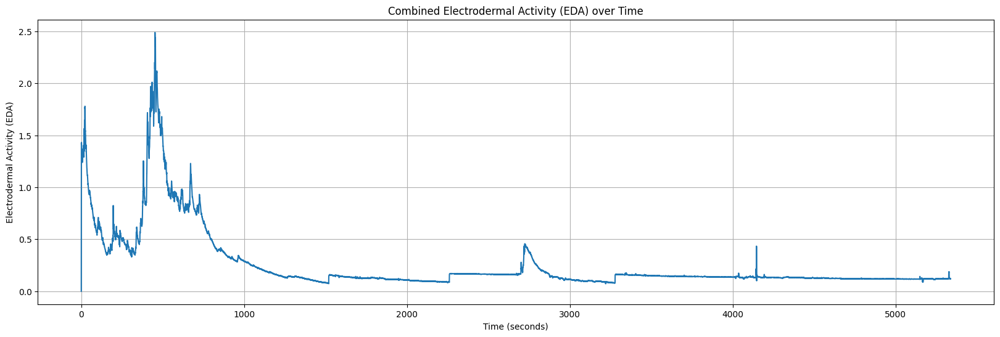

In [1358]:
# Combine the two EDA signals by taking the average
combined_eda = (right_eda_df['EDA'] + left_eda_df['EDA']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_eda_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_eda_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_eda)
plt.title('Combined Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(True)
plt.show()

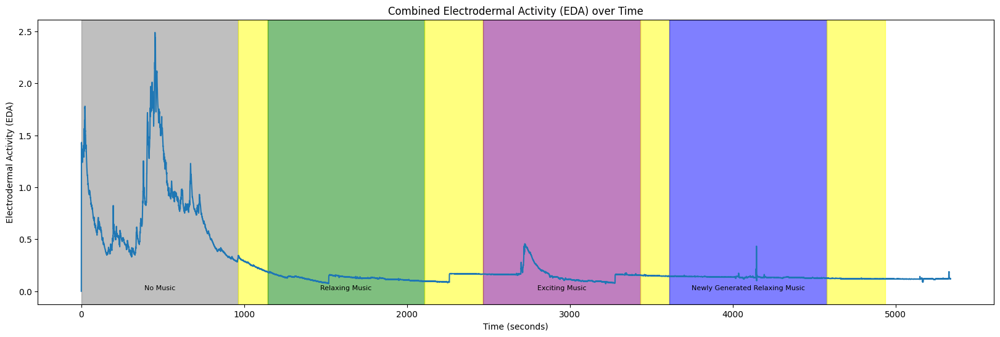

In [1359]:
import matplotlib.pyplot as plt


# Combine the two EDA signals by taking the average
combined_eda = (right_eda_df['EDA'] + left_eda_df['EDA']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_eda_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_eda_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_eda)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_eda), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Combined Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(False)
plt.show()

### HR
- HR: Average heart rate (HR) extracted from the BVP signal. Values in the first column (HR) show the HR values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1360]:
left_hr_df=pd.read_csv(Left_HR_file)
left_hr_df

,HR,start_time_unix,sampling_rate
0,55.00,1.624704e+09,1.0
1,81.50,1.624704e+09,1.0
2,77.67,1.624704e+09,1.0
3,101.75,1.624704e+09,1.0
4,116.20,1.624704e+09,1.0
...,...,...,...
5327,61.77,1.624704e+09,1.0
5328,62.10,1.624704e+09,1.0
5329,62.35,1.624704e+09,1.0
5330,62.62,1.624704e+09,1.0


In [1361]:
right_hr_df=pd.read_csv(Right_HR_file)
right_hr_df

,HR,start_time_unix,sampling_rate
0,74.00,1.624704e+09,1.0
1,73.50,1.624704e+09,1.0
2,70.67,1.624704e+09,1.0
3,65.50,1.624704e+09,1.0
4,62.40,1.624704e+09,1.0
...,...,...,...
5322,68.37,1.624704e+09,1.0
5323,68.35,1.624704e+09,1.0
5324,68.37,1.624704e+09,1.0
5325,68.38,1.624704e+09,1.0


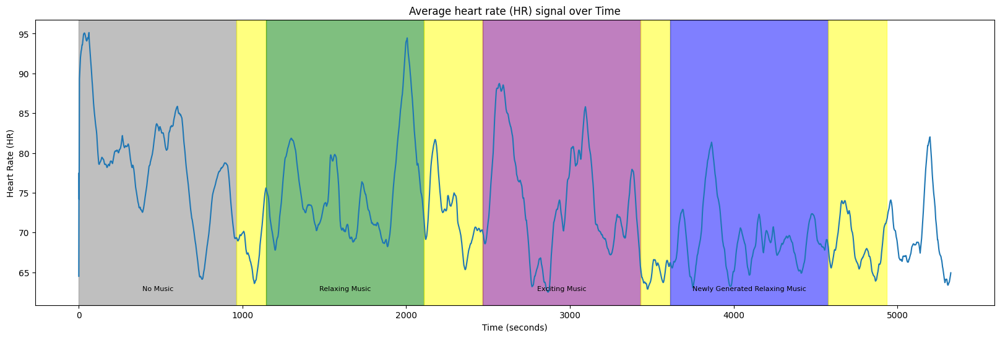

In [1362]:
import matplotlib.pyplot as plt


# Combine the two hr signals by taking the average
combined_hr = (right_hr_df['HR'] + left_hr_df['HR']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_hr_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_hr_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_hr)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_hr), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Average heart rate (HR) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Heart Rate (HR)')
plt.grid(False)
plt.show()

### BVP
- BVP: Blood volume pulses (BVP) measured from a photoplethysmograph. Values in the first column (BVP) show the BVP values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1363]:
left_bvp_df=pd.read_csv(Left_BVP_file)
left_bvp_df

,BVP,start_time_unix,sampling_rate
0,-0.00,1.624704e+09,64.0
1,-0.00,1.624704e+09,64.0
2,-0.00,1.624704e+09,64.0
3,-0.00,1.624704e+09,64.0
4,-0.00,1.624704e+09,64.0
...,...,...,...
341875,90.10,1.624704e+09,64.0
341876,105.13,1.624704e+09,64.0
341877,119.84,1.624704e+09,64.0
341878,134.29,1.624704e+09,64.0


In [1364]:
right_bvp_df=pd.read_csv(Right_BVP_file)
right_bvp_df

,BVP,start_time_unix,sampling_rate
0,-0.00,1.624704e+09,64.0
1,-0.00,1.624704e+09,64.0
2,-0.00,1.624704e+09,64.0
3,-0.00,1.624704e+09,64.0
4,-0.00,1.624704e+09,64.0
...,...,...,...
341545,-82.67,1.624704e+09,64.0
341546,-50.65,1.624704e+09,64.0
341547,-12.45,1.624704e+09,64.0
341548,22.35,1.624704e+09,64.0


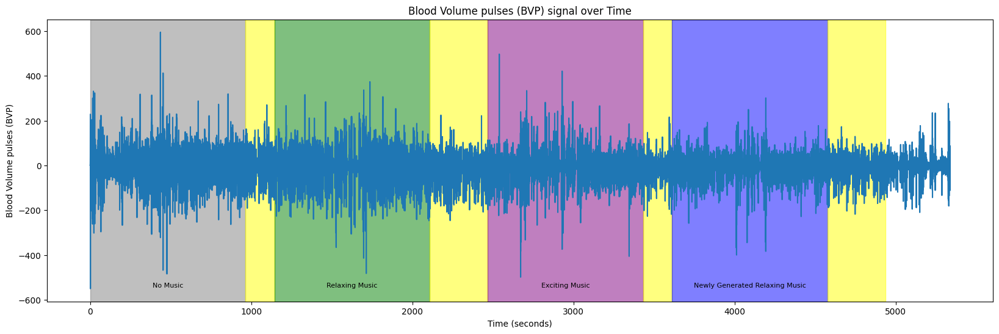

In [1365]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_bvp = (right_bvp_df['BVP'] + left_bvp_df['BVP']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_bvp_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_bvp_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_bvp)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_bvp), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Blood Volume pulses (BVP) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Blood Volume pulses (BVP)')
plt.grid(False)
plt.show()

### Temperature
- TEMP: Skin temperature (TEMP) measured from temperature sensor expressed degrees on the Celsius (°C) scale. Values in the first column (TEMP) show the TEMP values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1366]:
left_temp_df=pd.read_csv(Left_TEMP_file)
left_temp_df

,TEMP,start_time_unix,sampling_rate
0,32.03,1.624704e+09,4.0
1,32.03,1.624704e+09,4.0
2,32.03,1.624704e+09,4.0
3,32.03,1.624704e+09,4.0
4,32.03,1.624704e+09,4.0
...,...,...,...
21371,29.35,1.624704e+09,4.0
21372,29.35,1.624704e+09,4.0
21373,29.35,1.624704e+09,4.0
21374,29.35,1.624704e+09,4.0


In [1367]:
right_temp_df=pd.read_csv(Right_TEMP_file)
right_temp_df

,TEMP,start_time_unix,sampling_rate
0,31.67,1.624704e+09,4.0
1,31.67,1.624704e+09,4.0
2,31.67,1.624704e+09,4.0
3,31.67,1.624704e+09,4.0
4,31.67,1.624704e+09,4.0
...,...,...,...
21355,30.43,1.624704e+09,4.0
21356,30.37,1.624704e+09,4.0
21357,30.37,1.624704e+09,4.0
21358,30.37,1.624704e+09,4.0


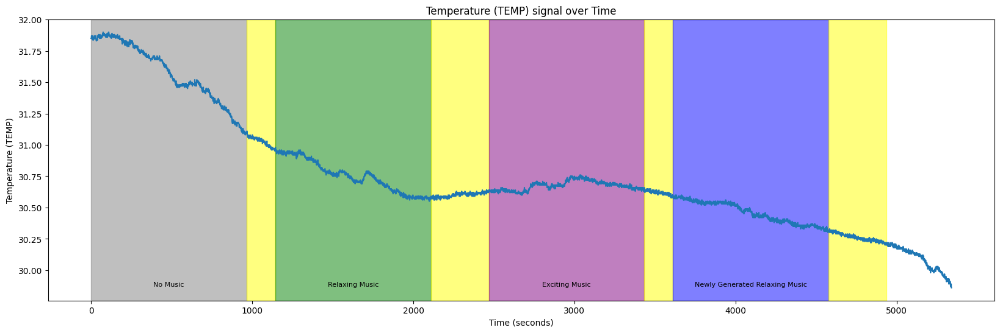

In [1368]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_temp = (right_temp_df['TEMP'] + left_temp_df['TEMP']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_temp_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_temp_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_temp)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_temp), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Temperature (TEMP) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Temperature (TEMP)')
plt.grid(False)
plt.show()

### ACC
- ACC: Data from 3-axis accelerometer sensor. The accelerometer is configured to measure acceleration in the range [-2g, 2g]. Therefore, the unit in this file is 1/64g. Data from x, y, and z axis are labeled respectively (i.e., ACC_X, ACC_Y, and ACC_Z).  The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1369]:
left_ACC_df=pd.read_csv(Left_ACC_file)
left_ACC_df

,ACC_X,ACC_Y,ACC_Z,start_time_unix,sampling_rate
0,8,-25,61,1.624704e+09,32.0
1,2,-27,62,1.624704e+09,32.0
2,3,-24,64,1.624704e+09,32.0
3,2,-23,64,1.624704e+09,32.0
4,2,-21,69,1.624704e+09,32.0
...,...,...,...,...,...
170971,-2,12,64,1.624704e+09,32.0
170972,-3,11,62,1.624704e+09,32.0
170973,-2,12,64,1.624704e+09,32.0
170974,-3,12,63,1.624704e+09,32.0


In [1370]:
right_ACC_df=pd.read_csv(Right_ACC_file)
right_ACC_df

,ACC_X,ACC_Y,ACC_Z,start_time_unix,sampling_rate
0,-37,22,47,1.624704e+09,32.0
1,-37,22,46,1.624704e+09,32.0
2,-38,22,46,1.624704e+09,32.0
3,-38,22,46,1.624704e+09,32.0
4,-37,23,46,1.624704e+09,32.0
...,...,...,...,...,...
170809,-26,43,39,1.624704e+09,32.0
170810,-26,42,40,1.624704e+09,32.0
170811,-25,41,41,1.624704e+09,32.0
170812,-24,41,41,1.624704e+09,32.0


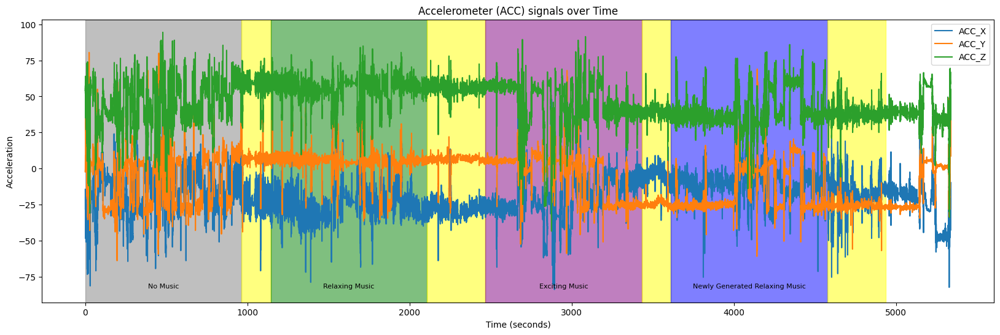

In [1371]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_accX = (right_ACC_df['ACC_X'] + left_ACC_df['ACC_X']) / 2
combined_accY = (right_ACC_df['ACC_Y'] + left_ACC_df['ACC_Y']) / 2
combined_accZ = (right_ACC_df['ACC_Z'] + left_ACC_df['ACC_Z']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_ACC_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_ACC_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_accX, label='ACC_X')
plt.plot(time_seconds, combined_accY, label='ACC_Y')
plt.plot(time_seconds, combined_accZ, label='ACC_Z')

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_accX), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Accelerometer (ACC) signals over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Acceleration')
plt.legend()
plt.grid(False)
plt.show()

## EG

The EEG signals recorded from the Muse headband are also included in the dataset as 'EEG_recording.csv'. They include EEG channels from four locations: TP9, AF7, AF8, and TP10. The 2016 model Muse (MU-02) can also output RAW EEG data at 256Hz as well as being able to output RAW EEG from the right ear USB Auxiliary connector (named Right AUX in the csv files). The column (timestamps) shows the data points in UNIX format. EEG measurements are labeled as TP9, AF7, AF8, TP10, Right AUX.

In [218]:
eeg_df=pd.read_csv(EEG_file)
eeg_df

,timestamps,TP9,AF7,AF8,TP10,Right AUX
0,1.624704e+09,88.379,-50.781,45.410,-2.441,2.441
1,1.624704e+09,98.145,-186.035,46.875,56.641,18.066
2,1.624704e+09,3.418,6.348,46.387,46.875,5.859
3,1.624704e+09,31.250,200.195,48.828,-19.531,42.480
4,1.624704e+09,67.383,246.582,50.293,-7.324,82.031
...,...,...,...,...,...,...
1385443,1.624710e+09,96.680,344.238,32.227,91.309,999.512
1385444,1.624710e+09,112.305,311.035,37.598,36.133,999.512
1385445,1.624710e+09,85.938,263.184,26.855,-7.324,999.512
1385446,1.624710e+09,76.660,337.402,23.438,26.367,999.512


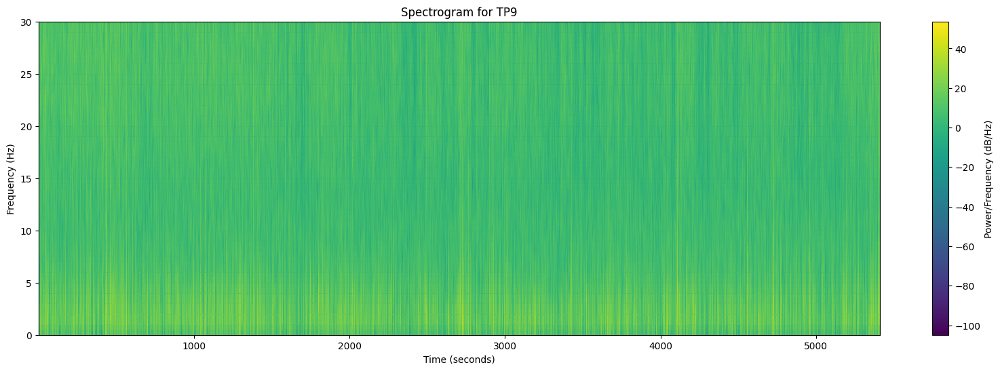

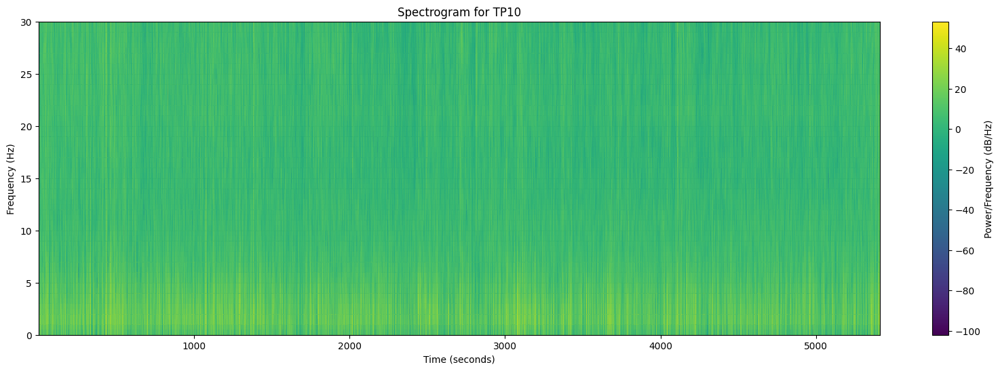

In [219]:
import matplotlib.pyplot as plt
from scipy import signal
# Extract the desired channels (TP9 and TP10)
channels = ['TP9', 'TP10']  
eeg_data = eeg_df[channels]

# Convert the timestamps to time in seconds
sampling_rate = 256  # Sampling rate of the EEG data in Hz
time_seconds = eeg_df['timestamps'] / sampling_rate

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 256    # Length of each segment
noverlap = 128   # Overlap between segments
nfft = 256       # Number of points for the FFT

# Compute the spectrogram for each channel
frequencies, times, spectrogram_TP9 = signal.spectrogram(eeg_data['TP9'], fs=sampling_rate, window=window, 
                                                         nperseg=nperseg, noverlap=noverlap, nfft=nfft)
_, _, spectrogram_TP10 = signal.spectrogram(eeg_data['TP10'], fs=sampling_rate, window=window, 
                                            nperseg=nperseg, noverlap=noverlap, nfft=nfft)

# Plot the spectrogram for TP9
plt.figure(figsize=(20, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP9), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP9')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
plt.show()

# Plot the spectrogram for TP10
plt.figure(figsize=(20, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP10')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
plt.show()

Text(0.5, 0, 'time (s)')

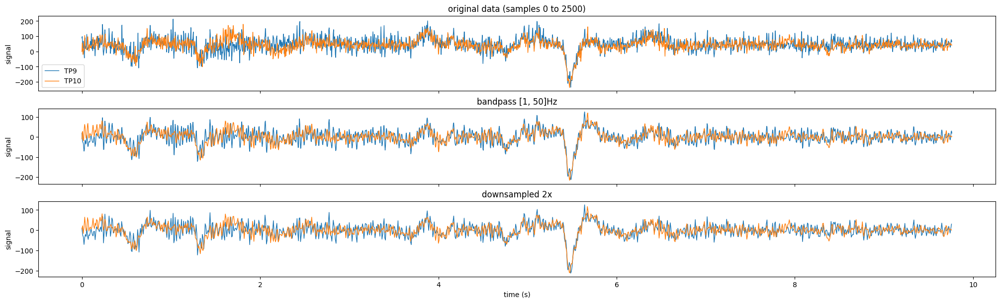

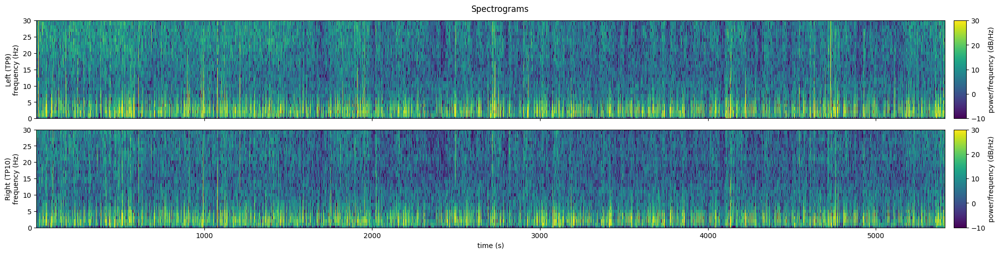

In [220]:
eeg_df['sample_number'] = range(len(eeg_df))
# Sampling rate of the EEG data in Hz
sampling_rate = 256  


# Convert the sample index to time in seconds
# This means you need to divide the sample *number* by the sampling rate
eeg_df['time_seconds'] = eeg_df['sample_number'] / sampling_rate

# Extract the desired channels (TP9 and TP10)
keep_channels = ['TP9', 'TP10']
eeg_data = eeg_df[keep_channels + ['time_seconds']].copy()

#
# Preprocess the EEG signals
#

#Define the pre-preprocessing parameters
downsample_factor = 2
bp_order = 4
bp_passband = [1, 50]
downsample_factor = 2

eeg_downsampled = pd.DataFrame()
downsampled_length = len(eeg_data) // downsample_factor

for channel in keep_channels:
    filtered_name = channel + '_bp'
    # Apply high-pass filter above 1 Hz and low-pass filter below 50 Hz
    b, a = signal.butter(bp_order, bp_passband, btype='bandpass', fs=sampling_rate)
    eeg_data[filtered_name] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample the signal from 256 to 128 Hz
    # Put the shorter signals in a new dataframe "eeg_downsampled"
    eeg_downsampled[channel] = signal.resample(eeg_data[filtered_name], downsampled_length)
eeg_downsampled['time_seconds'] = np.arange(downsampled_length) / (sampling_rate / downsample_factor)

#
# View the original and processed data
#
plot_height = 2
n_plots = 3
f, axs = plt.subplots(nrows=n_plots, ncols=1,
                      figsize=(20, plot_height * n_plots),
                      layout='constrained', sharex=True)

plot_slice = slice(0, 2500) #window of data to plot

#Original data
eeg_data[plot_slice].plot(
    y=keep_channels, x='time_seconds',
    ylabel='signal', xlabel='time (s)',
    linewidth=1, ax=axs[0],
    title=f'original data (samples {plot_slice.start} to {plot_slice.stop})'
)

#Filtered
eeg_data[plot_slice].plot(
    y=[chan + '_bp' for chan in keep_channels], x='time_seconds',
    ylabel='signal', xlabel='time (s)', legend=False,
    linewidth=1, ax=axs[1], title=f'bandpass {bp_passband}Hz'
)

#Downsampled
eeg_downsampled[plot_slice.start:plot_slice.stop//downsample_factor].plot(
    y=keep_channels, x='time_seconds',
    ylabel='signal', xlabel='time (s)', legend=False,
    linewidth=1, ax=axs[2], title=f'downsampled {downsample_factor}x'
)

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 128    # Length of each segment
noverlap = 64    # Overlap between segments
nfft = 128       # Number of points for the FFT

# Compute the spectrogram for each channel
spectrograms = {}
for channel in keep_channels:
    frequencies, times, spectrogram = signal.spectrogram(
        eeg_downsampled[channel],
        fs=sampling_rate / downsample_factor,
        window=window, nperseg=nperseg, noverlap=noverlap, nfft=nfft
    )
    spectrograms[channel] = spectrogram

# Plot the spectrograms
f, axs = plt.subplots(nrows=2, ncols=1, figsize=(20, 5),
                      layout='constrained', sharex=True)
f.suptitle('Spectrograms')
vmin, vmax = -10, 30

for channel, ax in zip(keep_channels, axs):
    im = ax.pcolormesh(
        times, frequencies, 10 * np.log10(spectrograms[channel]),
        vmin=vmin, vmax=vmax, #comment out for auto-range
        shading='nearest', cmap='viridis'
    )
    
    ax.set_ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
    ax.set_ylabel(('Left' if channel=='TP9' else 'Right') + f' ({channel})\nfrequency (Hz)')
    
    cbar = f.colorbar(im, aspect=8, pad=0.01, label='power/frequency (dB/Hz)')
    
ax.set_xlabel('time (s)')

### Beta Band Frequency

C:\Users\user\AppData\Local\Temp\ipykernel_29192\2331215207.py:79: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")
C:\Users\user\AppData\Local\Temp\ipykernel_29192\2331215207.py:79: UserWarning: 

The `join` parameter is deprecated and will be removed in v0.15.0.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")


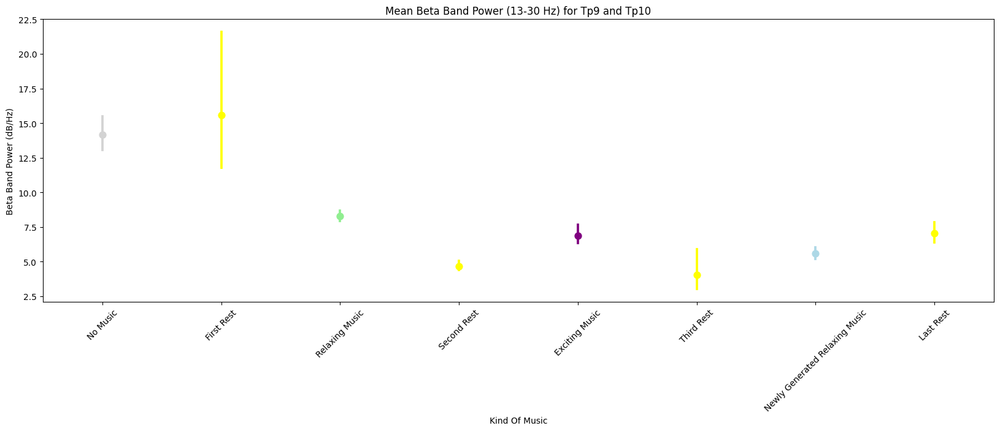

In [221]:
# Sample EEG DataFrame
# Assuming you have an EEG DataFrame named eeg_df with columns 'TP9' and 'TP10'

# Preprocessing parameters
sampling_rate = 256
downsample_factor = 2
bp_order = 4
bp_passband = [1, 50]

# Apply preprocessing and downsampling
eeg_df['sample_number'] = range(len(eeg_df))
eeg_df['time_seconds'] = eeg_df['sample_number'] / sampling_rate

eeg_data = eeg_df[['TP9', 'TP10', 'time_seconds']].copy()

eeg_downsampled = pd.DataFrame()
downsampled_length = len(eeg_data) // downsample_factor

for channel in ['TP9', 'TP10']:
    filtered_name = channel + '_bp'
    # Apply bandpass filter
    b, a = signal.butter(bp_order, bp_passband, btype='bandpass', fs=sampling_rate)
    eeg_data[filtered_name] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample
    eeg_downsampled[channel] = signal.resample(eeg_data[filtered_name], downsampled_length)

eeg_downsampled['time_seconds'] = np.arange(downsampled_length) / (sampling_rate / downsample_factor)

# Compute spectrogram for each channel
frequencies, times, spectrogram_tp9 = signal.spectrogram(
    eeg_downsampled['TP9'],
    fs=sampling_rate / downsample_factor,
    window='hann', nperseg=128, noverlap=64, nfft=128
)

_, _, spectrogram_tp10 = signal.spectrogram(
    eeg_downsampled['TP10'],
    fs=sampling_rate / downsample_factor,
    window='hann', nperseg=128, noverlap=64, nfft=128
)

# Compute beta band power (13-30 Hz) for each channel
beta_band_power_tp9 = np.mean(spectrogram_tp9[(frequencies >= 13) & (frequencies <= 30)], axis=0)
beta_band_power_tp10 = np.mean(spectrogram_tp10[(frequencies >= 13) & (frequencies <= 30)], axis=0)

# Compute mean beta band power across channels
mean_beta_band_power = (beta_band_power_tp9 + beta_band_power_tp10) / 2

# Define intervals and corresponding labels
intervals = [
    (0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
    (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                            964 + 180 + 964 + 360 + 964 + 180),
    (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
    (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)
]
labels = ['No Music', 'First Rest', 'Relaxing Music', 'Second Rest', 'Exciting Music', 'Third Rest',
          'Newly Generated Relaxing Music', 'Last Rest']

# Assign labels to each data point based on intervals
beta_power_df = pd.DataFrame({'Time': times, 'Power': mean_beta_band_power})
beta_power_df['Kind Of Music'] = pd.cut(beta_power_df['Time'], bins=[interval[0] for interval in intervals] + [np.inf], labels=labels)

# Define color palette dictionary
color_palette = {
    'No Music': 'lightgray',
    'First Rest': 'yellow',
    'Relaxing Music': 'lightgreen',
    'Second Rest': 'yellow',
    'Exciting Music': 'purple',
    'Third Rest': 'yellow',
    'Newly Generated Relaxing Music': 'lightblue',
    'Last Rest': 'yellow'
}

# Plot
plt.figure(figsize=(20, 6))
sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")
plt.title('Mean Beta Band Power (13-30 Hz) for Tp9 and Tp10')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Kind Of Music')
plt.xticks(rotation=45)
plt.show()

C:\Users\user\AppData\Local\Temp\ipykernel_29192\3532274209.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette)


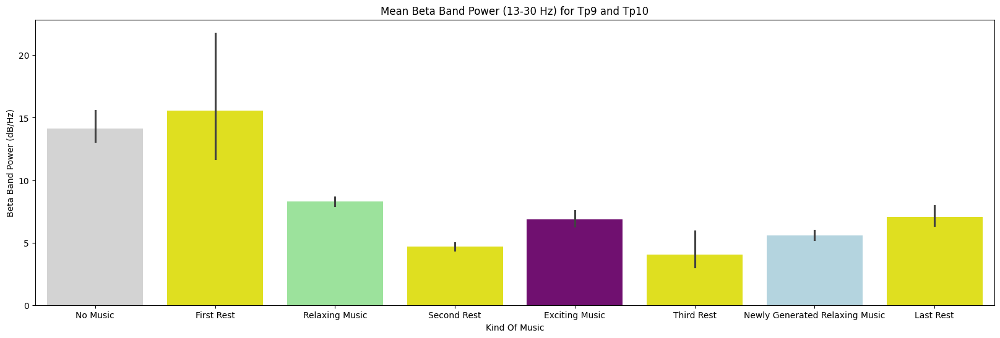

In [222]:
# Apply color palette for the bar plot
color_palette = {
    'No Music': 'lightgray',
    'First Rest': 'yellow',
    'Relaxing Music': 'lightgreen',
    'Second Rest': 'yellow',
    'Exciting Music': 'purple',
    'Third Rest': 'yellow',
    'Newly Generated Relaxing Music': 'lightblue',
    'Last Rest': 'yellow'
}

# Generate the bar plot
plt.figure(figsize=(20, 6))
sns.barplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette)
plt.title('Mean Beta Band Power (13-30 Hz) for Tp9 and Tp10')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Kind Of Music')
plt.show()

# Patient A5

In [223]:
# Define the file paths for the A5 data files
EEG_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A5\EEG_recording.csv'
Left_ACC_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A5\Left_ACC.csv'
Left_BVP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A5\Left_BVP.csv'
Left_EDA_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A5\Left_EDA.csv'
Left_HR_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A5\Left_HR.csv'
Left_IBI_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A5\Left_IBI.csv'
Left_tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A5\Left_tags.csv'
Left_TEMP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A5\Left_TEMP.csv'
n_back_responses_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A5\n_back_responses.csv'
Right_ACC_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A5\Right_ACC.csv'
Right_BVP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A5\Right_BVP.csv'
Right_EDA_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A5\Right_EDA.csv'
Right_HR_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A5\Right_HR.csv'
Right_IBI_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A5\Right_IBI.csv'
Right_tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A5\Right_tags.csv'
Right_TEMP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A5\Right_TEMP.csv'
tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A5\tags.csv'

## n back responses

In [1379]:
n_backr_df=pd.read_csv(n_back_responses_file)
n_backr_df

,ExperimentName,Start_time_unix,Subject,Session,DataFile.Basename,Display.RefreshRate,ExperimentVersion,Group,InstructionNewMusic.DEVICE,InstructionNoMusic.DEVICE,...,TrialList8.Cycle,TrialList8.Sample,TSO,TSTh,TSvO,TSvTh,TSxO,TSxTh,TTO,TTTh
0,Experiment_1,1628539686,6,1,Experiment_1-6-1,75.029,1.0.0.252,1,Chronos,Chronos,...,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Experiment_1,1628539686,6,1,Experiment_1-6-1,75.029,1.0.0.252,1,Chronos,Chronos,...,1.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Experiment_1,1628539686,6,1,Experiment_1-6-1,75.029,1.0.0.252,1,Chronos,Chronos,...,1.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Experiment_1,1628539686,6,1,Experiment_1-6-1,75.029,1.0.0.252,1,Chronos,Chronos,...,1.0,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Experiment_1,1628539686,6,1,Experiment_1-6-1,75.029,1.0.0.252,1,Chronos,Chronos,...,1.0,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,Experiment_1,1628539686,6,1,Experiment_1-6-1,75.029,1.0.0.252,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1452,Experiment_1,1628539686,6,1,Experiment_1-6-1,75.029,1.0.0.252,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1453,Experiment_1,1628539686,6,1,Experiment_1-6-1,75.029,1.0.0.252,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1454,Experiment_1,1628539686,6,1,Experiment_1-6-1,75.029,1.0.0.252,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1380]:
n_backr_df.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 250 columns):
 #    Column                                   Non-Null Count  Dtype  
---   ------                                   --------------  -----  
 0    ExperimentName                           1456 non-null   object 
 1    Start_time_unix                          1456 non-null   int64  
 2    Subject                                  1456 non-null   int64  
 3    Session                                  1456 non-null   int64  
 4    DataFile.Basename                        1456 non-null   object 
 5    Display.RefreshRate                      1456 non-null   float64
 6    ExperimentVersion                        1456 non-null   object 
 7    Group                                    1456 non-null   int64  
 8    InstructionNewMusic.DEVICE               1456 non-null   object 
 9    InstructionNoMusic.DEVICE                1456 non-null   object 
 10   InstructionNoMusic.DurationError  

In [1381]:
df_length=len(n_backr_df)

In [1382]:
# Filter columns with length 1456
non_null_columns = [col for col in n_backr_df.columns if n_backr_df[col].notnull().all()]
# Create a new DataFrame with only columns of the same length as the DataFrame
complete_df = n_backr_df[non_null_columns]
complete_df

,ExperimentName,Start_time_unix,Subject,Session,DataFile.Basename,Display.RefreshRate,ExperimentVersion,Group,InstructionNewMusic.DEVICE,InstructionNoMusic.DEVICE,...,Welcome.DurationError,Welcome.OnsetDelay,Welcome.OnsetTime,Welcome.OnsetToOnsetTime,Block,Instruction,ListName,Procedure[Block],Running[Block],Trigger
0,Experiment_1,1628539686,6,1,Experiment_1-6-1,75.029,1.0.0.252,1,Chronos,Chronos,...,-999999,36,43227,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
1,Experiment_1,1628539686,6,1,Experiment_1-6-1,75.029,1.0.0.252,1,Chronos,Chronos,...,-999999,36,43227,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
2,Experiment_1,1628539686,6,1,Experiment_1-6-1,75.029,1.0.0.252,1,Chronos,Chronos,...,-999999,36,43227,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
3,Experiment_1,1628539686,6,1,Experiment_1-6-1,75.029,1.0.0.252,1,Chronos,Chronos,...,-999999,36,43227,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
4,Experiment_1,1628539686,6,1,Experiment_1-6-1,75.029,1.0.0.252,1,Chronos,Chronos,...,-999999,36,43227,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,Experiment_1,1628539686,6,1,Experiment_1-6-1,75.029,1.0.0.252,1,Chronos,Chronos,...,-999999,36,43227,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1452,Experiment_1,1628539686,6,1,Experiment_1-6-1,75.029,1.0.0.252,1,Chronos,Chronos,...,-999999,36,43227,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1453,Experiment_1,1628539686,6,1,Experiment_1-6-1,75.029,1.0.0.252,1,Chronos,Chronos,...,-999999,36,43227,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1454,Experiment_1,1628539686,6,1,Experiment_1-6-1,75.029,1.0.0.252,1,Chronos,Chronos,...,-999999,36,43227,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2


### Instruction

In [1383]:
instruction = n_backr_df.columns
instruction[instruction.str.contains('Instruction')]
#.str.contains('SNOMED')]

Index(['InstructionNewMusic.DEVICE', 'InstructionNoMusic.DEVICE',
       'InstructionNoMusic.DurationError', 'InstructionNoMusic.OnsetDelay',
       'InstructionNoMusic.OnsetTime', 'InstructionNoMusic.OnsetToOnsetTime',
       'InstructionRelaxMusic.DEVICE', 'InstructionRelaxMusic.DurationError',
       'InstructionRelaxMusic.OnsetDelay', 'InstructionRelaxMusic.OnsetTime',
       'InstructionRelaxMusic.OnsetToOnsetTime',
       'InstructionStressMusic.DEVICE', 'InstructionStressMusic.DurationError',
       'InstructionStressMusic.OnsetDelay', 'InstructionStressMusic.OnsetTime',
       'InstructionStressMusic.OnsetToOnsetTime', 'Instruction'],
      dtype='object')

In [1384]:
instruction_df=n_backr_df[instruction[instruction.str.contains('Instruction')]]

### Stimulus

In [1385]:
stimulus = n_backr_df.columns
stimulus=stimulus[stimulus.str.contains('Stimulus')]

In [1386]:
stimulus

Index(['Stimulus100.ACC', 'Stimulus100.CRESP', 'Stimulus100.DEVICE',
       'Stimulus100.DurationError', 'Stimulus100.OnsetDelay',
       'Stimulus100.OnsetTime', 'Stimulus100.OnsetToOnsetTime',
       'Stimulus100.RESP', 'Stimulus100.RT', 'Stimulus100.RTTime',
       'Stimulus101.ACC', 'Stimulus101.CRESP', 'Stimulus101.DEVICE',
       'Stimulus101.DurationError', 'Stimulus101.OnsetDelay',
       'Stimulus101.OnsetTime', 'Stimulus101.OnsetToOnsetTime',
       'Stimulus101.RESP', 'Stimulus101.RT', 'Stimulus101.RTTime',
       'Stimulus102.ACC', 'Stimulus102.CRESP', 'Stimulus102.DEVICE',
       'Stimulus102.DurationError', 'Stimulus102.OnsetDelay',
       'Stimulus102.OnsetTime', 'Stimulus102.OnsetToOnsetTime',
       'Stimulus102.RESP', 'Stimulus102.RT', 'Stimulus102.RTTime',
       'Stimulus103.ACC', 'Stimulus103.CRESP', 'Stimulus103.DEVICE',
       'Stimulus103.DurationError', 'Stimulus103.OnsetDelay',
       'Stimulus103.OnsetTime', 'Stimulus103.OnsetToOnsetTime',
       'Stimulus103

In [1387]:
# Create a dictionary to store the mapping of columns to Running[Block] values
column_to_block = {}
running_block_values=n_backr_df['Running[Block]'].unique()
# Create a dictionary to store the mapping of stimulus columns to lists of Running[Block] values

stimulus_to_blocks = {}

# Iterate over each stimulus column
for col in stimulus:
    # Store all 4 Running[Block] values as a list for this stimulus column
    stimulus_to_blocks[col] = running_block_values

print(stimulus_to_blocks)

{'Stimulus100.ACC': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.CRESP': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.DEVICE': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.DurationError': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetDelay': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetTime': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetToOnsetTime': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.RESP': array(['PracticeSessi

In [1388]:
# Create a new dictionary to store the suffixed keys and values
suffixed_dict = {}

# Iterate over each key in stimulus_to_blocks dictionary
for key, values in stimulus_to_blocks.items():
    # Get the prefix (e.g., 'Stimulus100') from the key
    prefix = key.split('.')[0]
    
    # Create a list to store the suffixed column names
    suffixed_columns = []
    
    # Iterate over each column name in stimulus_columns
    for col in stimulus:
        # If the column name starts with the same prefix
        if col.startswith(prefix):
            # Append the suffixed column name to the list
            suffixed_columns.append(col)
    
    # Create the suffixed key by joining the prefix with ':'
    suffixed_key = f'{prefix}:'
    
    # Add the suffixed column names list as the value for the suffixed key
    suffixed_dict[suffixed_key] = suffixed_columns

print(suffixed_dict)

{'Stimulus100:': ['Stimulus100.ACC', 'Stimulus100.CRESP', 'Stimulus100.DEVICE', 'Stimulus100.DurationError', 'Stimulus100.OnsetDelay', 'Stimulus100.OnsetTime', 'Stimulus100.OnsetToOnsetTime', 'Stimulus100.RESP', 'Stimulus100.RT', 'Stimulus100.RTTime'], 'Stimulus101:': ['Stimulus101.ACC', 'Stimulus101.CRESP', 'Stimulus101.DEVICE', 'Stimulus101.DurationError', 'Stimulus101.OnsetDelay', 'Stimulus101.OnsetTime', 'Stimulus101.OnsetToOnsetTime', 'Stimulus101.RESP', 'Stimulus101.RT', 'Stimulus101.RTTime'], 'Stimulus102:': ['Stimulus102.ACC', 'Stimulus102.CRESP', 'Stimulus102.DEVICE', 'Stimulus102.DurationError', 'Stimulus102.OnsetDelay', 'Stimulus102.OnsetTime', 'Stimulus102.OnsetToOnsetTime', 'Stimulus102.RESP', 'Stimulus102.RT', 'Stimulus102.RTTime'], 'Stimulus103:': ['Stimulus103.ACC', 'Stimulus103.CRESP', 'Stimulus103.DEVICE', 'Stimulus103.DurationError', 'Stimulus103.OnsetDelay', 'Stimulus103.OnsetTime', 'Stimulus103.OnsetToOnsetTime', 'Stimulus103.RESP', 'Stimulus103.RT', 'Stimulus103.R

#### Stimulus Table 100

In [1389]:
# Filter columns that start with 'Stimulus100'
stimulus100_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus100')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
stimulus100_df=n_backr_df[stimulus100_columns]
stimulus100_df

,Stimulus100.ACC,Stimulus100.CRESP,Stimulus100.DEVICE,Stimulus100.DurationError,Stimulus100.OnsetDelay,Stimulus100.OnsetTime,Stimulus100.OnsetToOnsetTime,Stimulus100.RESP,Stimulus100.RT,Stimulus100.RTTime,Running[Block]
0,0.0,3.0,Chronos,2.0,-2.0,86277.0,506.0,NaN,0.0,0.0,PracticeSession
1,0.0,3.0,Chronos,1.0,20.0,88303.0,506.0,NaN,0.0,0.0,PracticeSession
2,0.0,3.0,Chronos,2.0,6.0,90315.0,507.0,NaN,0.0,0.0,PracticeSession
3,0.0,4.0,Chronos,1.0,6.0,92328.0,506.0,NaN,0.0,0.0,PracticeSession
4,0.0,4.0,Chronos,2.0,6.0,94340.0,507.0,NaN,0.0,0.0,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 101

In [1390]:
# Filter columns that start with 'Stimulus100'
stimulus101_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus101')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus101_df=n_backr_df[stimulus101_columns]
stimulus101_df

,Stimulus101.ACC,Stimulus101.CRESP,Stimulus101.DEVICE,Stimulus101.DurationError,Stimulus101.OnsetDelay,Stimulus101.OnsetTime,Stimulus101.OnsetToOnsetTime,Stimulus101.RESP,Stimulus101.RT,Stimulus101.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 102

In [1391]:
# Filter columns that start with 'Stimulus100'
stimulus102_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus102')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus102_df=n_backr_df[stimulus102_columns]
stimulus102_df

,Stimulus102.ACC,Stimulus102.CRESP,Stimulus102.DEVICE,Stimulus102.DurationError,Stimulus102.OnsetDelay,Stimulus102.OnsetTime,Stimulus102.OnsetToOnsetTime,Stimulus102.RESP,Stimulus102.RT,Stimulus102.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 103

In [1392]:
# Filter columns that start with 'Stimulus100'
stimulus103_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus103')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus103_df=n_backr_df[stimulus103_columns]
stimulus103_df

,Stimulus103.ACC,Stimulus103.CRESP,Stimulus103.DEVICE,Stimulus103.DurationError,Stimulus103.OnsetDelay,Stimulus103.OnsetTime,Stimulus103.OnsetToOnsetTime,Stimulus103.RESP,Stimulus103.RT,Stimulus103.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 104

In [1393]:
# Filter columns that start with 'Stimulus100'
stimulus104_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus104')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus104_df=n_backr_df[stimulus104_columns]
stimulus104_df

,Stimulus104.ACC,Stimulus104.CRESP,Stimulus104.DEVICE,Stimulus104.DurationError,Stimulus104.OnsetDelay,Stimulus104.OnsetTime,Stimulus104.OnsetToOnsetTime,Stimulus104.RESP,Stimulus104.RT,Stimulus104.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,1.0,3.0,Chronos,1.0,20.0,4774426.0,0.0,3.0,405.0,4774831.0,NewMusicSession
1452,1.0,3.0,Chronos,2.0,19.0,4776358.0,0.0,3.0,367.0,4776725.0,NewMusicSession
1453,1.0,3.0,Chronos,1.0,19.0,4778251.0,0.0,3.0,325.0,4778576.0,NewMusicSession
1454,0.0,4.0,Chronos,1.0,20.0,4780104.0,0.0,3.0,339.0,4780443.0,NewMusicSession


### Fixation

In [1394]:
n_back_columns = n_backr_df.columns
fixation=n_back_columns[n_back_columns.str.contains('Fixation')]

In [1395]:
fixation_df=n_backr_df[n_back_columns[n_back_columns.str.contains('Fixation')]]

In [1396]:
fixation_df

,Fixation100.ACC,Fixation100.CRESP,Fixation100.DEVICE,Fixation100.DurationError,Fixation100.OnsetDelay,Fixation100.OnsetTime,Fixation100.OnsetToOnsetTime,Fixation100.RESP,Fixation100.RT,Fixation100.RTTime,...,Fixation104.ACC,Fixation104.CRESP,Fixation104.DEVICE,Fixation104.DurationError,Fixation104.OnsetDelay,Fixation104.OnsetTime,Fixation104.OnsetToOnsetTime,Fixation104.RESP,Fixation104.RT,Fixation104.RTTime
0,0.0,3.0,Chronos,2.0,6.0,86783.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1.0,3.0,Chronos,2.0,6.0,88809.0,0.0,3.0,458.0,89267.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1.0,3.0,Chronos,1.0,7.0,90822.0,0.0,3.0,601.0,91423.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1.0,4.0,Chronos,2.0,6.0,92834.0,0.0,4.0,417.0,93251.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1.0,4.0,Chronos,1.0,7.0,94847.0,0.0,4.0,413.0,95260.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,3.0,Chronos,2.0,8.0,4774839.0,0.0,NaN,0.0,0.0
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,3.0,Chronos,1.0,7.0,4776732.0,0.0,NaN,0.0,0.0
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,3.0,Chronos,2.0,7.0,4778584.0,0.0,NaN,0.0,0.0
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,4.0,Chronos,2.0,7.0,4780450.0,0.0,4.0,354.0,4780804.0


#### Fixation table 100

In [1397]:
# Filter columns that start with 'Fixation100'
fixation100_columns = [col for col in n_backr_df.columns if col.startswith('Fixation100')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation100_df=n_backr_df[fixation100_columns]
fixation100_df

,Fixation100.ACC,Fixation100.CRESP,Fixation100.DEVICE,Fixation100.DurationError,Fixation100.OnsetDelay,Fixation100.OnsetTime,Fixation100.OnsetToOnsetTime,Fixation100.RESP,Fixation100.RT,Fixation100.RTTime,Running[Block]
0,0.0,3.0,Chronos,2.0,6.0,86783.0,0.0,NaN,0.0,0.0,PracticeSession
1,1.0,3.0,Chronos,2.0,6.0,88809.0,0.0,3.0,458.0,89267.0,PracticeSession
2,1.0,3.0,Chronos,1.0,7.0,90822.0,0.0,3.0,601.0,91423.0,PracticeSession
3,1.0,4.0,Chronos,2.0,6.0,92834.0,0.0,4.0,417.0,93251.0,PracticeSession
4,1.0,4.0,Chronos,1.0,7.0,94847.0,0.0,4.0,413.0,95260.0,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 101

In [1398]:
# Filter columns that start with 'Fixation100'
fixation101_columns = [col for col in n_backr_df.columns if col.startswith('Fixation101')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation101_df=n_backr_df[fixation101_columns]
fixation101_df

,Fixation101.ACC,Fixation101.CRESP,Fixation101.DEVICE,Fixation101.DurationError,Fixation101.OnsetDelay,Fixation101.OnsetTime,Fixation101.OnsetToOnsetTime,Fixation101.RESP,Fixation101.RT,Fixation101.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 102

In [1399]:
# Filter columns that start with 'Fixation100'
fixation102_columns = [col for col in n_backr_df.columns if col.startswith('Fixation102')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation102_df=n_backr_df[fixation102_columns]
fixation102_df

,Fixation102.ACC,Fixation102.CRESP,Fixation102.DEVICE,Fixation102.DurationError,Fixation102.OnsetDelay,Fixation102.OnsetTime,Fixation102.OnsetToOnsetTime,Fixation102.RESP,Fixation102.RT,Fixation102.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 103

In [1400]:
# Filter columns that start with 'Fixation100'
fixation103_columns = [col for col in n_backr_df.columns if col.startswith('Fixation103')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation103_df=n_backr_df[fixation103_columns]
fixation103_df

,Fixation103.ACC,Fixation103.CRESP,Fixation103.DEVICE,Fixation103.DurationError,Fixation103.OnsetDelay,Fixation103.OnsetTime,Fixation103.OnsetToOnsetTime,Fixation103.RESP,Fixation103.RT,Fixation103.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 104

In [1401]:
# Filter columns that start with 'Fixation100'
fixation104_columns = [col for col in n_backr_df.columns if col.startswith('Fixation104')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation104_df=n_backr_df[fixation104_columns]
fixation104_df

,Fixation104.ACC,Fixation104.CRESP,Fixation104.DEVICE,Fixation104.DurationError,Fixation104.OnsetDelay,Fixation104.OnsetTime,Fixation104.OnsetToOnsetTime,Fixation104.RESP,Fixation104.RT,Fixation104.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,0.0,3.0,Chronos,2.0,8.0,4774839.0,0.0,NaN,0.0,0.0,NewMusicSession
1452,0.0,3.0,Chronos,1.0,7.0,4776732.0,0.0,NaN,0.0,0.0,NewMusicSession
1453,0.0,3.0,Chronos,2.0,7.0,4778584.0,0.0,NaN,0.0,0.0,NewMusicSession
1454,1.0,4.0,Chronos,2.0,7.0,4780450.0,0.0,4.0,354.0,4780804.0,NewMusicSession


## Empatica

### EDA
- EDA: Measurements from the electrodermal activity (EDA) sensor expressed as micro siemens (μS). Values in the first column (EDA) show the EDA values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1402]:
left_eda_df=pd.read_csv(Left_EDA_file)
left_eda_df

,EDA,start_time_unix,sampling_rate
0,0.000000,1.628540e+09,4.0
1,0.835227,1.628540e+09,4.0
2,1.182651,1.628540e+09,4.0
3,1.453015,1.628540e+09,4.0
4,1.455577,1.628540e+09,4.0
...,...,...,...
19873,0.499866,1.628540e+09,4.0
19874,0.501147,1.628540e+09,4.0
19875,0.510114,1.628540e+09,4.0
19876,0.538296,1.628540e+09,4.0


In [1403]:
right_eda_df=pd.read_csv(Right_EDA_file)
right_eda_df

,EDA,start_time_unix,sampling_rate
0,0.000000,1.628540e+09,4.0
1,0.831534,1.628540e+09,4.0
2,1.177739,1.628540e+09,4.0
3,1.528872,1.628540e+09,4.0
4,1.513596,1.628540e+09,4.0
...,...,...,...
19873,0.548644,1.628540e+09,4.0
19874,0.551206,1.628540e+09,4.0
19875,0.552487,1.628540e+09,4.0
19876,0.560175,1.628540e+09,4.0


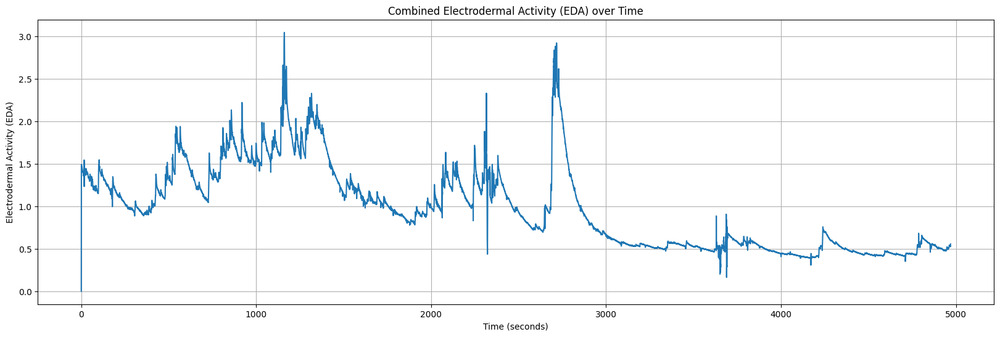

In [1404]:
# Combine the two EDA signals by taking the average
combined_eda = (right_eda_df['EDA'] + left_eda_df['EDA']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_eda_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_eda_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_eda)
plt.title('Combined Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(True)
plt.show()

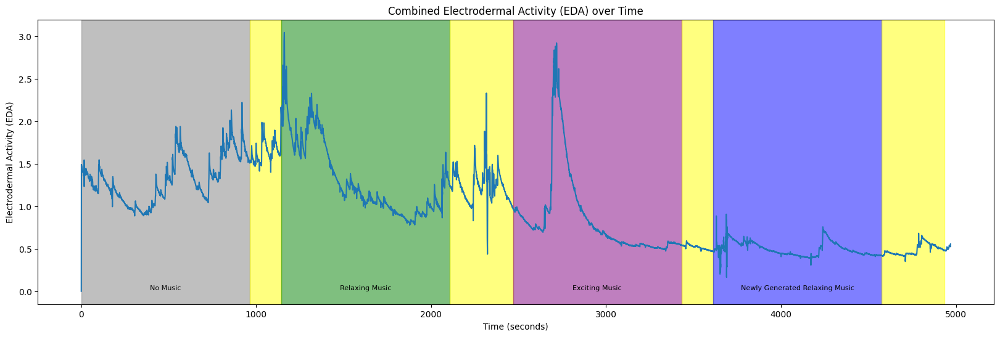

In [1405]:
import matplotlib.pyplot as plt


# Combine the two EDA signals by taking the average
combined_eda = (right_eda_df['EDA'] + left_eda_df['EDA']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_eda_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_eda_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_eda)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_eda), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Combined Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(False)
plt.show()

### HR
- HR: Average heart rate (HR) extracted from the BVP signal. Values in the first column (HR) show the HR values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1406]:
left_hr_df=pd.read_csv(Left_HR_file)
left_hr_df

,HR,start_time_unix,sampling_rate
0,71.00,1.628540e+09,1.0
1,73.00,1.628540e+09,1.0
2,74.00,1.628540e+09,1.0
3,70.00,1.628540e+09,1.0
4,70.60,1.628540e+09,1.0
...,...,...,...
4954,71.10,1.628540e+09,1.0
4955,71.20,1.628540e+09,1.0
4956,71.23,1.628540e+09,1.0
4957,71.25,1.628540e+09,1.0


In [1407]:
right_hr_df=pd.read_csv(Right_HR_file)
right_hr_df

,HR,start_time_unix,sampling_rate
0,65.00,1.628540e+09,1.0
1,65.00,1.628540e+09,1.0
2,64.00,1.628540e+09,1.0
3,68.75,1.628540e+09,1.0
4,66.80,1.628540e+09,1.0
...,...,...,...
4954,72.10,1.628540e+09,1.0
4955,72.17,1.628540e+09,1.0
4956,72.25,1.628540e+09,1.0
4957,72.35,1.628540e+09,1.0


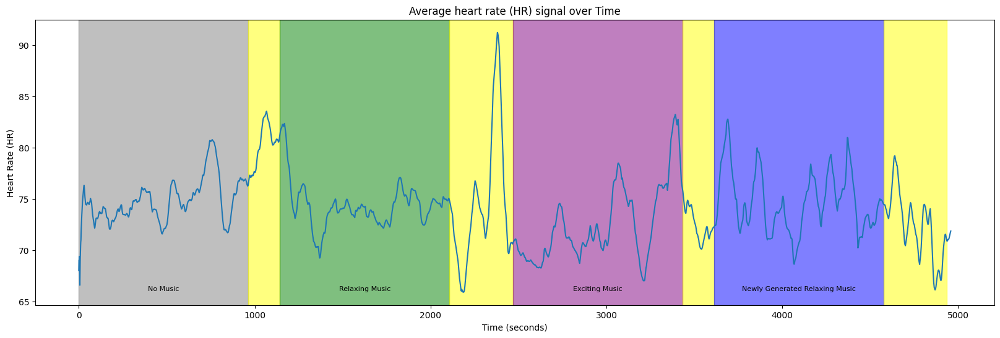

In [1408]:
import matplotlib.pyplot as plt


# Combine the two hr signals by taking the average
combined_hr = (right_hr_df['HR'] + left_hr_df['HR']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_hr_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_hr_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_hr)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_hr), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Average heart rate (HR) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Heart Rate (HR)')
plt.grid(False)
plt.show()

### BVP
- BVP: Blood volume pulses (BVP) measured from a photoplethysmograph. Values in the first column (BVP) show the BVP values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1409]:
left_bvp_df=pd.read_csv(Left_BVP_file)
left_bvp_df

,BVP,start_time_unix,sampling_rate
0,-0.00,1.628540e+09,64.0
1,-0.00,1.628540e+09,64.0
2,-0.00,1.628540e+09,64.0
3,-0.00,1.628540e+09,64.0
4,-0.00,1.628540e+09,64.0
...,...,...,...
317972,90.05,1.628540e+09,64.0
317973,111.28,1.628540e+09,64.0
317974,129.43,1.628540e+09,64.0
317975,145.02,1.628540e+09,64.0


In [1410]:
right_bvp_df=pd.read_csv(Right_BVP_file)
right_bvp_df

,BVP,start_time_unix,sampling_rate
0,-0.00,1.628540e+09,64.0
1,-0.00,1.628540e+09,64.0
2,-0.00,1.628540e+09,64.0
3,-0.00,1.628540e+09,64.0
4,-0.00,1.628540e+09,64.0
...,...,...,...
317983,184.14,1.628540e+09,64.0
317984,187.83,1.628540e+09,64.0
317985,189.94,1.628540e+09,64.0
317986,190.15,1.628540e+09,64.0


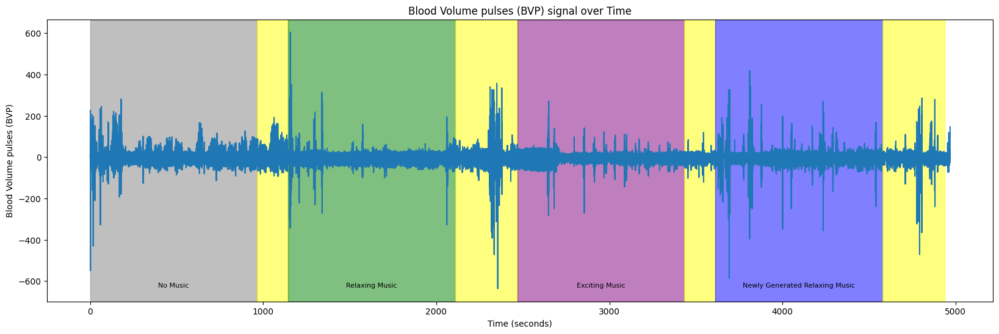

In [1411]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_bvp = (right_bvp_df['BVP'] + left_bvp_df['BVP']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_bvp_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = right_bvp_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_bvp)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_bvp), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Blood Volume pulses (BVP) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Blood Volume pulses (BVP)')
plt.grid(False)
plt.show()

### Temperature
- TEMP: Skin temperature (TEMP) measured from temperature sensor expressed degrees on the Celsius (°C) scale. Values in the first column (TEMP) show the TEMP values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1412]:
left_temp_df=pd.read_csv(Left_TEMP_file)
left_temp_df

,TEMP,start_time_unix,sampling_rate
0,31.57,1.628540e+09,4.0
1,31.57,1.628540e+09,4.0
2,31.57,1.628540e+09,4.0
3,31.57,1.628540e+09,4.0
4,31.57,1.628540e+09,4.0
...,...,...,...
19875,31.83,1.628540e+09,4.0
19876,31.85,1.628540e+09,4.0
19877,31.85,1.628540e+09,4.0
19878,31.85,1.628540e+09,4.0


In [1413]:
right_temp_df=pd.read_csv(Right_TEMP_file)
right_temp_df

,TEMP,start_time_unix,sampling_rate
0,31.57,1.628540e+09,4.0
1,31.57,1.628540e+09,4.0
2,31.57,1.628540e+09,4.0
3,31.57,1.628540e+09,4.0
4,31.57,1.628540e+09,4.0
...,...,...,...
19875,32.11,1.628540e+09,4.0
19876,32.13,1.628540e+09,4.0
19877,32.13,1.628540e+09,4.0
19878,32.13,1.628540e+09,4.0


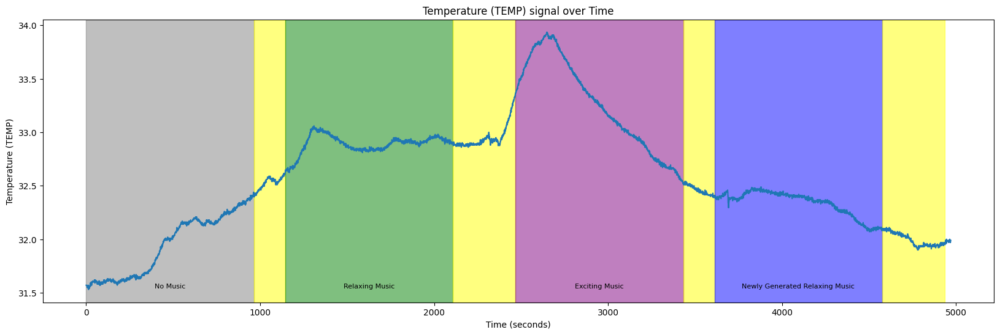

In [1414]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_temp = (right_temp_df['TEMP'] + left_temp_df['TEMP']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_temp_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_temp_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_temp)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_temp), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Temperature (TEMP) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Temperature (TEMP)')
plt.grid(False)
plt.show()

### ACC
- ACC: Data from 3-axis accelerometer sensor. The accelerometer is configured to measure acceleration in the range [-2g, 2g]. Therefore, the unit in this file is 1/64g. Data from x, y, and z axis are labeled respectively (i.e., ACC_X, ACC_Y, and ACC_Z).  The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1415]:
left_ACC_df=pd.read_csv(Left_ACC_file)
left_ACC_df

,ACC_X,ACC_Y,ACC_Z,start_time_unix,sampling_rate
0,-29,9,56,1.628540e+09,32.0
1,-29,9,56,1.628540e+09,32.0
2,-29,9,56,1.628540e+09,32.0
3,-29,9,56,1.628540e+09,32.0
4,-29,9,56,1.628540e+09,32.0
...,...,...,...,...,...
158995,0,10,63,1.628540e+09,32.0
158996,-1,10,63,1.628540e+09,32.0
158997,-2,9,63,1.628540e+09,32.0
158998,0,8,63,1.628540e+09,32.0


In [1416]:
right_ACC_df=pd.read_csv(Right_ACC_file)
right_ACC_df

,ACC_X,ACC_Y,ACC_Z,start_time_unix,sampling_rate
0,-52,1,41,1.628540e+09,32.0
1,-51,1,41,1.628540e+09,32.0
2,-51,1,42,1.628540e+09,32.0
3,-51,1,42,1.628540e+09,32.0
4,-51,1,42,1.628540e+09,32.0
...,...,...,...,...,...
159001,-8,-1,63,1.628540e+09,32.0
159002,-8,-2,63,1.628540e+09,32.0
159003,-8,-1,63,1.628540e+09,32.0
159004,-8,0,63,1.628540e+09,32.0


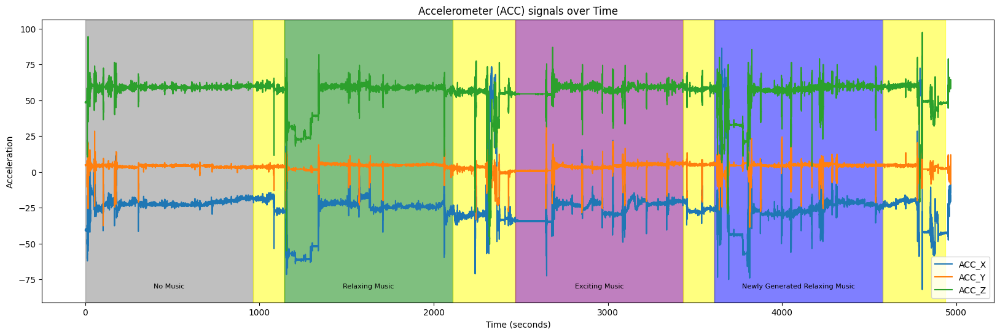

In [1417]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_accX = (right_ACC_df['ACC_X'] + left_ACC_df['ACC_X']) / 2
combined_accY = (right_ACC_df['ACC_Y'] + left_ACC_df['ACC_Y']) / 2
combined_accZ = (right_ACC_df['ACC_Z'] + left_ACC_df['ACC_Z']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_ACC_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = right_ACC_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_accX, label='ACC_X')
plt.plot(time_seconds, combined_accY, label='ACC_Y')
plt.plot(time_seconds, combined_accZ, label='ACC_Z')

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_accX), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Accelerometer (ACC) signals over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Acceleration')
plt.legend()
plt.grid(False)
plt.show()

## EG

The EEG signals recorded from the Muse headband are also included in the dataset as 'EEG_recording.csv'. They include EEG channels from four locations: TP9, AF7, AF8, and TP10. The 2016 model Muse (MU-02) can also output RAW EEG data at 256Hz as well as being able to output RAW EEG from the right ear USB Auxiliary connector (named Right AUX in the csv files). The column (timestamps) shows the data points in UNIX format. EEG measurements are labeled as TP9, AF7, AF8, TP10, Right AUX.

In [224]:
eeg_df=pd.read_csv(EEG_file)
eeg_df

,timestamps,TP9,AF7,AF8,TP10,Right AUX
0,1.628540e+09,-77.637,19.531,51.758,-15.137,41.016
1,1.628540e+09,-79.590,21.484,49.316,-13.672,71.289
2,1.628540e+09,-59.570,19.531,61.035,-2.930,40.527
3,1.628540e+09,-42.480,14.648,63.965,1.953,11.719
4,1.628540e+09,-45.410,13.184,48.340,-5.371,41.992
...,...,...,...,...,...,...
1274727,1.628545e+09,61.035,12.695,32.227,41.992,-37.598
1274728,1.628545e+09,-5.859,1.465,40.039,48.828,-10.742
1274729,1.628545e+09,33.203,16.113,46.875,67.383,31.738
1274730,1.628545e+09,41.016,46.387,34.668,50.293,60.059


C:\Users\user\AppData\Local\Temp\ipykernel_29192\2195272341.py:25: RuntimeWarning: divide by zero encountered in log10
  plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP9), shading='gouraud', cmap='viridis')


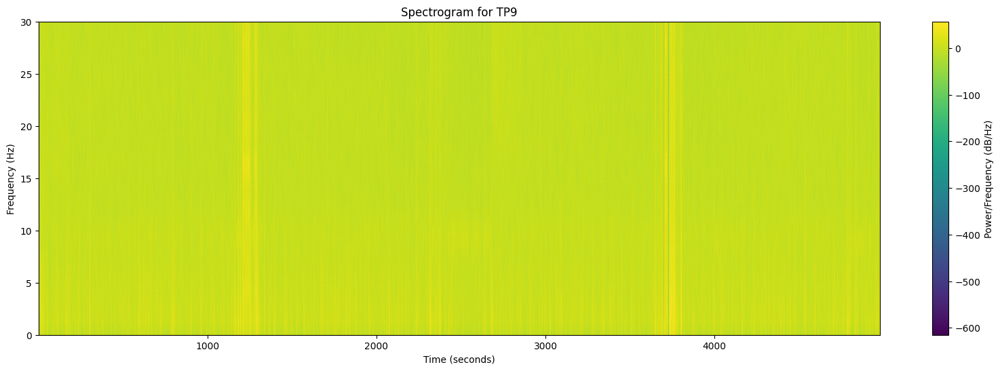

C:\Users\user\AppData\Local\Temp\ipykernel_29192\2195272341.py:35: RuntimeWarning: divide by zero encountered in log10
  plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap='viridis')


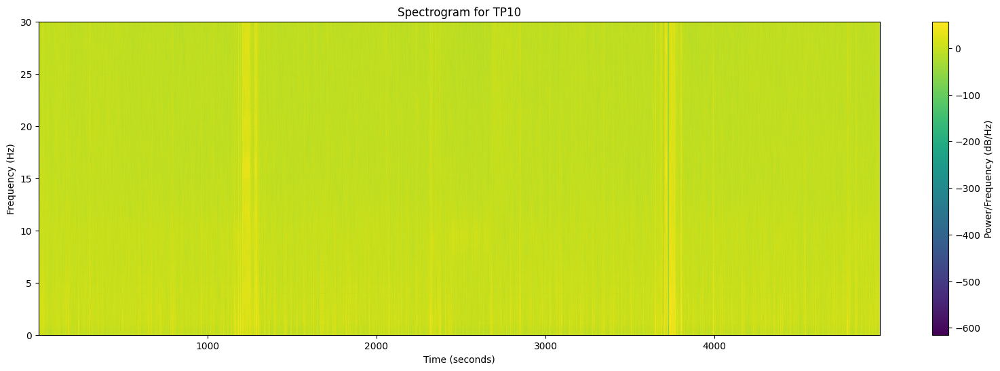

In [225]:
import matplotlib.pyplot as plt
from scipy import signal
# Extract the desired channels (TP9 and TP10)
channels = ['TP9', 'TP10']  
eeg_data = eeg_df[channels]

# Convert the timestamps to time in seconds
sampling_rate = 256  # Sampling rate of the EEG data in Hz
time_seconds = eeg_df['timestamps'] / sampling_rate

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 256    # Length of each segment
noverlap = 128   # Overlap between segments
nfft = 256       # Number of points for the FFT

# Compute the spectrogram for each channel
frequencies, times, spectrogram_TP9 = signal.spectrogram(eeg_data['TP9'], fs=sampling_rate, window=window, 
                                                         nperseg=nperseg, noverlap=noverlap, nfft=nfft)
_, _, spectrogram_TP10 = signal.spectrogram(eeg_data['TP10'], fs=sampling_rate, window=window, 
                                            nperseg=nperseg, noverlap=noverlap, nfft=nfft)

# Plot the spectrogram for TP9
plt.figure(figsize=(20, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP9), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP9')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
plt.show()

# Plot the spectrogram for TP10
plt.figure(figsize=(20, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP10')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
plt.show()

Text(0.5, 0, 'time (s)')

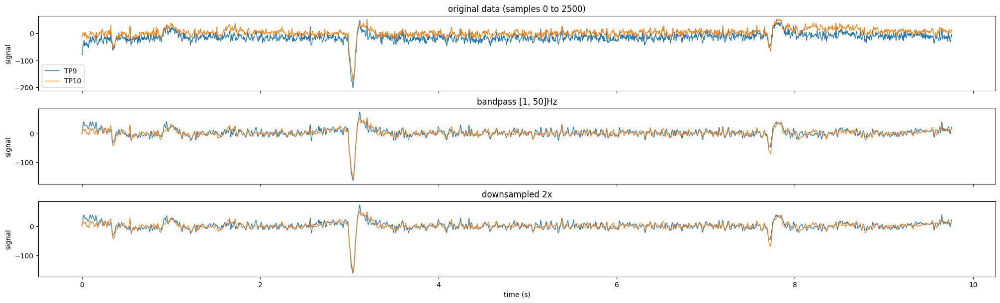

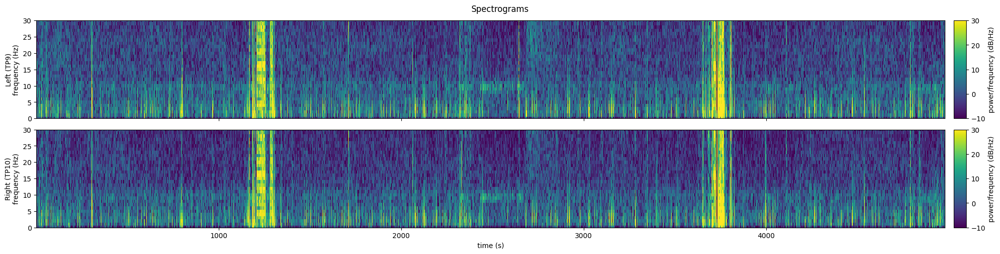

In [226]:
eeg_df['sample_number'] = range(len(eeg_df))
# Sampling rate of the EEG data in Hz
sampling_rate = 256  


# Convert the sample index to time in seconds
# This means you need to divide the sample *number* by the sampling rate
eeg_df['time_seconds'] = eeg_df['sample_number'] / sampling_rate

# Extract the desired channels (TP9 and TP10)
keep_channels = ['TP9', 'TP10']
eeg_data = eeg_df[keep_channels + ['time_seconds']].copy()

#
# Preprocess the EEG signals
#

#Define the pre-preprocessing parameters
downsample_factor = 2
bp_order = 4
bp_passband = [1, 50]
downsample_factor = 2

eeg_downsampled = pd.DataFrame()
downsampled_length = len(eeg_data) // downsample_factor

for channel in keep_channels:
    filtered_name = channel + '_bp'
    # Apply high-pass filter above 1 Hz and low-pass filter below 50 Hz
    b, a = signal.butter(bp_order, bp_passband, btype='bandpass', fs=sampling_rate)
    eeg_data[filtered_name] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample the signal from 256 to 128 Hz
    # Put the shorter signals in a new dataframe "eeg_downsampled"
    eeg_downsampled[channel] = signal.resample(eeg_data[filtered_name], downsampled_length)
eeg_downsampled['time_seconds'] = np.arange(downsampled_length) / (sampling_rate / downsample_factor)

#
# View the original and processed data
#
plot_height = 2
n_plots = 3
f, axs = plt.subplots(nrows=n_plots, ncols=1,
                      figsize=(20, plot_height * n_plots),
                      layout='constrained', sharex=True)

plot_slice = slice(0, 2500) #window of data to plot

#Original data
eeg_data[plot_slice].plot(
    y=keep_channels, x='time_seconds',
    ylabel='signal', xlabel='time (s)',
    linewidth=1, ax=axs[0],
    title=f'original data (samples {plot_slice.start} to {plot_slice.stop})'
)

#Filtered
eeg_data[plot_slice].plot(
    y=[chan + '_bp' for chan in keep_channels], x='time_seconds',
    ylabel='signal', xlabel='time (s)', legend=False,
    linewidth=1, ax=axs[1], title=f'bandpass {bp_passband}Hz'
)

#Downsampled
eeg_downsampled[plot_slice.start:plot_slice.stop//downsample_factor].plot(
    y=keep_channels, x='time_seconds',
    ylabel='signal', xlabel='time (s)', legend=False,
    linewidth=1, ax=axs[2], title=f'downsampled {downsample_factor}x'
)

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 128    # Length of each segment
noverlap = 64    # Overlap between segments
nfft = 128       # Number of points for the FFT

# Compute the spectrogram for each channel
spectrograms = {}
for channel in keep_channels:
    frequencies, times, spectrogram = signal.spectrogram(
        eeg_downsampled[channel],
        fs=sampling_rate / downsample_factor,
        window=window, nperseg=nperseg, noverlap=noverlap, nfft=nfft
    )
    spectrograms[channel] = spectrogram

# Plot the spectrograms
f, axs = plt.subplots(nrows=2, ncols=1, figsize=(20, 5),
                      layout='constrained', sharex=True)
f.suptitle('Spectrograms')
vmin, vmax = -10, 30

for channel, ax in zip(keep_channels, axs):
    im = ax.pcolormesh(
        times, frequencies, 10 * np.log10(spectrograms[channel]),
        vmin=vmin, vmax=vmax, #comment out for auto-range
        shading='nearest', cmap='viridis'
    )
    
    ax.set_ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
    ax.set_ylabel(('Left' if channel=='TP9' else 'Right') + f' ({channel})\nfrequency (Hz)')
    
    cbar = f.colorbar(im, aspect=8, pad=0.01, label='power/frequency (dB/Hz)')
    
ax.set_xlabel('time (s)')

### Beta Band Frequency

C:\Users\user\AppData\Local\Temp\ipykernel_29192\2331215207.py:79: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")
C:\Users\user\AppData\Local\Temp\ipykernel_29192\2331215207.py:79: UserWarning: 

The `join` parameter is deprecated and will be removed in v0.15.0.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")


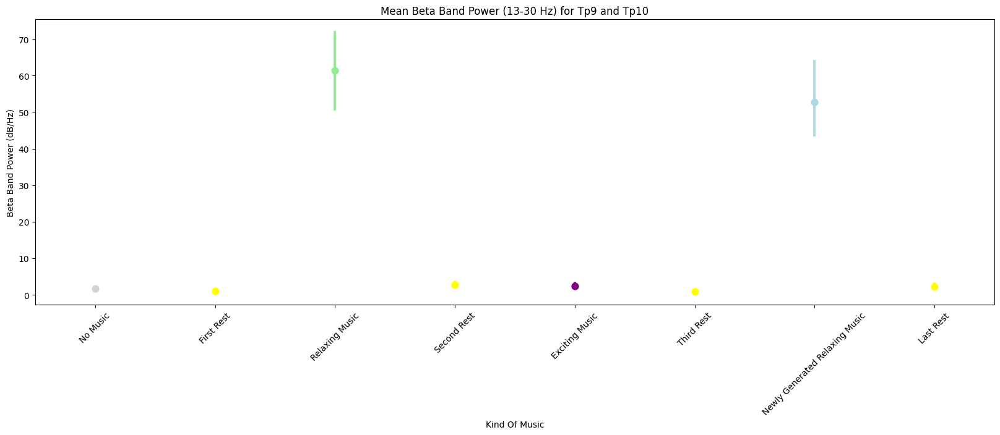

In [227]:
# Sample EEG DataFrame
# Assuming you have an EEG DataFrame named eeg_df with columns 'TP9' and 'TP10'

# Preprocessing parameters
sampling_rate = 256
downsample_factor = 2
bp_order = 4
bp_passband = [1, 50]

# Apply preprocessing and downsampling
eeg_df['sample_number'] = range(len(eeg_df))
eeg_df['time_seconds'] = eeg_df['sample_number'] / sampling_rate

eeg_data = eeg_df[['TP9', 'TP10', 'time_seconds']].copy()

eeg_downsampled = pd.DataFrame()
downsampled_length = len(eeg_data) // downsample_factor

for channel in ['TP9', 'TP10']:
    filtered_name = channel + '_bp'
    # Apply bandpass filter
    b, a = signal.butter(bp_order, bp_passband, btype='bandpass', fs=sampling_rate)
    eeg_data[filtered_name] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample
    eeg_downsampled[channel] = signal.resample(eeg_data[filtered_name], downsampled_length)

eeg_downsampled['time_seconds'] = np.arange(downsampled_length) / (sampling_rate / downsample_factor)

# Compute spectrogram for each channel
frequencies, times, spectrogram_tp9 = signal.spectrogram(
    eeg_downsampled['TP9'],
    fs=sampling_rate / downsample_factor,
    window='hann', nperseg=128, noverlap=64, nfft=128
)

_, _, spectrogram_tp10 = signal.spectrogram(
    eeg_downsampled['TP10'],
    fs=sampling_rate / downsample_factor,
    window='hann', nperseg=128, noverlap=64, nfft=128
)

# Compute beta band power (13-30 Hz) for each channel
beta_band_power_tp9 = np.mean(spectrogram_tp9[(frequencies >= 13) & (frequencies <= 30)], axis=0)
beta_band_power_tp10 = np.mean(spectrogram_tp10[(frequencies >= 13) & (frequencies <= 30)], axis=0)

# Compute mean beta band power across channels
mean_beta_band_power = (beta_band_power_tp9 + beta_band_power_tp10) / 2

# Define intervals and corresponding labels
intervals = [
    (0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
    (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                            964 + 180 + 964 + 360 + 964 + 180),
    (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
    (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)
]
labels = ['No Music', 'First Rest', 'Relaxing Music', 'Second Rest', 'Exciting Music', 'Third Rest',
          'Newly Generated Relaxing Music', 'Last Rest']

# Assign labels to each data point based on intervals
beta_power_df = pd.DataFrame({'Time': times, 'Power': mean_beta_band_power})
beta_power_df['Kind Of Music'] = pd.cut(beta_power_df['Time'], bins=[interval[0] for interval in intervals] + [np.inf], labels=labels)

# Define color palette dictionary
color_palette = {
    'No Music': 'lightgray',
    'First Rest': 'yellow',
    'Relaxing Music': 'lightgreen',
    'Second Rest': 'yellow',
    'Exciting Music': 'purple',
    'Third Rest': 'yellow',
    'Newly Generated Relaxing Music': 'lightblue',
    'Last Rest': 'yellow'
}

# Plot
plt.figure(figsize=(20, 6))
sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")
plt.title('Mean Beta Band Power (13-30 Hz) for Tp9 and Tp10')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Kind Of Music')
plt.xticks(rotation=45)
plt.show()

C:\Users\user\AppData\Local\Temp\ipykernel_29192\3532274209.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette)


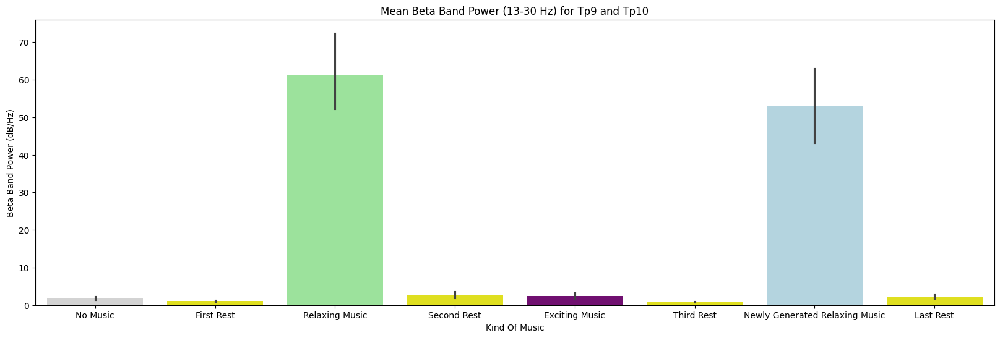

In [228]:
# Apply color palette for the bar plot
color_palette = {
    'No Music': 'lightgray',
    'First Rest': 'yellow',
    'Relaxing Music': 'lightgreen',
    'Second Rest': 'yellow',
    'Exciting Music': 'purple',
    'Third Rest': 'yellow',
    'Newly Generated Relaxing Music': 'lightblue',
    'Last Rest': 'yellow'
}

# Generate the bar plot
plt.figure(figsize=(20, 6))
sns.barplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette)
plt.title('Mean Beta Band Power (13-30 Hz) for Tp9 and Tp10')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Kind Of Music')
plt.show()

# Patient A6

In [229]:
# Define the file paths for the A6 data files
EEG_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A6\EEG_recording.csv'
Left_ACC_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A6\Left_ACC.csv'
Left_BVP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A6\Left_BVP.csv'
Left_EDA_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A6\Left_EDA.csv'
Left_HR_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A6\Left_HR.csv'
Left_IBI_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A6\Left_IBI.csv'
Left_tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A6\Left_tags.csv'
Left_TEMP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A6\Left_TEMP.csv'
n_back_responses_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A6\n_back_responses.csv'
Right_ACC_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A6\Right_ACC.csv'
Right_BVP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A6\Right_BVP.csv'
Right_EDA_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A6\Right_EDA.csv'
Right_HR_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A6\Right_HR.csv'
Right_IBI_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A6\Right_IBI.csv'
Right_tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A6\Right_tags.csv'
Right_TEMP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A6\Right_TEMP.csv'
tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A6\tags.csv'

## n back responses

In [1425]:
n_backr_df=pd.read_csv(n_back_responses_file)
n_backr_df

,ExperimentName,Start_time_unix,Subject,Session,DataFile.Basename,Display.RefreshRate,ExperimentVersion,Group,InstructionNewMusic.DEVICE,InstructionNoMusic.DEVICE,...,TrialList8.Cycle,TrialList8.Sample,TSO,TSTh,TSvO,TSvTh,TSxO,TSxTh,TTO,TTTh
0,Experiment_1,1625449489,8,1,Experiment_1-8-1,75.023,1.0.0.254,1,Chronos,Chronos,...,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Experiment_1,1625449489,8,1,Experiment_1-8-1,75.023,1.0.0.254,1,Chronos,Chronos,...,1.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Experiment_1,1625449489,8,1,Experiment_1-8-1,75.023,1.0.0.254,1,Chronos,Chronos,...,1.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Experiment_1,1625449489,8,1,Experiment_1-8-1,75.023,1.0.0.254,1,Chronos,Chronos,...,1.0,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Experiment_1,1625449489,8,1,Experiment_1-8-1,75.023,1.0.0.254,1,Chronos,Chronos,...,1.0,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,Experiment_1,1625449489,8,1,Experiment_1-8-1,75.023,1.0.0.254,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1452,Experiment_1,1625449489,8,1,Experiment_1-8-1,75.023,1.0.0.254,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1453,Experiment_1,1625449489,8,1,Experiment_1-8-1,75.023,1.0.0.254,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1454,Experiment_1,1625449489,8,1,Experiment_1-8-1,75.023,1.0.0.254,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1426]:
n_backr_df.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 250 columns):
 #    Column                                   Non-Null Count  Dtype  
---   ------                                   --------------  -----  
 0    ExperimentName                           1456 non-null   object 
 1    Start_time_unix                          1456 non-null   int64  
 2    Subject                                  1456 non-null   int64  
 3    Session                                  1456 non-null   int64  
 4    DataFile.Basename                        1456 non-null   object 
 5    Display.RefreshRate                      1456 non-null   float64
 6    ExperimentVersion                        1456 non-null   object 
 7    Group                                    1456 non-null   int64  
 8    InstructionNewMusic.DEVICE               1456 non-null   object 
 9    InstructionNoMusic.DEVICE                1456 non-null   object 
 10   InstructionNoMusic.DurationError  

In [1427]:
df_length=len(n_backr_df)

In [1428]:
# Filter columns with length 1456
non_null_columns = [col for col in n_backr_df.columns if n_backr_df[col].notnull().all()]
# Create a new DataFrame with only columns of the same length as the DataFrame
complete_df = n_backr_df[non_null_columns]
complete_df

,ExperimentName,Start_time_unix,Subject,Session,DataFile.Basename,Display.RefreshRate,ExperimentVersion,Group,InstructionNewMusic.DEVICE,InstructionNoMusic.DEVICE,...,Welcome.DurationError,Welcome.OnsetDelay,Welcome.OnsetTime,Welcome.OnsetToOnsetTime,Block,Instruction,ListName,Procedure[Block],Running[Block],Trigger
0,Experiment_1,1625449489,8,1,Experiment_1-8-1,75.023,1.0.0.254,1,Chronos,Chronos,...,-999999,30,20685,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
1,Experiment_1,1625449489,8,1,Experiment_1-8-1,75.023,1.0.0.254,1,Chronos,Chronos,...,-999999,30,20685,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
2,Experiment_1,1625449489,8,1,Experiment_1-8-1,75.023,1.0.0.254,1,Chronos,Chronos,...,-999999,30,20685,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
3,Experiment_1,1625449489,8,1,Experiment_1-8-1,75.023,1.0.0.254,1,Chronos,Chronos,...,-999999,30,20685,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
4,Experiment_1,1625449489,8,1,Experiment_1-8-1,75.023,1.0.0.254,1,Chronos,Chronos,...,-999999,30,20685,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,Experiment_1,1625449489,8,1,Experiment_1-8-1,75.023,1.0.0.254,1,Chronos,Chronos,...,-999999,30,20685,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1452,Experiment_1,1625449489,8,1,Experiment_1-8-1,75.023,1.0.0.254,1,Chronos,Chronos,...,-999999,30,20685,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1453,Experiment_1,1625449489,8,1,Experiment_1-8-1,75.023,1.0.0.254,1,Chronos,Chronos,...,-999999,30,20685,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1454,Experiment_1,1625449489,8,1,Experiment_1-8-1,75.023,1.0.0.254,1,Chronos,Chronos,...,-999999,30,20685,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2


### Instruction

In [1429]:
instruction = n_backr_df.columns
instruction[instruction.str.contains('Instruction')]
#.str.contains('SNOMED')]

Index(['InstructionNewMusic.DEVICE', 'InstructionNoMusic.DEVICE',
       'InstructionNoMusic.DurationError', 'InstructionNoMusic.OnsetDelay',
       'InstructionNoMusic.OnsetTime', 'InstructionNoMusic.OnsetToOnsetTime',
       'InstructionRelaxMusic.DEVICE', 'InstructionRelaxMusic.DurationError',
       'InstructionRelaxMusic.OnsetDelay', 'InstructionRelaxMusic.OnsetTime',
       'InstructionRelaxMusic.OnsetToOnsetTime',
       'InstructionStressMusic.DEVICE', 'InstructionStressMusic.DurationError',
       'InstructionStressMusic.OnsetDelay', 'InstructionStressMusic.OnsetTime',
       'InstructionStressMusic.OnsetToOnsetTime', 'Instruction'],
      dtype='object')

In [1430]:
instruction_df=n_backr_df[instruction[instruction.str.contains('Instruction')]]

### Stimulus

In [1431]:
stimulus = n_backr_df.columns
stimulus=stimulus[stimulus.str.contains('Stimulus')]

In [1432]:
stimulus

Index(['Stimulus100.ACC', 'Stimulus100.CRESP', 'Stimulus100.DEVICE',
       'Stimulus100.DurationError', 'Stimulus100.OnsetDelay',
       'Stimulus100.OnsetTime', 'Stimulus100.OnsetToOnsetTime',
       'Stimulus100.RESP', 'Stimulus100.RT', 'Stimulus100.RTTime',
       'Stimulus101.ACC', 'Stimulus101.CRESP', 'Stimulus101.DEVICE',
       'Stimulus101.DurationError', 'Stimulus101.OnsetDelay',
       'Stimulus101.OnsetTime', 'Stimulus101.OnsetToOnsetTime',
       'Stimulus101.RESP', 'Stimulus101.RT', 'Stimulus101.RTTime',
       'Stimulus102.ACC', 'Stimulus102.CRESP', 'Stimulus102.DEVICE',
       'Stimulus102.DurationError', 'Stimulus102.OnsetDelay',
       'Stimulus102.OnsetTime', 'Stimulus102.OnsetToOnsetTime',
       'Stimulus102.RESP', 'Stimulus102.RT', 'Stimulus102.RTTime',
       'Stimulus103.ACC', 'Stimulus103.CRESP', 'Stimulus103.DEVICE',
       'Stimulus103.DurationError', 'Stimulus103.OnsetDelay',
       'Stimulus103.OnsetTime', 'Stimulus103.OnsetToOnsetTime',
       'Stimulus103

In [1433]:
# Create a dictionary to store the mapping of columns to Running[Block] values
column_to_block = {}
running_block_values=n_backr_df['Running[Block]'].unique()
# Create a dictionary to store the mapping of stimulus columns to lists of Running[Block] values

stimulus_to_blocks = {}

# Iterate over each stimulus column
for col in stimulus:
    # Store all 4 Running[Block] values as a list for this stimulus column
    stimulus_to_blocks[col] = running_block_values

print(stimulus_to_blocks)

{'Stimulus100.ACC': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.CRESP': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.DEVICE': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.DurationError': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetDelay': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetTime': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetToOnsetTime': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.RESP': array(['PracticeSessi

In [1434]:
# Create a new dictionary to store the suffixed keys and values
suffixed_dict = {}

# Iterate over each key in stimulus_to_blocks dictionary
for key, values in stimulus_to_blocks.items():
    # Get the prefix (e.g., 'Stimulus100') from the key
    prefix = key.split('.')[0]
    
    # Create a list to store the suffixed column names
    suffixed_columns = []
    
    # Iterate over each column name in stimulus_columns
    for col in stimulus:
        # If the column name starts with the same prefix
        if col.startswith(prefix):
            # Append the suffixed column name to the list
            suffixed_columns.append(col)
    
    # Create the suffixed key by joining the prefix with ':'
    suffixed_key = f'{prefix}:'
    
    # Add the suffixed column names list as the value for the suffixed key
    suffixed_dict[suffixed_key] = suffixed_columns

print(suffixed_dict)

{'Stimulus100:': ['Stimulus100.ACC', 'Stimulus100.CRESP', 'Stimulus100.DEVICE', 'Stimulus100.DurationError', 'Stimulus100.OnsetDelay', 'Stimulus100.OnsetTime', 'Stimulus100.OnsetToOnsetTime', 'Stimulus100.RESP', 'Stimulus100.RT', 'Stimulus100.RTTime'], 'Stimulus101:': ['Stimulus101.ACC', 'Stimulus101.CRESP', 'Stimulus101.DEVICE', 'Stimulus101.DurationError', 'Stimulus101.OnsetDelay', 'Stimulus101.OnsetTime', 'Stimulus101.OnsetToOnsetTime', 'Stimulus101.RESP', 'Stimulus101.RT', 'Stimulus101.RTTime'], 'Stimulus102:': ['Stimulus102.ACC', 'Stimulus102.CRESP', 'Stimulus102.DEVICE', 'Stimulus102.DurationError', 'Stimulus102.OnsetDelay', 'Stimulus102.OnsetTime', 'Stimulus102.OnsetToOnsetTime', 'Stimulus102.RESP', 'Stimulus102.RT', 'Stimulus102.RTTime'], 'Stimulus103:': ['Stimulus103.ACC', 'Stimulus103.CRESP', 'Stimulus103.DEVICE', 'Stimulus103.DurationError', 'Stimulus103.OnsetDelay', 'Stimulus103.OnsetTime', 'Stimulus103.OnsetToOnsetTime', 'Stimulus103.RESP', 'Stimulus103.RT', 'Stimulus103.R

#### Stimulus Table 100

In [1435]:
# Filter columns that start with 'Stimulus100'
stimulus100_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus100')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
stimulus100_df=n_backr_df[stimulus100_columns]
stimulus100_df

,Stimulus100.ACC,Stimulus100.CRESP,Stimulus100.DEVICE,Stimulus100.DurationError,Stimulus100.OnsetDelay,Stimulus100.OnsetTime,Stimulus100.OnsetToOnsetTime,Stimulus100.RESP,Stimulus100.RT,Stimulus100.RTTime,Running[Block]
0,0.0,3.0,Chronos,2.0,-2.0,235163.0,507.0,NaN,0.0,0.0,PracticeSession
1,0.0,3.0,Chronos,1.0,19.0,237189.0,507.0,NaN,0.0,0.0,PracticeSession
2,0.0,3.0,Chronos,1.0,19.0,239215.0,506.0,NaN,0.0,0.0,PracticeSession
3,0.0,4.0,Chronos,1.0,20.0,241241.0,506.0,NaN,0.0,0.0,PracticeSession
4,0.0,4.0,Chronos,1.0,20.0,243267.0,506.0,NaN,0.0,0.0,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 101

In [1436]:
# Filter columns that start with 'Stimulus100'
stimulus101_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus101')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus101_df=n_backr_df[stimulus101_columns]
stimulus101_df

,Stimulus101.ACC,Stimulus101.CRESP,Stimulus101.DEVICE,Stimulus101.DurationError,Stimulus101.OnsetDelay,Stimulus101.OnsetTime,Stimulus101.OnsetToOnsetTime,Stimulus101.RESP,Stimulus101.RT,Stimulus101.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 102

In [1437]:
# Filter columns that start with 'Stimulus100'
stimulus102_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus102')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus102_df=n_backr_df[stimulus102_columns]
stimulus102_df

,Stimulus102.ACC,Stimulus102.CRESP,Stimulus102.DEVICE,Stimulus102.DurationError,Stimulus102.OnsetDelay,Stimulus102.OnsetTime,Stimulus102.OnsetToOnsetTime,Stimulus102.RESP,Stimulus102.RT,Stimulus102.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 103

In [1438]:
# Filter columns that start with 'Stimulus100'
stimulus103_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus103')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus103_df=n_backr_df[stimulus103_columns]
stimulus103_df

,Stimulus103.ACC,Stimulus103.CRESP,Stimulus103.DEVICE,Stimulus103.DurationError,Stimulus103.OnsetDelay,Stimulus103.OnsetTime,Stimulus103.OnsetToOnsetTime,Stimulus103.RESP,Stimulus103.RT,Stimulus103.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 104

In [1439]:
# Filter columns that start with 'Stimulus100'
stimulus104_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus104')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus104_df=n_backr_df[stimulus104_columns]
stimulus104_df

,Stimulus104.ACC,Stimulus104.CRESP,Stimulus104.DEVICE,Stimulus104.DurationError,Stimulus104.OnsetDelay,Stimulus104.OnsetTime,Stimulus104.OnsetToOnsetTime,Stimulus104.RESP,Stimulus104.RT,Stimulus104.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,0.0,3.0,Chronos,1.0,6.0,4998015.0,506.0,NaN,0.0,0.0,NewMusicSession
1452,0.0,3.0,Chronos,2.0,6.0,5000027.0,507.0,NaN,0.0,0.0,NewMusicSession
1453,0.0,3.0,Chronos,1.0,6.0,5002040.0,506.0,NaN,0.0,0.0,NewMusicSession
1454,0.0,4.0,Chronos,1.0,7.0,5004053.0,506.0,NaN,0.0,0.0,NewMusicSession


### Fixation

In [1440]:
n_back_columns = n_backr_df.columns
fixation=n_back_columns[n_back_columns.str.contains('Fixation')]

In [1441]:
fixation_df=n_backr_df[n_back_columns[n_back_columns.str.contains('Fixation')]]

In [1442]:
fixation_df

,Fixation100.ACC,Fixation100.CRESP,Fixation100.DEVICE,Fixation100.DurationError,Fixation100.OnsetDelay,Fixation100.OnsetTime,Fixation100.OnsetToOnsetTime,Fixation100.RESP,Fixation100.RT,Fixation100.RTTime,...,Fixation104.ACC,Fixation104.CRESP,Fixation104.DEVICE,Fixation104.DurationError,Fixation104.OnsetDelay,Fixation104.OnsetTime,Fixation104.OnsetToOnsetTime,Fixation104.RESP,Fixation104.RT,Fixation104.RTTime
0,0.0,3.0,Chronos,1.0,7.0,235670.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.0,3.0,Chronos,1.0,7.0,237696.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0.0,3.0,Chronos,2.0,6.0,239721.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0.0,4.0,Chronos,2.0,6.0,241747.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0.0,4.0,Chronos,1.0,6.0,243773.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,3.0,Chronos,2.0,6.0,4998521.0,0.0,3.0,192.0,4998713.0
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,3.0,Chronos,1.0,7.0,5000534.0,0.0,3.0,104.0,5000638.0
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,3.0,Chronos,2.0,6.0,5002546.0,0.0,3.0,369.0,5002915.0
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,4.0,Chronos,2.0,6.0,5004559.0,0.0,4.0,594.0,5005153.0


#### Fixation table 100

In [1443]:
# Filter columns that start with 'Fixation100'
fixation100_columns = [col for col in n_backr_df.columns if col.startswith('Fixation100')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation100_df=n_backr_df[fixation100_columns]
fixation100_df

,Fixation100.ACC,Fixation100.CRESP,Fixation100.DEVICE,Fixation100.DurationError,Fixation100.OnsetDelay,Fixation100.OnsetTime,Fixation100.OnsetToOnsetTime,Fixation100.RESP,Fixation100.RT,Fixation100.RTTime,Running[Block]
0,0.0,3.0,Chronos,1.0,7.0,235670.0,0.0,NaN,0.0,0.0,PracticeSession
1,0.0,3.0,Chronos,1.0,7.0,237696.0,0.0,NaN,0.0,0.0,PracticeSession
2,0.0,3.0,Chronos,2.0,6.0,239721.0,0.0,NaN,0.0,0.0,PracticeSession
3,0.0,4.0,Chronos,2.0,6.0,241747.0,0.0,NaN,0.0,0.0,PracticeSession
4,0.0,4.0,Chronos,1.0,6.0,243773.0,0.0,NaN,0.0,0.0,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 101

In [1444]:
# Filter columns that start with 'Fixation100'
fixation101_columns = [col for col in n_backr_df.columns if col.startswith('Fixation101')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation101_df=n_backr_df[fixation101_columns]
fixation101_df

,Fixation101.ACC,Fixation101.CRESP,Fixation101.DEVICE,Fixation101.DurationError,Fixation101.OnsetDelay,Fixation101.OnsetTime,Fixation101.OnsetToOnsetTime,Fixation101.RESP,Fixation101.RT,Fixation101.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 102

In [1445]:
# Filter columns that start with 'Fixation100'
fixation102_columns = [col for col in n_backr_df.columns if col.startswith('Fixation102')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation102_df=n_backr_df[fixation102_columns]
fixation102_df

,Fixation102.ACC,Fixation102.CRESP,Fixation102.DEVICE,Fixation102.DurationError,Fixation102.OnsetDelay,Fixation102.OnsetTime,Fixation102.OnsetToOnsetTime,Fixation102.RESP,Fixation102.RT,Fixation102.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 103

In [1446]:
# Filter columns that start with 'Fixation100'
fixation103_columns = [col for col in n_backr_df.columns if col.startswith('Fixation103')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation103_df=n_backr_df[fixation103_columns]
fixation103_df

,Fixation103.ACC,Fixation103.CRESP,Fixation103.DEVICE,Fixation103.DurationError,Fixation103.OnsetDelay,Fixation103.OnsetTime,Fixation103.OnsetToOnsetTime,Fixation103.RESP,Fixation103.RT,Fixation103.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 104

In [1447]:
# Filter columns that start with 'Fixation100'
fixation104_columns = [col for col in n_backr_df.columns if col.startswith('Fixation104')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation104_df=n_backr_df[fixation104_columns]
fixation104_df

,Fixation104.ACC,Fixation104.CRESP,Fixation104.DEVICE,Fixation104.DurationError,Fixation104.OnsetDelay,Fixation104.OnsetTime,Fixation104.OnsetToOnsetTime,Fixation104.RESP,Fixation104.RT,Fixation104.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,1.0,3.0,Chronos,2.0,6.0,4998521.0,0.0,3.0,192.0,4998713.0,NewMusicSession
1452,1.0,3.0,Chronos,1.0,7.0,5000534.0,0.0,3.0,104.0,5000638.0,NewMusicSession
1453,1.0,3.0,Chronos,2.0,6.0,5002546.0,0.0,3.0,369.0,5002915.0,NewMusicSession
1454,1.0,4.0,Chronos,2.0,6.0,5004559.0,0.0,4.0,594.0,5005153.0,NewMusicSession


## Empatica

### EDA
- EDA: Measurements from the electrodermal activity (EDA) sensor expressed as micro siemens (μS). Values in the first column (EDA) show the EDA values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1448]:
left_eda_df=pd.read_csv(Left_EDA_file)
left_eda_df

,EDA,start_time_unix,sampling_rate
0,0.000000,1.625449e+09,4.0
1,0.827840,1.625449e+09,4.0
2,1.063900,1.625449e+09,4.0
3,0.921724,1.625449e+09,4.0
4,0.921724,1.625449e+09,4.0
...,...,...,...
20917,0.255283,1.625449e+09,4.0
20918,0.321920,1.625449e+09,4.0
20919,0.351394,1.625449e+09,4.0
20920,0.342424,1.625449e+09,4.0


In [1449]:
right_eda_df=pd.read_csv(Right_EDA_file)
right_eda_df

,EDA,start_time_unix,sampling_rate
0,0.000000,1.625449e+09,4.0
1,0.838918,1.625449e+09,4.0
2,1.183718,1.625449e+09,4.0
3,1.623098,1.625449e+09,4.0
4,2.099652,1.625449e+09,4.0
...,...,...,...
20917,0.493371,1.625449e+09,4.0
20918,0.590711,1.625449e+09,4.0
20919,0.603519,1.625449e+09,4.0
20920,0.598396,1.625449e+09,4.0


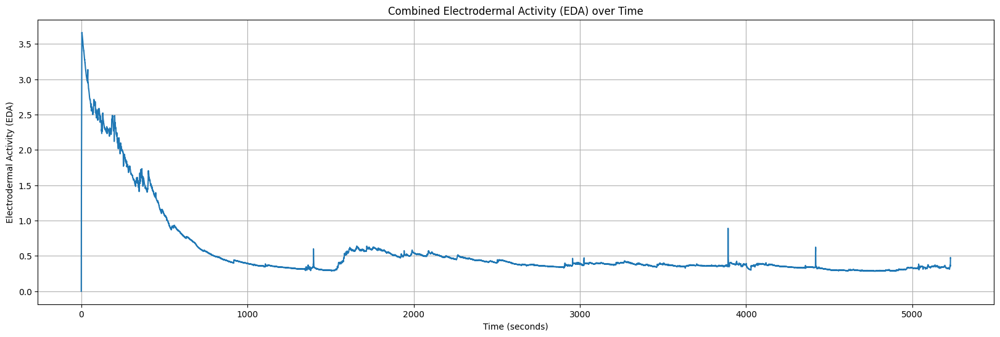

In [1450]:
# Combine the two EDA signals by taking the average
combined_eda = (right_eda_df['EDA'] + left_eda_df['EDA']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_eda_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_eda_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_eda)
plt.title('Combined Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(True)
plt.show()

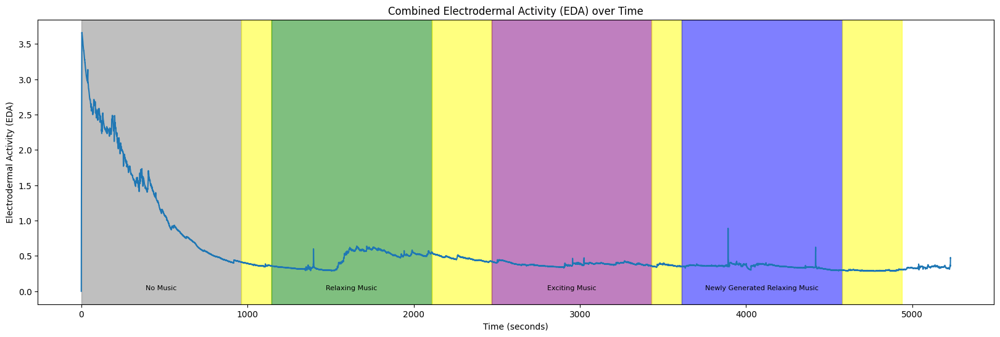

In [1451]:
import matplotlib.pyplot as plt


# Combine the two EDA signals by taking the average
combined_eda = (right_eda_df['EDA'] + left_eda_df['EDA']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_eda_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_eda_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_eda)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_eda), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Combined Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(False)
plt.show()

### HR
- HR: Average heart rate (HR) extracted from the BVP signal. Values in the first column (HR) show the HR values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1452]:
left_hr_df=pd.read_csv(Left_HR_file)
left_hr_df

,HR,start_time_unix,sampling_rate
0,61.00,1.625449e+09,1.0
1,85.00,1.625449e+09,1.0
2,78.00,1.625449e+09,1.0
3,83.00,1.625449e+09,1.0
4,97.20,1.625449e+09,1.0
...,...,...,...
5215,74.02,1.625449e+09,1.0
5216,74.02,1.625449e+09,1.0
5217,74.02,1.625449e+09,1.0
5218,74.00,1.625449e+09,1.0


In [1453]:
right_hr_df=pd.read_csv(Right_HR_file)
right_hr_df

,HR,start_time_unix,sampling_rate
0,61.00,1.625449e+09,1.0
1,68.50,1.625449e+09,1.0
2,103.67,1.625449e+09,1.0
3,123.25,1.625449e+09,1.0
4,114.40,1.625449e+09,1.0
...,...,...,...
5215,72.03,1.625449e+09,1.0
5216,72.12,1.625449e+09,1.0
5217,72.20,1.625449e+09,1.0
5218,72.27,1.625449e+09,1.0


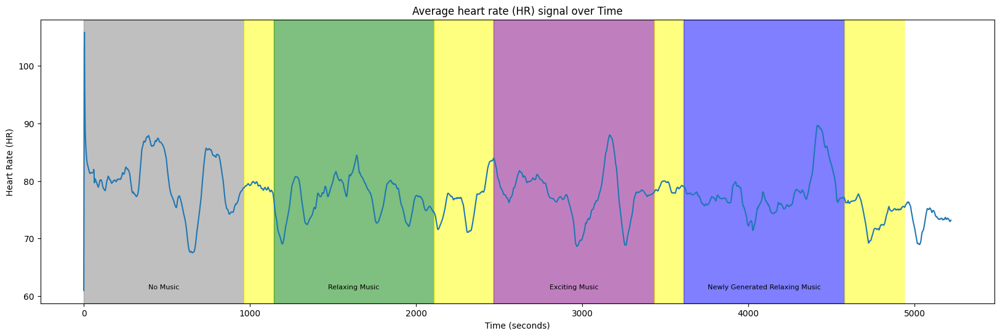

In [1454]:
import matplotlib.pyplot as plt


# Combine the two hr signals by taking the average
combined_hr = (right_hr_df['HR'] + left_hr_df['HR']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_hr_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_hr_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_hr)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_hr), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Average heart rate (HR) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Heart Rate (HR)')
plt.grid(False)
plt.show()

### BVP
- BVP: Blood volume pulses (BVP) measured from a photoplethysmograph. Values in the first column (BVP) show the BVP values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1455]:
left_bvp_df=pd.read_csv(Left_BVP_file)
left_bvp_df

,BVP,start_time_unix,sampling_rate
0,-0.00,1.625449e+09,64.0
1,-0.00,1.625449e+09,64.0
2,-0.00,1.625449e+09,64.0
3,-0.00,1.625449e+09,64.0
4,-0.00,1.625449e+09,64.0
...,...,...,...
334681,202.17,1.625449e+09,64.0
334682,196.29,1.625449e+09,64.0
334683,159.29,1.625449e+09,64.0
334684,96.20,1.625449e+09,64.0


In [1456]:
right_bvp_df=pd.read_csv(Right_BVP_file)
right_bvp_df

,BVP,start_time_unix,sampling_rate
0,-0.00,1.625449e+09,64.0
1,-0.00,1.625449e+09,64.0
2,-0.00,1.625449e+09,64.0
3,-0.00,1.625449e+09,64.0
4,-0.00,1.625449e+09,64.0
...,...,...,...
334670,-189.49,1.625449e+09,64.0
334671,-172.43,1.625449e+09,64.0
334672,-152.89,1.625449e+09,64.0
334673,-132.36,1.625449e+09,64.0


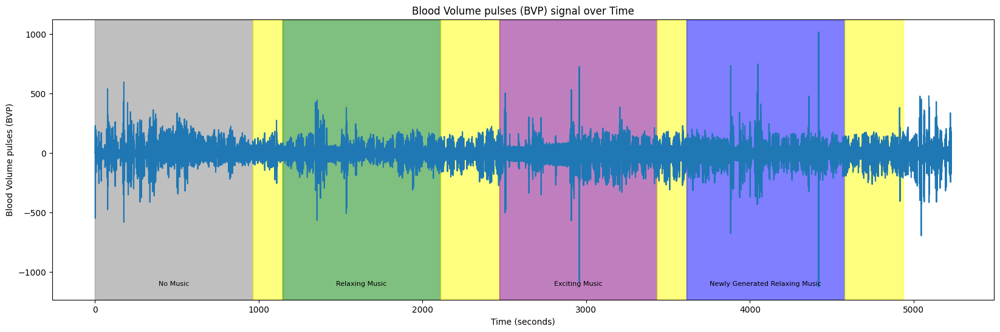

In [1457]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_bvp = (right_bvp_df['BVP'] + left_bvp_df['BVP']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_bvp_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_bvp_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_bvp)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_bvp), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Blood Volume pulses (BVP) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Blood Volume pulses (BVP)')
plt.grid(False)
plt.show()

### Temperature
- TEMP: Skin temperature (TEMP) measured from temperature sensor expressed degrees on the Celsius (°C) scale. Values in the first column (TEMP) show the TEMP values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1458]:
left_temp_df=pd.read_csv(Left_TEMP_file)
left_temp_df

,TEMP,start_time_unix,sampling_rate
0,30.81,1.625449e+09,4.0
1,30.81,1.625449e+09,4.0
2,30.81,1.625449e+09,4.0
3,30.81,1.625449e+09,4.0
4,30.81,1.625449e+09,4.0
...,...,...,...
20931,33.11,1.625449e+09,4.0
20932,33.13,1.625449e+09,4.0
20933,33.13,1.625449e+09,4.0
20934,33.13,1.625449e+09,4.0


In [1459]:
right_temp_df=pd.read_csv(Right_TEMP_file)
right_temp_df

,TEMP,start_time_unix,sampling_rate
0,30.33,1.625449e+09,4.0
1,30.33,1.625449e+09,4.0
2,30.33,1.625449e+09,4.0
3,30.33,1.625449e+09,4.0
4,30.33,1.625449e+09,4.0
...,...,...,...
20931,32.77,1.625449e+09,4.0
20932,32.77,1.625449e+09,4.0
20933,32.77,1.625449e+09,4.0
20934,32.77,1.625449e+09,4.0


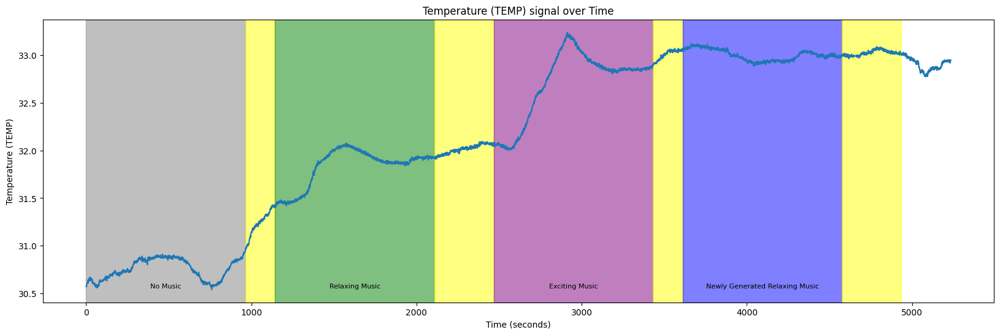

In [1460]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_temp = (right_temp_df['TEMP'] + left_temp_df['TEMP']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_temp_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_temp_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_temp)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_temp), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Temperature (TEMP) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Temperature (TEMP)')
plt.grid(False)
plt.show()

### ACC
- ACC: Data from 3-axis accelerometer sensor. The accelerometer is configured to measure acceleration in the range [-2g, 2g]. Therefore, the unit in this file is 1/64g. Data from x, y, and z axis are labeled respectively (i.e., ACC_X, ACC_Y, and ACC_Z).  The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1461]:
left_ACC_df=pd.read_csv(Left_ACC_file)
left_ACC_df

,ACC_X,ACC_Y,ACC_Z,start_time_unix,sampling_rate
0,-33,21,54,1.625449e+09,32.0
1,-42,15,51,1.625449e+09,32.0
2,-43,14,51,1.625449e+09,32.0
3,-41,14,53,1.625449e+09,32.0
4,-41,13,52,1.625449e+09,32.0
...,...,...,...,...,...
167335,-3,22,61,1.625449e+09,32.0
167336,-3,22,60,1.625449e+09,32.0
167337,-3,22,60,1.625449e+09,32.0
167338,-4,22,60,1.625449e+09,32.0


In [1462]:
right_ACC_df=pd.read_csv(Right_ACC_file)
right_ACC_df

,ACC_X,ACC_Y,ACC_Z,start_time_unix,sampling_rate
0,-16,-22,62,1.625449e+09,32.0
1,-15,-23,60,1.625449e+09,32.0
2,-21,-16,59,1.625449e+09,32.0
3,-27,-13,58,1.625449e+09,32.0
4,-25,-12,57,1.625449e+09,32.0
...,...,...,...,...,...
167335,-13,26,56,1.625449e+09,32.0
167336,-13,26,57,1.625449e+09,32.0
167337,-13,26,56,1.625449e+09,32.0
167338,-13,25,56,1.625449e+09,32.0


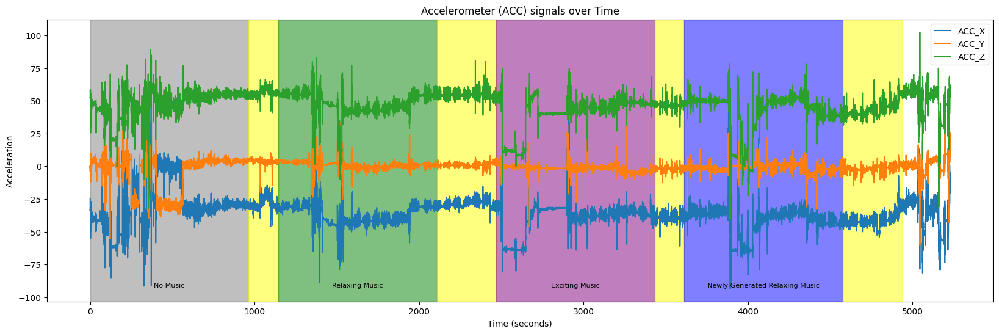

In [1463]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_accX = (right_ACC_df['ACC_X'] + left_ACC_df['ACC_X']) / 2
combined_accY = (right_ACC_df['ACC_Y'] + left_ACC_df['ACC_Y']) / 2
combined_accZ = (right_ACC_df['ACC_Z'] + left_ACC_df['ACC_Z']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_ACC_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_ACC_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_accX, label='ACC_X')
plt.plot(time_seconds, combined_accY, label='ACC_Y')
plt.plot(time_seconds, combined_accZ, label='ACC_Z')

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_accX), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Accelerometer (ACC) signals over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Acceleration')
plt.legend()
plt.grid(False)
plt.show()

## EG

The EEG signals recorded from the Muse headband are also included in the dataset as 'EEG_recording.csv'. They include EEG channels from four locations: TP9, AF7, AF8, and TP10. The 2016 model Muse (MU-02) can also output RAW EEG data at 256Hz as well as being able to output RAW EEG from the right ear USB Auxiliary connector (named Right AUX in the csv files). The column (timestamps) shows the data points in UNIX format. EEG measurements are labeled as TP9, AF7, AF8, TP10, Right AUX.

In [230]:
eeg_df=pd.read_csv(EEG_file)
eeg_df

,timestamps,TP9,AF7,AF8,TP10,Right AUX
0,1.625449e+09,5.371,35.156,45.410,5.859,30.762
1,1.625449e+09,-6.348,23.926,36.621,-6.836,64.453
2,1.625449e+09,-8.301,24.902,39.062,-4.883,89.844
3,1.625449e+09,-7.812,25.879,29.785,0.977,90.332
4,1.625449e+09,-8.789,22.949,26.367,-0.488,29.297
...,...,...,...,...,...,...
1426531,1.625455e+09,-971.191,-379.395,-151.367,-971.191,-523.926
1426532,1.625455e+09,-975.098,-338.379,-236.328,-971.191,-227.539
1426533,1.625455e+09,-954.102,-283.691,-129.883,-971.191,-32.227
1426534,1.625455e+09,-1000.000,-341.309,-149.902,-971.191,-523.438


C:\Users\user\AppData\Local\Temp\ipykernel_29192\2195272341.py:25: RuntimeWarning: divide by zero encountered in log10
  plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP9), shading='gouraud', cmap='viridis')


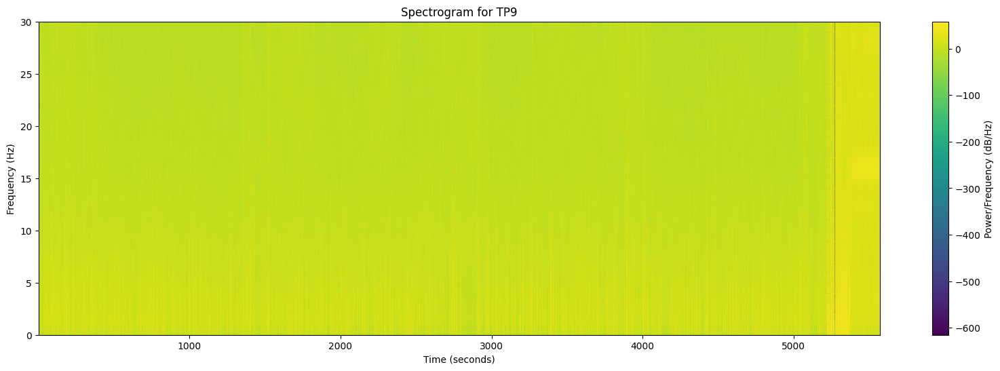

C:\Users\user\AppData\Local\Temp\ipykernel_29192\2195272341.py:35: RuntimeWarning: divide by zero encountered in log10
  plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap='viridis')


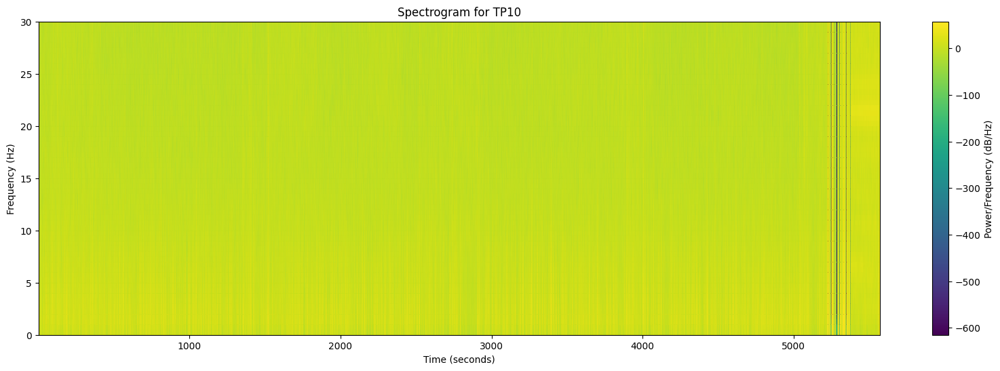

In [231]:
import matplotlib.pyplot as plt
from scipy import signal
# Extract the desired channels (TP9 and TP10)
channels = ['TP9', 'TP10']  
eeg_data = eeg_df[channels]

# Convert the timestamps to time in seconds
sampling_rate = 256  # Sampling rate of the EEG data in Hz
time_seconds = eeg_df['timestamps'] / sampling_rate

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 256    # Length of each segment
noverlap = 128   # Overlap between segments
nfft = 256       # Number of points for the FFT

# Compute the spectrogram for each channel
frequencies, times, spectrogram_TP9 = signal.spectrogram(eeg_data['TP9'], fs=sampling_rate, window=window, 
                                                         nperseg=nperseg, noverlap=noverlap, nfft=nfft)
_, _, spectrogram_TP10 = signal.spectrogram(eeg_data['TP10'], fs=sampling_rate, window=window, 
                                            nperseg=nperseg, noverlap=noverlap, nfft=nfft)

# Plot the spectrogram for TP9
plt.figure(figsize=(20, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP9), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP9')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
plt.show()

# Plot the spectrogram for TP10
plt.figure(figsize=(20, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP10')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
plt.show()

Text(0.5, 0, 'time (s)')

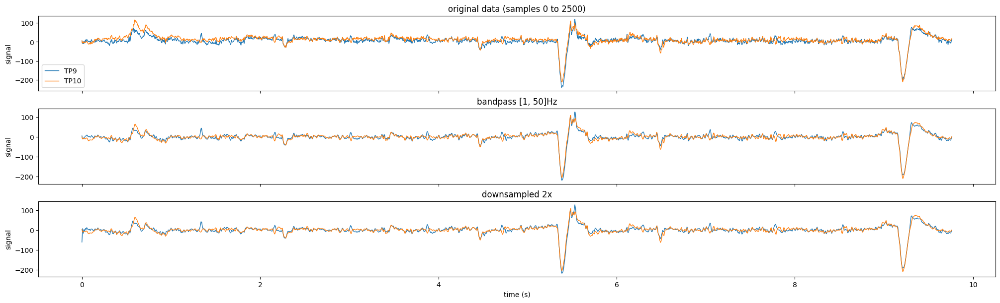

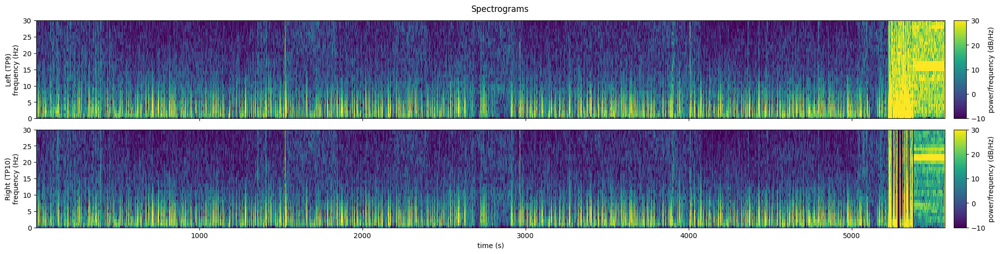

In [232]:
eeg_df['sample_number'] = range(len(eeg_df))
# Sampling rate of the EEG data in Hz
sampling_rate = 256  


# Convert the sample index to time in seconds
# This means you need to divide the sample *number* by the sampling rate
eeg_df['time_seconds'] = eeg_df['sample_number'] / sampling_rate

# Extract the desired channels (TP9 and TP10)
keep_channels = ['TP9', 'TP10']
eeg_data = eeg_df[keep_channels + ['time_seconds']].copy()

#
# Preprocess the EEG signals
#

#Define the pre-preprocessing parameters
downsample_factor = 2
bp_order = 4
bp_passband = [1, 50]
downsample_factor = 2

eeg_downsampled = pd.DataFrame()
downsampled_length = len(eeg_data) // downsample_factor

for channel in keep_channels:
    filtered_name = channel + '_bp'
    # Apply high-pass filter above 1 Hz and low-pass filter below 50 Hz
    b, a = signal.butter(bp_order, bp_passband, btype='bandpass', fs=sampling_rate)
    eeg_data[filtered_name] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample the signal from 256 to 128 Hz
    # Put the shorter signals in a new dataframe "eeg_downsampled"
    eeg_downsampled[channel] = signal.resample(eeg_data[filtered_name], downsampled_length)
eeg_downsampled['time_seconds'] = np.arange(downsampled_length) / (sampling_rate / downsample_factor)

#
# View the original and processed data
#
plot_height = 2
n_plots = 3
f, axs = plt.subplots(nrows=n_plots, ncols=1,
                      figsize=(20, plot_height * n_plots),
                      layout='constrained', sharex=True)

plot_slice = slice(0, 2500) #window of data to plot

#Original data
eeg_data[plot_slice].plot(
    y=keep_channels, x='time_seconds',
    ylabel='signal', xlabel='time (s)',
    linewidth=1, ax=axs[0],
    title=f'original data (samples {plot_slice.start} to {plot_slice.stop})'
)

#Filtered
eeg_data[plot_slice].plot(
    y=[chan + '_bp' for chan in keep_channels], x='time_seconds',
    ylabel='signal', xlabel='time (s)', legend=False,
    linewidth=1, ax=axs[1], title=f'bandpass {bp_passband}Hz'
)

#Downsampled
eeg_downsampled[plot_slice.start:plot_slice.stop//downsample_factor].plot(
    y=keep_channels, x='time_seconds',
    ylabel='signal', xlabel='time (s)', legend=False,
    linewidth=1, ax=axs[2], title=f'downsampled {downsample_factor}x'
)

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 128    # Length of each segment
noverlap = 64    # Overlap between segments
nfft = 128       # Number of points for the FFT

# Compute the spectrogram for each channel
spectrograms = {}
for channel in keep_channels:
    frequencies, times, spectrogram = signal.spectrogram(
        eeg_downsampled[channel],
        fs=sampling_rate / downsample_factor,
        window=window, nperseg=nperseg, noverlap=noverlap, nfft=nfft
    )
    spectrograms[channel] = spectrogram

# Plot the spectrograms
f, axs = plt.subplots(nrows=2, ncols=1, figsize=(20, 5),
                      layout='constrained', sharex=True)
f.suptitle('Spectrograms')
vmin, vmax = -10, 30

for channel, ax in zip(keep_channels, axs):
    im = ax.pcolormesh(
        times, frequencies, 10 * np.log10(spectrograms[channel]),
        vmin=vmin, vmax=vmax, #comment out for auto-range
        shading='nearest', cmap='viridis'
    )
    
    ax.set_ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
    ax.set_ylabel(('Left' if channel=='TP9' else 'Right') + f' ({channel})\nfrequency (Hz)')
    
    cbar = f.colorbar(im, aspect=8, pad=0.01, label='power/frequency (dB/Hz)')
    
ax.set_xlabel('time (s)')

### Beta Band Frequency

C:\Users\user\AppData\Local\Temp\ipykernel_29192\2331215207.py:79: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")
C:\Users\user\AppData\Local\Temp\ipykernel_29192\2331215207.py:79: UserWarning: 

The `join` parameter is deprecated and will be removed in v0.15.0.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")


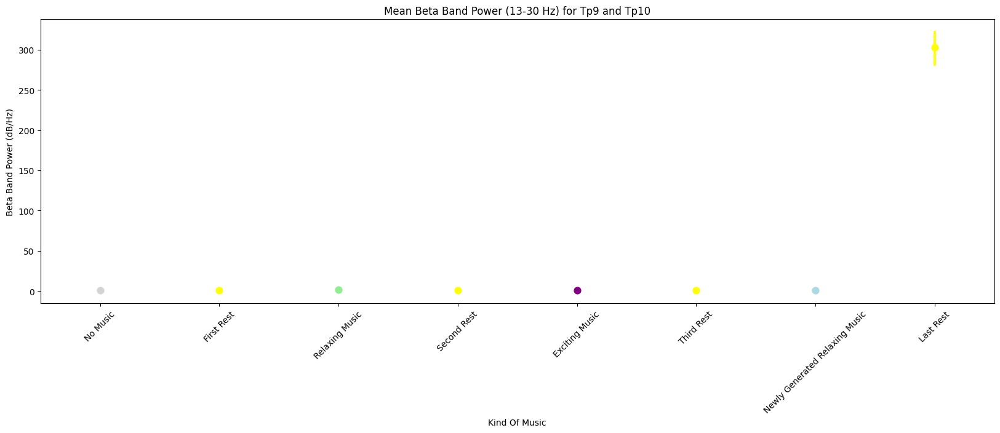

In [233]:
# Sample EEG DataFrame
# Assuming you have an EEG DataFrame named eeg_df with columns 'TP9' and 'TP10'

# Preprocessing parameters
sampling_rate = 256
downsample_factor = 2
bp_order = 4
bp_passband = [1, 50]

# Apply preprocessing and downsampling
eeg_df['sample_number'] = range(len(eeg_df))
eeg_df['time_seconds'] = eeg_df['sample_number'] / sampling_rate

eeg_data = eeg_df[['TP9', 'TP10', 'time_seconds']].copy()

eeg_downsampled = pd.DataFrame()
downsampled_length = len(eeg_data) // downsample_factor

for channel in ['TP9', 'TP10']:
    filtered_name = channel + '_bp'
    # Apply bandpass filter
    b, a = signal.butter(bp_order, bp_passband, btype='bandpass', fs=sampling_rate)
    eeg_data[filtered_name] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample
    eeg_downsampled[channel] = signal.resample(eeg_data[filtered_name], downsampled_length)

eeg_downsampled['time_seconds'] = np.arange(downsampled_length) / (sampling_rate / downsample_factor)

# Compute spectrogram for each channel
frequencies, times, spectrogram_tp9 = signal.spectrogram(
    eeg_downsampled['TP9'],
    fs=sampling_rate / downsample_factor,
    window='hann', nperseg=128, noverlap=64, nfft=128
)

_, _, spectrogram_tp10 = signal.spectrogram(
    eeg_downsampled['TP10'],
    fs=sampling_rate / downsample_factor,
    window='hann', nperseg=128, noverlap=64, nfft=128
)

# Compute beta band power (13-30 Hz) for each channel
beta_band_power_tp9 = np.mean(spectrogram_tp9[(frequencies >= 13) & (frequencies <= 30)], axis=0)
beta_band_power_tp10 = np.mean(spectrogram_tp10[(frequencies >= 13) & (frequencies <= 30)], axis=0)

# Compute mean beta band power across channels
mean_beta_band_power = (beta_band_power_tp9 + beta_band_power_tp10) / 2

# Define intervals and corresponding labels
intervals = [
    (0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
    (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                            964 + 180 + 964 + 360 + 964 + 180),
    (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
    (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)
]
labels = ['No Music', 'First Rest', 'Relaxing Music', 'Second Rest', 'Exciting Music', 'Third Rest',
          'Newly Generated Relaxing Music', 'Last Rest']

# Assign labels to each data point based on intervals
beta_power_df = pd.DataFrame({'Time': times, 'Power': mean_beta_band_power})
beta_power_df['Kind Of Music'] = pd.cut(beta_power_df['Time'], bins=[interval[0] for interval in intervals] + [np.inf], labels=labels)

# Define color palette dictionary
color_palette = {
    'No Music': 'lightgray',
    'First Rest': 'yellow',
    'Relaxing Music': 'lightgreen',
    'Second Rest': 'yellow',
    'Exciting Music': 'purple',
    'Third Rest': 'yellow',
    'Newly Generated Relaxing Music': 'lightblue',
    'Last Rest': 'yellow'
}

# Plot
plt.figure(figsize=(20, 6))
sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")
plt.title('Mean Beta Band Power (13-30 Hz) for Tp9 and Tp10')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Kind Of Music')
plt.xticks(rotation=45)
plt.show()

C:\Users\user\AppData\Local\Temp\ipykernel_29192\3532274209.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette)


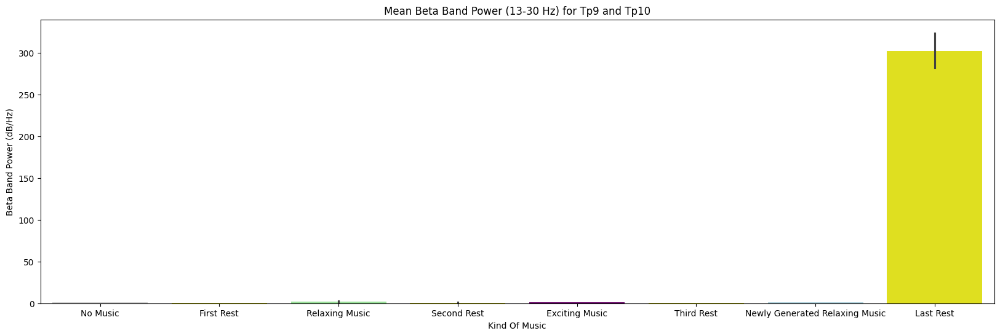

In [234]:
# Apply color palette for the bar plot
color_palette = {
    'No Music': 'lightgray',
    'First Rest': 'yellow',
    'Relaxing Music': 'lightgreen',
    'Second Rest': 'yellow',
    'Exciting Music': 'purple',
    'Third Rest': 'yellow',
    'Newly Generated Relaxing Music': 'lightblue',
    'Last Rest': 'yellow'
}

# Generate the bar plot
plt.figure(figsize=(20, 6))
sns.barplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette)
plt.title('Mean Beta Band Power (13-30 Hz) for Tp9 and Tp10')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Kind Of Music')
plt.show()

# Patient A7

In [235]:
# Define the file paths for the A7 data files
EEG_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A7\EEG_recording.csv'
Left_ACC_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A7\Left_ACC.csv'
Left_BVP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A7\Left_BVP.csv'
Left_EDA_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A7\Left_EDA.csv'
Left_HR_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A7\Left_HR.csv'
Left_IBI_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A7\Left_IBI.csv'
Left_tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A7\Left_tags.csv'
Left_TEMP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A7\Left_TEMP.csv'
n_back_responses_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A7\n_back_responses.csv'
Right_ACC_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A7\Right_ACC.csv'
Right_BVP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A7\Right_BVP.csv'
Right_EDA_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A7\Right_EDA.csv'
Right_HR_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A7\Right_HR.csv'
Right_IBI_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A7\Right_IBI.csv'
Right_tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A7\Right_tags.csv'
Right_TEMP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A7\Right_TEMP.csv'
tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A7\tags.csv'

## n back responses

In [1471]:
n_backr_df=pd.read_csv(n_back_responses_file)
n_backr_df

,ExperimentName,Start_time_unix,Subject,Session,DataFile.Basename,Display.RefreshRate,ExperimentVersion,Group,InstructionNewMusic.DEVICE,InstructionNoMusic.DEVICE,...,TrialList8.Cycle,TrialList8.Sample,TSO,TSTh,TSvO,TSvTh,TSxO,TSxTh,TTO,TTTh
0,Experiment_1,1629792913,14,1,Experiment_1-14-1,75.029,1.0.0.252,1,Chronos,Chronos,...,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Experiment_1,1629792913,14,1,Experiment_1-14-1,75.029,1.0.0.252,1,Chronos,Chronos,...,1.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Experiment_1,1629792913,14,1,Experiment_1-14-1,75.029,1.0.0.252,1,Chronos,Chronos,...,1.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Experiment_1,1629792913,14,1,Experiment_1-14-1,75.029,1.0.0.252,1,Chronos,Chronos,...,1.0,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Experiment_1,1629792913,14,1,Experiment_1-14-1,75.029,1.0.0.252,1,Chronos,Chronos,...,1.0,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,Experiment_1,1629792913,14,1,Experiment_1-14-1,75.029,1.0.0.252,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1452,Experiment_1,1629792913,14,1,Experiment_1-14-1,75.029,1.0.0.252,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1453,Experiment_1,1629792913,14,1,Experiment_1-14-1,75.029,1.0.0.252,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1454,Experiment_1,1629792913,14,1,Experiment_1-14-1,75.029,1.0.0.252,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1472]:
n_backr_df.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 250 columns):
 #    Column                                   Non-Null Count  Dtype  
---   ------                                   --------------  -----  
 0    ExperimentName                           1456 non-null   object 
 1    Start_time_unix                          1456 non-null   int64  
 2    Subject                                  1456 non-null   int64  
 3    Session                                  1456 non-null   int64  
 4    DataFile.Basename                        1456 non-null   object 
 5    Display.RefreshRate                      1456 non-null   float64
 6    ExperimentVersion                        1456 non-null   object 
 7    Group                                    1456 non-null   int64  
 8    InstructionNewMusic.DEVICE               1456 non-null   object 
 9    InstructionNoMusic.DEVICE                1456 non-null   object 
 10   InstructionNoMusic.DurationError  

In [1473]:
df_length=len(n_backr_df)

In [1474]:
# Filter columns with length 1456
non_null_columns = [col for col in n_backr_df.columns if n_backr_df[col].notnull().all()]
# Create a new DataFrame with only columns of the same length as the DataFrame
complete_df = n_backr_df[non_null_columns]
complete_df

,ExperimentName,Start_time_unix,Subject,Session,DataFile.Basename,Display.RefreshRate,ExperimentVersion,Group,InstructionNewMusic.DEVICE,InstructionNoMusic.DEVICE,...,Welcome.DurationError,Welcome.OnsetDelay,Welcome.OnsetTime,Welcome.OnsetToOnsetTime,Block,Instruction,ListName,Procedure[Block],Running[Block],Trigger
0,Experiment_1,1629792913,14,1,Experiment_1-14-1,75.029,1.0.0.252,1,Chronos,Chronos,...,-999999,33,25864,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
1,Experiment_1,1629792913,14,1,Experiment_1-14-1,75.029,1.0.0.252,1,Chronos,Chronos,...,-999999,33,25864,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
2,Experiment_1,1629792913,14,1,Experiment_1-14-1,75.029,1.0.0.252,1,Chronos,Chronos,...,-999999,33,25864,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
3,Experiment_1,1629792913,14,1,Experiment_1-14-1,75.029,1.0.0.252,1,Chronos,Chronos,...,-999999,33,25864,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
4,Experiment_1,1629792913,14,1,Experiment_1-14-1,75.029,1.0.0.252,1,Chronos,Chronos,...,-999999,33,25864,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,Experiment_1,1629792913,14,1,Experiment_1-14-1,75.029,1.0.0.252,1,Chronos,Chronos,...,-999999,33,25864,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1452,Experiment_1,1629792913,14,1,Experiment_1-14-1,75.029,1.0.0.252,1,Chronos,Chronos,...,-999999,33,25864,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1453,Experiment_1,1629792913,14,1,Experiment_1-14-1,75.029,1.0.0.252,1,Chronos,Chronos,...,-999999,33,25864,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1454,Experiment_1,1629792913,14,1,Experiment_1-14-1,75.029,1.0.0.252,1,Chronos,Chronos,...,-999999,33,25864,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2


### Instruction

In [1475]:
instruction = n_backr_df.columns
instruction[instruction.str.contains('Instruction')]
#.str.contains('SNOMED')]

Index(['InstructionNewMusic.DEVICE', 'InstructionNoMusic.DEVICE',
       'InstructionNoMusic.DurationError', 'InstructionNoMusic.OnsetDelay',
       'InstructionNoMusic.OnsetTime', 'InstructionNoMusic.OnsetToOnsetTime',
       'InstructionRelaxMusic.DEVICE', 'InstructionRelaxMusic.DurationError',
       'InstructionRelaxMusic.OnsetDelay', 'InstructionRelaxMusic.OnsetTime',
       'InstructionRelaxMusic.OnsetToOnsetTime',
       'InstructionStressMusic.DEVICE', 'InstructionStressMusic.DurationError',
       'InstructionStressMusic.OnsetDelay', 'InstructionStressMusic.OnsetTime',
       'InstructionStressMusic.OnsetToOnsetTime', 'Instruction'],
      dtype='object')

In [1476]:
instruction_df=n_backr_df[instruction[instruction.str.contains('Instruction')]]

### Stimulus

In [1477]:
stimulus = n_backr_df.columns
stimulus=stimulus[stimulus.str.contains('Stimulus')]

In [1478]:
stimulus

Index(['Stimulus100.ACC', 'Stimulus100.CRESP', 'Stimulus100.DEVICE',
       'Stimulus100.DurationError', 'Stimulus100.OnsetDelay',
       'Stimulus100.OnsetTime', 'Stimulus100.OnsetToOnsetTime',
       'Stimulus100.RESP', 'Stimulus100.RT', 'Stimulus100.RTTime',
       'Stimulus101.ACC', 'Stimulus101.CRESP', 'Stimulus101.DEVICE',
       'Stimulus101.DurationError', 'Stimulus101.OnsetDelay',
       'Stimulus101.OnsetTime', 'Stimulus101.OnsetToOnsetTime',
       'Stimulus101.RESP', 'Stimulus101.RT', 'Stimulus101.RTTime',
       'Stimulus102.ACC', 'Stimulus102.CRESP', 'Stimulus102.DEVICE',
       'Stimulus102.DurationError', 'Stimulus102.OnsetDelay',
       'Stimulus102.OnsetTime', 'Stimulus102.OnsetToOnsetTime',
       'Stimulus102.RESP', 'Stimulus102.RT', 'Stimulus102.RTTime',
       'Stimulus103.ACC', 'Stimulus103.CRESP', 'Stimulus103.DEVICE',
       'Stimulus103.DurationError', 'Stimulus103.OnsetDelay',
       'Stimulus103.OnsetTime', 'Stimulus103.OnsetToOnsetTime',
       'Stimulus103

In [1479]:
# Create a dictionary to store the mapping of columns to Running[Block] values
column_to_block = {}
running_block_values=n_backr_df['Running[Block]'].unique()
# Create a dictionary to store the mapping of stimulus columns to lists of Running[Block] values

stimulus_to_blocks = {}

# Iterate over each stimulus column
for col in stimulus:
    # Store all 4 Running[Block] values as a list for this stimulus column
    stimulus_to_blocks[col] = running_block_values

print(stimulus_to_blocks)

{'Stimulus100.ACC': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.CRESP': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.DEVICE': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.DurationError': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetDelay': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetTime': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetToOnsetTime': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.RESP': array(['PracticeSessi

In [1480]:
# Create a new dictionary to store the suffixed keys and values
suffixed_dict = {}

# Iterate over each key in stimulus_to_blocks dictionary
for key, values in stimulus_to_blocks.items():
    # Get the prefix (e.g., 'Stimulus100') from the key
    prefix = key.split('.')[0]
    
    # Create a list to store the suffixed column names
    suffixed_columns = []
    
    # Iterate over each column name in stimulus_columns
    for col in stimulus:
        # If the column name starts with the same prefix
        if col.startswith(prefix):
            # Append the suffixed column name to the list
            suffixed_columns.append(col)
    
    # Create the suffixed key by joining the prefix with ':'
    suffixed_key = f'{prefix}:'
    
    # Add the suffixed column names list as the value for the suffixed key
    suffixed_dict[suffixed_key] = suffixed_columns

print(suffixed_dict)

{'Stimulus100:': ['Stimulus100.ACC', 'Stimulus100.CRESP', 'Stimulus100.DEVICE', 'Stimulus100.DurationError', 'Stimulus100.OnsetDelay', 'Stimulus100.OnsetTime', 'Stimulus100.OnsetToOnsetTime', 'Stimulus100.RESP', 'Stimulus100.RT', 'Stimulus100.RTTime'], 'Stimulus101:': ['Stimulus101.ACC', 'Stimulus101.CRESP', 'Stimulus101.DEVICE', 'Stimulus101.DurationError', 'Stimulus101.OnsetDelay', 'Stimulus101.OnsetTime', 'Stimulus101.OnsetToOnsetTime', 'Stimulus101.RESP', 'Stimulus101.RT', 'Stimulus101.RTTime'], 'Stimulus102:': ['Stimulus102.ACC', 'Stimulus102.CRESP', 'Stimulus102.DEVICE', 'Stimulus102.DurationError', 'Stimulus102.OnsetDelay', 'Stimulus102.OnsetTime', 'Stimulus102.OnsetToOnsetTime', 'Stimulus102.RESP', 'Stimulus102.RT', 'Stimulus102.RTTime'], 'Stimulus103:': ['Stimulus103.ACC', 'Stimulus103.CRESP', 'Stimulus103.DEVICE', 'Stimulus103.DurationError', 'Stimulus103.OnsetDelay', 'Stimulus103.OnsetTime', 'Stimulus103.OnsetToOnsetTime', 'Stimulus103.RESP', 'Stimulus103.RT', 'Stimulus103.R

#### Stimulus Table 100

In [1481]:
# Filter columns that start with 'Stimulus100'
stimulus100_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus100')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
stimulus100_df=n_backr_df[stimulus100_columns]
stimulus100_df

,Stimulus100.ACC,Stimulus100.CRESP,Stimulus100.DEVICE,Stimulus100.DurationError,Stimulus100.OnsetDelay,Stimulus100.OnsetTime,Stimulus100.OnsetToOnsetTime,Stimulus100.RESP,Stimulus100.RT,Stimulus100.RTTime,Running[Block]
0,0.0,3.0,Chronos,1.0,-2.0,404346.0,507.0,NaN,0.0,0.0,PracticeSession
1,0.0,3.0,Chronos,1.0,19.0,406372.0,506.0,NaN,0.0,0.0,PracticeSession
2,0.0,3.0,Chronos,2.0,20.0,408398.0,506.0,NaN,0.0,0.0,PracticeSession
3,0.0,4.0,Chronos,1.0,20.0,410424.0,506.0,NaN,0.0,0.0,PracticeSession
4,0.0,4.0,Chronos,1.0,20.0,412450.0,506.0,NaN,0.0,0.0,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 101

In [1482]:
# Filter columns that start with 'Stimulus100'
stimulus101_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus101')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus101_df=n_backr_df[stimulus101_columns]
stimulus101_df

,Stimulus101.ACC,Stimulus101.CRESP,Stimulus101.DEVICE,Stimulus101.DurationError,Stimulus101.OnsetDelay,Stimulus101.OnsetTime,Stimulus101.OnsetToOnsetTime,Stimulus101.RESP,Stimulus101.RT,Stimulus101.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 102

In [1483]:
# Filter columns that start with 'Stimulus100'
stimulus102_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus102')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus102_df=n_backr_df[stimulus102_columns]
stimulus102_df

,Stimulus102.ACC,Stimulus102.CRESP,Stimulus102.DEVICE,Stimulus102.DurationError,Stimulus102.OnsetDelay,Stimulus102.OnsetTime,Stimulus102.OnsetToOnsetTime,Stimulus102.RESP,Stimulus102.RT,Stimulus102.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 103

In [1484]:
# Filter columns that start with 'Stimulus100'
stimulus103_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus103')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus103_df=n_backr_df[stimulus103_columns]
stimulus103_df

,Stimulus103.ACC,Stimulus103.CRESP,Stimulus103.DEVICE,Stimulus103.DurationError,Stimulus103.OnsetDelay,Stimulus103.OnsetTime,Stimulus103.OnsetToOnsetTime,Stimulus103.RESP,Stimulus103.RT,Stimulus103.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 104

In [1485]:
# Filter columns that start with 'Stimulus100'
stimulus104_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus104')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus104_df=n_backr_df[stimulus104_columns]
stimulus104_df

,Stimulus104.ACC,Stimulus104.CRESP,Stimulus104.DEVICE,Stimulus104.DurationError,Stimulus104.OnsetDelay,Stimulus104.OnsetTime,Stimulus104.OnsetToOnsetTime,Stimulus104.RESP,Stimulus104.RT,Stimulus104.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,1.0,3.0,Chronos,1.0,20.0,5063835.0,0.0,3.0,312.0,5064147.0,NewMusicSession
1452,1.0,3.0,Chronos,1.0,19.0,5065674.0,0.0,3.0,268.0,5065942.0,NewMusicSession
1453,1.0,3.0,Chronos,2.0,19.0,5067473.0,0.0,3.0,389.0,5067862.0,NewMusicSession
1454,0.0,4.0,Chronos,2.0,6.0,5069379.0,0.0,3.0,267.0,5069646.0,NewMusicSession


### Fixation

In [1486]:
n_back_columns = n_backr_df.columns
fixation=n_back_columns[n_back_columns.str.contains('Fixation')]

In [1487]:
fixation_df=n_backr_df[n_back_columns[n_back_columns.str.contains('Fixation')]]

In [1488]:
fixation_df

,Fixation100.ACC,Fixation100.CRESP,Fixation100.DEVICE,Fixation100.DurationError,Fixation100.OnsetDelay,Fixation100.OnsetTime,Fixation100.OnsetToOnsetTime,Fixation100.RESP,Fixation100.RT,Fixation100.RTTime,...,Fixation104.ACC,Fixation104.CRESP,Fixation104.DEVICE,Fixation104.DurationError,Fixation104.OnsetDelay,Fixation104.OnsetTime,Fixation104.OnsetToOnsetTime,Fixation104.RESP,Fixation104.RT,Fixation104.RTTime
0,0.0,3.0,Chronos,1.0,7.0,404853.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.0,3.0,Chronos,2.0,6.0,406878.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0.0,3.0,Chronos,2.0,6.0,408904.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0.0,4.0,Chronos,1.0,6.0,410930.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0.0,4.0,Chronos,1.0,6.0,412956.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,3.0,Chronos,1.0,8.0,5064155.0,0.0,NaN,0.0,0.0
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,3.0,Chronos,1.0,12.0,5065954.0,0.0,NaN,0.0,0.0
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,3.0,Chronos,1.0,11.0,5067873.0,0.0,3.0,186.0,5068059.0
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,4.0,Chronos,1.0,13.0,5069659.0,0.0,NaN,0.0,0.0


#### Fixation table 100

In [1489]:
# Filter columns that start with 'Fixation100'
fixation100_columns = [col for col in n_backr_df.columns if col.startswith('Fixation100')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation100_df=n_backr_df[fixation100_columns]
fixation100_df

,Fixation100.ACC,Fixation100.CRESP,Fixation100.DEVICE,Fixation100.DurationError,Fixation100.OnsetDelay,Fixation100.OnsetTime,Fixation100.OnsetToOnsetTime,Fixation100.RESP,Fixation100.RT,Fixation100.RTTime,Running[Block]
0,0.0,3.0,Chronos,1.0,7.0,404853.0,0.0,NaN,0.0,0.0,PracticeSession
1,0.0,3.0,Chronos,2.0,6.0,406878.0,0.0,NaN,0.0,0.0,PracticeSession
2,0.0,3.0,Chronos,2.0,6.0,408904.0,0.0,NaN,0.0,0.0,PracticeSession
3,0.0,4.0,Chronos,1.0,6.0,410930.0,0.0,NaN,0.0,0.0,PracticeSession
4,0.0,4.0,Chronos,1.0,6.0,412956.0,0.0,NaN,0.0,0.0,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 101

In [1490]:
# Filter columns that start with 'Fixation100'
fixation101_columns = [col for col in n_backr_df.columns if col.startswith('Fixation101')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation101_df=n_backr_df[fixation101_columns]
fixation101_df

,Fixation101.ACC,Fixation101.CRESP,Fixation101.DEVICE,Fixation101.DurationError,Fixation101.OnsetDelay,Fixation101.OnsetTime,Fixation101.OnsetToOnsetTime,Fixation101.RESP,Fixation101.RT,Fixation101.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 102

In [1491]:
# Filter columns that start with 'Fixation100'
fixation102_columns = [col for col in n_backr_df.columns if col.startswith('Fixation102')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation102_df=n_backr_df[fixation102_columns]
fixation102_df

,Fixation102.ACC,Fixation102.CRESP,Fixation102.DEVICE,Fixation102.DurationError,Fixation102.OnsetDelay,Fixation102.OnsetTime,Fixation102.OnsetToOnsetTime,Fixation102.RESP,Fixation102.RT,Fixation102.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 103

In [1492]:
# Filter columns that start with 'Fixation100'
fixation103_columns = [col for col in n_backr_df.columns if col.startswith('Fixation103')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation103_df=n_backr_df[fixation103_columns]
fixation103_df

,Fixation103.ACC,Fixation103.CRESP,Fixation103.DEVICE,Fixation103.DurationError,Fixation103.OnsetDelay,Fixation103.OnsetTime,Fixation103.OnsetToOnsetTime,Fixation103.RESP,Fixation103.RT,Fixation103.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 104

In [1493]:
# Filter columns that start with 'Fixation100'
fixation104_columns = [col for col in n_backr_df.columns if col.startswith('Fixation104')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation104_df=n_backr_df[fixation104_columns]
fixation104_df

,Fixation104.ACC,Fixation104.CRESP,Fixation104.DEVICE,Fixation104.DurationError,Fixation104.OnsetDelay,Fixation104.OnsetTime,Fixation104.OnsetToOnsetTime,Fixation104.RESP,Fixation104.RT,Fixation104.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,0.0,3.0,Chronos,1.0,8.0,5064155.0,0.0,NaN,0.0,0.0,NewMusicSession
1452,0.0,3.0,Chronos,1.0,12.0,5065954.0,0.0,NaN,0.0,0.0,NewMusicSession
1453,1.0,3.0,Chronos,1.0,11.0,5067873.0,0.0,3.0,186.0,5068059.0,NewMusicSession
1454,0.0,4.0,Chronos,1.0,13.0,5069659.0,0.0,NaN,0.0,0.0,NewMusicSession


## Empatica

### EDA
- EDA: Measurements from the electrodermal activity (EDA) sensor expressed as micro siemens (μS). Values in the first column (EDA) show the EDA values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1494]:
left_eda_df=pd.read_csv(Left_EDA_file)
left_eda_df

,EDA,start_time_unix,sampling_rate
0,0.000000,1.629793e+09,4.0
1,0.156332,1.629793e+09,4.0
2,0.213995,1.629793e+09,4.0
3,0.215277,1.629793e+09,4.0
4,0.217839,1.629793e+09,4.0
...,...,...,...
21199,0.189648,1.629793e+09,4.0
21200,0.189648,1.629793e+09,4.0
21201,0.190930,1.629793e+09,4.0
21202,0.192211,1.629793e+09,4.0


In [1495]:
right_eda_df=pd.read_csv(Right_EDA_file)
right_eda_df

,EDA,start_time_unix,sampling_rate
0,0.000000,1.629793e+09,4.0
1,0.119106,1.629793e+09,4.0
2,0.175458,1.629793e+09,4.0
3,0.175458,1.629793e+09,4.0
4,0.176739,1.629793e+09,4.0
...,...,...,...
21199,0.229248,1.629793e+09,4.0
21200,0.229248,1.629793e+09,4.0
21201,0.229248,1.629793e+09,4.0
21202,0.234371,1.629793e+09,4.0


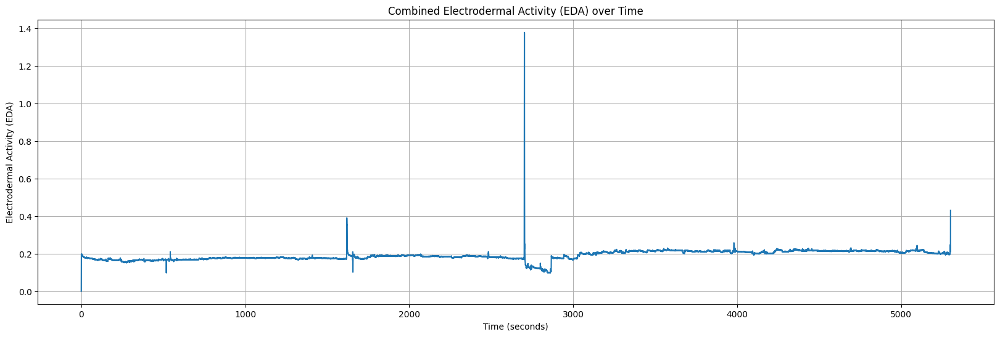

In [1496]:
# Combine the two EDA signals by taking the average
combined_eda = (right_eda_df['EDA'] + left_eda_df['EDA']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_eda_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_eda_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_eda)
plt.title('Combined Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(True)
plt.show()

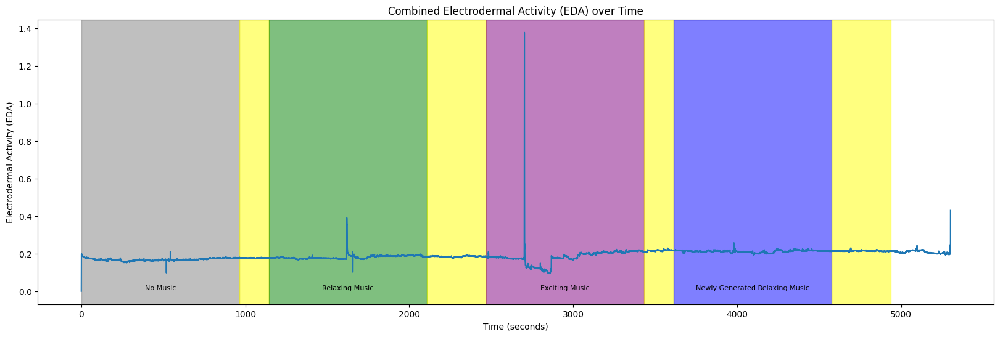

In [1497]:
import matplotlib.pyplot as plt


# Combine the two EDA signals by taking the average
combined_eda = (right_eda_df['EDA'] + left_eda_df['EDA']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_eda_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_eda_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_eda)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_eda), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Combined Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(False)
plt.show()

### HR
- HR: Average heart rate (HR) extracted from the BVP signal. Values in the first column (HR) show the HR values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1498]:
left_hr_df=pd.read_csv(Left_HR_file)
left_hr_df

,HR,start_time_unix,sampling_rate
0,57.00,1.629793e+09,1.0
1,56.50,1.629793e+09,1.0
2,55.33,1.629793e+09,1.0
3,54.50,1.629793e+09,1.0
4,54.00,1.629793e+09,1.0
...,...,...,...
5286,54.98,1.629793e+09,1.0
5287,54.83,1.629793e+09,1.0
5288,54.72,1.629793e+09,1.0
5289,54.63,1.629793e+09,1.0


In [1499]:
right_hr_df=pd.read_csv(Right_HR_file)
right_hr_df

,HR,start_time_unix,sampling_rate
0,57.00,1.629793e+09,1.0
1,57.00,1.629793e+09,1.0
2,56.00,1.629793e+09,1.0
3,55.25,1.629793e+09,1.0
4,54.80,1.629793e+09,1.0
...,...,...,...
5286,101.95,1.629793e+09,1.0
5287,101.58,1.629793e+09,1.0
5288,101.28,1.629793e+09,1.0
5289,100.92,1.629793e+09,1.0


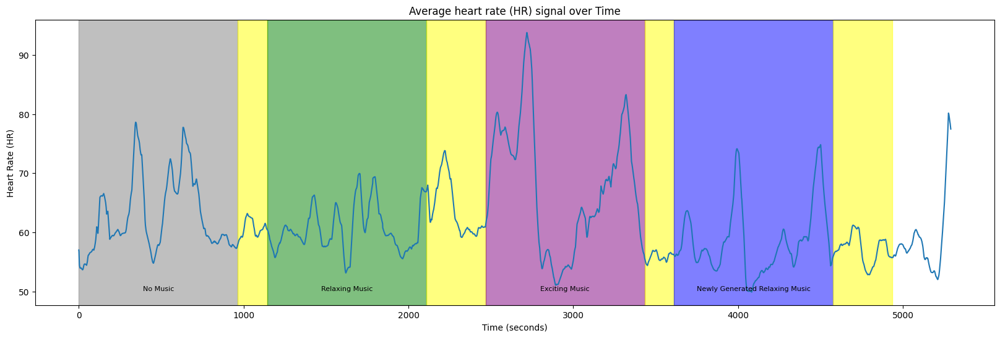

In [1500]:
import matplotlib.pyplot as plt


# Combine the two hr signals by taking the average
combined_hr = (right_hr_df['HR'] + left_hr_df['HR']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_hr_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_hr_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_hr)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_hr), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Average heart rate (HR) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Heart Rate (HR)')
plt.grid(False)
plt.show()

### BVP
- BVP: Blood volume pulses (BVP) measured from a photoplethysmograph. Values in the first column (BVP) show the BVP values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1501]:
left_bvp_df=pd.read_csv(Left_BVP_file)
left_bvp_df

,BVP,start_time_unix,sampling_rate
0,-0.00,1.629793e+09,64.0
1,-0.00,1.629793e+09,64.0
2,-0.00,1.629793e+09,64.0
3,-0.00,1.629793e+09,64.0
4,-0.00,1.629793e+09,64.0
...,...,...,...
339235,-47.60,1.629793e+09,64.0
339236,-52.24,1.629793e+09,64.0
339237,-56.82,1.629793e+09,64.0
339238,-62.20,1.629793e+09,64.0


In [1502]:
right_bvp_df=pd.read_csv(Right_BVP_file)
right_bvp_df

,BVP,start_time_unix,sampling_rate
0,-0.00,1.629793e+09,64.0
1,-0.00,1.629793e+09,64.0
2,-0.00,1.629793e+09,64.0
3,-0.00,1.629793e+09,64.0
4,-0.00,1.629793e+09,64.0
...,...,...,...
339235,-44.40,1.629793e+09,64.0
339236,-43.96,1.629793e+09,64.0
339237,-49.71,1.629793e+09,64.0
339238,-65.06,1.629793e+09,64.0


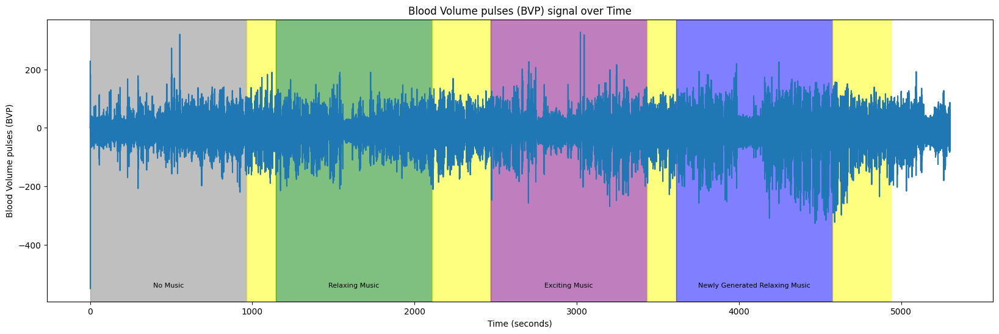

In [1503]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_bvp = (right_bvp_df['BVP'] + left_bvp_df['BVP']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_bvp_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_bvp_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_bvp)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_bvp), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Blood Volume pulses (BVP) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Blood Volume pulses (BVP)')
plt.grid(False)
plt.show()

### Temperature
- TEMP: Skin temperature (TEMP) measured from temperature sensor expressed degrees on the Celsius (°C) scale. Values in the first column (TEMP) show the TEMP values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1504]:
left_temp_df=pd.read_csv(Left_TEMP_file)
left_temp_df

,TEMP,start_time_unix,sampling_rate
0,31.21,1.629793e+09,4.0
1,31.21,1.629793e+09,4.0
2,31.21,1.629793e+09,4.0
3,31.21,1.629793e+09,4.0
4,31.21,1.629793e+09,4.0
...,...,...,...
21211,30.59,1.629793e+09,4.0
21212,30.61,1.629793e+09,4.0
21213,30.61,1.629793e+09,4.0
21214,30.61,1.629793e+09,4.0


In [1505]:
right_temp_df=pd.read_csv(Right_TEMP_file)
right_temp_df

,TEMP,start_time_unix,sampling_rate
0,31.51,1.629793e+09,4.0
1,31.51,1.629793e+09,4.0
2,31.51,1.629793e+09,4.0
3,31.51,1.629793e+09,4.0
4,31.51,1.629793e+09,4.0
...,...,...,...
21211,30.65,1.629793e+09,4.0
21212,30.67,1.629793e+09,4.0
21213,30.67,1.629793e+09,4.0
21214,30.67,1.629793e+09,4.0


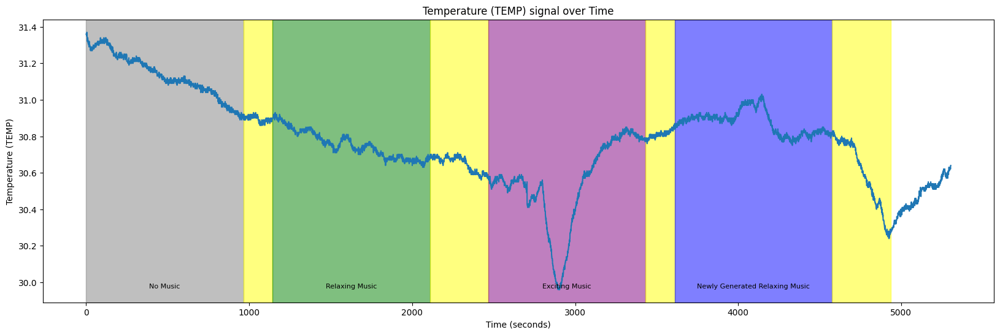

In [1506]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_temp = (right_temp_df['TEMP'] + left_temp_df['TEMP']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_temp_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_temp_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_temp)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_temp), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Temperature (TEMP) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Temperature (TEMP)')
plt.grid(False)
plt.show()

### ACC
- ACC: Data from 3-axis accelerometer sensor. The accelerometer is configured to measure acceleration in the range [-2g, 2g]. Therefore, the unit in this file is 1/64g. Data from x, y, and z axis are labeled respectively (i.e., ACC_X, ACC_Y, and ACC_Z).  The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1507]:
left_ACC_df=pd.read_csv(Left_ACC_file)
left_ACC_df

,ACC_X,ACC_Y,ACC_Z,start_time_unix,sampling_rate
0,-23,-10,60,1.629793e+09,32.0
1,-23,-11,60,1.629793e+09,32.0
2,-23,-10,60,1.629793e+09,32.0
3,-23,-10,60,1.629793e+09,32.0
4,-23,-10,60,1.629793e+09,32.0
...,...,...,...,...,...
169627,-6,-14,63,1.629793e+09,32.0
169628,-7,-13,63,1.629793e+09,32.0
169629,-6,-13,62,1.629793e+09,32.0
169630,-5,-14,63,1.629793e+09,32.0


In [1508]:
right_ACC_df=pd.read_csv(Right_ACC_file)
right_ACC_df

,ACC_X,ACC_Y,ACC_Z,start_time_unix,sampling_rate
0,-33,18,51,1.629793e+09,32.0
1,-33,18,51,1.629793e+09,32.0
2,-32,18,51,1.629793e+09,32.0
3,-33,18,51,1.629793e+09,32.0
4,-33,18,51,1.629793e+09,32.0
...,...,...,...,...,...
169627,-20,35,49,1.629793e+09,32.0
169628,-20,35,49,1.629793e+09,32.0
169629,-20,35,49,1.629793e+09,32.0
169630,-20,35,49,1.629793e+09,32.0


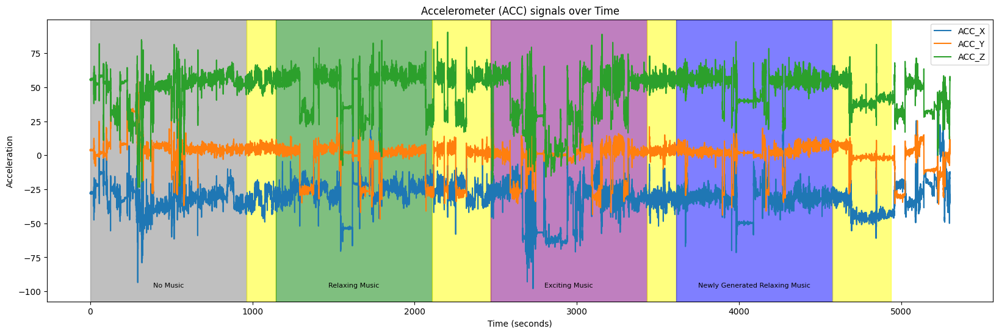

In [1509]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_accX = (right_ACC_df['ACC_X'] + left_ACC_df['ACC_X']) / 2
combined_accY = (right_ACC_df['ACC_Y'] + left_ACC_df['ACC_Y']) / 2
combined_accZ = (right_ACC_df['ACC_Z'] + left_ACC_df['ACC_Z']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_ACC_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_ACC_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_accX, label='ACC_X')
plt.plot(time_seconds, combined_accY, label='ACC_Y')
plt.plot(time_seconds, combined_accZ, label='ACC_Z')

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_accX), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Accelerometer (ACC) signals over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Acceleration')
plt.legend()
plt.grid(False)
plt.show()

## EG

The EEG signals recorded from the Muse headband are also included in the dataset as 'EEG_recording.csv'. They include EEG channels from four locations: TP9, AF7, AF8, and TP10. The 2016 model Muse (MU-02) can also output RAW EEG data at 256Hz as well as being able to output RAW EEG from the right ear USB Auxiliary connector (named Right AUX in the csv files). The column (timestamps) shows the data points in UNIX format. EEG measurements are labeled as TP9, AF7, AF8, TP10, Right AUX.

In [236]:
eeg_df=pd.read_csv(EEG_file)
eeg_df

,timestamps,TP9,AF7,AF8,TP10,Right AUX
0,1.629793e+09,18.555,38.574,9.766,16.602,39.551
1,1.629793e+09,22.461,48.340,7.812,19.043,4.883
2,1.629793e+09,20.508,44.434,30.273,19.531,-28.320
3,1.629793e+09,19.531,39.551,21.973,17.578,19.531
4,1.629793e+09,22.949,48.828,18.066,17.578,31.250
...,...,...,...,...,...,...
1362331,1.629798e+09,34.180,22.949,29.785,25.391,21.973
1362332,1.629798e+09,44.434,25.391,30.762,21.484,2.441
1362333,1.629798e+09,49.316,24.902,27.344,19.043,61.523
1362334,1.629798e+09,45.898,25.391,24.414,29.297,25.391


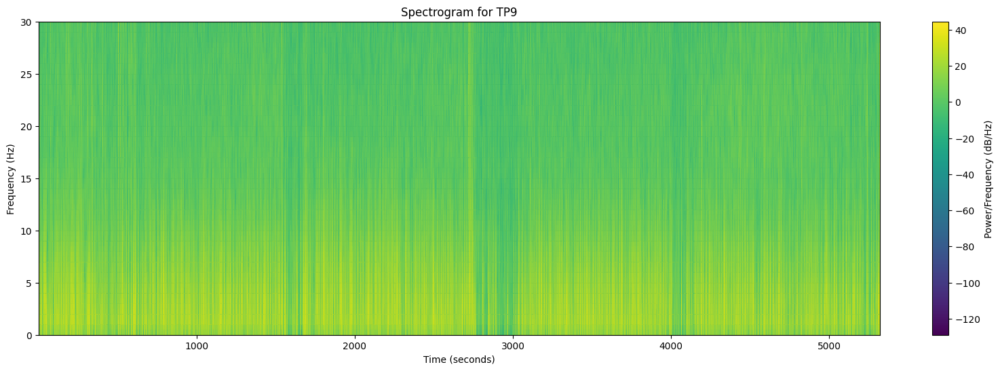

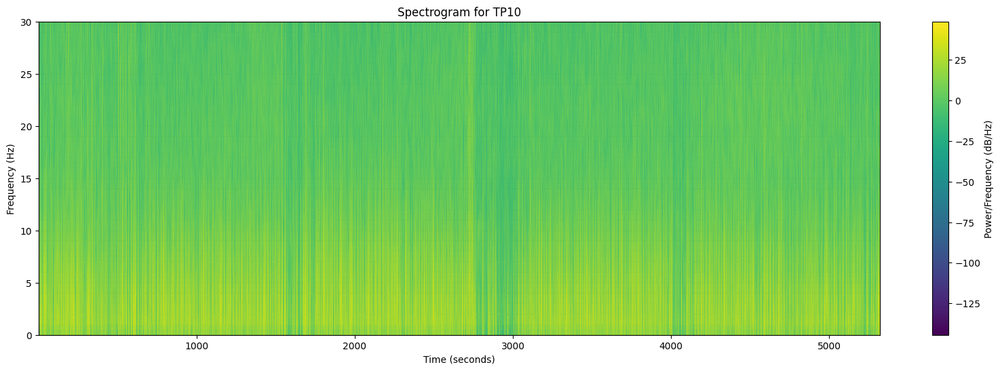

In [237]:
import matplotlib.pyplot as plt
from scipy import signal
# Extract the desired channels (TP9 and TP10)
channels = ['TP9', 'TP10']  
eeg_data = eeg_df[channels]

# Convert the timestamps to time in seconds
sampling_rate = 256  # Sampling rate of the EEG data in Hz
time_seconds = eeg_df['timestamps'] / sampling_rate

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 256    # Length of each segment
noverlap = 128   # Overlap between segments
nfft = 256       # Number of points for the FFT

# Compute the spectrogram for each channel
frequencies, times, spectrogram_TP9 = signal.spectrogram(eeg_data['TP9'], fs=sampling_rate, window=window, 
                                                         nperseg=nperseg, noverlap=noverlap, nfft=nfft)
_, _, spectrogram_TP10 = signal.spectrogram(eeg_data['TP10'], fs=sampling_rate, window=window, 
                                            nperseg=nperseg, noverlap=noverlap, nfft=nfft)

# Plot the spectrogram for TP9
plt.figure(figsize=(20, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP9), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP9')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
plt.show()

# Plot the spectrogram for TP10
plt.figure(figsize=(20, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP10')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
plt.show()

Text(0.5, 0, 'time (s)')

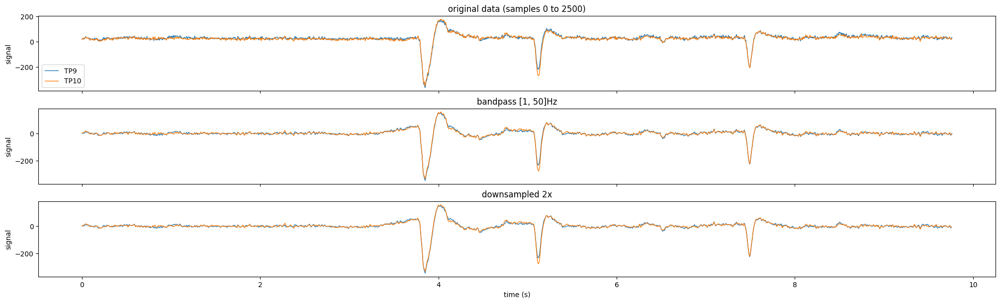

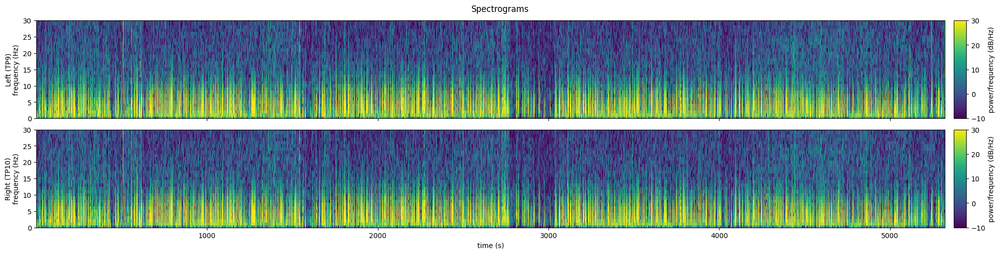

In [238]:
eeg_df['sample_number'] = range(len(eeg_df))
# Sampling rate of the EEG data in Hz
sampling_rate = 256  


# Convert the sample index to time in seconds
# This means you need to divide the sample *number* by the sampling rate
eeg_df['time_seconds'] = eeg_df['sample_number'] / sampling_rate

# Extract the desired channels (TP9 and TP10)
keep_channels = ['TP9', 'TP10']
eeg_data = eeg_df[keep_channels + ['time_seconds']].copy()

#
# Preprocess the EEG signals
#

#Define the pre-preprocessing parameters
downsample_factor = 2
bp_order = 4
bp_passband = [1, 50]
downsample_factor = 2

eeg_downsampled = pd.DataFrame()
downsampled_length = len(eeg_data) // downsample_factor

for channel in keep_channels:
    filtered_name = channel + '_bp'
    # Apply high-pass filter above 1 Hz and low-pass filter below 50 Hz
    b, a = signal.butter(bp_order, bp_passband, btype='bandpass', fs=sampling_rate)
    eeg_data[filtered_name] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample the signal from 256 to 128 Hz
    # Put the shorter signals in a new dataframe "eeg_downsampled"
    eeg_downsampled[channel] = signal.resample(eeg_data[filtered_name], downsampled_length)
eeg_downsampled['time_seconds'] = np.arange(downsampled_length) / (sampling_rate / downsample_factor)

#
# View the original and processed data
#
plot_height = 2
n_plots = 3
f, axs = plt.subplots(nrows=n_plots, ncols=1,
                      figsize=(20, plot_height * n_plots),
                      layout='constrained', sharex=True)

plot_slice = slice(0, 2500) #window of data to plot

#Original data
eeg_data[plot_slice].plot(
    y=keep_channels, x='time_seconds',
    ylabel='signal', xlabel='time (s)',
    linewidth=1, ax=axs[0],
    title=f'original data (samples {plot_slice.start} to {plot_slice.stop})'
)

#Filtered
eeg_data[plot_slice].plot(
    y=[chan + '_bp' for chan in keep_channels], x='time_seconds',
    ylabel='signal', xlabel='time (s)', legend=False,
    linewidth=1, ax=axs[1], title=f'bandpass {bp_passband}Hz'
)

#Downsampled
eeg_downsampled[plot_slice.start:plot_slice.stop//downsample_factor].plot(
    y=keep_channels, x='time_seconds',
    ylabel='signal', xlabel='time (s)', legend=False,
    linewidth=1, ax=axs[2], title=f'downsampled {downsample_factor}x'
)

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 128    # Length of each segment
noverlap = 64    # Overlap between segments
nfft = 128       # Number of points for the FFT

# Compute the spectrogram for each channel
spectrograms = {}
for channel in keep_channels:
    frequencies, times, spectrogram = signal.spectrogram(
        eeg_downsampled[channel],
        fs=sampling_rate / downsample_factor,
        window=window, nperseg=nperseg, noverlap=noverlap, nfft=nfft
    )
    spectrograms[channel] = spectrogram

# Plot the spectrograms
f, axs = plt.subplots(nrows=2, ncols=1, figsize=(20, 5),
                      layout='constrained', sharex=True)
f.suptitle('Spectrograms')
vmin, vmax = -10, 30

for channel, ax in zip(keep_channels, axs):
    im = ax.pcolormesh(
        times, frequencies, 10 * np.log10(spectrograms[channel]),
        vmin=vmin, vmax=vmax, #comment out for auto-range
        shading='nearest', cmap='viridis'
    )
    
    ax.set_ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
    ax.set_ylabel(('Left' if channel=='TP9' else 'Right') + f' ({channel})\nfrequency (Hz)')
    
    cbar = f.colorbar(im, aspect=8, pad=0.01, label='power/frequency (dB/Hz)')
    
ax.set_xlabel('time (s)')

### Beta Band Frequency

C:\Users\user\AppData\Local\Temp\ipykernel_29192\2331215207.py:79: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")
C:\Users\user\AppData\Local\Temp\ipykernel_29192\2331215207.py:79: UserWarning: 

The `join` parameter is deprecated and will be removed in v0.15.0.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")


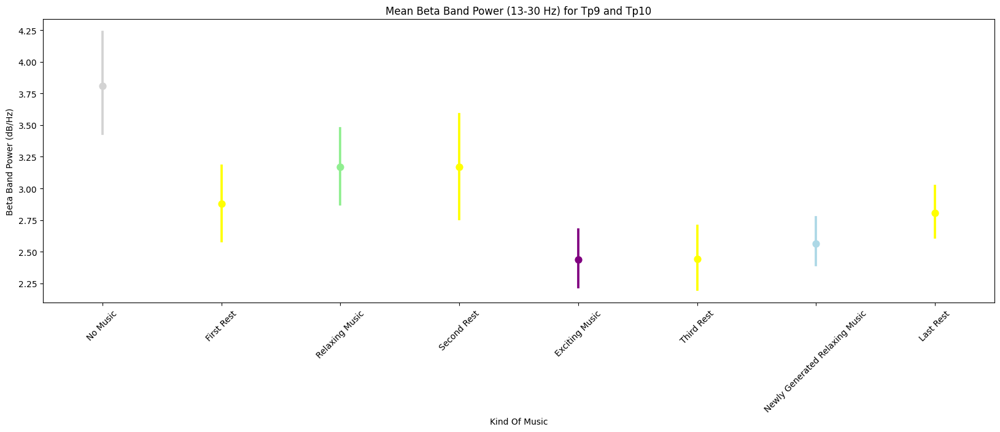

In [239]:
# Sample EEG DataFrame
# Assuming you have an EEG DataFrame named eeg_df with columns 'TP9' and 'TP10'

# Preprocessing parameters
sampling_rate = 256
downsample_factor = 2
bp_order = 4
bp_passband = [1, 50]

# Apply preprocessing and downsampling
eeg_df['sample_number'] = range(len(eeg_df))
eeg_df['time_seconds'] = eeg_df['sample_number'] / sampling_rate

eeg_data = eeg_df[['TP9', 'TP10', 'time_seconds']].copy()

eeg_downsampled = pd.DataFrame()
downsampled_length = len(eeg_data) // downsample_factor

for channel in ['TP9', 'TP10']:
    filtered_name = channel + '_bp'
    # Apply bandpass filter
    b, a = signal.butter(bp_order, bp_passband, btype='bandpass', fs=sampling_rate)
    eeg_data[filtered_name] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample
    eeg_downsampled[channel] = signal.resample(eeg_data[filtered_name], downsampled_length)

eeg_downsampled['time_seconds'] = np.arange(downsampled_length) / (sampling_rate / downsample_factor)

# Compute spectrogram for each channel
frequencies, times, spectrogram_tp9 = signal.spectrogram(
    eeg_downsampled['TP9'],
    fs=sampling_rate / downsample_factor,
    window='hann', nperseg=128, noverlap=64, nfft=128
)

_, _, spectrogram_tp10 = signal.spectrogram(
    eeg_downsampled['TP10'],
    fs=sampling_rate / downsample_factor,
    window='hann', nperseg=128, noverlap=64, nfft=128
)

# Compute beta band power (13-30 Hz) for each channel
beta_band_power_tp9 = np.mean(spectrogram_tp9[(frequencies >= 13) & (frequencies <= 30)], axis=0)
beta_band_power_tp10 = np.mean(spectrogram_tp10[(frequencies >= 13) & (frequencies <= 30)], axis=0)

# Compute mean beta band power across channels
mean_beta_band_power = (beta_band_power_tp9 + beta_band_power_tp10) / 2

# Define intervals and corresponding labels
intervals = [
    (0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
    (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                            964 + 180 + 964 + 360 + 964 + 180),
    (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
    (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)
]
labels = ['No Music', 'First Rest', 'Relaxing Music', 'Second Rest', 'Exciting Music', 'Third Rest',
          'Newly Generated Relaxing Music', 'Last Rest']

# Assign labels to each data point based on intervals
beta_power_df = pd.DataFrame({'Time': times, 'Power': mean_beta_band_power})
beta_power_df['Kind Of Music'] = pd.cut(beta_power_df['Time'], bins=[interval[0] for interval in intervals] + [np.inf], labels=labels)

# Define color palette dictionary
color_palette = {
    'No Music': 'lightgray',
    'First Rest': 'yellow',
    'Relaxing Music': 'lightgreen',
    'Second Rest': 'yellow',
    'Exciting Music': 'purple',
    'Third Rest': 'yellow',
    'Newly Generated Relaxing Music': 'lightblue',
    'Last Rest': 'yellow'
}

# Plot
plt.figure(figsize=(20, 6))
sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")
plt.title('Mean Beta Band Power (13-30 Hz) for Tp9 and Tp10')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Kind Of Music')
plt.xticks(rotation=45)
plt.show()

C:\Users\user\AppData\Local\Temp\ipykernel_29192\3532274209.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette)


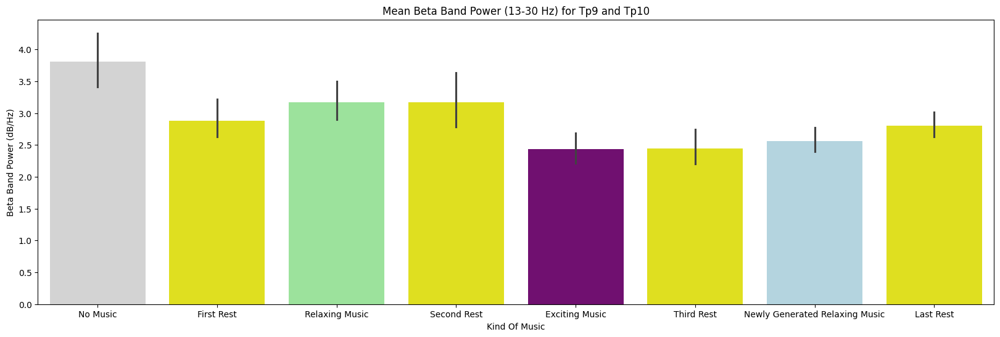

In [240]:
# Apply color palette for the bar plot
color_palette = {
    'No Music': 'lightgray',
    'First Rest': 'yellow',
    'Relaxing Music': 'lightgreen',
    'Second Rest': 'yellow',
    'Exciting Music': 'purple',
    'Third Rest': 'yellow',
    'Newly Generated Relaxing Music': 'lightblue',
    'Last Rest': 'yellow'
}

# Generate the bar plot
plt.figure(figsize=(20, 6))
sns.barplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette)
plt.title('Mean Beta Band Power (13-30 Hz) for Tp9 and Tp10')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Kind Of Music')
plt.show()

# Patient A8

In [241]:
# Define the file paths for the A8 data files
EEG_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A8\EEG_recording.csv'
Left_ACC_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A8\Left_ACC.csv'
Left_BVP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A8\Left_BVP.csv'
Left_EDA_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A8\Left_EDA.csv'
Left_HR_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A8\Left_HR.csv'
Left_IBI_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A8\Left_IBI.csv'
Left_tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A8\Left_tags.csv'
Left_TEMP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A8\Left_TEMP.csv'
n_back_responses_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A8\n_back_responses.csv'
Right_ACC_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A8\Right_ACC.csv'
Right_BVP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A8\Right_BVP.csv'
Right_EDA_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A8\Right_EDA.csv'
Right_HR_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A8\Right_HR.csv'
Right_IBI_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A8\Right_IBI.csv'
Right_tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A8\Right_tags.csv'
Right_TEMP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A8\Right_TEMP.csv'
tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A8\tags.csv'

## n back responses

In [1517]:
n_backr_df=pd.read_csv(n_back_responses_file)
n_backr_df

,ExperimentName,Start_time_unix,Subject,Session,DataFile.Basename,Display.RefreshRate,ExperimentVersion,Group,InstructionNewMusic.DEVICE,InstructionNoMusic.DEVICE,...,TrialList8.Cycle,TrialList8.Sample,TSO,TSTh,TSvO,TSvTh,TSxO,TSxTh,TTO,TTTh
0,Experiment_1,1634891729,19,1,Experiment_1-19-1,75.028,1.0.0.255,1,Chronos,Chronos,...,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Experiment_1,1634891729,19,1,Experiment_1-19-1,75.028,1.0.0.255,1,Chronos,Chronos,...,1.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Experiment_1,1634891729,19,1,Experiment_1-19-1,75.028,1.0.0.255,1,Chronos,Chronos,...,1.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Experiment_1,1634891729,19,1,Experiment_1-19-1,75.028,1.0.0.255,1,Chronos,Chronos,...,1.0,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Experiment_1,1634891729,19,1,Experiment_1-19-1,75.028,1.0.0.255,1,Chronos,Chronos,...,1.0,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,Experiment_1,1634891729,19,1,Experiment_1-19-1,75.028,1.0.0.255,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1452,Experiment_1,1634891729,19,1,Experiment_1-19-1,75.028,1.0.0.255,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1453,Experiment_1,1634891729,19,1,Experiment_1-19-1,75.028,1.0.0.255,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1454,Experiment_1,1634891729,19,1,Experiment_1-19-1,75.028,1.0.0.255,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1518]:
n_backr_df.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 250 columns):
 #    Column                                   Non-Null Count  Dtype  
---   ------                                   --------------  -----  
 0    ExperimentName                           1456 non-null   object 
 1    Start_time_unix                          1456 non-null   int64  
 2    Subject                                  1456 non-null   int64  
 3    Session                                  1456 non-null   int64  
 4    DataFile.Basename                        1456 non-null   object 
 5    Display.RefreshRate                      1456 non-null   float64
 6    ExperimentVersion                        1456 non-null   object 
 7    Group                                    1456 non-null   int64  
 8    InstructionNewMusic.DEVICE               1456 non-null   object 
 9    InstructionNoMusic.DEVICE                1456 non-null   object 
 10   InstructionNoMusic.DurationError  

In [1519]:
df_length=len(n_backr_df)

In [1520]:
# Filter columns with length 1456
non_null_columns = [col for col in n_backr_df.columns if n_backr_df[col].notnull().all()]
# Create a new DataFrame with only columns of the same length as the DataFrame
complete_df = n_backr_df[non_null_columns]
complete_df

,ExperimentName,Start_time_unix,Subject,Session,DataFile.Basename,Display.RefreshRate,ExperimentVersion,Group,InstructionNewMusic.DEVICE,InstructionNoMusic.DEVICE,...,Welcome.DurationError,Welcome.OnsetDelay,Welcome.OnsetTime,Welcome.OnsetToOnsetTime,Block,Instruction,ListName,Procedure[Block],Running[Block],Trigger
0,Experiment_1,1634891729,19,1,Experiment_1-19-1,75.028,1.0.0.255,1,Chronos,Chronos,...,-999999,20,14978,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
1,Experiment_1,1634891729,19,1,Experiment_1-19-1,75.028,1.0.0.255,1,Chronos,Chronos,...,-999999,20,14978,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
2,Experiment_1,1634891729,19,1,Experiment_1-19-1,75.028,1.0.0.255,1,Chronos,Chronos,...,-999999,20,14978,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
3,Experiment_1,1634891729,19,1,Experiment_1-19-1,75.028,1.0.0.255,1,Chronos,Chronos,...,-999999,20,14978,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
4,Experiment_1,1634891729,19,1,Experiment_1-19-1,75.028,1.0.0.255,1,Chronos,Chronos,...,-999999,20,14978,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,Experiment_1,1634891729,19,1,Experiment_1-19-1,75.028,1.0.0.255,1,Chronos,Chronos,...,-999999,20,14978,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1452,Experiment_1,1634891729,19,1,Experiment_1-19-1,75.028,1.0.0.255,1,Chronos,Chronos,...,-999999,20,14978,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1453,Experiment_1,1634891729,19,1,Experiment_1-19-1,75.028,1.0.0.255,1,Chronos,Chronos,...,-999999,20,14978,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1454,Experiment_1,1634891729,19,1,Experiment_1-19-1,75.028,1.0.0.255,1,Chronos,Chronos,...,-999999,20,14978,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2


### Instruction

In [1521]:
instruction = n_backr_df.columns
instruction[instruction.str.contains('Instruction')]
#.str.contains('SNOMED')]

Index(['InstructionNewMusic.DEVICE', 'InstructionNoMusic.DEVICE',
       'InstructionNoMusic.DurationError', 'InstructionNoMusic.OnsetDelay',
       'InstructionNoMusic.OnsetTime', 'InstructionNoMusic.OnsetToOnsetTime',
       'InstructionRelaxMusic.DEVICE', 'InstructionRelaxMusic.DurationError',
       'InstructionRelaxMusic.OnsetDelay', 'InstructionRelaxMusic.OnsetTime',
       'InstructionRelaxMusic.OnsetToOnsetTime',
       'InstructionStressMusic.DEVICE', 'InstructionStressMusic.DurationError',
       'InstructionStressMusic.OnsetDelay', 'InstructionStressMusic.OnsetTime',
       'InstructionStressMusic.OnsetToOnsetTime', 'Instruction'],
      dtype='object')

In [1522]:
instruction_df=n_backr_df[instruction[instruction.str.contains('Instruction')]]

### Stimulus

In [1523]:
stimulus = n_backr_df.columns
stimulus=stimulus[stimulus.str.contains('Stimulus')]

In [1524]:
stimulus

Index(['Stimulus100.ACC', 'Stimulus100.CRESP', 'Stimulus100.DEVICE',
       'Stimulus100.DurationError', 'Stimulus100.OnsetDelay',
       'Stimulus100.OnsetTime', 'Stimulus100.OnsetToOnsetTime',
       'Stimulus100.RESP', 'Stimulus100.RT', 'Stimulus100.RTTime',
       'Stimulus101.ACC', 'Stimulus101.CRESP', 'Stimulus101.DEVICE',
       'Stimulus101.DurationError', 'Stimulus101.OnsetDelay',
       'Stimulus101.OnsetTime', 'Stimulus101.OnsetToOnsetTime',
       'Stimulus101.RESP', 'Stimulus101.RT', 'Stimulus101.RTTime',
       'Stimulus102.ACC', 'Stimulus102.CRESP', 'Stimulus102.DEVICE',
       'Stimulus102.DurationError', 'Stimulus102.OnsetDelay',
       'Stimulus102.OnsetTime', 'Stimulus102.OnsetToOnsetTime',
       'Stimulus102.RESP', 'Stimulus102.RT', 'Stimulus102.RTTime',
       'Stimulus103.ACC', 'Stimulus103.CRESP', 'Stimulus103.DEVICE',
       'Stimulus103.DurationError', 'Stimulus103.OnsetDelay',
       'Stimulus103.OnsetTime', 'Stimulus103.OnsetToOnsetTime',
       'Stimulus103

In [1525]:
# Create a dictionary to store the mapping of columns to Running[Block] values
column_to_block = {}
running_block_values=n_backr_df['Running[Block]'].unique()
# Create a dictionary to store the mapping of stimulus columns to lists of Running[Block] values

stimulus_to_blocks = {}

# Iterate over each stimulus column
for col in stimulus:
    # Store all 4 Running[Block] values as a list for this stimulus column
    stimulus_to_blocks[col] = running_block_values

print(stimulus_to_blocks)

{'Stimulus100.ACC': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.CRESP': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.DEVICE': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.DurationError': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetDelay': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetTime': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetToOnsetTime': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.RESP': array(['PracticeSessi

In [1526]:
# Create a new dictionary to store the suffixed keys and values
suffixed_dict = {}

# Iterate over each key in stimulus_to_blocks dictionary
for key, values in stimulus_to_blocks.items():
    # Get the prefix (e.g., 'Stimulus100') from the key
    prefix = key.split('.')[0]
    
    # Create a list to store the suffixed column names
    suffixed_columns = []
    
    # Iterate over each column name in stimulus_columns
    for col in stimulus:
        # If the column name starts with the same prefix
        if col.startswith(prefix):
            # Append the suffixed column name to the list
            suffixed_columns.append(col)
    
    # Create the suffixed key by joining the prefix with ':'
    suffixed_key = f'{prefix}:'
    
    # Add the suffixed column names list as the value for the suffixed key
    suffixed_dict[suffixed_key] = suffixed_columns

print(suffixed_dict)

{'Stimulus100:': ['Stimulus100.ACC', 'Stimulus100.CRESP', 'Stimulus100.DEVICE', 'Stimulus100.DurationError', 'Stimulus100.OnsetDelay', 'Stimulus100.OnsetTime', 'Stimulus100.OnsetToOnsetTime', 'Stimulus100.RESP', 'Stimulus100.RT', 'Stimulus100.RTTime'], 'Stimulus101:': ['Stimulus101.ACC', 'Stimulus101.CRESP', 'Stimulus101.DEVICE', 'Stimulus101.DurationError', 'Stimulus101.OnsetDelay', 'Stimulus101.OnsetTime', 'Stimulus101.OnsetToOnsetTime', 'Stimulus101.RESP', 'Stimulus101.RT', 'Stimulus101.RTTime'], 'Stimulus102:': ['Stimulus102.ACC', 'Stimulus102.CRESP', 'Stimulus102.DEVICE', 'Stimulus102.DurationError', 'Stimulus102.OnsetDelay', 'Stimulus102.OnsetTime', 'Stimulus102.OnsetToOnsetTime', 'Stimulus102.RESP', 'Stimulus102.RT', 'Stimulus102.RTTime'], 'Stimulus103:': ['Stimulus103.ACC', 'Stimulus103.CRESP', 'Stimulus103.DEVICE', 'Stimulus103.DurationError', 'Stimulus103.OnsetDelay', 'Stimulus103.OnsetTime', 'Stimulus103.OnsetToOnsetTime', 'Stimulus103.RESP', 'Stimulus103.RT', 'Stimulus103.R

#### Stimulus Table 100

In [1527]:
# Filter columns that start with 'Stimulus100'
stimulus100_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus100')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
stimulus100_df=n_backr_df[stimulus100_columns]
stimulus100_df

,Stimulus100.ACC,Stimulus100.CRESP,Stimulus100.DEVICE,Stimulus100.DurationError,Stimulus100.OnsetDelay,Stimulus100.OnsetTime,Stimulus100.OnsetToOnsetTime,Stimulus100.RESP,Stimulus100.RT,Stimulus100.RTTime,Running[Block]
0,0.0,3.0,Chronos,1.0,-2.0,78620.0,506.0,NaN,0.0,0.0,PracticeSession
1,0.0,3.0,Chronos,2.0,20.0,80646.0,506.0,NaN,0.0,0.0,PracticeSession
2,0.0,3.0,Chronos,1.0,20.0,82672.0,506.0,NaN,0.0,0.0,PracticeSession
3,0.0,4.0,Chronos,1.0,20.0,84698.0,506.0,NaN,0.0,0.0,PracticeSession
4,0.0,4.0,Chronos,2.0,19.0,86723.0,507.0,NaN,0.0,0.0,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 101

In [1528]:
# Filter columns that start with 'Stimulus100'
stimulus101_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus101')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus101_df=n_backr_df[stimulus101_columns]
stimulus101_df

,Stimulus101.ACC,Stimulus101.CRESP,Stimulus101.DEVICE,Stimulus101.DurationError,Stimulus101.OnsetDelay,Stimulus101.OnsetTime,Stimulus101.OnsetToOnsetTime,Stimulus101.RESP,Stimulus101.RT,Stimulus101.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 102

In [1529]:
# Filter columns that start with 'Stimulus100'
stimulus102_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus102')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus102_df=n_backr_df[stimulus102_columns]
stimulus102_df

,Stimulus102.ACC,Stimulus102.CRESP,Stimulus102.DEVICE,Stimulus102.DurationError,Stimulus102.OnsetDelay,Stimulus102.OnsetTime,Stimulus102.OnsetToOnsetTime,Stimulus102.RESP,Stimulus102.RT,Stimulus102.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 103

In [1530]:
# Filter columns that start with 'Stimulus100'
stimulus103_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus103')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus103_df=n_backr_df[stimulus103_columns]
stimulus103_df

,Stimulus103.ACC,Stimulus103.CRESP,Stimulus103.DEVICE,Stimulus103.DurationError,Stimulus103.OnsetDelay,Stimulus103.OnsetTime,Stimulus103.OnsetToOnsetTime,Stimulus103.RESP,Stimulus103.RT,Stimulus103.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 104

In [1531]:
# Filter columns that start with 'Stimulus100'
stimulus104_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus104')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus104_df=n_backr_df[stimulus104_columns]
stimulus104_df

,Stimulus104.ACC,Stimulus104.CRESP,Stimulus104.DEVICE,Stimulus104.DurationError,Stimulus104.OnsetDelay,Stimulus104.OnsetTime,Stimulus104.OnsetToOnsetTime,Stimulus104.RESP,Stimulus104.RT,Stimulus104.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,1.0,3.0,Chronos,1.0,19.0,4754979.0,0.0,3.0,417.0,4755396.0,NewMusicSession
1452,1.0,3.0,Chronos,1.0,19.0,4756925.0,0.0,3.0,384.0,4757309.0,NewMusicSession
1453,1.0,3.0,Chronos,2.0,19.0,4758844.0,0.0,3.0,345.0,4759189.0,NewMusicSession
1454,0.0,4.0,Chronos,2.0,19.0,4760723.0,507.0,NaN,0.0,0.0,NewMusicSession


### Fixation

In [1532]:
n_back_columns = n_backr_df.columns
fixation=n_back_columns[n_back_columns.str.contains('Fixation')]

In [1533]:
fixation_df=n_backr_df[n_back_columns[n_back_columns.str.contains('Fixation')]]

In [1534]:
fixation_df

,Fixation100.ACC,Fixation100.CRESP,Fixation100.DEVICE,Fixation100.DurationError,Fixation100.OnsetDelay,Fixation100.OnsetTime,Fixation100.OnsetToOnsetTime,Fixation100.RESP,Fixation100.RT,Fixation100.RTTime,...,Fixation104.ACC,Fixation104.CRESP,Fixation104.DEVICE,Fixation104.DurationError,Fixation104.OnsetDelay,Fixation104.OnsetTime,Fixation104.OnsetToOnsetTime,Fixation104.RESP,Fixation104.RT,Fixation104.RTTime
0,0.0,3.0,Chronos,2.0,6.0,79126.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.0,3.0,Chronos,2.0,6.0,81152.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0.0,3.0,Chronos,2.0,6.0,83178.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0.0,4.0,Chronos,2.0,6.0,85204.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0.0,4.0,Chronos,1.0,7.0,87230.0,0.0,3.0,14.0,87244.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,3.0,Chronos,1.0,9.0,4755406.0,0.0,NaN,0.0,0.0
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,3.0,Chronos,1.0,16.0,4757325.0,0.0,NaN,0.0,0.0
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,3.0,Chronos,1.0,15.0,4759204.0,0.0,NaN,0.0,0.0
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,4.0,Chronos,1.0,7.0,4761230.0,0.0,4.0,105.0,4761335.0


#### Fixation table 100

In [1535]:
# Filter columns that start with 'Fixation100'
fixation100_columns = [col for col in n_backr_df.columns if col.startswith('Fixation100')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation100_df=n_backr_df[fixation100_columns]
fixation100_df

,Fixation100.ACC,Fixation100.CRESP,Fixation100.DEVICE,Fixation100.DurationError,Fixation100.OnsetDelay,Fixation100.OnsetTime,Fixation100.OnsetToOnsetTime,Fixation100.RESP,Fixation100.RT,Fixation100.RTTime,Running[Block]
0,0.0,3.0,Chronos,2.0,6.0,79126.0,0.0,NaN,0.0,0.0,PracticeSession
1,0.0,3.0,Chronos,2.0,6.0,81152.0,0.0,NaN,0.0,0.0,PracticeSession
2,0.0,3.0,Chronos,2.0,6.0,83178.0,0.0,NaN,0.0,0.0,PracticeSession
3,0.0,4.0,Chronos,2.0,6.0,85204.0,0.0,NaN,0.0,0.0,PracticeSession
4,0.0,4.0,Chronos,1.0,7.0,87230.0,0.0,3.0,14.0,87244.0,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 101

In [1536]:
# Filter columns that start with 'Fixation100'
fixation101_columns = [col for col in n_backr_df.columns if col.startswith('Fixation101')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation101_df=n_backr_df[fixation101_columns]
fixation101_df

,Fixation101.ACC,Fixation101.CRESP,Fixation101.DEVICE,Fixation101.DurationError,Fixation101.OnsetDelay,Fixation101.OnsetTime,Fixation101.OnsetToOnsetTime,Fixation101.RESP,Fixation101.RT,Fixation101.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 102

In [1537]:
# Filter columns that start with 'Fixation100'
fixation102_columns = [col for col in n_backr_df.columns if col.startswith('Fixation102')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation102_df=n_backr_df[fixation102_columns]
fixation102_df

,Fixation102.ACC,Fixation102.CRESP,Fixation102.DEVICE,Fixation102.DurationError,Fixation102.OnsetDelay,Fixation102.OnsetTime,Fixation102.OnsetToOnsetTime,Fixation102.RESP,Fixation102.RT,Fixation102.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 103

In [1538]:
# Filter columns that start with 'Fixation100'
fixation103_columns = [col for col in n_backr_df.columns if col.startswith('Fixation103')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation103_df=n_backr_df[fixation103_columns]
fixation103_df

,Fixation103.ACC,Fixation103.CRESP,Fixation103.DEVICE,Fixation103.DurationError,Fixation103.OnsetDelay,Fixation103.OnsetTime,Fixation103.OnsetToOnsetTime,Fixation103.RESP,Fixation103.RT,Fixation103.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 104

In [1539]:
# Filter columns that start with 'Fixation100'
fixation104_columns = [col for col in n_backr_df.columns if col.startswith('Fixation104')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation104_df=n_backr_df[fixation104_columns]
fixation104_df

,Fixation104.ACC,Fixation104.CRESP,Fixation104.DEVICE,Fixation104.DurationError,Fixation104.OnsetDelay,Fixation104.OnsetTime,Fixation104.OnsetToOnsetTime,Fixation104.RESP,Fixation104.RT,Fixation104.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,0.0,3.0,Chronos,1.0,9.0,4755406.0,0.0,NaN,0.0,0.0,NewMusicSession
1452,0.0,3.0,Chronos,1.0,16.0,4757325.0,0.0,NaN,0.0,0.0,NewMusicSession
1453,0.0,3.0,Chronos,1.0,15.0,4759204.0,0.0,NaN,0.0,0.0,NewMusicSession
1454,1.0,4.0,Chronos,1.0,7.0,4761230.0,0.0,4.0,105.0,4761335.0,NewMusicSession


## Empatica

### EDA
- EDA: Measurements from the electrodermal activity (EDA) sensor expressed as micro siemens (μS). Values in the first column (EDA) show the EDA values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1540]:
left_eda_df=pd.read_csv(Left_EDA_file)
left_eda_df

,EDA,start_time_unix,sampling_rate
0,0.000000,1.634892e+09,4.0
1,0.836457,1.634892e+09,4.0
2,1.156960,1.634892e+09,4.0
3,1.064801,1.634892e+09,4.0
4,1.055835,1.634892e+09,4.0
...,...,...,...
20035,0.426822,1.634892e+09,4.0
20036,1.136465,1.634892e+09,4.0
20037,1.620732,1.634892e+09,4.0
20038,1.710497,1.634892e+09,4.0


In [1541]:
right_eda_df=pd.read_csv(Right_EDA_file)
right_eda_df

,EDA,start_time_unix,sampling_rate
0,0.000000,1.634892e+09,4.0
1,0.831534,1.634892e+09,4.0
2,1.177739,1.634892e+09,4.0
3,1.528872,1.634892e+09,4.0
4,1.507190,1.634892e+09,4.0
...,...,...,...
20035,2.472107,1.634892e+09,4.0
20036,3.071734,1.634892e+09,4.0
20037,3.563951,1.634892e+09,4.0
20038,4.085714,1.634892e+09,4.0


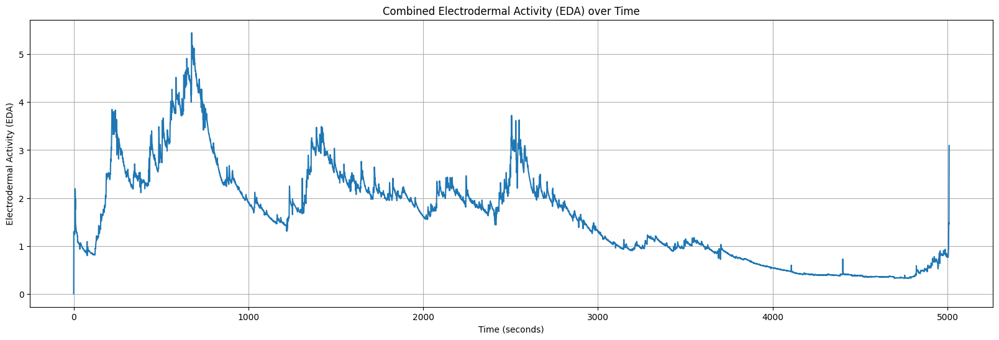

In [1542]:
# Combine the two EDA signals by taking the average
combined_eda = (right_eda_df['EDA'] + left_eda_df['EDA']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_eda_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_eda_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_eda)
plt.title('Combined Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(True)
plt.show()

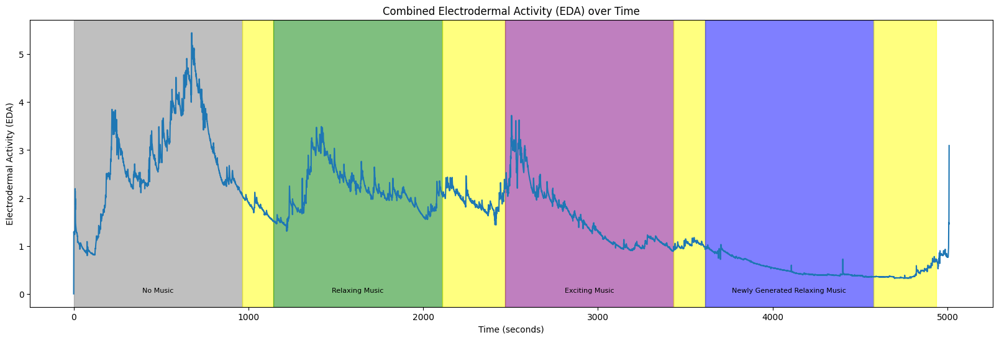

In [1543]:
import matplotlib.pyplot as plt


# Combine the two EDA signals by taking the average
combined_eda = (right_eda_df['EDA'] + left_eda_df['EDA']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_eda_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_eda_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_eda)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_eda), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Combined Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(False)
plt.show()

### HR
- HR: Average heart rate (HR) extracted from the BVP signal. Values in the first column (HR) show the HR values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1544]:
left_hr_df=pd.read_csv(Left_HR_file)
left_hr_df

,HR,start_time_unix,sampling_rate
0,88.00,1.634892e+09,1.0
1,93.00,1.634892e+09,1.0
2,79.33,1.634892e+09,1.0
3,84.00,1.634892e+09,1.0
4,77.60,1.634892e+09,1.0
...,...,...,...
4993,59.95,1.634892e+09,1.0
4994,59.90,1.634892e+09,1.0
4995,59.78,1.634892e+09,1.0
4996,59.83,1.634892e+09,1.0


In [1545]:
right_hr_df=pd.read_csv(Right_HR_file)
right_hr_df

,HR,start_time_unix,sampling_rate
0,58.00,1.634892e+09,1.0
1,62.50,1.634892e+09,1.0
2,96.67,1.634892e+09,1.0
3,93.25,1.634892e+09,1.0
4,86.60,1.634892e+09,1.0
...,...,...,...
4993,73.27,1.634892e+09,1.0
4994,73.10,1.634892e+09,1.0
4995,73.60,1.634892e+09,1.0
4996,73.38,1.634892e+09,1.0


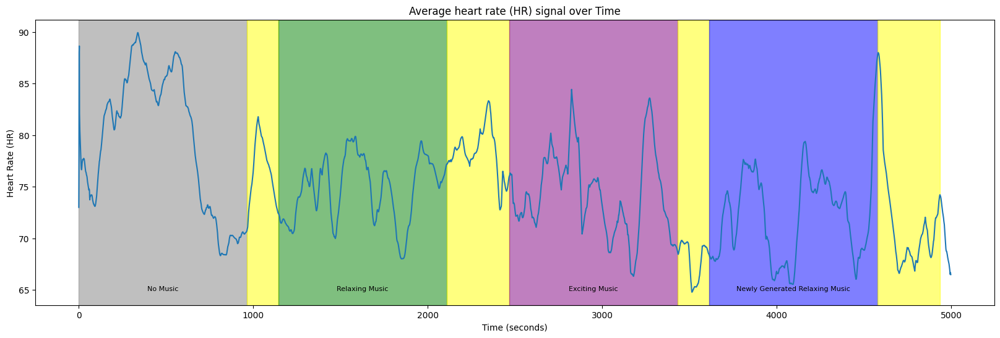

In [1546]:
import matplotlib.pyplot as plt


# Combine the two hr signals by taking the average
combined_hr = (right_hr_df['HR'] + left_hr_df['HR']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_hr_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_hr_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_hr)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_hr), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Average heart rate (HR) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Heart Rate (HR)')
plt.grid(False)
plt.show()

### BVP
- BVP: Blood volume pulses (BVP) measured from a photoplethysmograph. Values in the first column (BVP) show the BVP values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1547]:
left_bvp_df=pd.read_csv(Left_BVP_file)
left_bvp_df

,BVP,start_time_unix,sampling_rate
0,-0.00,1.634892e+09,64.0
1,-0.00,1.634892e+09,64.0
2,-0.00,1.634892e+09,64.0
3,-0.00,1.634892e+09,64.0
4,-0.00,1.634892e+09,64.0
...,...,...,...
320623,-73.63,1.634892e+09,64.0
320624,-48.30,1.634892e+09,64.0
320625,-27.42,1.634892e+09,64.0
320626,-16.60,1.634892e+09,64.0


In [1548]:
right_bvp_df=pd.read_csv(Right_BVP_file)
right_bvp_df

,BVP,start_time_unix,sampling_rate
0,-0.00,1.634892e+09,64.0
1,-0.00,1.634892e+09,64.0
2,-0.00,1.634892e+09,64.0
3,-0.00,1.634892e+09,64.0
4,-0.00,1.634892e+09,64.0
...,...,...,...
320623,-22.66,1.634892e+09,64.0
320624,-24.55,1.634892e+09,64.0
320625,-28.05,1.634892e+09,64.0
320626,-32.47,1.634892e+09,64.0


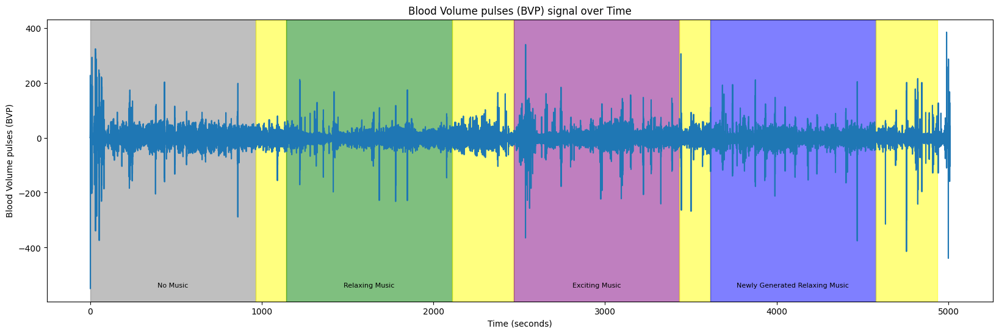

In [1549]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_bvp = (right_bvp_df['BVP'] + left_bvp_df['BVP']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_bvp_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_bvp_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_bvp)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_bvp), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Blood Volume pulses (BVP) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Blood Volume pulses (BVP)')
plt.grid(False)
plt.show()

### Temperature
- TEMP: Skin temperature (TEMP) measured from temperature sensor expressed degrees on the Celsius (°C) scale. Values in the first column (TEMP) show the TEMP values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1550]:
left_temp_df=pd.read_csv(Left_TEMP_file)
left_temp_df

,TEMP,start_time_unix,sampling_rate
0,31.35,1.634892e+09,4.0
1,31.35,1.634892e+09,4.0
2,31.35,1.634892e+09,4.0
3,31.35,1.634892e+09,4.0
4,31.35,1.634892e+09,4.0
...,...,...,...
20035,31.97,1.634892e+09,4.0
20036,31.99,1.634892e+09,4.0
20037,31.99,1.634892e+09,4.0
20038,31.99,1.634892e+09,4.0


In [1551]:
right_temp_df=pd.read_csv(Right_TEMP_file)
right_temp_df

,TEMP,start_time_unix,sampling_rate
0,31.41,1.634892e+09,4.0
1,31.41,1.634892e+09,4.0
2,31.41,1.634892e+09,4.0
3,31.41,1.634892e+09,4.0
4,31.41,1.634892e+09,4.0
...,...,...,...
20035,32.68,1.634892e+09,4.0
20036,32.71,1.634892e+09,4.0
20037,32.71,1.634892e+09,4.0
20038,32.71,1.634892e+09,4.0


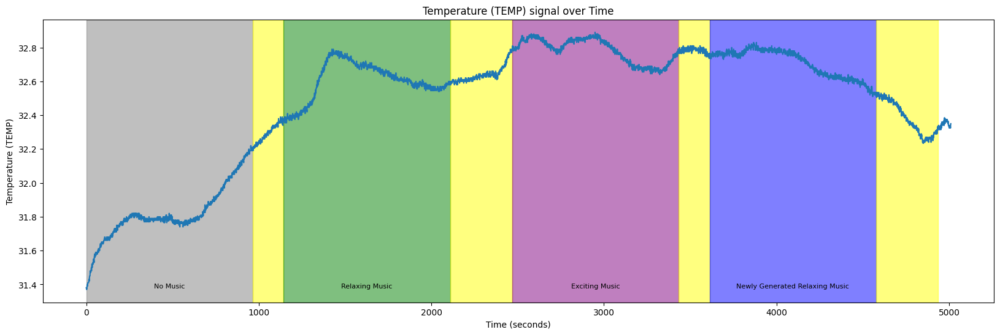

In [1552]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_temp = (right_temp_df['TEMP'] + left_temp_df['TEMP']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_temp_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_temp_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_temp)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_temp), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Temperature (TEMP) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Temperature (TEMP)')
plt.grid(False)
plt.show()

### ACC
- ACC: Data from 3-axis accelerometer sensor. The accelerometer is configured to measure acceleration in the range [-2g, 2g]. Therefore, the unit in this file is 1/64g. Data from x, y, and z axis are labeled respectively (i.e., ACC_X, ACC_Y, and ACC_Z).  The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1553]:
left_ACC_df=pd.read_csv(Left_ACC_file)
left_ACC_df

,ACC_X,ACC_Y,ACC_Z,start_time_unix,sampling_rate
0,-39,-3,51,1.634892e+09,32.0
1,-40,-2,50,1.634892e+09,32.0
2,-40,-3,50,1.634892e+09,32.0
3,-39,-3,50,1.634892e+09,32.0
4,-39,-3,50,1.634892e+09,32.0
...,...,...,...,...,...
160243,2,-11,62,1.634892e+09,32.0
160244,3,-10,62,1.634892e+09,32.0
160245,2,-11,63,1.634892e+09,32.0
160246,3,-11,63,1.634892e+09,32.0


In [1554]:
right_ACC_df=pd.read_csv(Right_ACC_file)
right_ACC_df

,ACC_X,ACC_Y,ACC_Z,start_time_unix,sampling_rate
0,-49,6,43,1.634892e+09,32.0
1,-50,6,43,1.634892e+09,32.0
2,-49,6,43,1.634892e+09,32.0
3,-49,6,44,1.634892e+09,32.0
4,-50,6,43,1.634892e+09,32.0
...,...,...,...,...,...
160243,-1,23,59,1.634892e+09,32.0
160244,-2,23,59,1.634892e+09,32.0
160245,-1,24,59,1.634892e+09,32.0
160246,-2,23,59,1.634892e+09,32.0


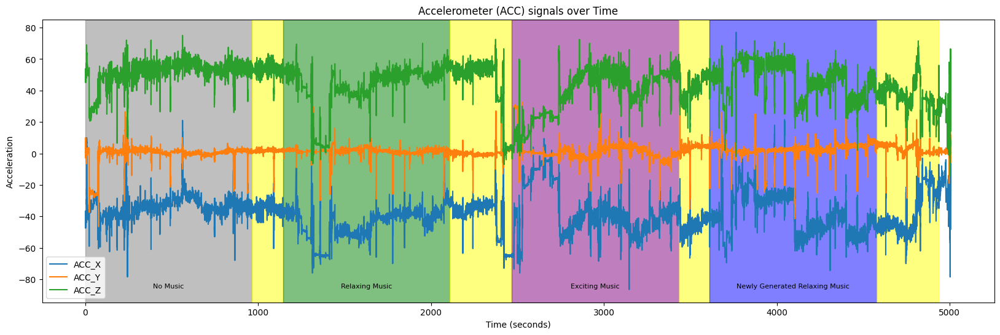

In [1555]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_accX = (right_ACC_df['ACC_X'] + left_ACC_df['ACC_X']) / 2
combined_accY = (right_ACC_df['ACC_Y'] + left_ACC_df['ACC_Y']) / 2
combined_accZ = (right_ACC_df['ACC_Z'] + left_ACC_df['ACC_Z']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_ACC_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_ACC_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_accX, label='ACC_X')
plt.plot(time_seconds, combined_accY, label='ACC_Y')
plt.plot(time_seconds, combined_accZ, label='ACC_Z')

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_accX), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Accelerometer (ACC) signals over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Acceleration')
plt.legend()
plt.grid(False)
plt.show()

## EG

The EEG signals recorded from the Muse headband are also included in the dataset as 'EEG_recording.csv'. They include EEG channels from four locations: TP9, AF7, AF8, and TP10. The 2016 model Muse (MU-02) can also output RAW EEG data at 256Hz as well as being able to output RAW EEG from the right ear USB Auxiliary connector (named Right AUX in the csv files). The column (timestamps) shows the data points in UNIX format. EEG measurements are labeled as TP9, AF7, AF8, TP10, Right AUX.

In [242]:
eeg_df=pd.read_csv(EEG_file)
eeg_df

,timestamps,TP9,AF7,AF8,TP10,Right AUX
0,1.634891e+09,-55.176,39.062,38.574,-68.848,76.660
1,1.634891e+09,-53.223,41.016,38.086,-71.777,41.992
2,1.634891e+09,-50.781,39.062,37.109,-74.219,26.367
3,1.634891e+09,-49.316,33.691,35.645,-77.637,36.133
4,1.634891e+09,-49.316,33.691,35.645,-70.312,19.531
...,...,...,...,...,...,...
1334083,1.634897e+09,149.414,19.043,50.293,59.570,39.062
1334084,1.634897e+09,141.113,26.367,49.805,51.270,5.859
1334085,1.634897e+09,144.531,17.578,46.875,67.383,54.688
1334086,1.634897e+09,151.855,15.625,43.945,71.777,100.098


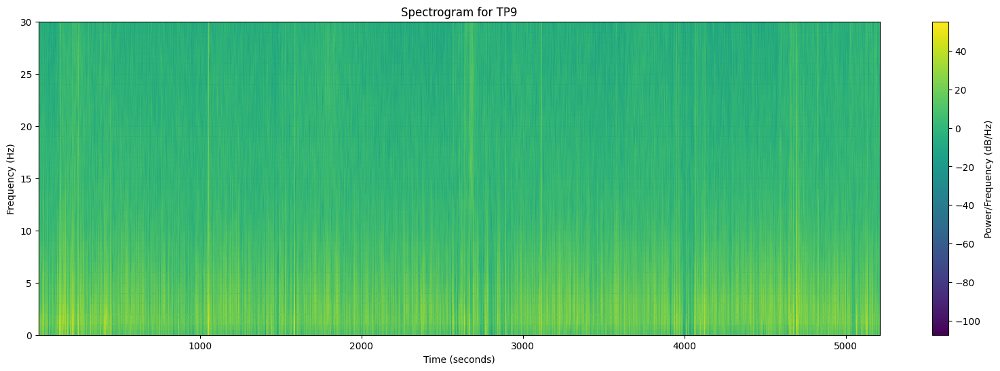

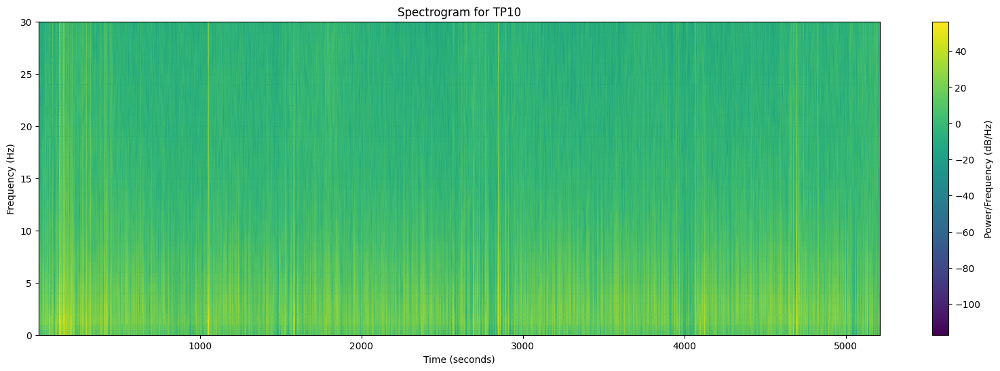

In [243]:
import matplotlib.pyplot as plt
from scipy import signal
# Extract the desired channels (TP9 and TP10)
channels = ['TP9', 'TP10']  
eeg_data = eeg_df[channels]

# Convert the timestamps to time in seconds
sampling_rate = 256  # Sampling rate of the EEG data in Hz
time_seconds = eeg_df['timestamps'] / sampling_rate

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 256    # Length of each segment
noverlap = 128   # Overlap between segments
nfft = 256       # Number of points for the FFT

# Compute the spectrogram for each channel
frequencies, times, spectrogram_TP9 = signal.spectrogram(eeg_data['TP9'], fs=sampling_rate, window=window, 
                                                         nperseg=nperseg, noverlap=noverlap, nfft=nfft)
_, _, spectrogram_TP10 = signal.spectrogram(eeg_data['TP10'], fs=sampling_rate, window=window, 
                                            nperseg=nperseg, noverlap=noverlap, nfft=nfft)

# Plot the spectrogram for TP9
plt.figure(figsize=(20, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP9), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP9')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
plt.show()

# Plot the spectrogram for TP10
plt.figure(figsize=(20, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP10')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
plt.show()

Text(0.5, 0, 'time (s)')

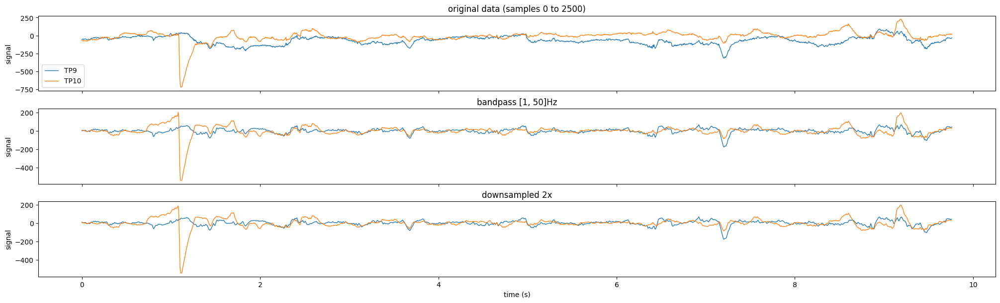

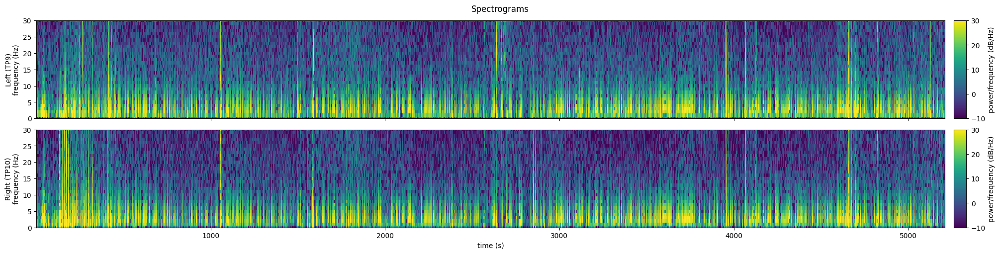

In [244]:
eeg_df['sample_number'] = range(len(eeg_df))
# Sampling rate of the EEG data in Hz
sampling_rate = 256  


# Convert the sample index to time in seconds
# This means you need to divide the sample *number* by the sampling rate
eeg_df['time_seconds'] = eeg_df['sample_number'] / sampling_rate

# Extract the desired channels (TP9 and TP10)
keep_channels = ['TP9', 'TP10']
eeg_data = eeg_df[keep_channels + ['time_seconds']].copy()

#
# Preprocess the EEG signals
#

#Define the pre-preprocessing parameters
downsample_factor = 2
bp_order = 4
bp_passband = [1, 50]
downsample_factor = 2

eeg_downsampled = pd.DataFrame()
downsampled_length = len(eeg_data) // downsample_factor

for channel in keep_channels:
    filtered_name = channel + '_bp'
    # Apply high-pass filter above 1 Hz and low-pass filter below 50 Hz
    b, a = signal.butter(bp_order, bp_passband, btype='bandpass', fs=sampling_rate)
    eeg_data[filtered_name] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample the signal from 256 to 128 Hz
    # Put the shorter signals in a new dataframe "eeg_downsampled"
    eeg_downsampled[channel] = signal.resample(eeg_data[filtered_name], downsampled_length)
eeg_downsampled['time_seconds'] = np.arange(downsampled_length) / (sampling_rate / downsample_factor)

#
# View the original and processed data
#
plot_height = 2
n_plots = 3
f, axs = plt.subplots(nrows=n_plots, ncols=1,
                      figsize=(20, plot_height * n_plots),
                      layout='constrained', sharex=True)

plot_slice = slice(0, 2500) #window of data to plot

#Original data
eeg_data[plot_slice].plot(
    y=keep_channels, x='time_seconds',
    ylabel='signal', xlabel='time (s)',
    linewidth=1, ax=axs[0],
    title=f'original data (samples {plot_slice.start} to {plot_slice.stop})'
)

#Filtered
eeg_data[plot_slice].plot(
    y=[chan + '_bp' for chan in keep_channels], x='time_seconds',
    ylabel='signal', xlabel='time (s)', legend=False,
    linewidth=1, ax=axs[1], title=f'bandpass {bp_passband}Hz'
)

#Downsampled
eeg_downsampled[plot_slice.start:plot_slice.stop//downsample_factor].plot(
    y=keep_channels, x='time_seconds',
    ylabel='signal', xlabel='time (s)', legend=False,
    linewidth=1, ax=axs[2], title=f'downsampled {downsample_factor}x'
)

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 128    # Length of each segment
noverlap = 64    # Overlap between segments
nfft = 128       # Number of points for the FFT

# Compute the spectrogram for each channel
spectrograms = {}
for channel in keep_channels:
    frequencies, times, spectrogram = signal.spectrogram(
        eeg_downsampled[channel],
        fs=sampling_rate / downsample_factor,
        window=window, nperseg=nperseg, noverlap=noverlap, nfft=nfft
    )
    spectrograms[channel] = spectrogram

# Plot the spectrograms
f, axs = plt.subplots(nrows=2, ncols=1, figsize=(20, 5),
                      layout='constrained', sharex=True)
f.suptitle('Spectrograms')
vmin, vmax = -10, 30

for channel, ax in zip(keep_channels, axs):
    im = ax.pcolormesh(
        times, frequencies, 10 * np.log10(spectrograms[channel]),
        vmin=vmin, vmax=vmax, #comment out for auto-range
        shading='nearest', cmap='viridis'
    )
    
    ax.set_ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
    ax.set_ylabel(('Left' if channel=='TP9' else 'Right') + f' ({channel})\nfrequency (Hz)')
    
    cbar = f.colorbar(im, aspect=8, pad=0.01, label='power/frequency (dB/Hz)')
    
ax.set_xlabel('time (s)')

### Beta Band Frequency

C:\Users\user\AppData\Local\Temp\ipykernel_29192\2331215207.py:79: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")
C:\Users\user\AppData\Local\Temp\ipykernel_29192\2331215207.py:79: UserWarning: 

The `join` parameter is deprecated and will be removed in v0.15.0.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")


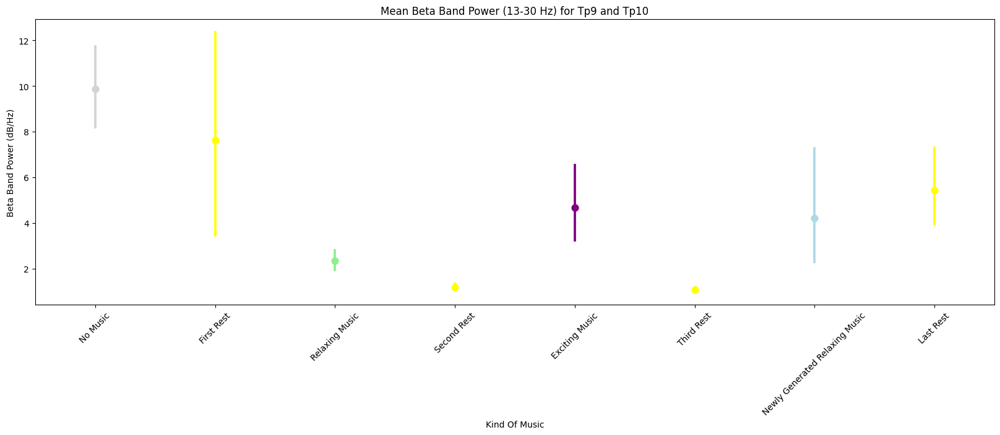

In [245]:
# Sample EEG DataFrame
# Assuming you have an EEG DataFrame named eeg_df with columns 'TP9' and 'TP10'

# Preprocessing parameters
sampling_rate = 256
downsample_factor = 2
bp_order = 4
bp_passband = [1, 50]

# Apply preprocessing and downsampling
eeg_df['sample_number'] = range(len(eeg_df))
eeg_df['time_seconds'] = eeg_df['sample_number'] / sampling_rate

eeg_data = eeg_df[['TP9', 'TP10', 'time_seconds']].copy()

eeg_downsampled = pd.DataFrame()
downsampled_length = len(eeg_data) // downsample_factor

for channel in ['TP9', 'TP10']:
    filtered_name = channel + '_bp'
    # Apply bandpass filter
    b, a = signal.butter(bp_order, bp_passband, btype='bandpass', fs=sampling_rate)
    eeg_data[filtered_name] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample
    eeg_downsampled[channel] = signal.resample(eeg_data[filtered_name], downsampled_length)

eeg_downsampled['time_seconds'] = np.arange(downsampled_length) / (sampling_rate / downsample_factor)

# Compute spectrogram for each channel
frequencies, times, spectrogram_tp9 = signal.spectrogram(
    eeg_downsampled['TP9'],
    fs=sampling_rate / downsample_factor,
    window='hann', nperseg=128, noverlap=64, nfft=128
)

_, _, spectrogram_tp10 = signal.spectrogram(
    eeg_downsampled['TP10'],
    fs=sampling_rate / downsample_factor,
    window='hann', nperseg=128, noverlap=64, nfft=128
)

# Compute beta band power (13-30 Hz) for each channel
beta_band_power_tp9 = np.mean(spectrogram_tp9[(frequencies >= 13) & (frequencies <= 30)], axis=0)
beta_band_power_tp10 = np.mean(spectrogram_tp10[(frequencies >= 13) & (frequencies <= 30)], axis=0)

# Compute mean beta band power across channels
mean_beta_band_power = (beta_band_power_tp9 + beta_band_power_tp10) / 2

# Define intervals and corresponding labels
intervals = [
    (0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
    (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                            964 + 180 + 964 + 360 + 964 + 180),
    (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
    (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)
]
labels = ['No Music', 'First Rest', 'Relaxing Music', 'Second Rest', 'Exciting Music', 'Third Rest',
          'Newly Generated Relaxing Music', 'Last Rest']

# Assign labels to each data point based on intervals
beta_power_df = pd.DataFrame({'Time': times, 'Power': mean_beta_band_power})
beta_power_df['Kind Of Music'] = pd.cut(beta_power_df['Time'], bins=[interval[0] for interval in intervals] + [np.inf], labels=labels)

# Define color palette dictionary
color_palette = {
    'No Music': 'lightgray',
    'First Rest': 'yellow',
    'Relaxing Music': 'lightgreen',
    'Second Rest': 'yellow',
    'Exciting Music': 'purple',
    'Third Rest': 'yellow',
    'Newly Generated Relaxing Music': 'lightblue',
    'Last Rest': 'yellow'
}

# Plot
plt.figure(figsize=(20, 6))
sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")
plt.title('Mean Beta Band Power (13-30 Hz) for Tp9 and Tp10')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Kind Of Music')
plt.xticks(rotation=45)
plt.show()

C:\Users\user\AppData\Local\Temp\ipykernel_29192\3532274209.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette)


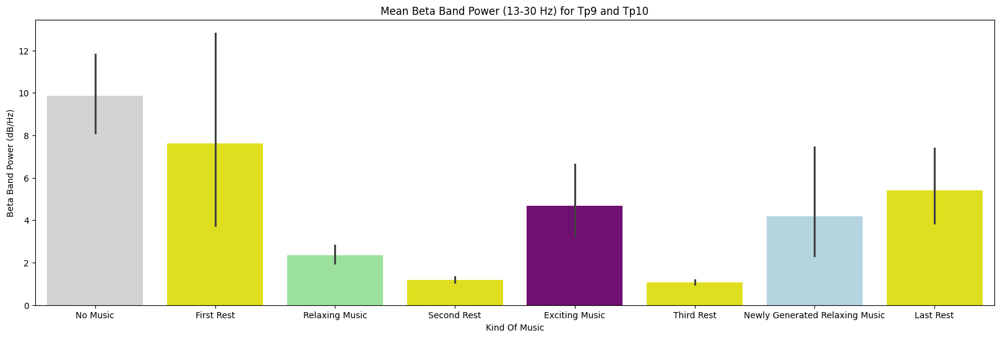

In [246]:
# Apply color palette for the bar plot
color_palette = {
    'No Music': 'lightgray',
    'First Rest': 'yellow',
    'Relaxing Music': 'lightgreen',
    'Second Rest': 'yellow',
    'Exciting Music': 'purple',
    'Third Rest': 'yellow',
    'Newly Generated Relaxing Music': 'lightblue',
    'Last Rest': 'yellow'
}

# Generate the bar plot
plt.figure(figsize=(20, 6))
sns.barplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette)
plt.title('Mean Beta Band Power (13-30 Hz) for Tp9 and Tp10')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Kind Of Music')
plt.show()

# Patient A9

In [247]:
# Define the file paths for the A9 data files
EEG_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A9\EEG_recording.csv'
Left_ACC_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A9\Left_ACC.csv'
Left_BVP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A9\Left_BVP.csv'
Left_EDA_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A9\Left_EDA.csv'
Left_HR_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A9\Left_HR.csv'
Left_IBI_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A9\Left_IBI.csv'
Left_tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A9\Left_tags.csv'
Left_TEMP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A9\Left_TEMP.csv'
n_back_responses_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A9\n_back_responses.csv'
Right_ACC_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A9\Right_ACC.csv'
Right_BVP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A9\Right_BVP.csv'
Right_EDA_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A9\Right_EDA.csv'
Right_HR_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A9\Right_HR.csv'
Right_IBI_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A9\Right_IBI.csv'
Right_tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A9\Right_tags.csv'
Right_TEMP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A9\Right_TEMP.csv'
tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A9\tags.csv'

## n back responses

In [1563]:
n_backr_df=pd.read_csv(n_back_responses_file)
n_backr_df

,ExperimentName,Start_time_unix,Subject,Session,DataFile.Basename,Display.RefreshRate,ExperimentVersion,Group,InstructionNewMusic.DEVICE,InstructionNoMusic.DEVICE,...,TrialList8.Cycle,TrialList8.Sample,TSO,TSTh,TSvO,TSvTh,TSxO,TSxTh,TTO,TTTh
0,Experiment_1,1635633506,26,1,Experiment_1-26-1,75.029,1.0.0.255,1,Chronos,Chronos,...,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Experiment_1,1635633506,26,1,Experiment_1-26-1,75.029,1.0.0.255,1,Chronos,Chronos,...,1.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Experiment_1,1635633506,26,1,Experiment_1-26-1,75.029,1.0.0.255,1,Chronos,Chronos,...,1.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Experiment_1,1635633506,26,1,Experiment_1-26-1,75.029,1.0.0.255,1,Chronos,Chronos,...,1.0,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Experiment_1,1635633506,26,1,Experiment_1-26-1,75.029,1.0.0.255,1,Chronos,Chronos,...,1.0,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,Experiment_1,1635633506,26,1,Experiment_1-26-1,75.029,1.0.0.255,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1452,Experiment_1,1635633506,26,1,Experiment_1-26-1,75.029,1.0.0.255,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1453,Experiment_1,1635633506,26,1,Experiment_1-26-1,75.029,1.0.0.255,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1454,Experiment_1,1635633506,26,1,Experiment_1-26-1,75.029,1.0.0.255,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1564]:
n_backr_df.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 250 columns):
 #    Column                                   Non-Null Count  Dtype  
---   ------                                   --------------  -----  
 0    ExperimentName                           1456 non-null   object 
 1    Start_time_unix                          1456 non-null   int64  
 2    Subject                                  1456 non-null   int64  
 3    Session                                  1456 non-null   int64  
 4    DataFile.Basename                        1456 non-null   object 
 5    Display.RefreshRate                      1456 non-null   float64
 6    ExperimentVersion                        1456 non-null   object 
 7    Group                                    1456 non-null   int64  
 8    InstructionNewMusic.DEVICE               1456 non-null   object 
 9    InstructionNoMusic.DEVICE                1456 non-null   object 
 10   InstructionNoMusic.DurationError  

In [1565]:
df_length=len(n_backr_df)

In [1566]:
# Filter columns with length 1456
non_null_columns = [col for col in n_backr_df.columns if n_backr_df[col].notnull().all()]
# Create a new DataFrame with only columns of the same length as the DataFrame
complete_df = n_backr_df[non_null_columns]
complete_df

,ExperimentName,Start_time_unix,Subject,Session,DataFile.Basename,Display.RefreshRate,ExperimentVersion,Group,InstructionNewMusic.DEVICE,InstructionNoMusic.DEVICE,...,Welcome.DurationError,Welcome.OnsetDelay,Welcome.OnsetTime,Welcome.OnsetToOnsetTime,Block,Instruction,ListName,Procedure[Block],Running[Block],Trigger
0,Experiment_1,1635633506,26,1,Experiment_1-26-1,75.029,1.0.0.255,1,Chronos,Chronos,...,-999999,37,15178,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
1,Experiment_1,1635633506,26,1,Experiment_1-26-1,75.029,1.0.0.255,1,Chronos,Chronos,...,-999999,37,15178,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
2,Experiment_1,1635633506,26,1,Experiment_1-26-1,75.029,1.0.0.255,1,Chronos,Chronos,...,-999999,37,15178,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
3,Experiment_1,1635633506,26,1,Experiment_1-26-1,75.029,1.0.0.255,1,Chronos,Chronos,...,-999999,37,15178,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
4,Experiment_1,1635633506,26,1,Experiment_1-26-1,75.029,1.0.0.255,1,Chronos,Chronos,...,-999999,37,15178,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,Experiment_1,1635633506,26,1,Experiment_1-26-1,75.029,1.0.0.255,1,Chronos,Chronos,...,-999999,37,15178,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1452,Experiment_1,1635633506,26,1,Experiment_1-26-1,75.029,1.0.0.255,1,Chronos,Chronos,...,-999999,37,15178,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1453,Experiment_1,1635633506,26,1,Experiment_1-26-1,75.029,1.0.0.255,1,Chronos,Chronos,...,-999999,37,15178,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1454,Experiment_1,1635633506,26,1,Experiment_1-26-1,75.029,1.0.0.255,1,Chronos,Chronos,...,-999999,37,15178,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2


### Instruction

In [1567]:
instruction = n_backr_df.columns
instruction[instruction.str.contains('Instruction')]
#.str.contains('SNOMED')]

Index(['InstructionNewMusic.DEVICE', 'InstructionNoMusic.DEVICE',
       'InstructionNoMusic.DurationError', 'InstructionNoMusic.OnsetDelay',
       'InstructionNoMusic.OnsetTime', 'InstructionNoMusic.OnsetToOnsetTime',
       'InstructionRelaxMusic.DEVICE', 'InstructionRelaxMusic.DurationError',
       'InstructionRelaxMusic.OnsetDelay', 'InstructionRelaxMusic.OnsetTime',
       'InstructionRelaxMusic.OnsetToOnsetTime',
       'InstructionStressMusic.DEVICE', 'InstructionStressMusic.DurationError',
       'InstructionStressMusic.OnsetDelay', 'InstructionStressMusic.OnsetTime',
       'InstructionStressMusic.OnsetToOnsetTime', 'Instruction'],
      dtype='object')

In [1568]:
instruction_df=n_backr_df[instruction[instruction.str.contains('Instruction')]]

### Stimulus

In [1569]:
stimulus = n_backr_df.columns
stimulus=stimulus[stimulus.str.contains('Stimulus')]

In [1570]:
stimulus

Index(['Stimulus100.ACC', 'Stimulus100.CRESP', 'Stimulus100.DEVICE',
       'Stimulus100.DurationError', 'Stimulus100.OnsetDelay',
       'Stimulus100.OnsetTime', 'Stimulus100.OnsetToOnsetTime',
       'Stimulus100.RESP', 'Stimulus100.RT', 'Stimulus100.RTTime',
       'Stimulus101.ACC', 'Stimulus101.CRESP', 'Stimulus101.DEVICE',
       'Stimulus101.DurationError', 'Stimulus101.OnsetDelay',
       'Stimulus101.OnsetTime', 'Stimulus101.OnsetToOnsetTime',
       'Stimulus101.RESP', 'Stimulus101.RT', 'Stimulus101.RTTime',
       'Stimulus102.ACC', 'Stimulus102.CRESP', 'Stimulus102.DEVICE',
       'Stimulus102.DurationError', 'Stimulus102.OnsetDelay',
       'Stimulus102.OnsetTime', 'Stimulus102.OnsetToOnsetTime',
       'Stimulus102.RESP', 'Stimulus102.RT', 'Stimulus102.RTTime',
       'Stimulus103.ACC', 'Stimulus103.CRESP', 'Stimulus103.DEVICE',
       'Stimulus103.DurationError', 'Stimulus103.OnsetDelay',
       'Stimulus103.OnsetTime', 'Stimulus103.OnsetToOnsetTime',
       'Stimulus103

In [1571]:
# Create a dictionary to store the mapping of columns to Running[Block] values
column_to_block = {}
running_block_values=n_backr_df['Running[Block]'].unique()
# Create a dictionary to store the mapping of stimulus columns to lists of Running[Block] values

stimulus_to_blocks = {}

# Iterate over each stimulus column
for col in stimulus:
    # Store all 4 Running[Block] values as a list for this stimulus column
    stimulus_to_blocks[col] = running_block_values

print(stimulus_to_blocks)

{'Stimulus100.ACC': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.CRESP': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.DEVICE': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.DurationError': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetDelay': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetTime': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetToOnsetTime': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.RESP': array(['PracticeSessi

In [1572]:
# Create a new dictionary to store the suffixed keys and values
suffixed_dict = {}

# Iterate over each key in stimulus_to_blocks dictionary
for key, values in stimulus_to_blocks.items():
    # Get the prefix (e.g., 'Stimulus100') from the key
    prefix = key.split('.')[0]
    
    # Create a list to store the suffixed column names
    suffixed_columns = []
    
    # Iterate over each column name in stimulus_columns
    for col in stimulus:
        # If the column name starts with the same prefix
        if col.startswith(prefix):
            # Append the suffixed column name to the list
            suffixed_columns.append(col)
    
    # Create the suffixed key by joining the prefix with ':'
    suffixed_key = f'{prefix}:'
    
    # Add the suffixed column names list as the value for the suffixed key
    suffixed_dict[suffixed_key] = suffixed_columns

print(suffixed_dict)

{'Stimulus100:': ['Stimulus100.ACC', 'Stimulus100.CRESP', 'Stimulus100.DEVICE', 'Stimulus100.DurationError', 'Stimulus100.OnsetDelay', 'Stimulus100.OnsetTime', 'Stimulus100.OnsetToOnsetTime', 'Stimulus100.RESP', 'Stimulus100.RT', 'Stimulus100.RTTime'], 'Stimulus101:': ['Stimulus101.ACC', 'Stimulus101.CRESP', 'Stimulus101.DEVICE', 'Stimulus101.DurationError', 'Stimulus101.OnsetDelay', 'Stimulus101.OnsetTime', 'Stimulus101.OnsetToOnsetTime', 'Stimulus101.RESP', 'Stimulus101.RT', 'Stimulus101.RTTime'], 'Stimulus102:': ['Stimulus102.ACC', 'Stimulus102.CRESP', 'Stimulus102.DEVICE', 'Stimulus102.DurationError', 'Stimulus102.OnsetDelay', 'Stimulus102.OnsetTime', 'Stimulus102.OnsetToOnsetTime', 'Stimulus102.RESP', 'Stimulus102.RT', 'Stimulus102.RTTime'], 'Stimulus103:': ['Stimulus103.ACC', 'Stimulus103.CRESP', 'Stimulus103.DEVICE', 'Stimulus103.DurationError', 'Stimulus103.OnsetDelay', 'Stimulus103.OnsetTime', 'Stimulus103.OnsetToOnsetTime', 'Stimulus103.RESP', 'Stimulus103.RT', 'Stimulus103.R

#### Stimulus Table 100

In [1573]:
# Filter columns that start with 'Stimulus100'
stimulus100_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus100')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
stimulus100_df=n_backr_df[stimulus100_columns]
stimulus100_df

,Stimulus100.ACC,Stimulus100.CRESP,Stimulus100.DEVICE,Stimulus100.DurationError,Stimulus100.OnsetDelay,Stimulus100.OnsetTime,Stimulus100.OnsetToOnsetTime,Stimulus100.RESP,Stimulus100.RT,Stimulus100.RTTime,Running[Block]
0,0.0,3.0,Chronos,1.0,-2.0,81073.0,506.0,NaN,0.0,0.0,PracticeSession
1,0.0,3.0,Chronos,1.0,7.0,83086.0,506.0,NaN,0.0,0.0,PracticeSession
2,0.0,3.0,Chronos,2.0,19.0,85111.0,507.0,NaN,0.0,0.0,PracticeSession
3,0.0,4.0,Chronos,1.0,6.0,87124.0,506.0,NaN,0.0,0.0,PracticeSession
4,0.0,4.0,Chronos,1.0,20.0,89150.0,506.0,NaN,0.0,0.0,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 101

In [1574]:
# Filter columns that start with 'Stimulus100'
stimulus101_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus101')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus101_df=n_backr_df[stimulus101_columns]
stimulus101_df

,Stimulus101.ACC,Stimulus101.CRESP,Stimulus101.DEVICE,Stimulus101.DurationError,Stimulus101.OnsetDelay,Stimulus101.OnsetTime,Stimulus101.OnsetToOnsetTime,Stimulus101.RESP,Stimulus101.RT,Stimulus101.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 102

In [1575]:
# Filter columns that start with 'Stimulus100'
stimulus102_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus102')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus102_df=n_backr_df[stimulus102_columns]
stimulus102_df

,Stimulus102.ACC,Stimulus102.CRESP,Stimulus102.DEVICE,Stimulus102.DurationError,Stimulus102.OnsetDelay,Stimulus102.OnsetTime,Stimulus102.OnsetToOnsetTime,Stimulus102.RESP,Stimulus102.RT,Stimulus102.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 103

In [1576]:
# Filter columns that start with 'Stimulus100'
stimulus103_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus103')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus103_df=n_backr_df[stimulus103_columns]
stimulus103_df

,Stimulus103.ACC,Stimulus103.CRESP,Stimulus103.DEVICE,Stimulus103.DurationError,Stimulus103.OnsetDelay,Stimulus103.OnsetTime,Stimulus103.OnsetToOnsetTime,Stimulus103.RESP,Stimulus103.RT,Stimulus103.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 104

In [1577]:
# Filter columns that start with 'Stimulus100'
stimulus104_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus104')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus104_df=n_backr_df[stimulus104_columns]
stimulus104_df

,Stimulus104.ACC,Stimulus104.CRESP,Stimulus104.DEVICE,Stimulus104.DurationError,Stimulus104.OnsetDelay,Stimulus104.OnsetTime,Stimulus104.OnsetToOnsetTime,Stimulus104.RESP,Stimulus104.RT,Stimulus104.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,1.0,3.0,Chronos,2.0,19.0,4712943.0,0.0,3.0,415.0,4713358.0,NewMusicSession
1452,1.0,3.0,Chronos,2.0,19.0,4714889.0,0.0,3.0,428.0,4715317.0,NewMusicSession
1453,1.0,3.0,Chronos,1.0,20.0,4716849.0,0.0,3.0,446.0,4717295.0,NewMusicSession
1454,0.0,4.0,Chronos,2.0,19.0,4718821.0,507.0,NaN,0.0,0.0,NewMusicSession


### Fixation

In [1578]:
n_back_columns = n_backr_df.columns
fixation=n_back_columns[n_back_columns.str.contains('Fixation')]

In [1579]:
fixation_df=n_backr_df[n_back_columns[n_back_columns.str.contains('Fixation')]]

In [1580]:
fixation_df

,Fixation100.ACC,Fixation100.CRESP,Fixation100.DEVICE,Fixation100.DurationError,Fixation100.OnsetDelay,Fixation100.OnsetTime,Fixation100.OnsetToOnsetTime,Fixation100.RESP,Fixation100.RT,Fixation100.RTTime,...,Fixation104.ACC,Fixation104.CRESP,Fixation104.DEVICE,Fixation104.DurationError,Fixation104.OnsetDelay,Fixation104.OnsetTime,Fixation104.OnsetToOnsetTime,Fixation104.RESP,Fixation104.RT,Fixation104.RTTime
0,1.0,3.0,Chronos,2.0,6.0,81579.0,0.0,3.0,380.0,81959.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.0,3.0,Chronos,1.0,6.0,83592.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1.0,3.0,Chronos,1.0,7.0,85618.0,0.0,3.0,499.0,86117.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0.0,4.0,Chronos,2.0,6.0,87630.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0.0,4.0,Chronos,2.0,6.0,89656.0,0.0,3.0,386.0,90042.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,3.0,Chronos,1.0,11.0,4713370.0,0.0,NaN,0.0,0.0
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,3.0,Chronos,2.0,12.0,4715329.0,0.0,NaN,0.0,0.0
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,3.0,Chronos,1.0,6.0,4717302.0,0.0,NaN,0.0,0.0
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,4.0,Chronos,1.0,7.0,4719328.0,0.0,4.0,75.0,4719403.0


#### Fixation table 100

In [1581]:
# Filter columns that start with 'Fixation100'
fixation100_columns = [col for col in n_backr_df.columns if col.startswith('Fixation100')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation100_df=n_backr_df[fixation100_columns]
fixation100_df

,Fixation100.ACC,Fixation100.CRESP,Fixation100.DEVICE,Fixation100.DurationError,Fixation100.OnsetDelay,Fixation100.OnsetTime,Fixation100.OnsetToOnsetTime,Fixation100.RESP,Fixation100.RT,Fixation100.RTTime,Running[Block]
0,1.0,3.0,Chronos,2.0,6.0,81579.0,0.0,3.0,380.0,81959.0,PracticeSession
1,0.0,3.0,Chronos,1.0,6.0,83592.0,0.0,NaN,0.0,0.0,PracticeSession
2,1.0,3.0,Chronos,1.0,7.0,85618.0,0.0,3.0,499.0,86117.0,PracticeSession
3,0.0,4.0,Chronos,2.0,6.0,87630.0,0.0,NaN,0.0,0.0,PracticeSession
4,0.0,4.0,Chronos,2.0,6.0,89656.0,0.0,3.0,386.0,90042.0,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 101

In [1582]:
# Filter columns that start with 'Fixation100'
fixation101_columns = [col for col in n_backr_df.columns if col.startswith('Fixation101')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation101_df=n_backr_df[fixation101_columns]
fixation101_df

,Fixation101.ACC,Fixation101.CRESP,Fixation101.DEVICE,Fixation101.DurationError,Fixation101.OnsetDelay,Fixation101.OnsetTime,Fixation101.OnsetToOnsetTime,Fixation101.RESP,Fixation101.RT,Fixation101.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 102

In [1583]:
# Filter columns that start with 'Fixation100'
fixation102_columns = [col for col in n_backr_df.columns if col.startswith('Fixation102')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation102_df=n_backr_df[fixation102_columns]
fixation102_df

,Fixation102.ACC,Fixation102.CRESP,Fixation102.DEVICE,Fixation102.DurationError,Fixation102.OnsetDelay,Fixation102.OnsetTime,Fixation102.OnsetToOnsetTime,Fixation102.RESP,Fixation102.RT,Fixation102.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 103

In [1584]:
# Filter columns that start with 'Fixation100'
fixation103_columns = [col for col in n_backr_df.columns if col.startswith('Fixation103')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation103_df=n_backr_df[fixation103_columns]
fixation103_df

,Fixation103.ACC,Fixation103.CRESP,Fixation103.DEVICE,Fixation103.DurationError,Fixation103.OnsetDelay,Fixation103.OnsetTime,Fixation103.OnsetToOnsetTime,Fixation103.RESP,Fixation103.RT,Fixation103.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 104

In [1585]:
# Filter columns that start with 'Fixation100'
fixation104_columns = [col for col in n_backr_df.columns if col.startswith('Fixation104')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation104_df=n_backr_df[fixation104_columns]
fixation104_df

,Fixation104.ACC,Fixation104.CRESP,Fixation104.DEVICE,Fixation104.DurationError,Fixation104.OnsetDelay,Fixation104.OnsetTime,Fixation104.OnsetToOnsetTime,Fixation104.RESP,Fixation104.RT,Fixation104.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,0.0,3.0,Chronos,1.0,11.0,4713370.0,0.0,NaN,0.0,0.0,NewMusicSession
1452,0.0,3.0,Chronos,2.0,12.0,4715329.0,0.0,NaN,0.0,0.0,NewMusicSession
1453,0.0,3.0,Chronos,1.0,6.0,4717302.0,0.0,NaN,0.0,0.0,NewMusicSession
1454,1.0,4.0,Chronos,1.0,7.0,4719328.0,0.0,4.0,75.0,4719403.0,NewMusicSession


## Empatica

### EDA
- EDA: Measurements from the electrodermal activity (EDA) sensor expressed as micro siemens (μS). Values in the first column (EDA) show the EDA values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1586]:
left_eda_df=pd.read_csv(Left_EDA_file)
left_eda_df

,EDA,start_time_unix,sampling_rate
0,0.000000,1.635633e+09,4.0
1,0.340711,1.635633e+09,4.0
2,0.434214,1.635633e+09,4.0
3,0.431653,1.635633e+09,4.0
4,0.431653,1.635633e+09,4.0
...,...,...,...
20029,0.273092,1.635633e+09,4.0
20030,0.284620,1.635633e+09,4.0
20031,0.298709,1.635633e+09,4.0
20032,0.298709,1.635633e+09,4.0


In [1587]:
right_eda_df=pd.read_csv(Right_EDA_file)
right_eda_df

,EDA,start_time_unix,sampling_rate
0,0.000000,1.635633e+09,4.0
1,0.220402,1.635633e+09,4.0
2,0.296005,1.635633e+09,4.0
3,0.276784,1.635633e+09,4.0
4,0.313945,1.635633e+09,4.0
...,...,...,...
20029,0.353669,1.635633e+09,4.0
20030,0.358794,1.635633e+09,4.0
20031,0.378015,1.635633e+09,4.0
20032,0.380578,1.635633e+09,4.0


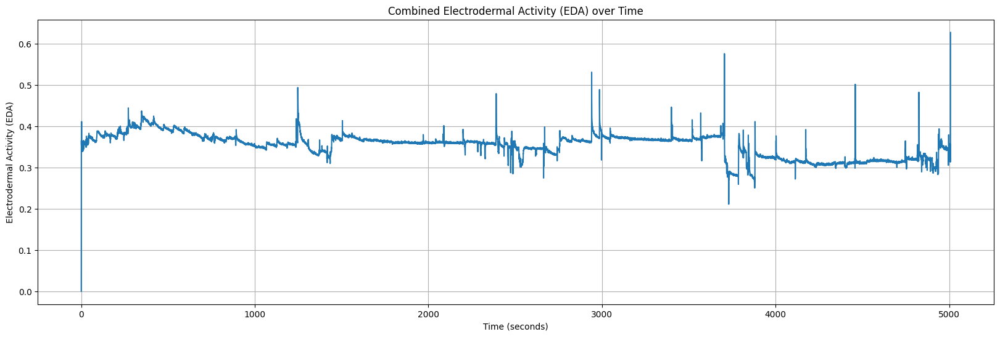

In [1588]:
# Combine the two EDA signals by taking the average
combined_eda = (right_eda_df['EDA'] + left_eda_df['EDA']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_eda_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_eda_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_eda)
plt.title('Combined Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(True)
plt.show()

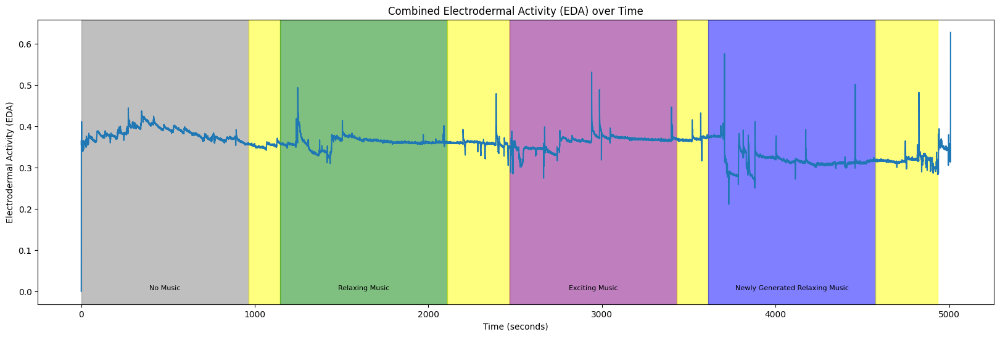

In [1589]:
import matplotlib.pyplot as plt


# Combine the two EDA signals by taking the average
combined_eda = (right_eda_df['EDA'] + left_eda_df['EDA']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_eda_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_eda_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_eda)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_eda), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Combined Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(False)
plt.show()

### HR
- HR: Average heart rate (HR) extracted from the BVP signal. Values in the first column (HR) show the HR values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1590]:
left_hr_df=pd.read_csv(Left_HR_file)
left_hr_df

,HR,start_time_unix,sampling_rate
0,64.00,1.635633e+09,1.0
1,59.50,1.635633e+09,1.0
2,100.33,1.635633e+09,1.0
3,96.00,1.635633e+09,1.0
4,88.60,1.635633e+09,1.0
...,...,...,...
4993,72.50,1.635633e+09,1.0
4994,72.13,1.635633e+09,1.0
4995,71.62,1.635633e+09,1.0
4996,71.12,1.635633e+09,1.0


In [1591]:
right_hr_df=pd.read_csv(Right_HR_file)
right_hr_df

,HR,start_time_unix,sampling_rate
0,85.00,1.635633e+09,1.0
1,71.50,1.635633e+09,1.0
2,82.33,1.635633e+09,1.0
3,75.50,1.635633e+09,1.0
4,95.20,1.635633e+09,1.0
...,...,...,...
4993,70.38,1.635633e+09,1.0
4994,70.58,1.635633e+09,1.0
4995,70.77,1.635633e+09,1.0
4996,70.98,1.635633e+09,1.0


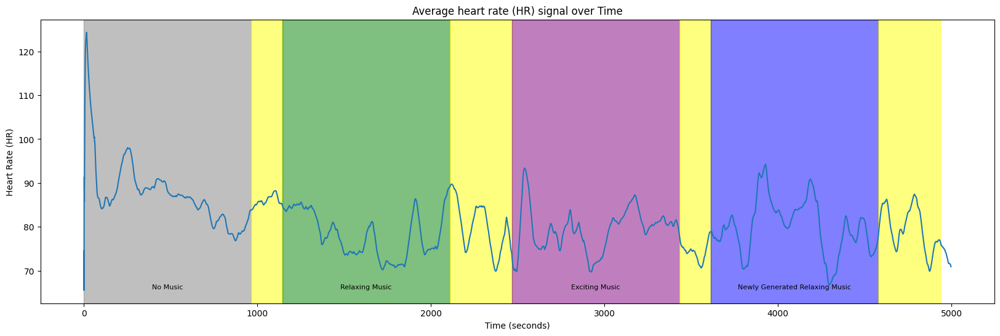

In [1592]:
import matplotlib.pyplot as plt


# Combine the two hr signals by taking the average
combined_hr = (right_hr_df['HR'] + left_hr_df['HR']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_hr_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_hr_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_hr)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_hr), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Average heart rate (HR) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Heart Rate (HR)')
plt.grid(False)
plt.show()

### BVP
- BVP: Blood volume pulses (BVP) measured from a photoplethysmograph. Values in the first column (BVP) show the BVP values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1593]:
left_bvp_df=pd.read_csv(Left_BVP_file)
left_bvp_df

,BVP,start_time_unix,sampling_rate
0,-0.00,1.635633e+09,64.0
1,-0.00,1.635633e+09,64.0
2,-0.00,1.635633e+09,64.0
3,-0.00,1.635633e+09,64.0
4,-0.00,1.635633e+09,64.0
...,...,...,...
320491,36.16,1.635633e+09,64.0
320492,42.50,1.635633e+09,64.0
320493,48.84,1.635633e+09,64.0
320494,54.71,1.635633e+09,64.0


In [1594]:
right_bvp_df=pd.read_csv(Right_BVP_file)
right_bvp_df

,BVP,start_time_unix,sampling_rate
0,-0.00,1.635633e+09,64.0
1,-0.00,1.635633e+09,64.0
2,-0.00,1.635633e+09,64.0
3,-0.00,1.635633e+09,64.0
4,-0.00,1.635633e+09,64.0
...,...,...,...
320502,-88.76,1.635633e+09,64.0
320503,-85.72,1.635633e+09,64.0
320504,-80.29,1.635633e+09,64.0
320505,-73.64,1.635633e+09,64.0


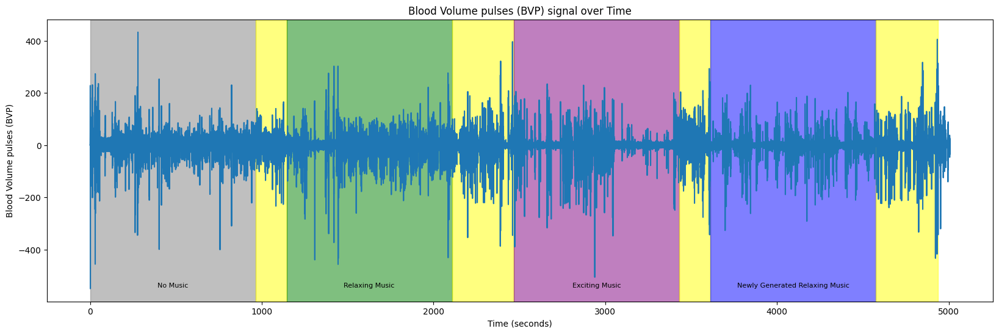

In [1595]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_bvp = (right_bvp_df['BVP'] + left_bvp_df['BVP']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_bvp_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = right_bvp_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_bvp)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_bvp), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Blood Volume pulses (BVP) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Blood Volume pulses (BVP)')
plt.grid(False)
plt.show()

### Temperature
- TEMP: Skin temperature (TEMP) measured from temperature sensor expressed degrees on the Celsius (°C) scale. Values in the first column (TEMP) show the TEMP values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1596]:
left_temp_df=pd.read_csv(Left_TEMP_file)
left_temp_df

,TEMP,start_time_unix,sampling_rate
0,30.65,1.635633e+09,4.0
1,30.65,1.635633e+09,4.0
2,30.65,1.635633e+09,4.0
3,30.65,1.635633e+09,4.0
4,30.65,1.635633e+09,4.0
...,...,...,...
20027,28.19,1.635633e+09,4.0
20028,28.21,1.635633e+09,4.0
20029,28.21,1.635633e+09,4.0
20030,28.21,1.635633e+09,4.0


In [1597]:
right_temp_df=pd.read_csv(Right_TEMP_file)
right_temp_df

,TEMP,start_time_unix,sampling_rate
0,31.27,1.635633e+09,4.0
1,31.27,1.635633e+09,4.0
2,31.27,1.635633e+09,4.0
3,31.27,1.635633e+09,4.0
4,31.27,1.635633e+09,4.0
...,...,...,...
20035,29.01,1.635633e+09,4.0
20036,29.03,1.635633e+09,4.0
20037,29.03,1.635633e+09,4.0
20038,29.03,1.635633e+09,4.0


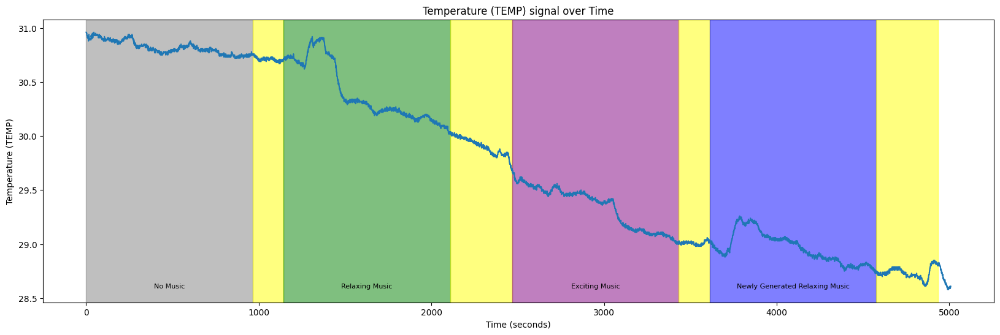

In [1598]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_temp = (right_temp_df['TEMP'] + left_temp_df['TEMP']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_temp_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = right_temp_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_temp)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_temp), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Temperature (TEMP) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Temperature (TEMP)')
plt.grid(False)
plt.show()

### ACC
- ACC: Data from 3-axis accelerometer sensor. The accelerometer is configured to measure acceleration in the range [-2g, 2g]. Therefore, the unit in this file is 1/64g. Data from x, y, and z axis are labeled respectively (i.e., ACC_X, ACC_Y, and ACC_Z).  The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1599]:
left_ACC_df=pd.read_csv(Left_ACC_file)
left_ACC_df

,ACC_X,ACC_Y,ACC_Z,start_time_unix,sampling_rate
0,26,17,55,1.635633e+09,32.0
1,26,18,55,1.635633e+09,32.0
2,26,18,54,1.635633e+09,32.0
3,26,17,54,1.635633e+09,32.0
4,27,17,54,1.635633e+09,32.0
...,...,...,...,...,...
160267,39,37,33,1.635633e+09,32.0
160268,39,38,33,1.635633e+09,32.0
160269,38,38,32,1.635633e+09,32.0
160270,38,37,33,1.635633e+09,32.0


In [1600]:
right_ACC_df=pd.read_csv(Right_ACC_file)
right_ACC_df

,ACC_X,ACC_Y,ACC_Z,start_time_unix,sampling_rate
0,-2,7,63,1.635633e+09,32.0
1,-2,7,63,1.635633e+09,32.0
2,-2,6,63,1.635633e+09,32.0
3,-1,6,62,1.635633e+09,32.0
4,-2,9,64,1.635633e+09,32.0
...,...,...,...,...,...
160273,21,27,53,1.635633e+09,32.0
160274,21,27,53,1.635633e+09,32.0
160275,21,27,53,1.635633e+09,32.0
160276,21,27,53,1.635633e+09,32.0


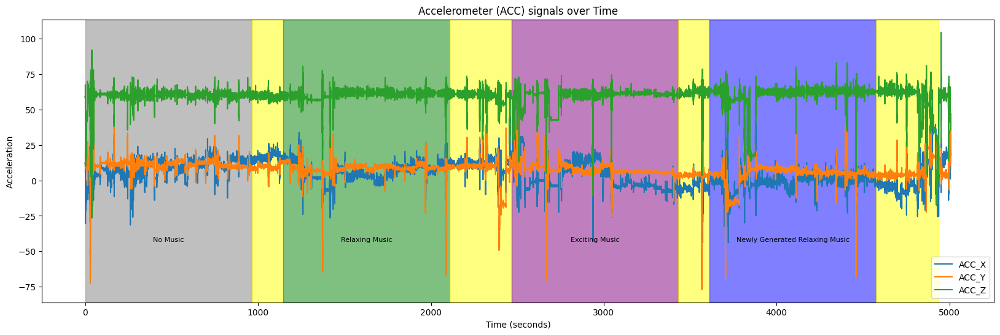

In [1601]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_accX = (right_ACC_df['ACC_X'] + left_ACC_df['ACC_X']) / 2
combined_accY = (right_ACC_df['ACC_Y'] + left_ACC_df['ACC_Y']) / 2
combined_accZ = (right_ACC_df['ACC_Z'] + left_ACC_df['ACC_Z']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_ACC_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = right_ACC_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_accX, label='ACC_X')
plt.plot(time_seconds, combined_accY, label='ACC_Y')
plt.plot(time_seconds, combined_accZ, label='ACC_Z')

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_accX), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Accelerometer (ACC) signals over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Acceleration')
plt.legend()
plt.grid(False)
plt.show()

## EG

The EEG signals recorded from the Muse headband are also included in the dataset as 'EEG_recording.csv'. They include EEG channels from four locations: TP9, AF7, AF8, and TP10. The 2016 model Muse (MU-02) can also output RAW EEG data at 256Hz as well as being able to output RAW EEG from the right ear USB Auxiliary connector (named Right AUX in the csv files). The column (timestamps) shows the data points in UNIX format. EEG measurements are labeled as TP9, AF7, AF8, TP10, Right AUX.

In [248]:
eeg_df=pd.read_csv(EEG_file)
eeg_df

,timestamps,TP9,AF7,AF8,TP10,Right AUX
0,1.635633e+09,333.496,37.109,-18.555,500.488,36.133
1,1.635633e+09,336.426,34.180,156.250,712.891,16.113
2,1.635633e+09,353.027,33.691,235.840,-976.074,23.438
3,1.635633e+09,316.406,35.645,41.504,876.953,41.992
4,1.635633e+09,291.016,33.691,-23.438,538.086,75.195
...,...,...,...,...,...,...
1304551,1.635638e+09,50.781,31.738,-210.938,666.992,32.715
1304552,1.635638e+09,61.523,30.273,173.340,882.324,66.406
1304553,1.635638e+09,58.105,36.133,259.277,-962.402,42.969
1304554,1.635638e+09,43.457,35.645,127.930,893.555,35.156


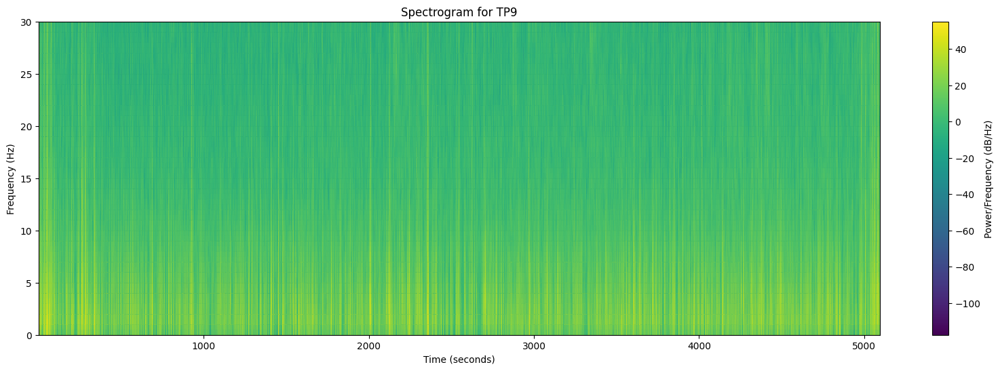

C:\Users\user\AppData\Local\Temp\ipykernel_29192\2195272341.py:35: RuntimeWarning: divide by zero encountered in log10
  plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap='viridis')


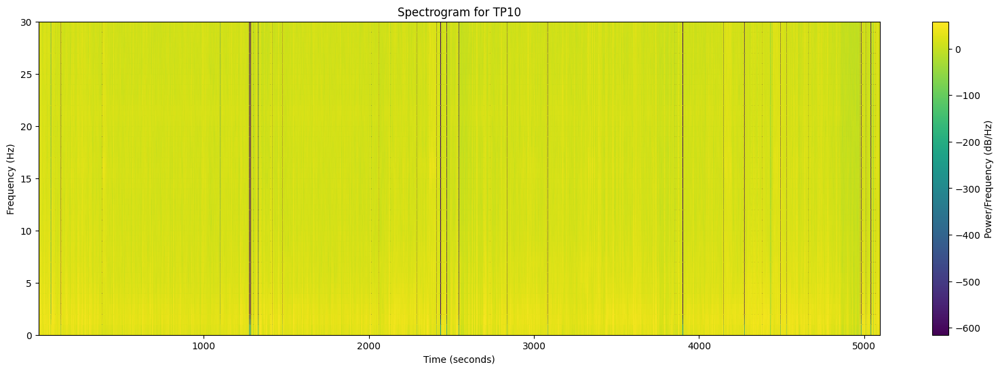

In [249]:
import matplotlib.pyplot as plt
from scipy import signal
# Extract the desired channels (TP9 and TP10)
channels = ['TP9', 'TP10']  
eeg_data = eeg_df[channels]

# Convert the timestamps to time in seconds
sampling_rate = 256  # Sampling rate of the EEG data in Hz
time_seconds = eeg_df['timestamps'] / sampling_rate

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 256    # Length of each segment
noverlap = 128   # Overlap between segments
nfft = 256       # Number of points for the FFT

# Compute the spectrogram for each channel
frequencies, times, spectrogram_TP9 = signal.spectrogram(eeg_data['TP9'], fs=sampling_rate, window=window, 
                                                         nperseg=nperseg, noverlap=noverlap, nfft=nfft)
_, _, spectrogram_TP10 = signal.spectrogram(eeg_data['TP10'], fs=sampling_rate, window=window, 
                                            nperseg=nperseg, noverlap=noverlap, nfft=nfft)

# Plot the spectrogram for TP9
plt.figure(figsize=(20, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP9), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP9')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
plt.show()

# Plot the spectrogram for TP10
plt.figure(figsize=(20, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP10')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
plt.show()

Text(0.5, 0, 'time (s)')

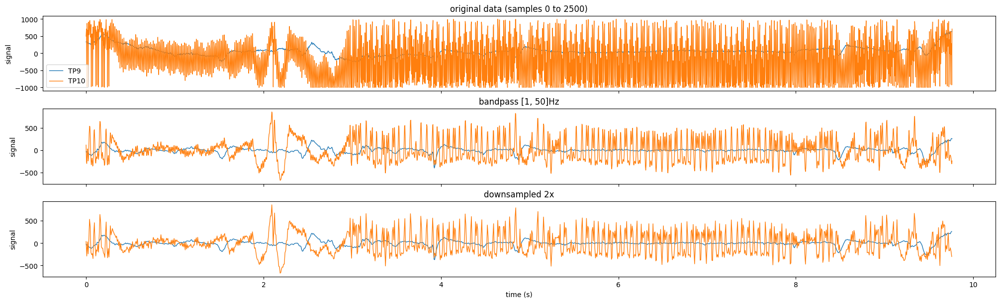

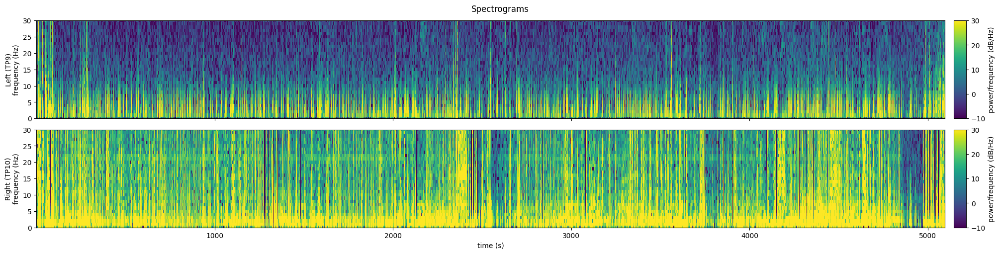

In [250]:
eeg_df['sample_number'] = range(len(eeg_df))
# Sampling rate of the EEG data in Hz
sampling_rate = 256  


# Convert the sample index to time in seconds
# This means you need to divide the sample *number* by the sampling rate
eeg_df['time_seconds'] = eeg_df['sample_number'] / sampling_rate

# Extract the desired channels (TP9 and TP10)
keep_channels = ['TP9', 'TP10']
eeg_data = eeg_df[keep_channels + ['time_seconds']].copy()

#
# Preprocess the EEG signals
#

#Define the pre-preprocessing parameters
downsample_factor = 2
bp_order = 4
bp_passband = [1, 50]
downsample_factor = 2

eeg_downsampled = pd.DataFrame()
downsampled_length = len(eeg_data) // downsample_factor

for channel in keep_channels:
    filtered_name = channel + '_bp'
    # Apply high-pass filter above 1 Hz and low-pass filter below 50 Hz
    b, a = signal.butter(bp_order, bp_passband, btype='bandpass', fs=sampling_rate)
    eeg_data[filtered_name] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample the signal from 256 to 128 Hz
    # Put the shorter signals in a new dataframe "eeg_downsampled"
    eeg_downsampled[channel] = signal.resample(eeg_data[filtered_name], downsampled_length)
eeg_downsampled['time_seconds'] = np.arange(downsampled_length) / (sampling_rate / downsample_factor)

#
# View the original and processed data
#
plot_height = 2
n_plots = 3
f, axs = plt.subplots(nrows=n_plots, ncols=1,
                      figsize=(20, plot_height * n_plots),
                      layout='constrained', sharex=True)

plot_slice = slice(0, 2500) #window of data to plot

#Original data
eeg_data[plot_slice].plot(
    y=keep_channels, x='time_seconds',
    ylabel='signal', xlabel='time (s)',
    linewidth=1, ax=axs[0],
    title=f'original data (samples {plot_slice.start} to {plot_slice.stop})'
)

#Filtered
eeg_data[plot_slice].plot(
    y=[chan + '_bp' for chan in keep_channels], x='time_seconds',
    ylabel='signal', xlabel='time (s)', legend=False,
    linewidth=1, ax=axs[1], title=f'bandpass {bp_passband}Hz'
)

#Downsampled
eeg_downsampled[plot_slice.start:plot_slice.stop//downsample_factor].plot(
    y=keep_channels, x='time_seconds',
    ylabel='signal', xlabel='time (s)', legend=False,
    linewidth=1, ax=axs[2], title=f'downsampled {downsample_factor}x'
)

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 128    # Length of each segment
noverlap = 64    # Overlap between segments
nfft = 128       # Number of points for the FFT

# Compute the spectrogram for each channel
spectrograms = {}
for channel in keep_channels:
    frequencies, times, spectrogram = signal.spectrogram(
        eeg_downsampled[channel],
        fs=sampling_rate / downsample_factor,
        window=window, nperseg=nperseg, noverlap=noverlap, nfft=nfft
    )
    spectrograms[channel] = spectrogram

# Plot the spectrograms
f, axs = plt.subplots(nrows=2, ncols=1, figsize=(20, 5),
                      layout='constrained', sharex=True)
f.suptitle('Spectrograms')
vmin, vmax = -10, 30

for channel, ax in zip(keep_channels, axs):
    im = ax.pcolormesh(
        times, frequencies, 10 * np.log10(spectrograms[channel]),
        vmin=vmin, vmax=vmax, #comment out for auto-range
        shading='nearest', cmap='viridis'
    )
    
    ax.set_ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
    ax.set_ylabel(('Left' if channel=='TP9' else 'Right') + f' ({channel})\nfrequency (Hz)')
    
    cbar = f.colorbar(im, aspect=8, pad=0.01, label='power/frequency (dB/Hz)')
    
ax.set_xlabel('time (s)')

### Beta Band Frequency

C:\Users\user\AppData\Local\Temp\ipykernel_29192\2331215207.py:79: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")
C:\Users\user\AppData\Local\Temp\ipykernel_29192\2331215207.py:79: UserWarning: 

The `join` parameter is deprecated and will be removed in v0.15.0.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")


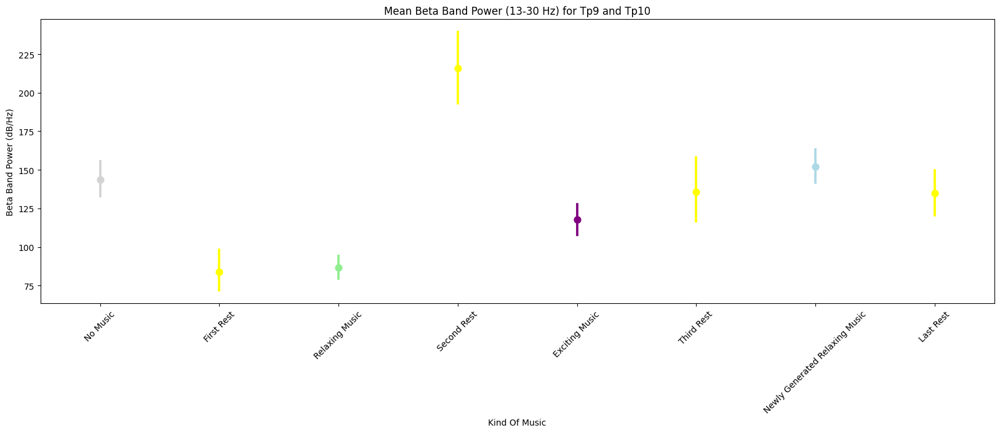

In [251]:
# Sample EEG DataFrame
# Assuming you have an EEG DataFrame named eeg_df with columns 'TP9' and 'TP10'

# Preprocessing parameters
sampling_rate = 256
downsample_factor = 2
bp_order = 4
bp_passband = [1, 50]

# Apply preprocessing and downsampling
eeg_df['sample_number'] = range(len(eeg_df))
eeg_df['time_seconds'] = eeg_df['sample_number'] / sampling_rate

eeg_data = eeg_df[['TP9', 'TP10', 'time_seconds']].copy()

eeg_downsampled = pd.DataFrame()
downsampled_length = len(eeg_data) // downsample_factor

for channel in ['TP9', 'TP10']:
    filtered_name = channel + '_bp'
    # Apply bandpass filter
    b, a = signal.butter(bp_order, bp_passband, btype='bandpass', fs=sampling_rate)
    eeg_data[filtered_name] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample
    eeg_downsampled[channel] = signal.resample(eeg_data[filtered_name], downsampled_length)

eeg_downsampled['time_seconds'] = np.arange(downsampled_length) / (sampling_rate / downsample_factor)

# Compute spectrogram for each channel
frequencies, times, spectrogram_tp9 = signal.spectrogram(
    eeg_downsampled['TP9'],
    fs=sampling_rate / downsample_factor,
    window='hann', nperseg=128, noverlap=64, nfft=128
)

_, _, spectrogram_tp10 = signal.spectrogram(
    eeg_downsampled['TP10'],
    fs=sampling_rate / downsample_factor,
    window='hann', nperseg=128, noverlap=64, nfft=128
)

# Compute beta band power (13-30 Hz) for each channel
beta_band_power_tp9 = np.mean(spectrogram_tp9[(frequencies >= 13) & (frequencies <= 30)], axis=0)
beta_band_power_tp10 = np.mean(spectrogram_tp10[(frequencies >= 13) & (frequencies <= 30)], axis=0)

# Compute mean beta band power across channels
mean_beta_band_power = (beta_band_power_tp9 + beta_band_power_tp10) / 2

# Define intervals and corresponding labels
intervals = [
    (0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
    (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                            964 + 180 + 964 + 360 + 964 + 180),
    (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
    (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)
]
labels = ['No Music', 'First Rest', 'Relaxing Music', 'Second Rest', 'Exciting Music', 'Third Rest',
          'Newly Generated Relaxing Music', 'Last Rest']

# Assign labels to each data point based on intervals
beta_power_df = pd.DataFrame({'Time': times, 'Power': mean_beta_band_power})
beta_power_df['Kind Of Music'] = pd.cut(beta_power_df['Time'], bins=[interval[0] for interval in intervals] + [np.inf], labels=labels)

# Define color palette dictionary
color_palette = {
    'No Music': 'lightgray',
    'First Rest': 'yellow',
    'Relaxing Music': 'lightgreen',
    'Second Rest': 'yellow',
    'Exciting Music': 'purple',
    'Third Rest': 'yellow',
    'Newly Generated Relaxing Music': 'lightblue',
    'Last Rest': 'yellow'
}

# Plot
plt.figure(figsize=(20, 6))
sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")
plt.title('Mean Beta Band Power (13-30 Hz) for Tp9 and Tp10')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Kind Of Music')
plt.xticks(rotation=45)
plt.show()

C:\Users\user\AppData\Local\Temp\ipykernel_29192\3532274209.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette)


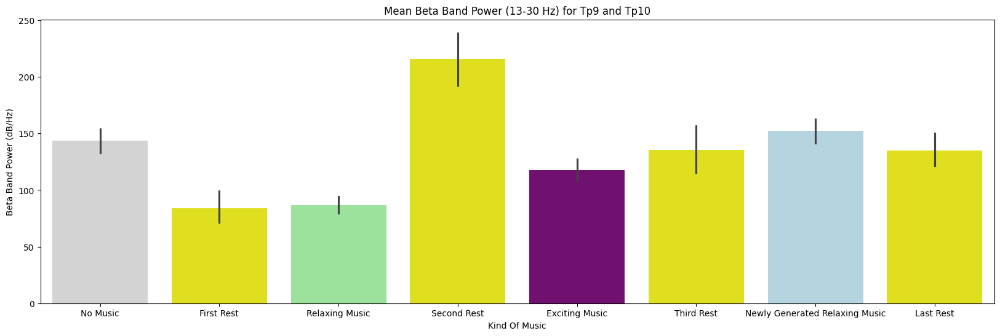

In [252]:
# Apply color palette for the bar plot
color_palette = {
    'No Music': 'lightgray',
    'First Rest': 'yellow',
    'Relaxing Music': 'lightgreen',
    'Second Rest': 'yellow',
    'Exciting Music': 'purple',
    'Third Rest': 'yellow',
    'Newly Generated Relaxing Music': 'lightblue',
    'Last Rest': 'yellow'
}

# Generate the bar plot
plt.figure(figsize=(20, 6))
sns.barplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette)
plt.title('Mean Beta Band Power (13-30 Hz) for Tp9 and Tp10')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Kind Of Music')
plt.show()

# Patient A10

In [253]:
# Define the file paths for the A10 data files
EEG_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A10\EEG_recording.csv'
Left_ACC_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A10\Left_ACC.csv'
Left_BVP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A10\Left_BVP.csv'
Left_EDA_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A10\Left_EDA.csv'
Left_HR_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A10\Left_HR.csv'
Left_IBI_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A10\Left_IBI.csv'
Left_tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A10\Left_tags.csv'
Left_TEMP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A10\Left_TEMP.csv'
n_back_responses_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A10\n_back_responses.csv'
Right_ACC_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A10\Right_ACC.csv'
Right_BVP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A10\Right_BVP.csv'
Right_EDA_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A10\Right_EDA.csv'
Right_HR_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A10\Right_HR.csv'
Right_IBI_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A10\Right_IBI.csv'
Right_tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A10\Right_tags.csv'
Right_TEMP_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A10\Right_TEMP.csv'
tags_file = r'C:\Users\user\Desktop\Semester2\Health Data\regulation_of_brain\regulation-of-brain-cognitive-states-through-auditory-gustatory-and-olfactory-stimulation-with-wearable-monitoring-1.0.0\Experiment_1\A10\tags.csv'

## n back responses

In [1609]:
n_backr_df=pd.read_csv(n_back_responses_file)
n_backr_df

,ExperimentName,Start_time_unix,Subject,Session,DataFile.Basename,Display.RefreshRate,ExperimentVersion,Group,InstructionNewMusic.DEVICE,InstructionNoMusic.DEVICE,...,TrialList8.Cycle,TrialList8.Sample,TSO,TSTh,TSvO,TSvTh,TSxO,TSxTh,TTO,TTTh
0,Experiment_1,1635111186,27,1,Experiment_1-27-1,75.029,1.0.0.255,1,Chronos,Chronos,...,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Experiment_1,1635111186,27,1,Experiment_1-27-1,75.029,1.0.0.255,1,Chronos,Chronos,...,1.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Experiment_1,1635111186,27,1,Experiment_1-27-1,75.029,1.0.0.255,1,Chronos,Chronos,...,1.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Experiment_1,1635111186,27,1,Experiment_1-27-1,75.029,1.0.0.255,1,Chronos,Chronos,...,1.0,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Experiment_1,1635111186,27,1,Experiment_1-27-1,75.029,1.0.0.255,1,Chronos,Chronos,...,1.0,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,Experiment_1,1635111186,27,1,Experiment_1-27-1,75.029,1.0.0.255,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1452,Experiment_1,1635111186,27,1,Experiment_1-27-1,75.029,1.0.0.255,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1453,Experiment_1,1635111186,27,1,Experiment_1-27-1,75.029,1.0.0.255,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1454,Experiment_1,1635111186,27,1,Experiment_1-27-1,75.029,1.0.0.255,1,Chronos,Chronos,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1610]:
n_backr_df.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 250 columns):
 #    Column                                   Non-Null Count  Dtype  
---   ------                                   --------------  -----  
 0    ExperimentName                           1456 non-null   object 
 1    Start_time_unix                          1456 non-null   int64  
 2    Subject                                  1456 non-null   int64  
 3    Session                                  1456 non-null   int64  
 4    DataFile.Basename                        1456 non-null   object 
 5    Display.RefreshRate                      1456 non-null   float64
 6    ExperimentVersion                        1456 non-null   object 
 7    Group                                    1456 non-null   int64  
 8    InstructionNewMusic.DEVICE               1456 non-null   object 
 9    InstructionNoMusic.DEVICE                1456 non-null   object 
 10   InstructionNoMusic.DurationError  

In [1611]:
df_length=len(n_backr_df)

In [1612]:
# Filter columns with length 1456
non_null_columns = [col for col in n_backr_df.columns if n_backr_df[col].notnull().all()]
# Create a new DataFrame with only columns of the same length as the DataFrame
complete_df = n_backr_df[non_null_columns]
complete_df

,ExperimentName,Start_time_unix,Subject,Session,DataFile.Basename,Display.RefreshRate,ExperimentVersion,Group,InstructionNewMusic.DEVICE,InstructionNoMusic.DEVICE,...,Welcome.DurationError,Welcome.OnsetDelay,Welcome.OnsetTime,Welcome.OnsetToOnsetTime,Block,Instruction,ListName,Procedure[Block],Running[Block],Trigger
0,Experiment_1,1635111186,27,1,Experiment_1-27-1,75.029,1.0.0.255,1,Chronos,Chronos,...,-999999,18,17032,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
1,Experiment_1,1635111186,27,1,Experiment_1-27-1,75.029,1.0.0.255,1,Chronos,Chronos,...,-999999,18,17032,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
2,Experiment_1,1635111186,27,1,Experiment_1-27-1,75.029,1.0.0.255,1,Chronos,Chronos,...,-999999,18,17032,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
3,Experiment_1,1635111186,27,1,Experiment_1-27-1,75.029,1.0.0.255,1,Chronos,Chronos,...,-999999,18,17032,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
4,Experiment_1,1635111186,27,1,Experiment_1-27-1,75.029,1.0.0.255,1,Chronos,Chronos,...,-999999,18,17032,0,1,1-Back Task \n\n Press TARGET if current lette...,FFO,PracticeTrial,PracticeSession,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,Experiment_1,1635111186,27,1,Experiment_1-27-1,75.029,1.0.0.255,1,Chronos,Chronos,...,-999999,18,17032,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1452,Experiment_1,1635111186,27,1,Experiment_1-27-1,75.029,1.0.0.255,1,Chronos,Chronos,...,-999999,18,17032,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1453,Experiment_1,1635111186,27,1,Experiment_1-27-1,75.029,1.0.0.255,1,Chronos,Chronos,...,-999999,18,17032,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2
1454,Experiment_1,1635111186,27,1,Experiment_1-27-1,75.029,1.0.0.255,1,Chronos,Chronos,...,-999999,18,17032,0,70,One Back Task \n\n Press TARGET if current let...,FEO,NewProc,NewMusicSession,2


### Instruction

In [1613]:
instruction = n_backr_df.columns
instruction[instruction.str.contains('Instruction')]
#.str.contains('SNOMED')]

Index(['InstructionNewMusic.DEVICE', 'InstructionNoMusic.DEVICE',
       'InstructionNoMusic.DurationError', 'InstructionNoMusic.OnsetDelay',
       'InstructionNoMusic.OnsetTime', 'InstructionNoMusic.OnsetToOnsetTime',
       'InstructionRelaxMusic.DEVICE', 'InstructionRelaxMusic.DurationError',
       'InstructionRelaxMusic.OnsetDelay', 'InstructionRelaxMusic.OnsetTime',
       'InstructionRelaxMusic.OnsetToOnsetTime',
       'InstructionStressMusic.DEVICE', 'InstructionStressMusic.DurationError',
       'InstructionStressMusic.OnsetDelay', 'InstructionStressMusic.OnsetTime',
       'InstructionStressMusic.OnsetToOnsetTime', 'Instruction'],
      dtype='object')

In [1614]:
instruction_df=n_backr_df[instruction[instruction.str.contains('Instruction')]]

### Stimulus

In [1615]:
stimulus = n_backr_df.columns
stimulus=stimulus[stimulus.str.contains('Stimulus')]

In [1616]:
stimulus

Index(['Stimulus100.ACC', 'Stimulus100.CRESP', 'Stimulus100.DEVICE',
       'Stimulus100.DurationError', 'Stimulus100.OnsetDelay',
       'Stimulus100.OnsetTime', 'Stimulus100.OnsetToOnsetTime',
       'Stimulus100.RESP', 'Stimulus100.RT', 'Stimulus100.RTTime',
       'Stimulus101.ACC', 'Stimulus101.CRESP', 'Stimulus101.DEVICE',
       'Stimulus101.DurationError', 'Stimulus101.OnsetDelay',
       'Stimulus101.OnsetTime', 'Stimulus101.OnsetToOnsetTime',
       'Stimulus101.RESP', 'Stimulus101.RT', 'Stimulus101.RTTime',
       'Stimulus102.ACC', 'Stimulus102.CRESP', 'Stimulus102.DEVICE',
       'Stimulus102.DurationError', 'Stimulus102.OnsetDelay',
       'Stimulus102.OnsetTime', 'Stimulus102.OnsetToOnsetTime',
       'Stimulus102.RESP', 'Stimulus102.RT', 'Stimulus102.RTTime',
       'Stimulus103.ACC', 'Stimulus103.CRESP', 'Stimulus103.DEVICE',
       'Stimulus103.DurationError', 'Stimulus103.OnsetDelay',
       'Stimulus103.OnsetTime', 'Stimulus103.OnsetToOnsetTime',
       'Stimulus103

In [1617]:
# Create a dictionary to store the mapping of columns to Running[Block] values
column_to_block = {}
running_block_values=n_backr_df['Running[Block]'].unique()
# Create a dictionary to store the mapping of stimulus columns to lists of Running[Block] values

stimulus_to_blocks = {}

# Iterate over each stimulus column
for col in stimulus:
    # Store all 4 Running[Block] values as a list for this stimulus column
    stimulus_to_blocks[col] = running_block_values

print(stimulus_to_blocks)

{'Stimulus100.ACC': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.CRESP': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.DEVICE': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.DurationError': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetDelay': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetTime': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.OnsetToOnsetTime': array(['PracticeSession', 'NoMusic', 'RelaxSession', 'StressSession',
       'NewMusicSession'], dtype=object), 'Stimulus100.RESP': array(['PracticeSessi

In [1618]:
# Create a new dictionary to store the suffixed keys and values
suffixed_dict = {}

# Iterate over each key in stimulus_to_blocks dictionary
for key, values in stimulus_to_blocks.items():
    # Get the prefix (e.g., 'Stimulus100') from the key
    prefix = key.split('.')[0]
    
    # Create a list to store the suffixed column names
    suffixed_columns = []
    
    # Iterate over each column name in stimulus_columns
    for col in stimulus:
        # If the column name starts with the same prefix
        if col.startswith(prefix):
            # Append the suffixed column name to the list
            suffixed_columns.append(col)
    
    # Create the suffixed key by joining the prefix with ':'
    suffixed_key = f'{prefix}:'
    
    # Add the suffixed column names list as the value for the suffixed key
    suffixed_dict[suffixed_key] = suffixed_columns

print(suffixed_dict)

{'Stimulus100:': ['Stimulus100.ACC', 'Stimulus100.CRESP', 'Stimulus100.DEVICE', 'Stimulus100.DurationError', 'Stimulus100.OnsetDelay', 'Stimulus100.OnsetTime', 'Stimulus100.OnsetToOnsetTime', 'Stimulus100.RESP', 'Stimulus100.RT', 'Stimulus100.RTTime'], 'Stimulus101:': ['Stimulus101.ACC', 'Stimulus101.CRESP', 'Stimulus101.DEVICE', 'Stimulus101.DurationError', 'Stimulus101.OnsetDelay', 'Stimulus101.OnsetTime', 'Stimulus101.OnsetToOnsetTime', 'Stimulus101.RESP', 'Stimulus101.RT', 'Stimulus101.RTTime'], 'Stimulus102:': ['Stimulus102.ACC', 'Stimulus102.CRESP', 'Stimulus102.DEVICE', 'Stimulus102.DurationError', 'Stimulus102.OnsetDelay', 'Stimulus102.OnsetTime', 'Stimulus102.OnsetToOnsetTime', 'Stimulus102.RESP', 'Stimulus102.RT', 'Stimulus102.RTTime'], 'Stimulus103:': ['Stimulus103.ACC', 'Stimulus103.CRESP', 'Stimulus103.DEVICE', 'Stimulus103.DurationError', 'Stimulus103.OnsetDelay', 'Stimulus103.OnsetTime', 'Stimulus103.OnsetToOnsetTime', 'Stimulus103.RESP', 'Stimulus103.RT', 'Stimulus103.R

#### Stimulus Table 100

In [1619]:
# Filter columns that start with 'Stimulus100'
stimulus100_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus100')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
stimulus100_df=n_backr_df[stimulus100_columns]
stimulus100_df

,Stimulus100.ACC,Stimulus100.CRESP,Stimulus100.DEVICE,Stimulus100.DurationError,Stimulus100.OnsetDelay,Stimulus100.OnsetTime,Stimulus100.OnsetToOnsetTime,Stimulus100.RESP,Stimulus100.RT,Stimulus100.RTTime,Running[Block]
0,0.0,3.0,Chronos,1.0,-2.0,46074.0,506.0,NaN,0.0,0.0,PracticeSession
1,0.0,3.0,Chronos,1.0,20.0,48100.0,506.0,NaN,0.0,0.0,PracticeSession
2,0.0,3.0,Chronos,1.0,20.0,50126.0,506.0,NaN,0.0,0.0,PracticeSession
3,0.0,4.0,Chronos,1.0,6.0,52138.0,507.0,NaN,0.0,0.0,PracticeSession
4,0.0,4.0,Chronos,1.0,6.0,54151.0,506.0,NaN,0.0,0.0,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 101

In [1620]:
# Filter columns that start with 'Stimulus100'
stimulus101_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus101')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus101_df=n_backr_df[stimulus101_columns]
stimulus101_df

,Stimulus101.ACC,Stimulus101.CRESP,Stimulus101.DEVICE,Stimulus101.DurationError,Stimulus101.OnsetDelay,Stimulus101.OnsetTime,Stimulus101.OnsetToOnsetTime,Stimulus101.RESP,Stimulus101.RT,Stimulus101.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 102

In [1621]:
# Filter columns that start with 'Stimulus100'
stimulus102_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus102')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus102_df=n_backr_df[stimulus102_columns]
stimulus102_df

,Stimulus102.ACC,Stimulus102.CRESP,Stimulus102.DEVICE,Stimulus102.DurationError,Stimulus102.OnsetDelay,Stimulus102.OnsetTime,Stimulus102.OnsetToOnsetTime,Stimulus102.RESP,Stimulus102.RT,Stimulus102.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 103

In [1622]:
# Filter columns that start with 'Stimulus100'
stimulus103_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus103')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus103_df=n_backr_df[stimulus103_columns]
stimulus103_df

,Stimulus103.ACC,Stimulus103.CRESP,Stimulus103.DEVICE,Stimulus103.DurationError,Stimulus103.OnsetDelay,Stimulus103.OnsetTime,Stimulus103.OnsetToOnsetTime,Stimulus103.RESP,Stimulus103.RT,Stimulus103.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Stimulus Table 104

In [1623]:
# Filter columns that start with 'Stimulus100'
stimulus104_columns = [col for col in n_backr_df.columns if col.startswith('Stimulus104')]+ ['Running[Block]']

# Filter the DataFrame based on the selected columns
stimulus104_df=n_backr_df[stimulus104_columns]
stimulus104_df

,Stimulus104.ACC,Stimulus104.CRESP,Stimulus104.DEVICE,Stimulus104.DurationError,Stimulus104.OnsetDelay,Stimulus104.OnsetTime,Stimulus104.OnsetToOnsetTime,Stimulus104.RESP,Stimulus104.RT,Stimulus104.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,0.0,3.0,Chronos,2.0,19.0,4799591.0,507.0,NaN,0.0,0.0,NewMusicSession
1452,1.0,3.0,Chronos,1.0,6.0,4801604.0,0.0,3.0,481.0,4802085.0,NewMusicSession
1453,0.0,3.0,Chronos,2.0,19.0,4803616.0,507.0,NaN,0.0,0.0,NewMusicSession
1454,0.0,4.0,Chronos,1.0,6.0,4805629.0,506.0,NaN,0.0,0.0,NewMusicSession


### Fixation

In [1624]:
n_back_columns = n_backr_df.columns
fixation=n_back_columns[n_back_columns.str.contains('Fixation')]

In [1625]:
fixation_df=n_backr_df[n_back_columns[n_back_columns.str.contains('Fixation')]]

In [1626]:
fixation_df

,Fixation100.ACC,Fixation100.CRESP,Fixation100.DEVICE,Fixation100.DurationError,Fixation100.OnsetDelay,Fixation100.OnsetTime,Fixation100.OnsetToOnsetTime,Fixation100.RESP,Fixation100.RT,Fixation100.RTTime,...,Fixation104.ACC,Fixation104.CRESP,Fixation104.DEVICE,Fixation104.DurationError,Fixation104.OnsetDelay,Fixation104.OnsetTime,Fixation104.OnsetToOnsetTime,Fixation104.RESP,Fixation104.RT,Fixation104.RTTime
0,0.0,3.0,Chronos,2.0,6.0,46580.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.0,3.0,Chronos,2.0,6.0,48606.0,0.0,NaN,0.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1.0,3.0,Chronos,1.0,6.0,50632.0,0.0,3.0,658.0,51290.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1.0,4.0,Chronos,1.0,7.0,52645.0,0.0,4.0,592.0,53237.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1.0,4.0,Chronos,2.0,6.0,54657.0,0.0,4.0,734.0,55391.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,3.0,Chronos,1.0,7.0,4800098.0,0.0,3.0,38.0,4800136.0
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,3.0,Chronos,1.0,11.0,4802097.0,0.0,NaN,0.0,0.0
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,3.0,Chronos,1.0,7.0,4804123.0,0.0,3.0,190.0,4804313.0
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,4.0,Chronos,2.0,6.0,4806135.0,0.0,4.0,450.0,4806585.0


#### Fixation table 100

In [1627]:
# Filter columns that start with 'Fixation100'
fixation100_columns = [col for col in n_backr_df.columns if col.startswith('Fixation100')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation100_df=n_backr_df[fixation100_columns]
fixation100_df

,Fixation100.ACC,Fixation100.CRESP,Fixation100.DEVICE,Fixation100.DurationError,Fixation100.OnsetDelay,Fixation100.OnsetTime,Fixation100.OnsetToOnsetTime,Fixation100.RESP,Fixation100.RT,Fixation100.RTTime,Running[Block]
0,0.0,3.0,Chronos,2.0,6.0,46580.0,0.0,NaN,0.0,0.0,PracticeSession
1,0.0,3.0,Chronos,2.0,6.0,48606.0,0.0,NaN,0.0,0.0,PracticeSession
2,1.0,3.0,Chronos,1.0,6.0,50632.0,0.0,3.0,658.0,51290.0,PracticeSession
3,1.0,4.0,Chronos,1.0,7.0,52645.0,0.0,4.0,592.0,53237.0,PracticeSession
4,1.0,4.0,Chronos,2.0,6.0,54657.0,0.0,4.0,734.0,55391.0,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 101

In [1628]:
# Filter columns that start with 'Fixation100'
fixation101_columns = [col for col in n_backr_df.columns if col.startswith('Fixation101')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation101_df=n_backr_df[fixation101_columns]
fixation101_df

,Fixation101.ACC,Fixation101.CRESP,Fixation101.DEVICE,Fixation101.DurationError,Fixation101.OnsetDelay,Fixation101.OnsetTime,Fixation101.OnsetToOnsetTime,Fixation101.RESP,Fixation101.RT,Fixation101.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 102

In [1629]:
# Filter columns that start with 'Fixation100'
fixation102_columns = [col for col in n_backr_df.columns if col.startswith('Fixation102')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation102_df=n_backr_df[fixation102_columns]
fixation102_df

,Fixation102.ACC,Fixation102.CRESP,Fixation102.DEVICE,Fixation102.DurationError,Fixation102.OnsetDelay,Fixation102.OnsetTime,Fixation102.OnsetToOnsetTime,Fixation102.RESP,Fixation102.RT,Fixation102.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 103

In [1630]:
# Filter columns that start with 'Fixation100'
fixation103_columns = [col for col in n_backr_df.columns if col.startswith('Fixation103')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation103_df=n_backr_df[fixation103_columns]
fixation103_df

,Fixation103.ACC,Fixation103.CRESP,Fixation103.DEVICE,Fixation103.DurationError,Fixation103.OnsetDelay,Fixation103.OnsetTime,Fixation103.OnsetToOnsetTime,Fixation103.RESP,Fixation103.RT,Fixation103.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1452,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1453,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession
1454,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NewMusicSession


#### Fixation table 104

In [1631]:
# Filter columns that start with 'Fixation100'
fixation104_columns = [col for col in n_backr_df.columns if col.startswith('Fixation104')]+ ['Running[Block]']


# Filter the DataFrame based on the selected columns
fixation104_df=n_backr_df[fixation104_columns]
fixation104_df

,Fixation104.ACC,Fixation104.CRESP,Fixation104.DEVICE,Fixation104.DurationError,Fixation104.OnsetDelay,Fixation104.OnsetTime,Fixation104.OnsetToOnsetTime,Fixation104.RESP,Fixation104.RT,Fixation104.RTTime,Running[Block]
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,PracticeSession
...,...,...,...,...,...,...,...,...,...,...,...
1451,1.0,3.0,Chronos,1.0,7.0,4800098.0,0.0,3.0,38.0,4800136.0,NewMusicSession
1452,0.0,3.0,Chronos,1.0,11.0,4802097.0,0.0,NaN,0.0,0.0,NewMusicSession
1453,1.0,3.0,Chronos,1.0,7.0,4804123.0,0.0,3.0,190.0,4804313.0,NewMusicSession
1454,1.0,4.0,Chronos,2.0,6.0,4806135.0,0.0,4.0,450.0,4806585.0,NewMusicSession


## Empatica

### EDA
- EDA: Measurements from the electrodermal activity (EDA) sensor expressed as micro siemens (μS). Values in the first column (EDA) show the EDA values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1632]:
left_eda_df=pd.read_csv(Left_EDA_file)
left_eda_df

,EDA,start_time_unix,sampling_rate
0,0.000000,1.635111e+09,4.0
1,0.703239,1.635111e+09,4.0
2,0.811105,1.635111e+09,4.0
3,0.681730,1.635111e+09,4.0
4,0.685573,1.635111e+09,4.0
...,...,...,...
20245,0.415293,1.635111e+09,4.0
20246,0.410169,1.635111e+09,4.0
20247,0.407607,1.635111e+09,4.0
20248,0.412731,1.635111e+09,4.0


In [1633]:
right_eda_df=pd.read_csv(Right_EDA_file)
right_eda_df

,EDA,start_time_unix,sampling_rate
0,0.000000,1.635111e+09,4.0
1,0.831534,1.635111e+09,4.0
2,1.047051,1.635111e+09,4.0
3,0.849807,1.635111e+09,4.0
4,0.849807,1.635111e+09,4.0
...,...,...,...
20257,0.530706,1.635111e+09,4.0
20258,0.526862,1.635111e+09,4.0
20259,0.526862,1.635111e+09,4.0
20260,0.523018,1.635111e+09,4.0


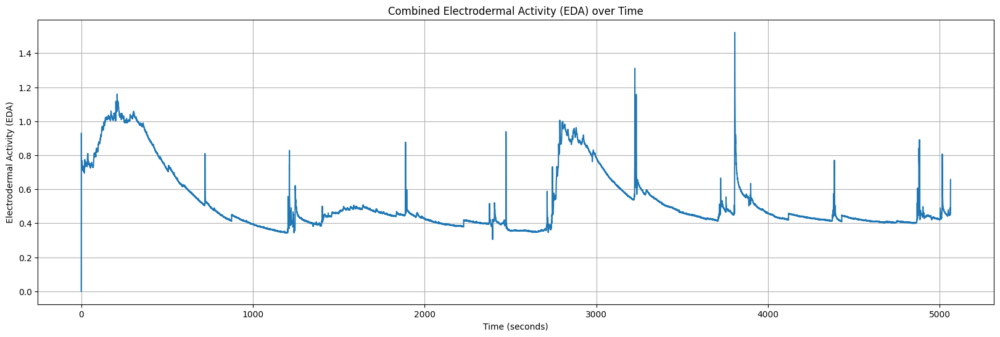

In [1634]:
# Combine the two EDA signals by taking the average
combined_eda = (right_eda_df['EDA'] + left_eda_df['EDA']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_eda_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = right_eda_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_eda)
plt.title('Combined Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(True)
plt.show()

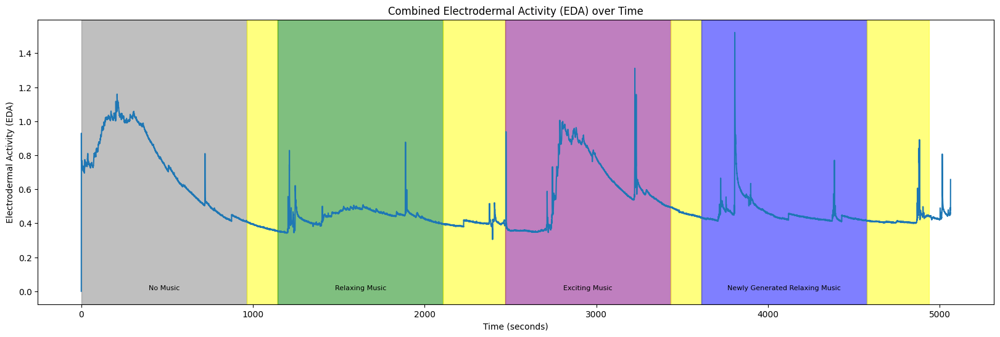

In [1635]:
import matplotlib.pyplot as plt


# Combine the two EDA signals by taking the average
combined_eda = (right_eda_df['EDA'] + left_eda_df['EDA']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_eda_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = right_eda_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_eda)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_eda), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Combined Electrodermal Activity (EDA) over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Electrodermal Activity (EDA)')
plt.grid(False)
plt.show()

### HR
- HR: Average heart rate (HR) extracted from the BVP signal. Values in the first column (HR) show the HR values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1636]:
left_hr_df=pd.read_csv(Left_HR_file)
left_hr_df

,HR,start_time_unix,sampling_rate
0,123.00,1.635111e+09,1.0
1,89.50,1.635111e+09,1.0
2,117.67,1.635111e+09,1.0
3,102.75,1.635111e+09,1.0
4,92.60,1.635111e+09,1.0
...,...,...,...
5050,68.63,1.635111e+09,1.0
5051,68.85,1.635111e+09,1.0
5052,69.12,1.635111e+09,1.0
5053,69.40,1.635111e+09,1.0


In [1637]:
right_hr_df=pd.read_csv(Right_HR_file)
right_hr_df

,HR,start_time_unix,sampling_rate
0,58.00,1.635111e+09,1.0
1,58.50,1.635111e+09,1.0
2,58.67,1.635111e+09,1.0
3,71.25,1.635111e+09,1.0
4,70.60,1.635111e+09,1.0
...,...,...,...
5050,70.52,1.635111e+09,1.0
5051,70.62,1.635111e+09,1.0
5052,70.72,1.635111e+09,1.0
5053,70.77,1.635111e+09,1.0


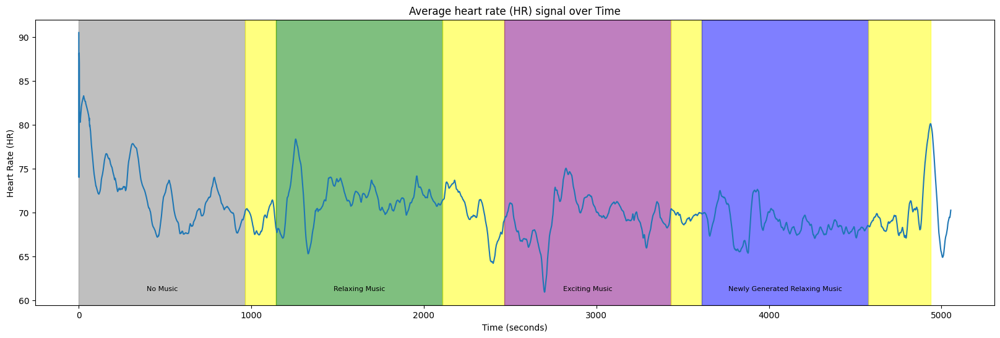

In [1638]:
import matplotlib.pyplot as plt


# Combine the two hr signals by taking the average
combined_hr = (right_hr_df['HR'] + left_hr_df['HR']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_hr_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_hr_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_hr)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_hr), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Average heart rate (HR) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Heart Rate (HR)')
plt.grid(False)
plt.show()

### BVP
- BVP: Blood volume pulses (BVP) measured from a photoplethysmograph. Values in the first column (BVP) show the BVP values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1639]:
left_bvp_df=pd.read_csv(Left_BVP_file)
left_bvp_df

,BVP,start_time_unix,sampling_rate
0,-0.00,1.635111e+09,64.0
1,-0.00,1.635111e+09,64.0
2,-0.00,1.635111e+09,64.0
3,-0.00,1.635111e+09,64.0
4,-0.00,1.635111e+09,64.0
...,...,...,...
324154,-20.90,1.635111e+09,64.0
324155,-3.70,1.635111e+09,64.0
324156,16.76,1.635111e+09,64.0
324157,39.63,1.635111e+09,64.0


In [1640]:
right_bvp_df=pd.read_csv(Right_BVP_file)
right_bvp_df

,BVP,start_time_unix,sampling_rate
0,-0.00,1.635111e+09,64.0
1,-0.00,1.635111e+09,64.0
2,-0.00,1.635111e+09,64.0
3,-0.00,1.635111e+09,64.0
4,-0.00,1.635111e+09,64.0
...,...,...,...
324187,-60.68,1.635111e+09,64.0
324188,-63.67,1.635111e+09,64.0
324189,-67.41,1.635111e+09,64.0
324190,-71.05,1.635111e+09,64.0


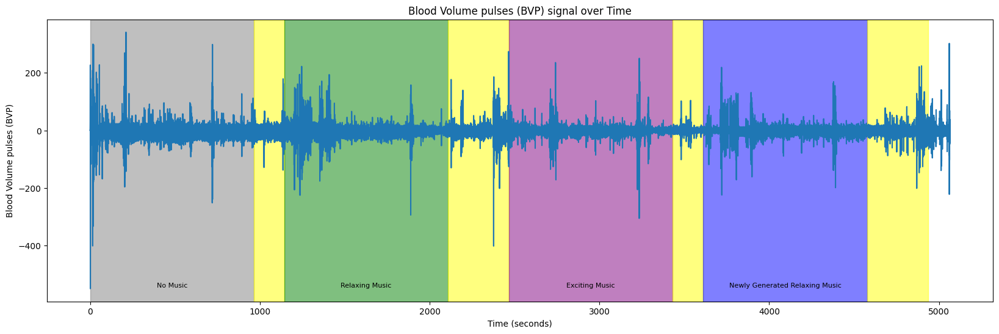

In [1641]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_bvp = (right_bvp_df['BVP'] + left_bvp_df['BVP']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_bvp_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = right_bvp_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_bvp)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_bvp), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Blood Volume pulses (BVP) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Blood Volume pulses (BVP)')
plt.grid(False)
plt.show()

### Temperature
- TEMP: Skin temperature (TEMP) measured from temperature sensor expressed degrees on the Celsius (°C) scale. Values in the first column (TEMP) show the TEMP values. The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1642]:
left_temp_df=pd.read_csv(Left_TEMP_file)
left_temp_df

,TEMP,start_time_unix,sampling_rate
0,29.97,1.635111e+09,4.0
1,29.97,1.635111e+09,4.0
2,29.97,1.635111e+09,4.0
3,29.97,1.635111e+09,4.0
4,29.97,1.635111e+09,4.0
...,...,...,...
20267,31.19,1.635111e+09,4.0
20268,31.15,1.635111e+09,4.0
20269,31.15,1.635111e+09,4.0
20270,31.15,1.635111e+09,4.0


In [1643]:
right_temp_df=pd.read_csv(Right_TEMP_file)
right_temp_df

,TEMP,start_time_unix,sampling_rate
0,29.05,1.635111e+09,4.0
1,29.05,1.635111e+09,4.0
2,29.05,1.635111e+09,4.0
3,29.05,1.635111e+09,4.0
4,29.05,1.635111e+09,4.0
...,...,...,...
20251,29.35,1.635111e+09,4.0
20252,29.35,1.635111e+09,4.0
20253,29.35,1.635111e+09,4.0
20254,29.35,1.635111e+09,4.0


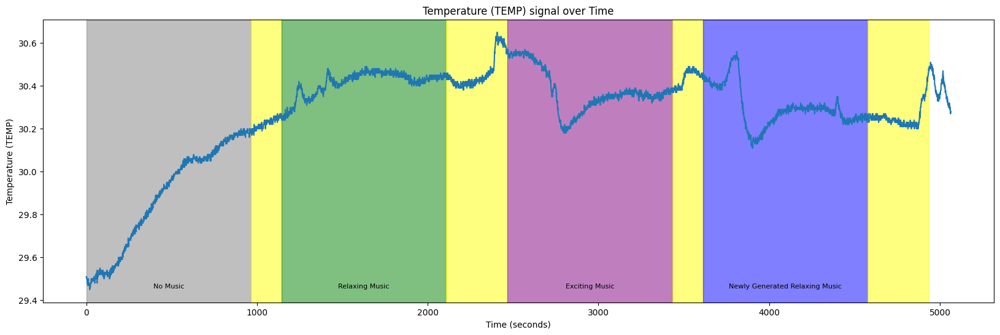

In [1644]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_temp = (right_temp_df['TEMP'] + left_temp_df['TEMP']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_temp_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_temp_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_temp)

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_temp), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Temperature (TEMP) signal over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Temperature (TEMP)')
plt.grid(False)
plt.show()

### ACC
- ACC: Data from 3-axis accelerometer sensor. The accelerometer is configured to measure acceleration in the range [-2g, 2g]. Therefore, the unit in this file is 1/64g. Data from x, y, and z axis are labeled respectively (i.e., ACC_X, ACC_Y, and ACC_Z).  The column (start_time_unix) shows the initial time of the recording expressed as UNIX timestamp in UTC. The column (sampling_rate) shows the sample rate expressed in Hz.

In [1645]:
left_ACC_df=pd.read_csv(Left_ACC_file)
left_ACC_df

,ACC_X,ACC_Y,ACC_Z,start_time_unix,sampling_rate
0,-24,-19,58,1.635111e+09,32.0
1,-21,-19,61,1.635111e+09,32.0
2,-19,-21,60,1.635111e+09,32.0
3,-27,-23,51,1.635111e+09,32.0
4,-29,-20,46,1.635111e+09,32.0
...,...,...,...,...,...
162079,28,-43,37,1.635111e+09,32.0
162080,32,-40,37,1.635111e+09,32.0
162081,30,-39,36,1.635111e+09,32.0
162082,26,-42,38,1.635111e+09,32.0


In [1646]:
right_ACC_df=pd.read_csv(Right_ACC_file)
right_ACC_df

,ACC_X,ACC_Y,ACC_Z,start_time_unix,sampling_rate
0,-11,15,55,1.635111e+09,32.0
1,-14,16,60,1.635111e+09,32.0
2,-14,14,63,1.635111e+09,32.0
3,-14,14,62,1.635111e+09,32.0
4,-13,14,61,1.635111e+09,32.0
...,...,...,...,...,...
162073,9,49,39,1.635111e+09,32.0
162074,10,48,39,1.635111e+09,32.0
162075,10,48,40,1.635111e+09,32.0
162076,10,48,39,1.635111e+09,32.0


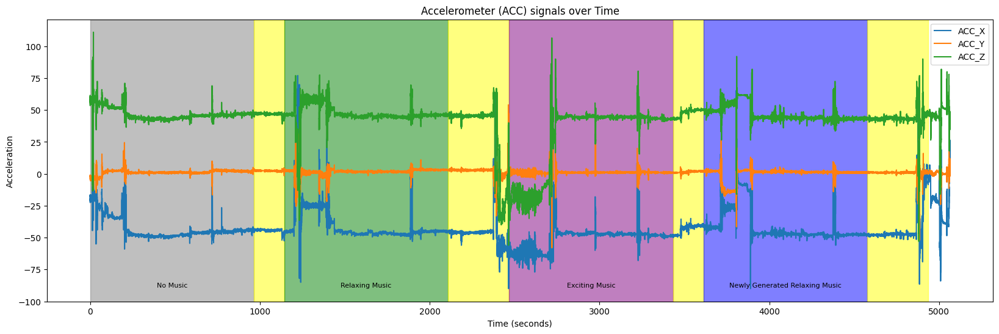

In [1647]:
import matplotlib.pyplot as plt


# Combine the two bvp signals by taking the average
combined_accX = (right_ACC_df['ACC_X'] + left_ACC_df['ACC_X']) / 2
combined_accY = (right_ACC_df['ACC_Y'] + left_ACC_df['ACC_Y']) / 2
combined_accZ = (right_ACC_df['ACC_Z'] + left_ACC_df['ACC_Z']) / 2

# Use the sampling rate to calculate the time in seconds
sampling_rate = right_ACC_df['sampling_rate'].iloc[0]  # Assuming the sampling rate is the same for both
time_seconds = left_ACC_df.index / sampling_rate

# Plot the combined EDA signal
plt.figure(figsize=(20, 6))
plt.plot(time_seconds, combined_accX, label='ACC_X')
plt.plot(time_seconds, combined_accY, label='ACC_Y')
plt.plot(time_seconds, combined_accZ, label='ACC_Z')

# Define the intervals and their respective colors
intervals = [(0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
             (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                                     964 + 180 + 964 + 360 + 964 + 180),
             (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
             (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)]

colors = ['gray', 'yellow', 'green', 'yellow', 'purple', 'yellow', 'blue', 'yellow']



# Create a dictionary to map colors to labels
color_labels = {'gray': 'No Music', 'green': 'Relaxing Music', 'purple': 'Exciting Music', 'blue': 'Newly Generated Relaxing Music'}


# Add background color for each interval and label
for interval, color in zip(intervals, colors):
    plt.axvspan(interval[0], interval[1], color=color, alpha=0.5)  # Adjust alpha for transparency
    if color in color_labels:
        plt.text(interval[0] + (interval[1] - interval[0]) / 2, min(combined_accX), color_labels[color],
                 ha='center', va='bottom', fontsize=8, color='black')

plt.title('Accelerometer (ACC) signals over Time')
plt.xlabel('Time (seconds)')
plt.ylabel('Acceleration')
plt.legend()
plt.grid(False)
plt.show()

## EG

The EEG signals recorded from the Muse headband are also included in the dataset as 'EEG_recording.csv'. They include EEG channels from four locations: TP9, AF7, AF8, and TP10. The 2016 model Muse (MU-02) can also output RAW EEG data at 256Hz as well as being able to output RAW EEG from the right ear USB Auxiliary connector (named Right AUX in the csv files). The column (timestamps) shows the data points in UNIX format. EEG measurements are labeled as TP9, AF7, AF8, TP10, Right AUX.

In [254]:
eeg_df=pd.read_csv(EEG_file)
eeg_df

,timestamps,TP9,AF7,AF8,TP10,Right AUX
0,1.635111e+09,37.109,17.578,45.410,30.273,76.172
1,1.635111e+09,31.250,19.043,42.969,29.297,29.297
2,1.635111e+09,34.668,20.996,45.898,33.691,-25.391
3,1.635111e+09,31.250,19.531,48.828,37.109,8.789
4,1.635111e+09,32.715,20.996,47.363,36.621,54.199
...,...,...,...,...,...,...
1310707,1.635116e+09,0.000,36.621,21.973,-63.477,-966.309
1310708,1.635116e+09,-2.441,41.992,26.367,-70.801,-966.309
1310709,1.635116e+09,0.488,42.969,29.785,-64.941,-966.309
1310710,1.635116e+09,16.113,41.992,29.785,-72.754,-966.309


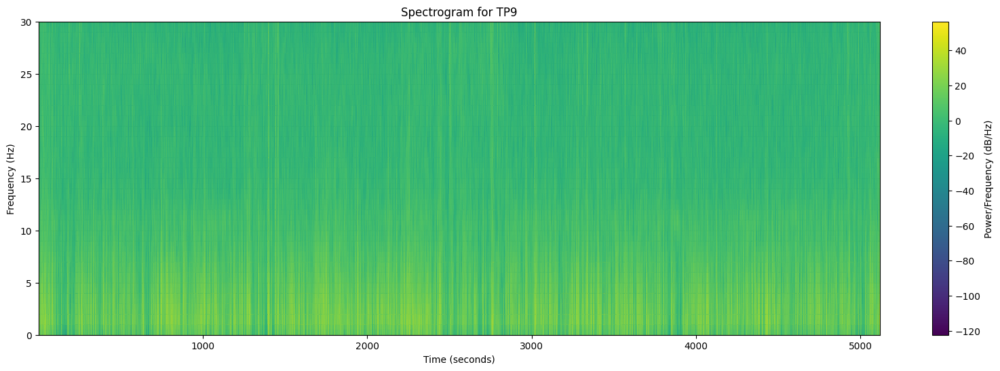

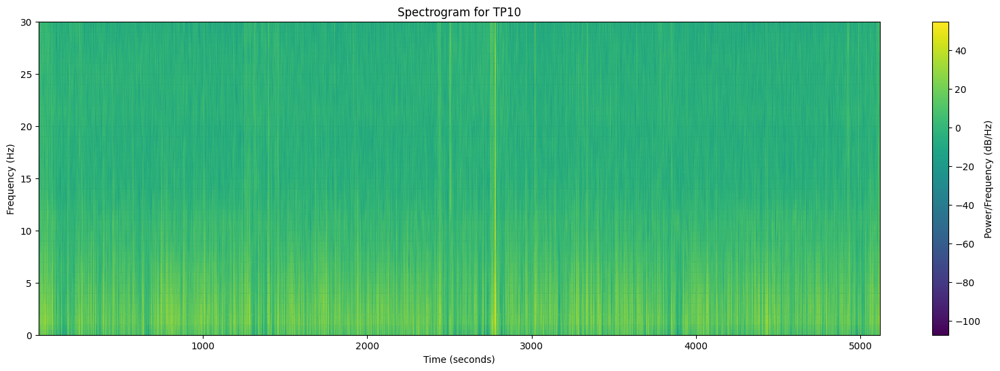

In [255]:
import matplotlib.pyplot as plt
from scipy import signal
# Extract the desired channels (TP9 and TP10)
channels = ['TP9', 'TP10']  
eeg_data = eeg_df[channels]

# Convert the timestamps to time in seconds
sampling_rate = 256  # Sampling rate of the EEG data in Hz
time_seconds = eeg_df['timestamps'] / sampling_rate

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 256    # Length of each segment
noverlap = 128   # Overlap between segments
nfft = 256       # Number of points for the FFT

# Compute the spectrogram for each channel
frequencies, times, spectrogram_TP9 = signal.spectrogram(eeg_data['TP9'], fs=sampling_rate, window=window, 
                                                         nperseg=nperseg, noverlap=noverlap, nfft=nfft)
_, _, spectrogram_TP10 = signal.spectrogram(eeg_data['TP10'], fs=sampling_rate, window=window, 
                                            nperseg=nperseg, noverlap=noverlap, nfft=nfft)

# Plot the spectrogram for TP9
plt.figure(figsize=(20, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP9), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP9')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
plt.show()

# Plot the spectrogram for TP10
plt.figure(figsize=(20, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(spectrogram_TP10), shading='gouraud', cmap='viridis')
plt.title('Spectrogram for TP10')
plt.xlabel('Time (seconds)')
plt.ylabel('Frequency (Hz)')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
plt.show()

Text(0.5, 0, 'time (s)')

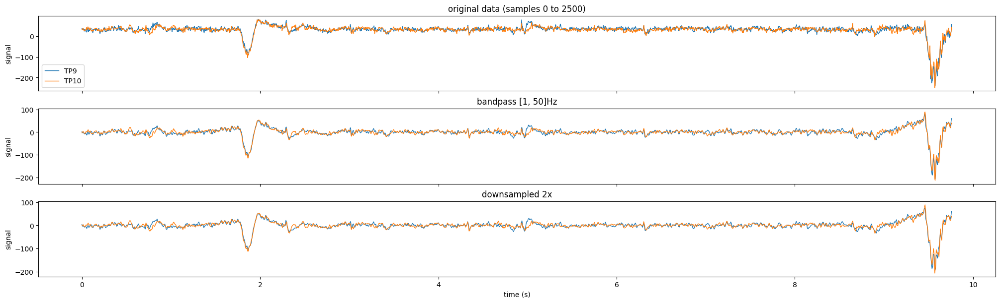

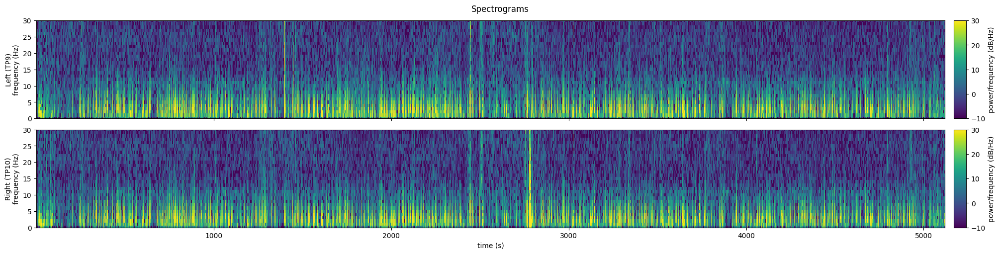

In [256]:
eeg_df['sample_number'] = range(len(eeg_df))
# Sampling rate of the EEG data in Hz
sampling_rate = 256  


# Convert the sample index to time in seconds
# This means you need to divide the sample *number* by the sampling rate
eeg_df['time_seconds'] = eeg_df['sample_number'] / sampling_rate

# Extract the desired channels (TP9 and TP10)
keep_channels = ['TP9', 'TP10']
eeg_data = eeg_df[keep_channels + ['time_seconds']].copy()

#
# Preprocess the EEG signals
#

#Define the pre-preprocessing parameters
downsample_factor = 2
bp_order = 4
bp_passband = [1, 50]
downsample_factor = 2

eeg_downsampled = pd.DataFrame()
downsampled_length = len(eeg_data) // downsample_factor

for channel in keep_channels:
    filtered_name = channel + '_bp'
    # Apply high-pass filter above 1 Hz and low-pass filter below 50 Hz
    b, a = signal.butter(bp_order, bp_passband, btype='bandpass', fs=sampling_rate)
    eeg_data[filtered_name] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample the signal from 256 to 128 Hz
    # Put the shorter signals in a new dataframe "eeg_downsampled"
    eeg_downsampled[channel] = signal.resample(eeg_data[filtered_name], downsampled_length)
eeg_downsampled['time_seconds'] = np.arange(downsampled_length) / (sampling_rate / downsample_factor)

#
# View the original and processed data
#
plot_height = 2
n_plots = 3
f, axs = plt.subplots(nrows=n_plots, ncols=1,
                      figsize=(20, plot_height * n_plots),
                      layout='constrained', sharex=True)

plot_slice = slice(0, 2500) #window of data to plot

#Original data
eeg_data[plot_slice].plot(
    y=keep_channels, x='time_seconds',
    ylabel='signal', xlabel='time (s)',
    linewidth=1, ax=axs[0],
    title=f'original data (samples {plot_slice.start} to {plot_slice.stop})'
)

#Filtered
eeg_data[plot_slice].plot(
    y=[chan + '_bp' for chan in keep_channels], x='time_seconds',
    ylabel='signal', xlabel='time (s)', legend=False,
    linewidth=1, ax=axs[1], title=f'bandpass {bp_passband}Hz'
)

#Downsampled
eeg_downsampled[plot_slice.start:plot_slice.stop//downsample_factor].plot(
    y=keep_channels, x='time_seconds',
    ylabel='signal', xlabel='time (s)', legend=False,
    linewidth=1, ax=axs[2], title=f'downsampled {downsample_factor}x'
)

# Define the parameters for the spectrogram
window = 'hann'  # Windowing function
nperseg = 128    # Length of each segment
noverlap = 64    # Overlap between segments
nfft = 128       # Number of points for the FFT

# Compute the spectrogram for each channel
spectrograms = {}
for channel in keep_channels:
    frequencies, times, spectrogram = signal.spectrogram(
        eeg_downsampled[channel],
        fs=sampling_rate / downsample_factor,
        window=window, nperseg=nperseg, noverlap=noverlap, nfft=nfft
    )
    spectrograms[channel] = spectrogram

# Plot the spectrograms
f, axs = plt.subplots(nrows=2, ncols=1, figsize=(20, 5),
                      layout='constrained', sharex=True)
f.suptitle('Spectrograms')
vmin, vmax = -10, 30

for channel, ax in zip(keep_channels, axs):
    im = ax.pcolormesh(
        times, frequencies, 10 * np.log10(spectrograms[channel]),
        vmin=vmin, vmax=vmax, #comment out for auto-range
        shading='nearest', cmap='viridis'
    )
    
    ax.set_ylim(0, 30)  # Limit the y-axis to frequencies up to 30 Hz
    ax.set_ylabel(('Left' if channel=='TP9' else 'Right') + f' ({channel})\nfrequency (Hz)')
    
    cbar = f.colorbar(im, aspect=8, pad=0.01, label='power/frequency (dB/Hz)')
    
ax.set_xlabel('time (s)')

### Beta Band Frequency

C:\Users\user\AppData\Local\Temp\ipykernel_29192\2331215207.py:79: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")
C:\Users\user\AppData\Local\Temp\ipykernel_29192\2331215207.py:79: UserWarning: 

The `join` parameter is deprecated and will be removed in v0.15.0.

  sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")


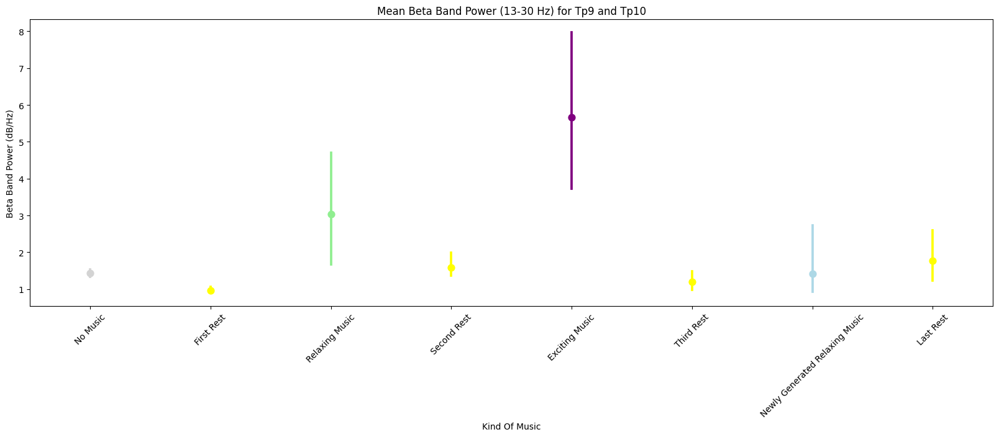

In [257]:
# Sample EEG DataFrame
# Assuming you have an EEG DataFrame named eeg_df with columns 'TP9' and 'TP10'

# Preprocessing parameters
sampling_rate = 256
downsample_factor = 2
bp_order = 4
bp_passband = [1, 50]

# Apply preprocessing and downsampling
eeg_df['sample_number'] = range(len(eeg_df))
eeg_df['time_seconds'] = eeg_df['sample_number'] / sampling_rate

eeg_data = eeg_df[['TP9', 'TP10', 'time_seconds']].copy()

eeg_downsampled = pd.DataFrame()
downsampled_length = len(eeg_data) // downsample_factor

for channel in ['TP9', 'TP10']:
    filtered_name = channel + '_bp'
    # Apply bandpass filter
    b, a = signal.butter(bp_order, bp_passband, btype='bandpass', fs=sampling_rate)
    eeg_data[filtered_name] = signal.filtfilt(b, a, eeg_data[channel])
    
    # Downsample
    eeg_downsampled[channel] = signal.resample(eeg_data[filtered_name], downsampled_length)

eeg_downsampled['time_seconds'] = np.arange(downsampled_length) / (sampling_rate / downsample_factor)

# Compute spectrogram for each channel
frequencies, times, spectrogram_tp9 = signal.spectrogram(
    eeg_downsampled['TP9'],
    fs=sampling_rate / downsample_factor,
    window='hann', nperseg=128, noverlap=64, nfft=128
)

_, _, spectrogram_tp10 = signal.spectrogram(
    eeg_downsampled['TP10'],
    fs=sampling_rate / downsample_factor,
    window='hann', nperseg=128, noverlap=64, nfft=128
)

# Compute beta band power (13-30 Hz) for each channel
beta_band_power_tp9 = np.mean(spectrogram_tp9[(frequencies >= 13) & (frequencies <= 30)], axis=0)
beta_band_power_tp10 = np.mean(spectrogram_tp10[(frequencies >= 13) & (frequencies <= 30)], axis=0)

# Compute mean beta band power across channels
mean_beta_band_power = (beta_band_power_tp9 + beta_band_power_tp10) / 2

# Define intervals and corresponding labels
intervals = [
    (0, 964), (964, 964 + 180), (964 + 180, 964 + 180 + 964), (964 + 180 + 964, 964 + 180 + 964 + 360),
    (964 + 180 + 964 + 360, 964 + 180 + 964 + 360 + 964), (964 + 180 + 964 + 360 + 964,
                                                            964 + 180 + 964 + 360 + 964 + 180),
    (964 + 180 + 964 + 360 + 964 + 180, 964 + 180 + 964 + 360 + 964 + 180 + 964),
    (964 + 180 + 964 + 360 + 964 + 180 + 964, 964 + 180 + 964 + 360 + 964 + 180 + 964 + 360)
]
labels = ['No Music', 'First Rest', 'Relaxing Music', 'Second Rest', 'Exciting Music', 'Third Rest',
          'Newly Generated Relaxing Music', 'Last Rest']

# Assign labels to each data point based on intervals
beta_power_df = pd.DataFrame({'Time': times, 'Power': mean_beta_band_power})
beta_power_df['Kind Of Music'] = pd.cut(beta_power_df['Time'], bins=[interval[0] for interval in intervals] + [np.inf], labels=labels)

# Define color palette dictionary
color_palette = {
    'No Music': 'lightgray',
    'First Rest': 'yellow',
    'Relaxing Music': 'lightgreen',
    'Second Rest': 'yellow',
    'Exciting Music': 'purple',
    'Third Rest': 'yellow',
    'Newly Generated Relaxing Music': 'lightblue',
    'Last Rest': 'yellow'
}

# Plot
plt.figure(figsize=(20, 6))
sns.pointplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette, join=True, estimator=np.mean, linestyle="none")
plt.title('Mean Beta Band Power (13-30 Hz) for Tp9 and Tp10')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Kind Of Music')
plt.xticks(rotation=45)
plt.show()

C:\Users\user\AppData\Local\Temp\ipykernel_29192\3532274209.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette)


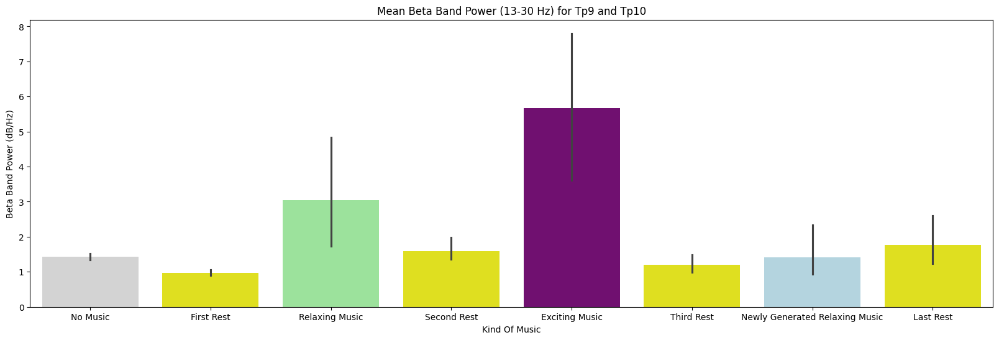

In [258]:
# Apply color palette for the bar plot
color_palette = {
    'No Music': 'lightgray',
    'First Rest': 'yellow',
    'Relaxing Music': 'lightgreen',
    'Second Rest': 'yellow',
    'Exciting Music': 'purple',
    'Third Rest': 'yellow',
    'Newly Generated Relaxing Music': 'lightblue',
    'Last Rest': 'yellow'
}

# Generate the bar plot
plt.figure(figsize=(20, 6))
sns.barplot(data=beta_power_df, x='Kind Of Music', y='Power', palette=color_palette)
plt.title('Mean Beta Band Power (13-30 Hz) for Tp9 and Tp10')
plt.ylabel('Beta Band Power (dB/Hz)')
plt.xlabel('Kind Of Music')
plt.show()